In [10]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from statsmodels.tsa.arima.model import ARIMA
from transformers import pipeline
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller, kpss
import pymannkendall as mk
from math import sqrt
import pmdarima as pm
from pmdarima.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
import json
import ast
import locale
locale.setlocale(locale.LC_ALL, "nl_NL")

'nl_NL'

In [11]:
with open('paper_selectors.txt', 'r') as file:
    papers = ast.literal_eval(file.read())

with open('party_selectors.txt', 'r') as file:
    parties = ast.literal_eval(file.read())

with open('party_synonyms.txt', 'r') as file:
    party_synonyms = ast.literal_eval(file.read())

with open('months.txt', 'r') as file:
    months = ast.literal_eval(file.read())

with open('min_mentions_per_article.txt', 'r') as file:
    min_val = int(file.read())

In [12]:
for synonym in party_synonyms:
    parties = [x for x in parties if x not in synonym[1:]]

In [13]:
with open("../../data/05_sentiment_per_party_per_paper.json") as file:
    data = json.load(file)

party_sentiment = {}
for party in data:
    party_sentiment[party] = {}
    for paper in data[party]:
        party_sentiment[party].update({paper: pd.DataFrame(data[party][paper])})

display(party_sentiment['VVD'])

{'AD':             body_compound  body_neg  body_neu  body_pos
 2023-08-21       0.563950  0.067333  0.814000  0.118333
 2023-08-22       0.608033  0.055667  0.838000  0.106333
 2023-08-23       0.858440  0.052200  0.822400  0.125600
 2023-08-24       0.186817  0.068167  0.813167  0.118667
 2023-08-25       0.958700  0.063500  0.818750  0.117750
 ...                   ...       ...       ...       ...
 2023-12-03      -0.996800  0.141000  0.752000  0.106000
 2023-12-04       0.768750  0.014500  0.893000  0.092500
 2023-12-05       0.115756  0.064778  0.853333  0.082000
 2023-12-06       0.291733  0.074000  0.827667  0.098444
 2023-12-07            NaN       NaN       NaN       NaN
 
 [109 rows x 4 columns],
 'NRC':             body_compound  body_neg  body_neu  body_pos
 2023-08-21            NaN       NaN       NaN       NaN
 2023-08-22            NaN       NaN       NaN       NaN
 2023-08-23            NaN       NaN       NaN       NaN
 2023-08-24            NaN       NaN       NaN  

In [14]:
papers = ['AD', 'Parool', 'Volkskrant', 'Trouw', 'Telegraaf', 'NRC']

/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_12894/2156993502.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(idx*(len(party_sentiment[party].keys()) + 1) +1)


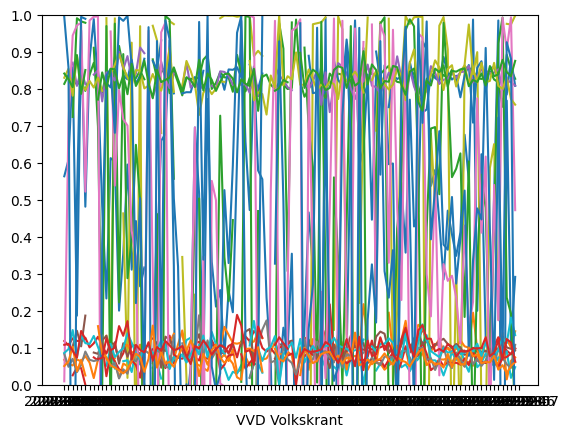

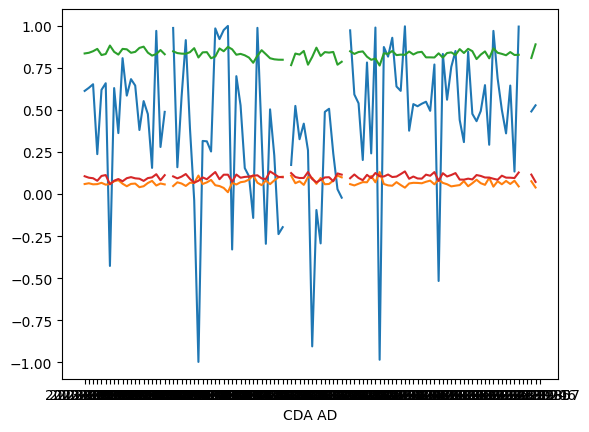

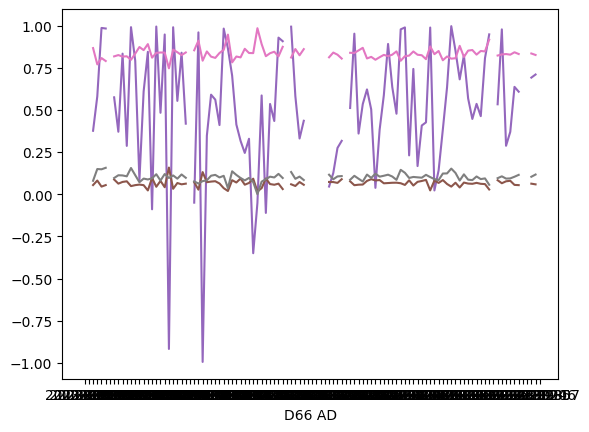

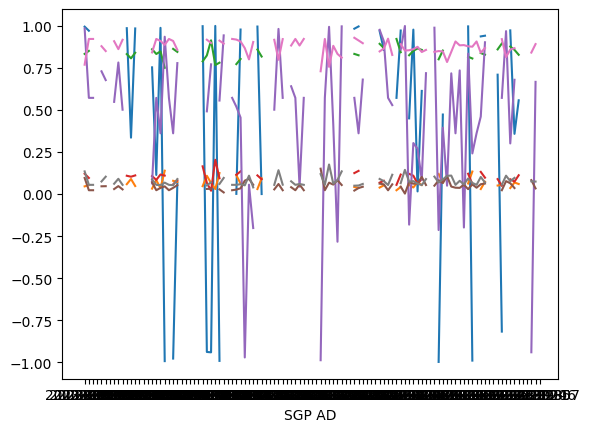

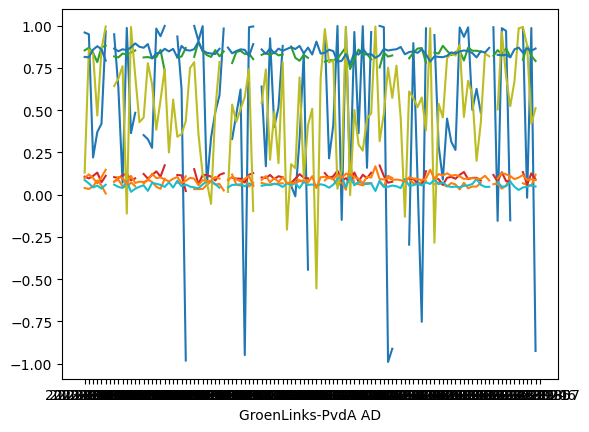

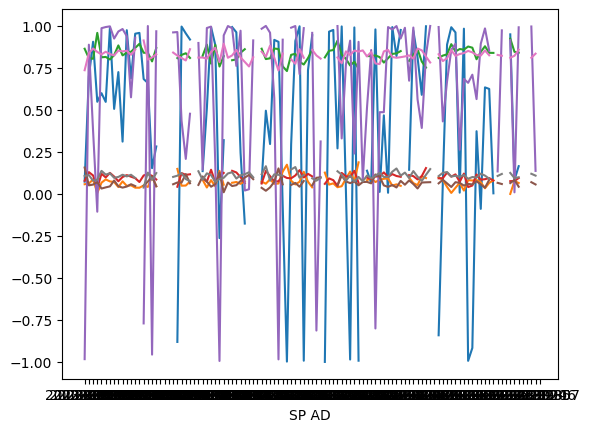

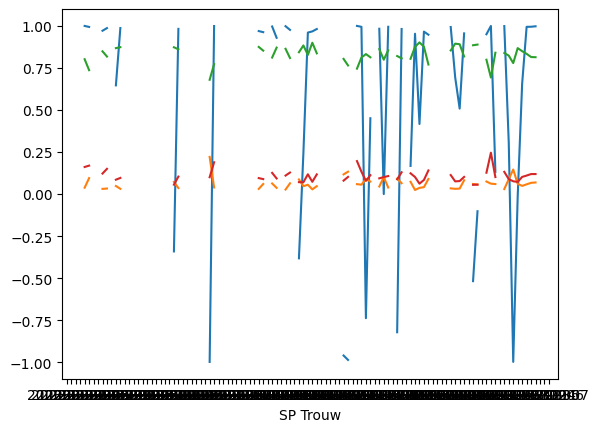

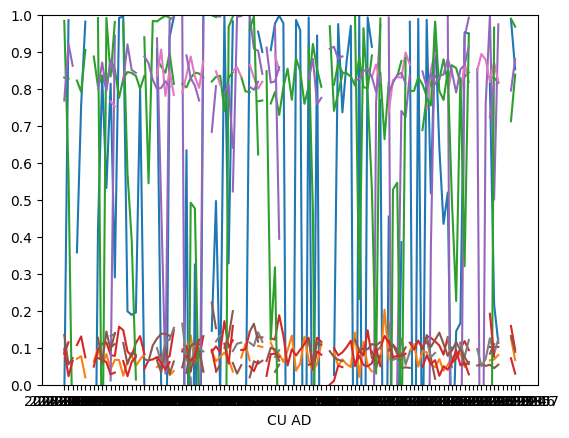

<Figure size 640x480 with 0 Axes>

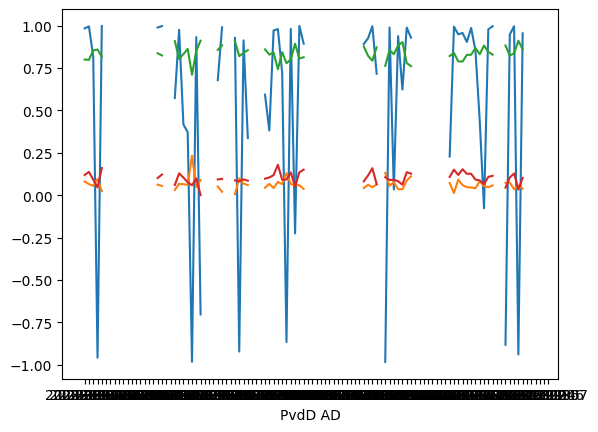

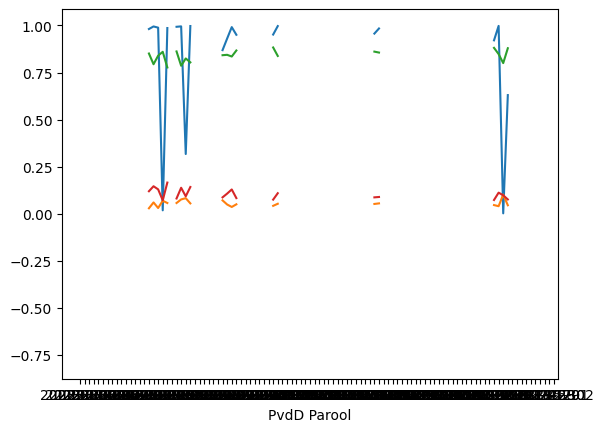

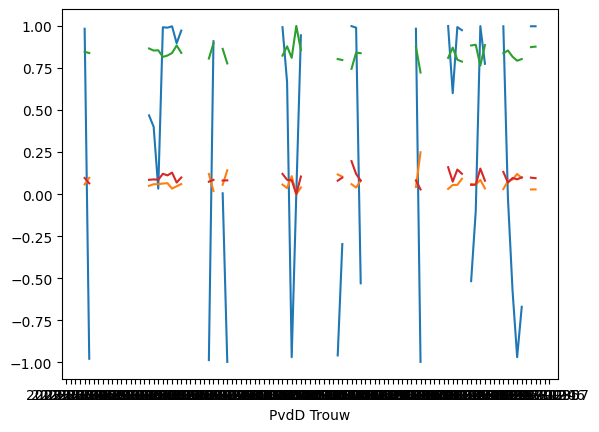

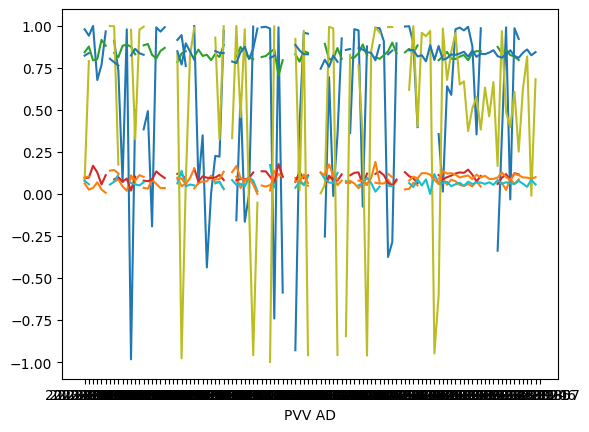

<Figure size 640x480 with 0 Axes>

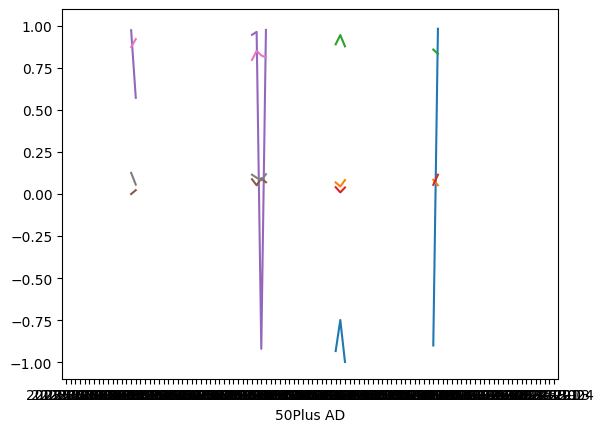

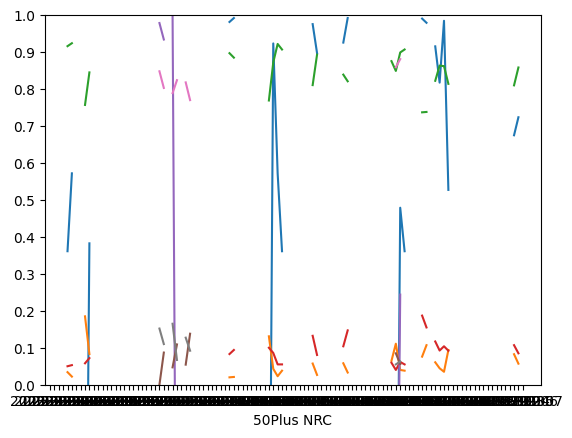

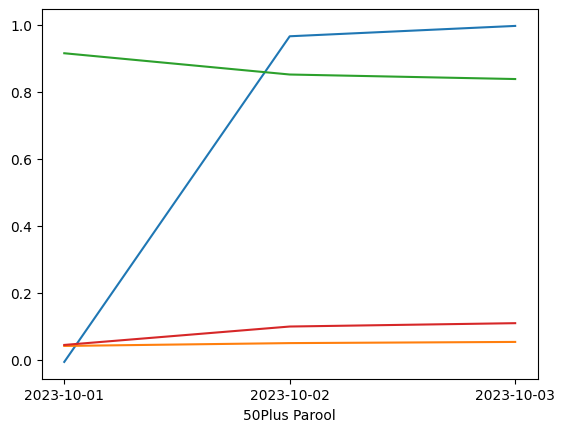

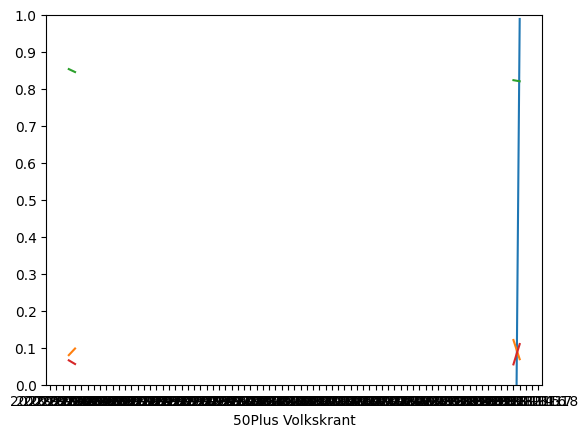

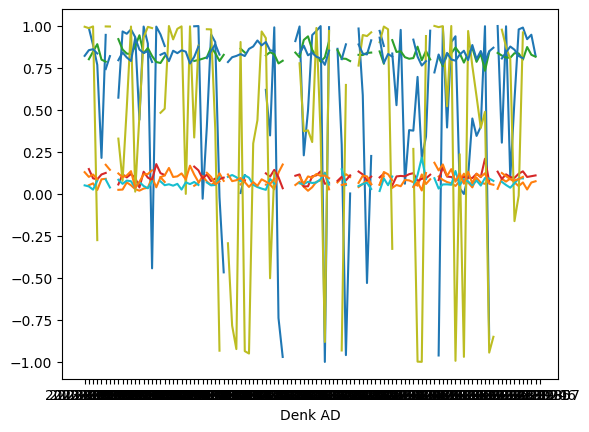

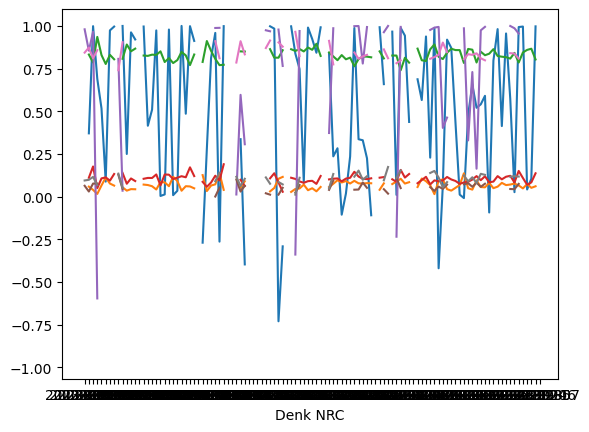

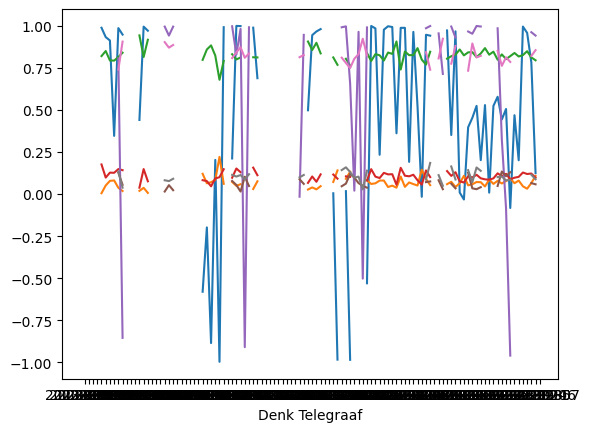

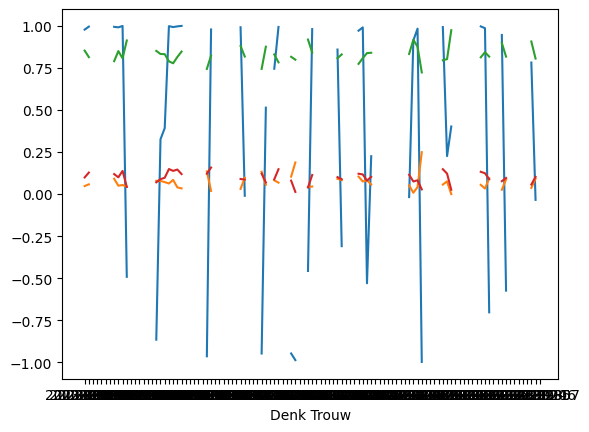

<Figure size 640x480 with 0 Axes>

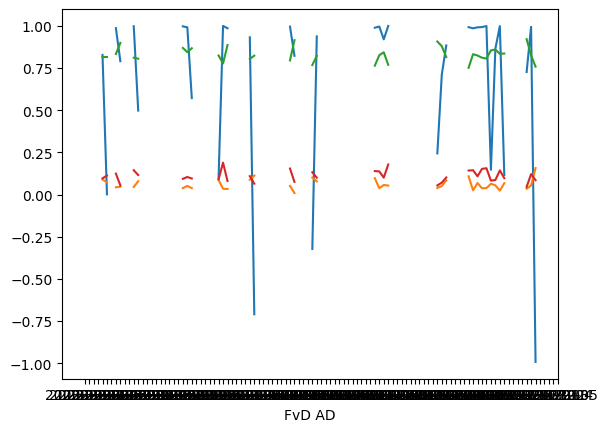

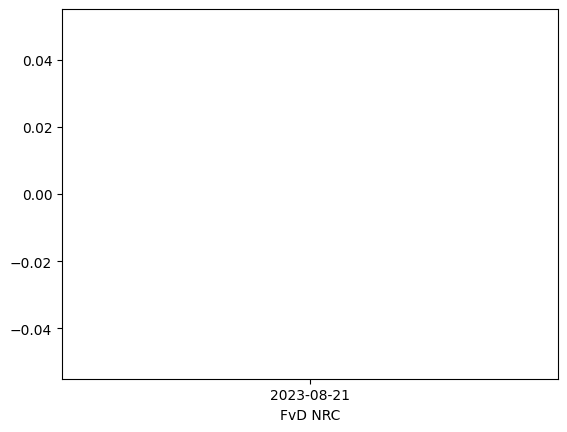

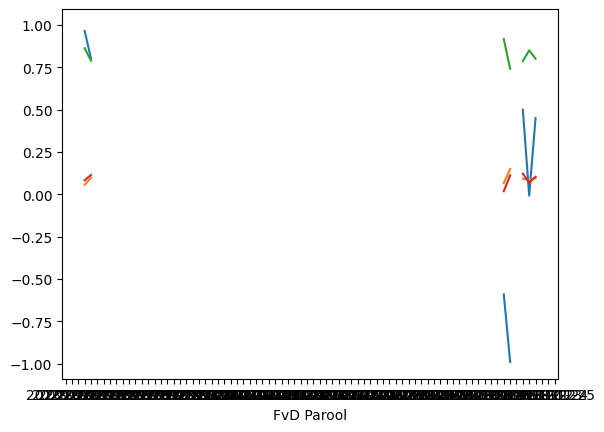

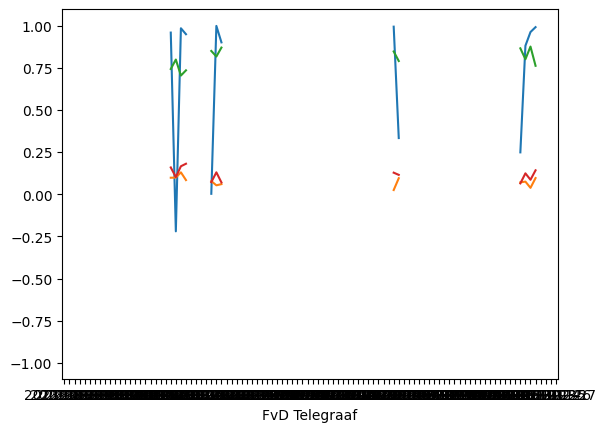

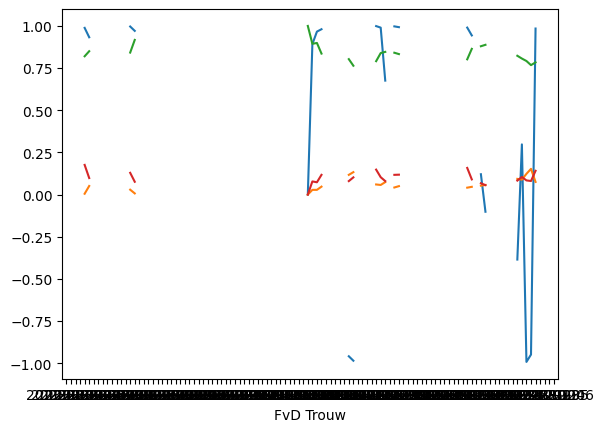

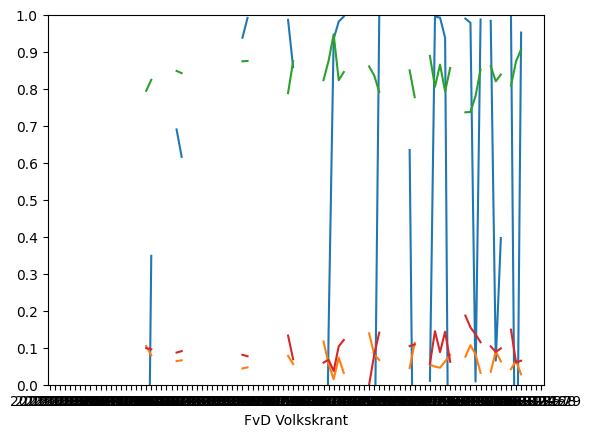

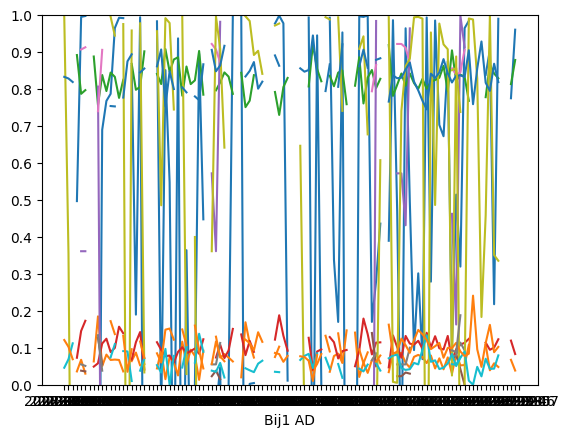

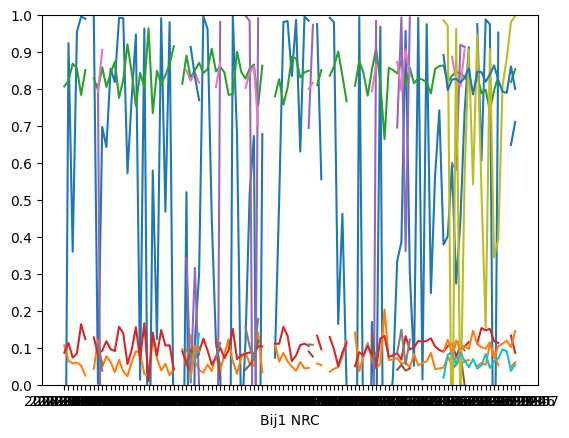

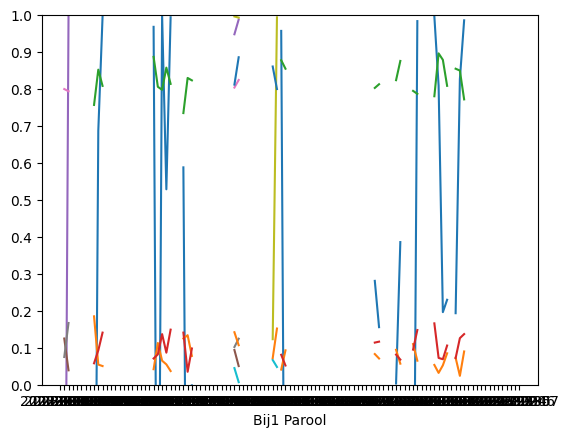

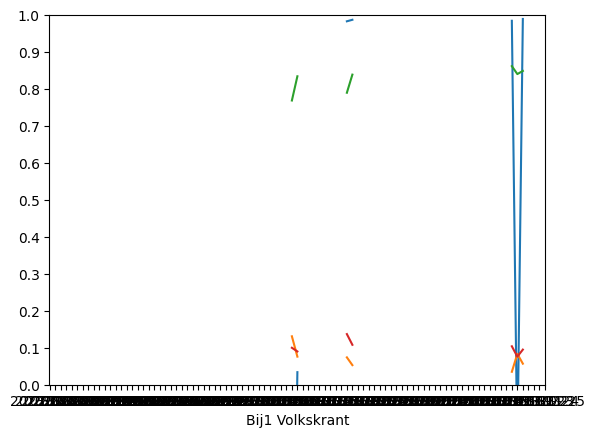

<Figure size 640x480 with 0 Axes>

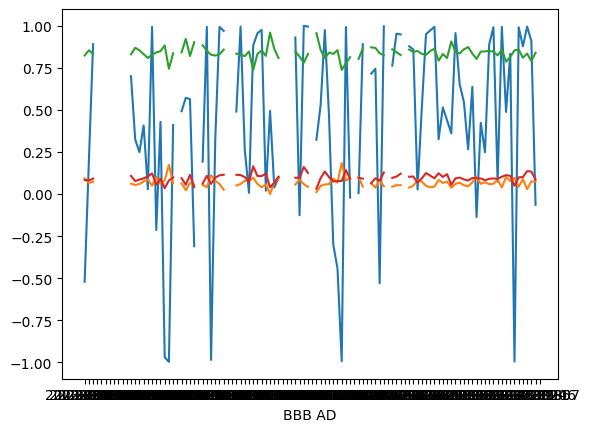

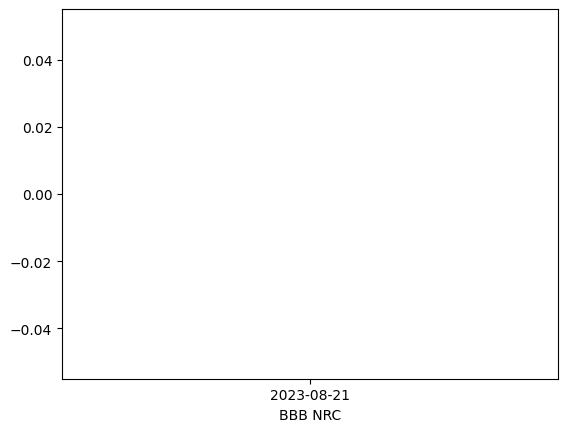

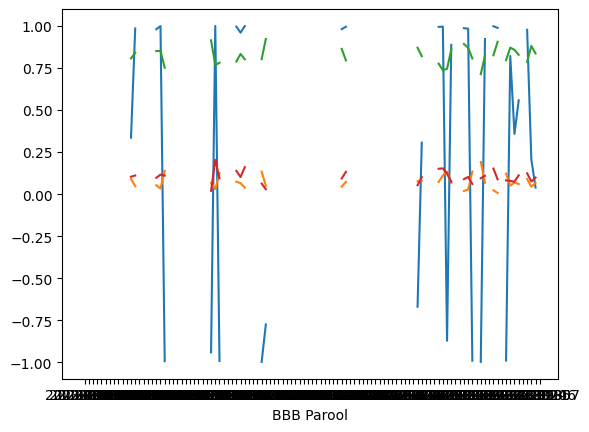

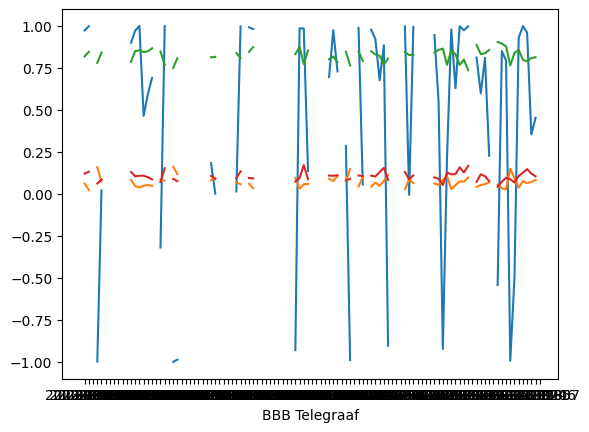

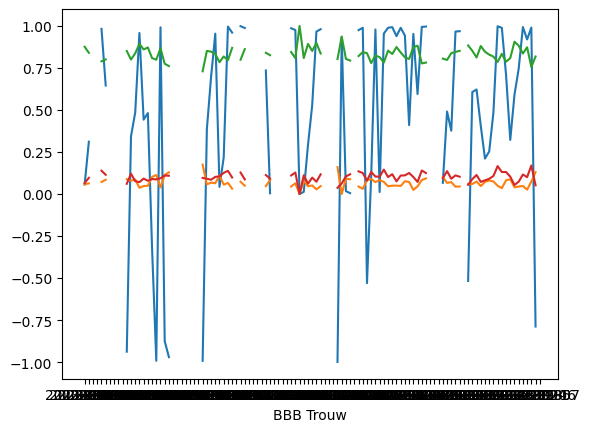

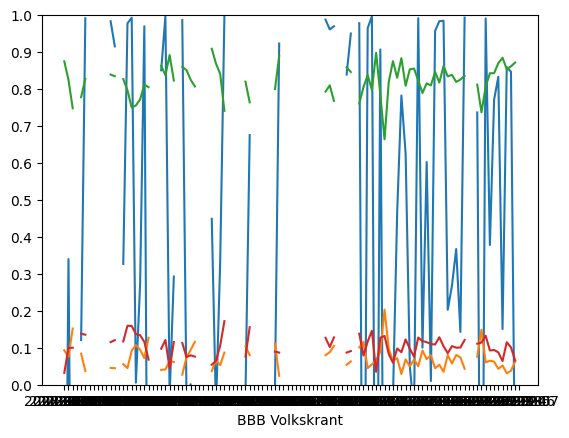

<Figure size 640x480 with 0 Axes>

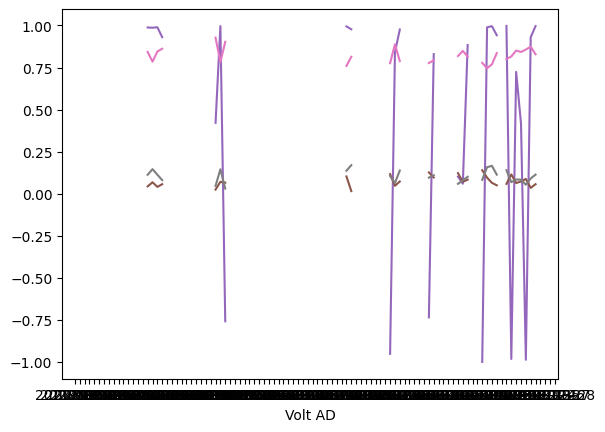

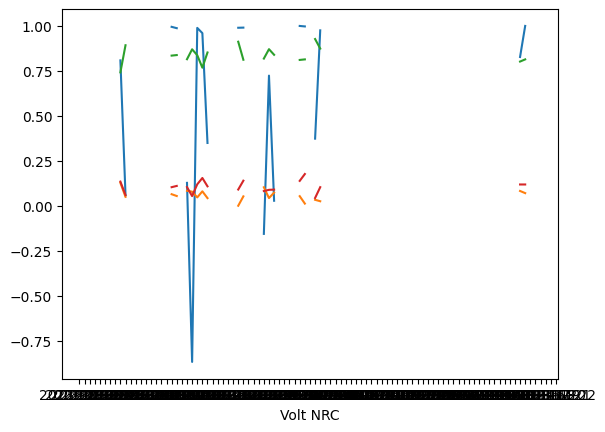

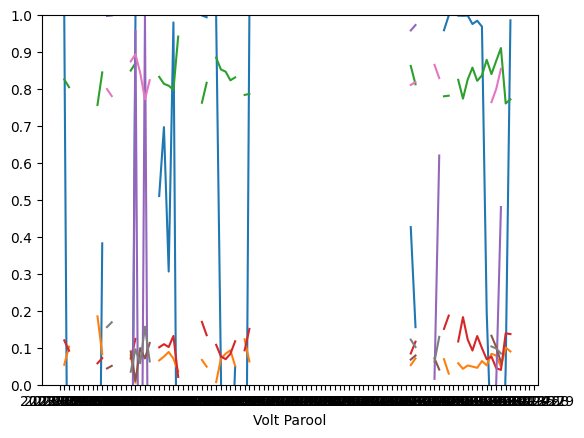

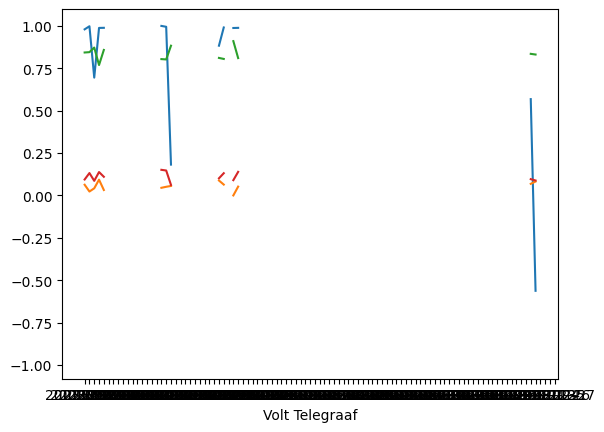

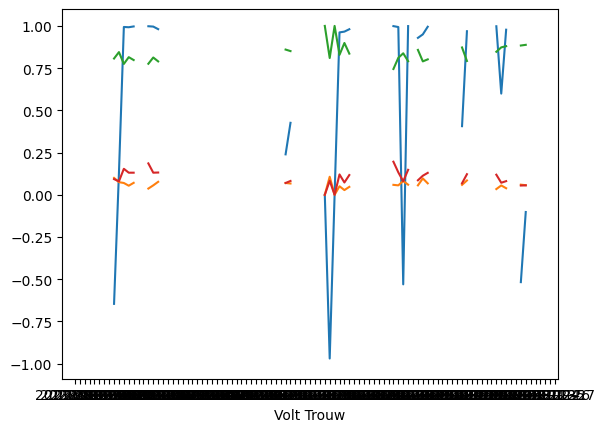

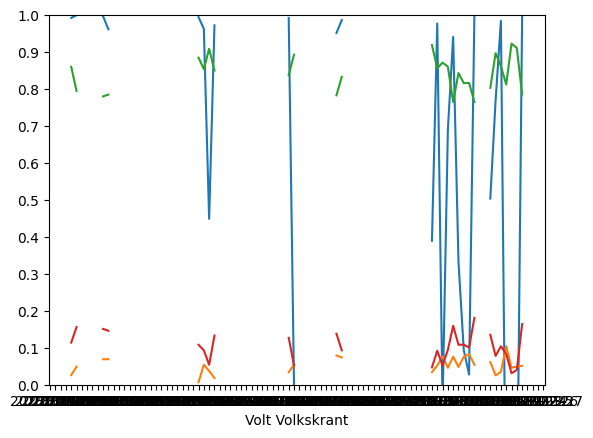

<Figure size 640x480 with 0 Axes>

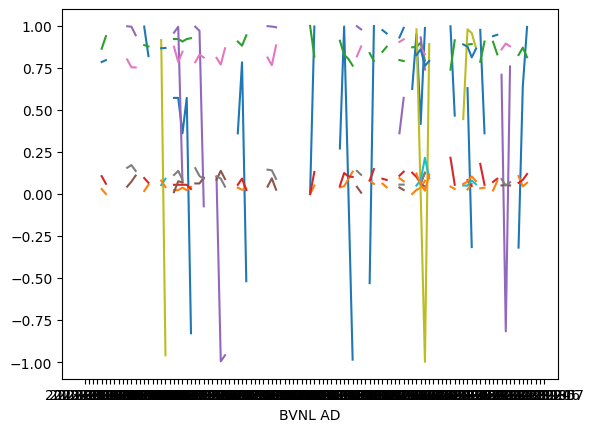

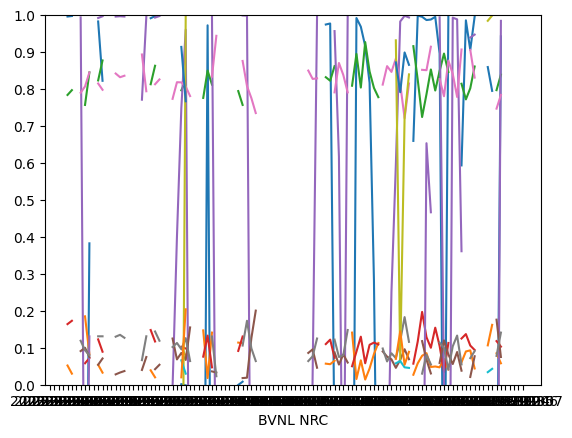

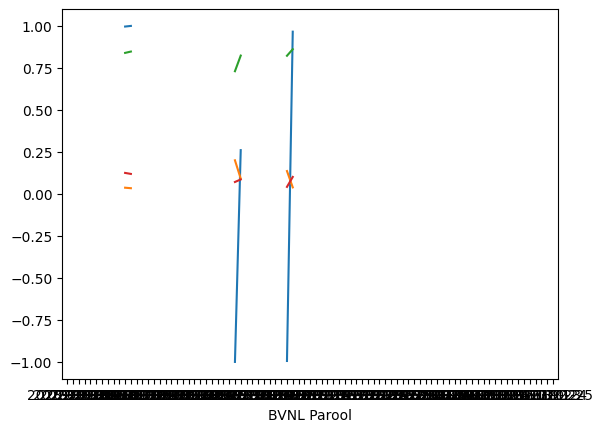

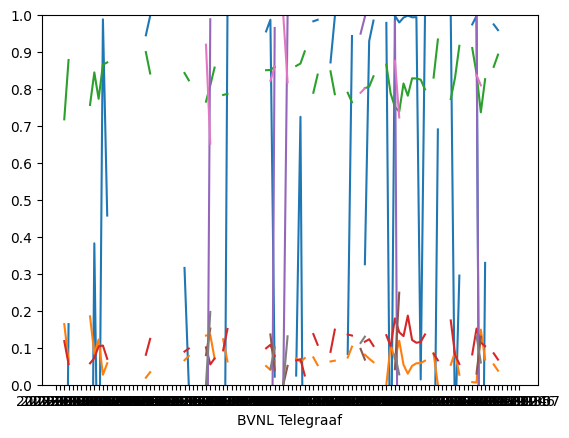

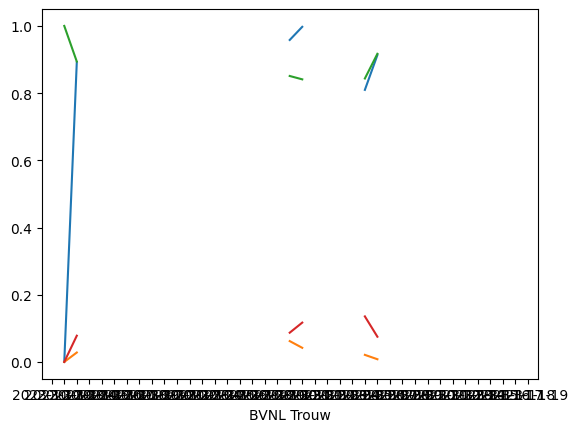

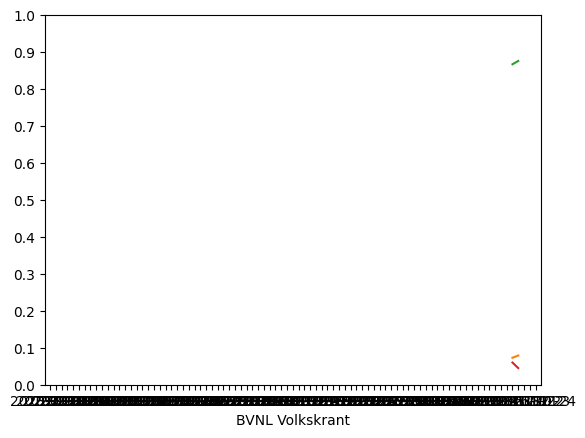

<Figure size 640x480 with 0 Axes>

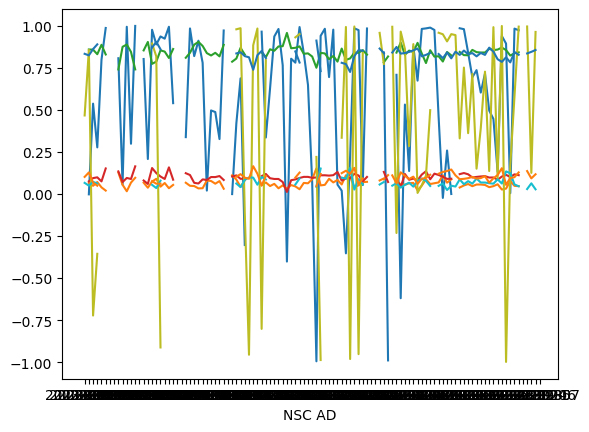

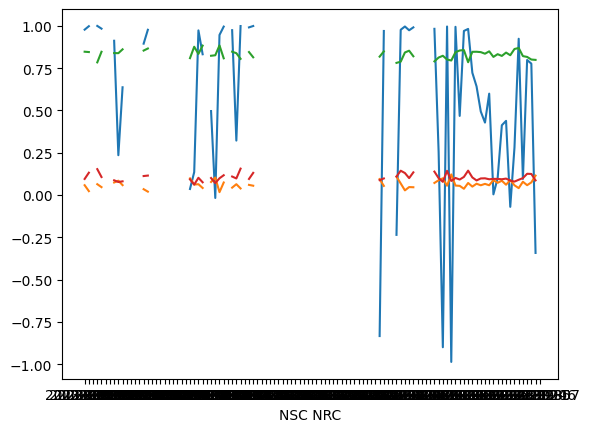

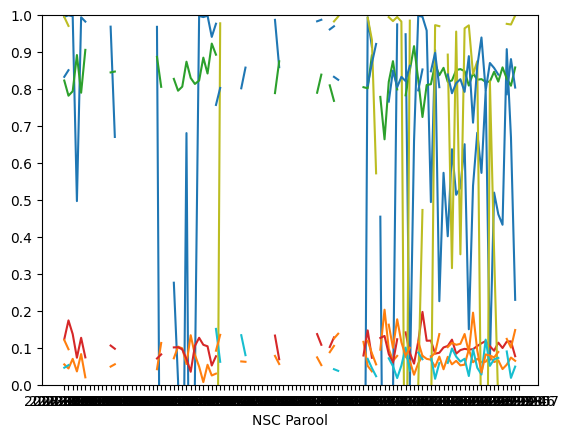

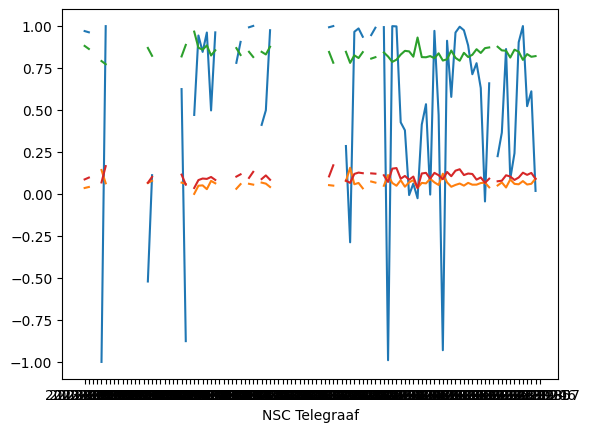

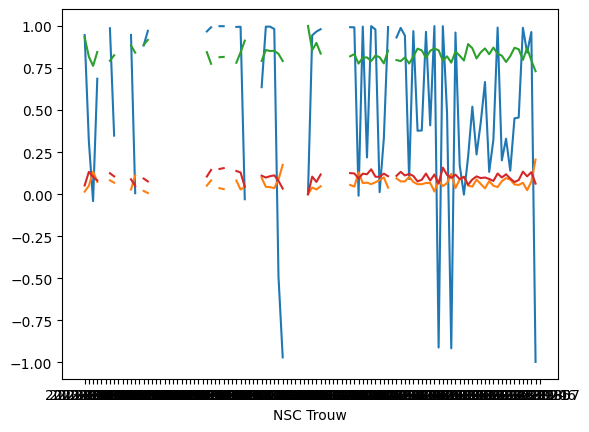

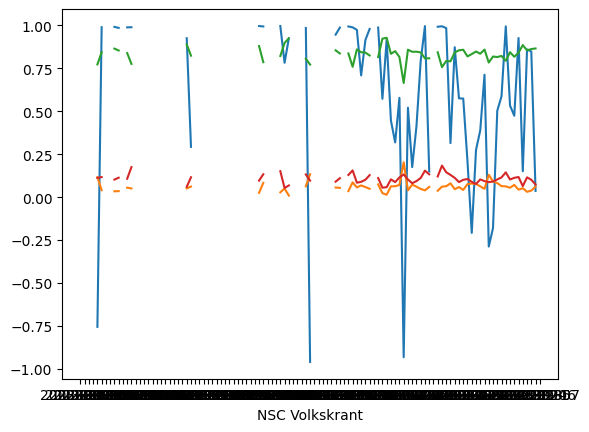

In [15]:
for idx, party in enumerate(parties):
    plt.ylim(0, 1.0)
    plt.yticks(np.arange(0,1.1, step=0.1))
    plt.figure(idx*(len(party_sentiment[party].keys()) + 1) +1)
    for subplot, paper in enumerate(party_sentiment[party].keys()):
        plt.figure(idx* (subplot+1) + 1)#   plt.xticks(rotation=45)
        plt.plot(party_sentiment[party][paper])
        plt.xlabel(f"{party} {paper}")

plt.show()

In [16]:
sentiments = ['neu', 'pos', 'neg']

for party in parties:
    for paper in party_sentiment['VVD'].keys():
        for sentiment in sentiments:
            try:
                plot_acf(party_sentiment[party][paper][sentiment].dropna(), title=f"Autocorrelation {party} {sentiment}")
                plot_pacf(party_sentiment[party][paper][sentiment].dropna(), title=f"PACF {party} {sentiment}")
            except:
                print(f"{party} has insufficient data for PACF")

VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
VVD has insufficient data for PACF
CDA has insufficient data for PACF
CDA has insufficient data for PACF
CDA has insufficient data for PACF
CDA has insufficient data for PACF
CDA has insufficient data for PACF
CDA has insufficient data for PACF
CDA has insufficient data for PACF
CDA has insufficient data for PACF
CDA has insufficient data for PACF
CDA has insufficient data for PACF
CDA has insufficient

In [17]:
def adfuller_test(name, party_data, type):
    result=adfuller(party_data, regression='ct')
    labels = ['ADF:','p-value:','N Lags:','N Observations', 'crit vals']
    print(f"{name} {type}")
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    if result[1] <= 0.05:
        print(f"P value is less than 0.05 for {name} means we can reject the null hypothesis(Ho). We can conclude that data has no unit root and is stationary")
        return 0
    else:
        print(f"Weak evidence against null hypothesis for {name} means time series has a unit root which indicates that it is non-stationary ")
        return 1
    
for party in parties:
    for sentiment in sentiments:
        adfuller_test(party, party_sentiment[party][sentiment].dropna(), sentiment)
        print("")

KeyError: 'neu'

In [ ]:
def kpss_test(name, party):
    result=kpss(party)
    labels = ['KPSS:','p-value:','N Lags:','crit values:']
    print(name)
    for value,label in zip(result,labels):
        print(label+' : '+str(value) )
    if result[0] >= result[3]['5%']:
        print(f"P value is less than 0.05 for {name} means we can reject the null hypothesis(Ho). We can conclude that the data is non-stationary")
        return 0
    else:
        print(f"Weak evidence against null hypothesis for {name} indicates that it is stationary ")
        return 1

for party in parties:
    for sentiment in sentiments:
        print(sentiment)
        kpss_test(party, party_sentiment[party][sentiment].dropna())
        print("")

neu
VVD
KPSS: : 0.11914929179192706
p-value: : 0.1
N Lags: : 4
crit values: : {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Weak evidence against null hypothesis for VVD indicates that it is stationary 

pos
VVD
KPSS: : 0.10325787137128098
p-value: : 0.1
N Lags: : 5
crit values: : {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Weak evidence against null hypothesis for VVD indicates that it is stationary 

neg
VVD
KPSS: : 0.06553875716312882
p-value: : 0.1
N Lags: : 3
crit values: : {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Weak evidence against null hypothesis for VVD indicates that it is stationary 

neu
CDA
KPSS: : 0.2447501303046176
p-value: : 0.1
N Lags: : 2
crit values: : {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Weak evidence against null hypothesis for CDA indicates that it is stationary 

pos
CDA
KPSS: : 0.053431586395029554
p-value: : 0.1
N Lags: : 3
crit values: : {'10%': 0.347, '5%': 0.463, '2.5%': 0.574, '1%': 0.739}
Weak evide

/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_16801/3212553297.py:2: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result=kpss(party)
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_16801/3212553297.py:2: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result=kpss(party)
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_16801/3212553297.py:2: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table. The actual p-value is greater than the p-value returned.

  result=kpss(party)
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_16801/3212553297.py:2: InterpolationWarning: The test statistic is outside of the range of p-values available in the
look-up table.

In [ ]:
model_data = {}

for party in parties:
    model_data[party] = {}
    model_data[party]['train_data'] = party_sentiment[party]['neu'][:int((len(party_sentiment[party])+1)*.80)]
    model_data[party]['test_data'] = party_sentiment[party]['neu'][int((len(party_sentiment[party])+1)*.80):]

In [ ]:
# evaluate an ARIMA model using a walk-forward validation

# split into train and test sets
test = model_data['PVV']['test_data']['sentiment'].to_list()
history = model_data['PVV']['train_data']['sentiment'].to_list()
predictions = list()
# walk-forward validation
for t in range(len(test)):
	model = ARIMA(history, order=(2,1,7))
	model_fit = model.fit()
	output = model_fit.forecast()
	yhat = output[0]
	predictions.append(yhat)
	obs = test[t]
	history.append(obs)
	print('predicted=%f, expected=%f' % (yhat, obs))
# evaluate forecasts
rmse = sqrt(mean_squared_error(test, predictions))
print('Test RMSE: %.3f' % rmse)
# plot forecasts against actual outcomes
plt.plot(test)
plt.plot(predictions, color='red')
plt.show()

KeyError: 'sentiment'

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:473: ValueWarning: No frequency information was provided, so inferred frequency D will be used.
  self._init_dates(dates, freq)
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/statespace/sarimax.py:966: UserWarning: Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.
  warn('Non-stationary starting autoregressive parameters'
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/statespace/sarimax.py:978: UserWarning: Non-invertible starting MA parameters found. Using zeros as starting parameters.
  warn('Non-invertible starting MA parameters found.'
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/base/model.py:607: ConvergenceWarning: Maximum Likelihood optimization failed to converge. Check mle_retvals
  warnings.warn("Maximum Likelihood optimization failed to "


                               SARIMAX Results                                
Dep. Variable:              sentiment   No. Observations:                   43
Model:                 ARIMA(2, 0, 2)   Log Likelihood                  -1.095
Date:                 do, 12 okt 2023   AIC                             14.190
Time:                        10:06:27   BIC                             24.757
Sample:                    08-21-2023   HQIC                            18.086
                         - 10-02-2023                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.7385      0.086      8.634      0.000       0.571       0.906
ar.L1          1.0404      0.208      4.991      0.000       0.632       1.449
ar.L2         -0.7079      0.239     -2.960      0.0

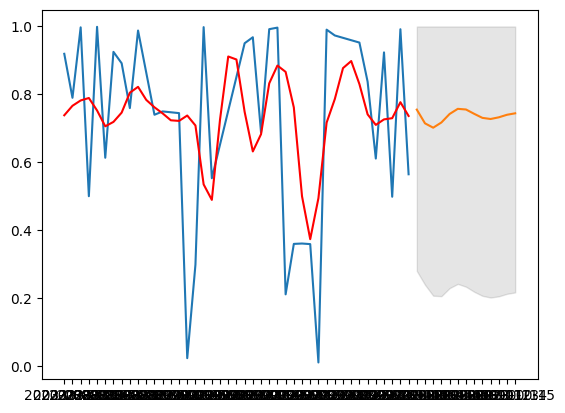

In [ ]:
model = ARIMA(model_data['NSC']['train_data']['sentiment'], order=(2, 0, 2), freq='D')
results = model.fit()
print(results.summary())
# plt.xticks(rotation=45)
plt.plot(model_data['NSC']['train_data']['sentiment'])
plt.plot(results.fittedvalues, color='red')
fcast = results.get_forecast('2023-10-15').summary_frame()
fcast.index = fcast.index.strftime("%Y-%m-%d")
plt.plot(fcast['mean'])
fcast['mean_ci_upper'] = fcast['mean_ci_upper'].apply(lambda x: x if x < 1.00 else 1.00)
plt.fill_between(fcast.index, fcast['mean_ci_lower'], fcast['mean_ci_upper'], color='k', alpha=0.1);

count    84.000000
mean     -0.000008
std       0.034534
min      -0.097178
25%      -0.017024
50%      -0.000314
75%       0.024950
max       0.093096
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


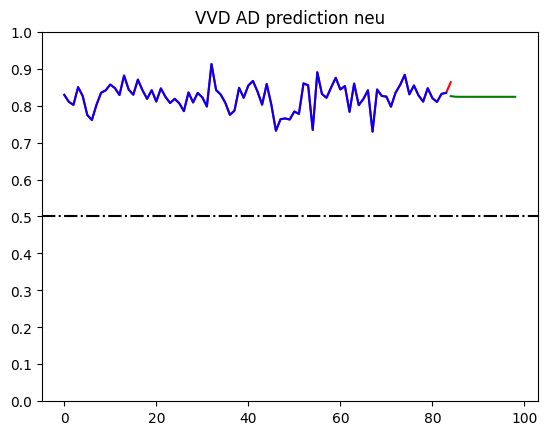

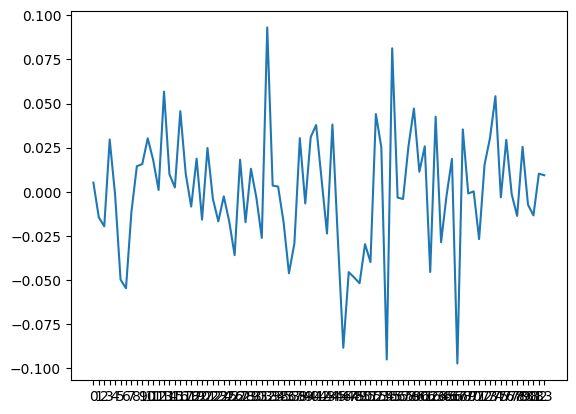

count    84.000000
mean     -0.000672
std       0.021758
min      -0.060350
25%      -0.013851
50%      -0.001853
75%       0.011865
max       0.069040
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


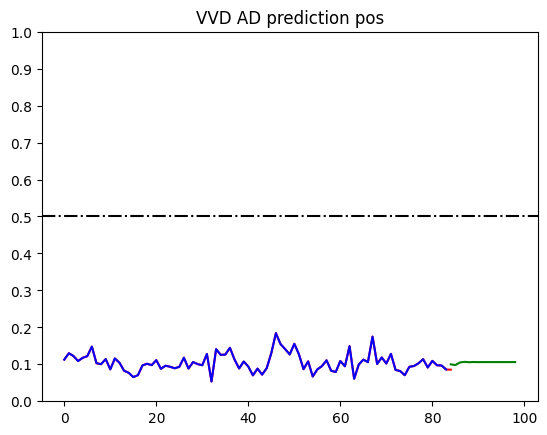

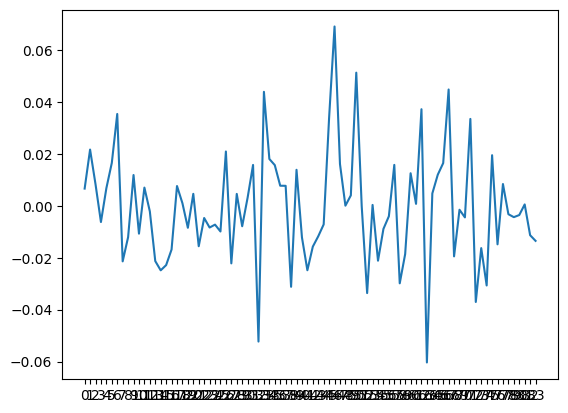

count    8.400000e+01
mean    -2.296443e-17
std      2.474027e-02
min     -5.383461e-02
25%     -1.445961e-02
50%     -1.784609e-03
75%      8.941365e-03
max      1.286654e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


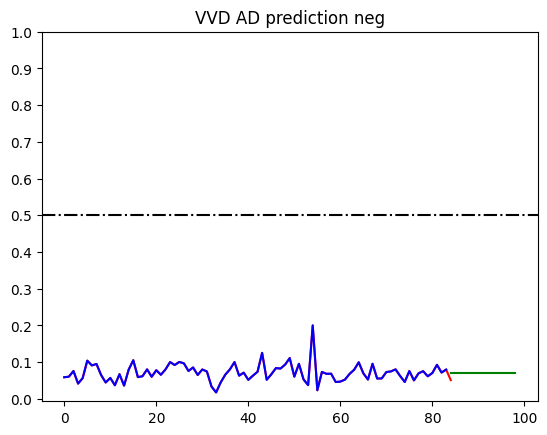

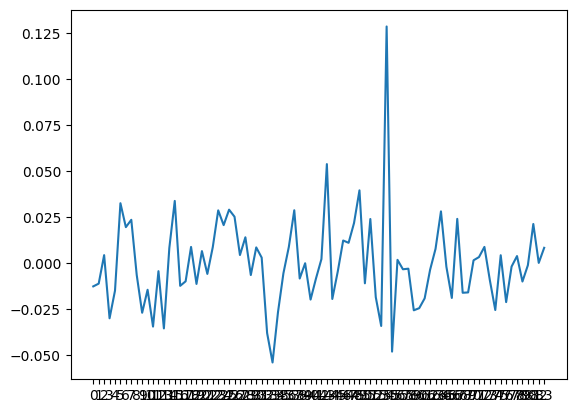

count    58.000000
mean     -0.000283
std       0.042916
min      -0.133324
25%      -0.017284
50%       0.006755
75%       0.023409
max       0.079538
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


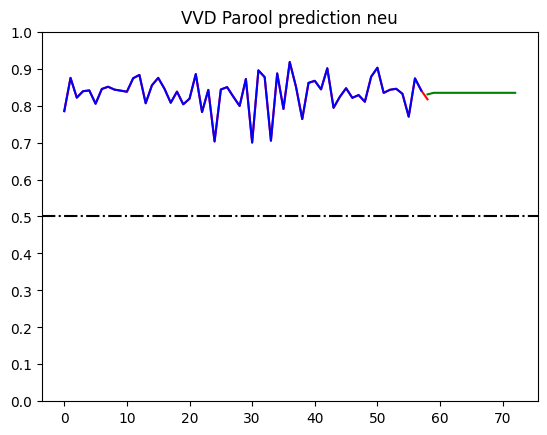

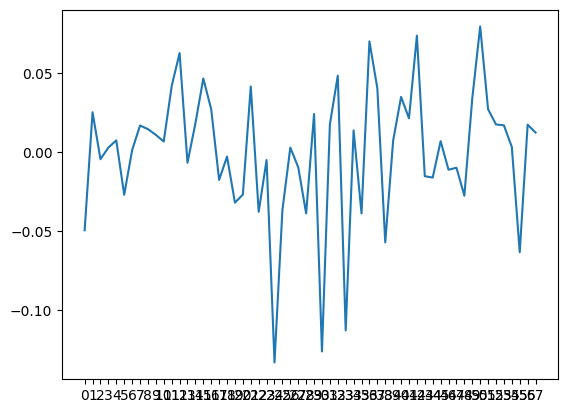

count    58.000000
mean      0.000403
std       0.032861
min      -0.078826
25%      -0.021630
50%      -0.005881
75%       0.017206
max       0.076832
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


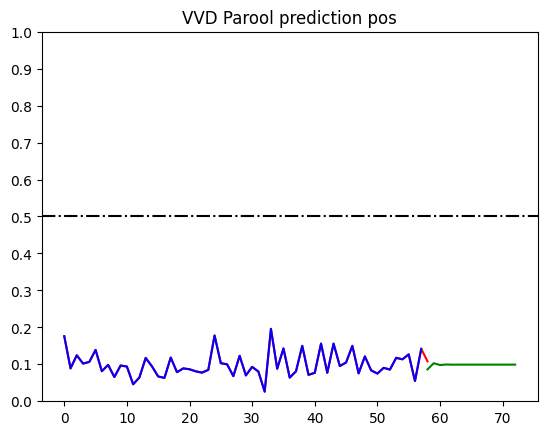

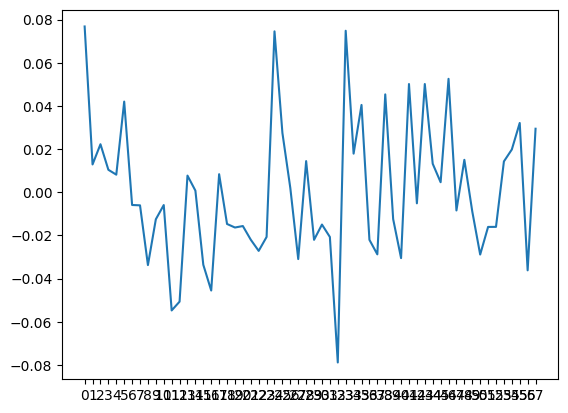

count    5.800000e+01
mean     1.213572e-12
std      3.367566e-02
min     -6.588448e-02
25%     -1.588448e-02
50%     -1.259483e-03
75%      1.511552e-02
max      1.421155e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


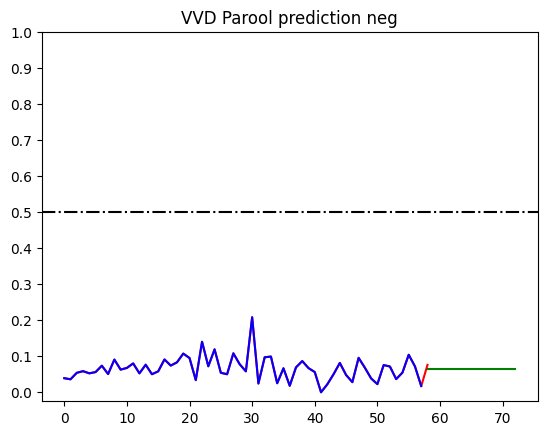

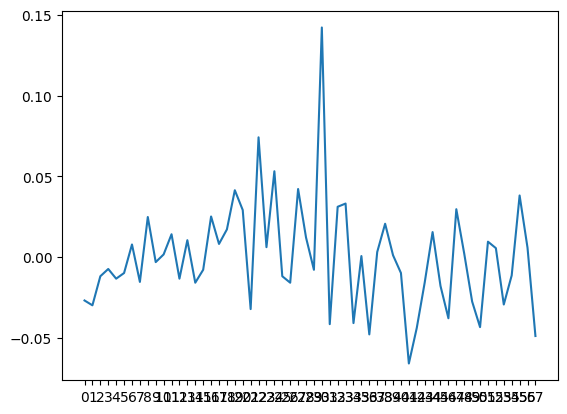

count    8.000000e+01
mean     1.124748e-12
std      3.540761e-02
min     -7.950685e-02
25%     -2.213185e-02
50%      1.093155e-03
75%      2.003482e-02
max      1.084932e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


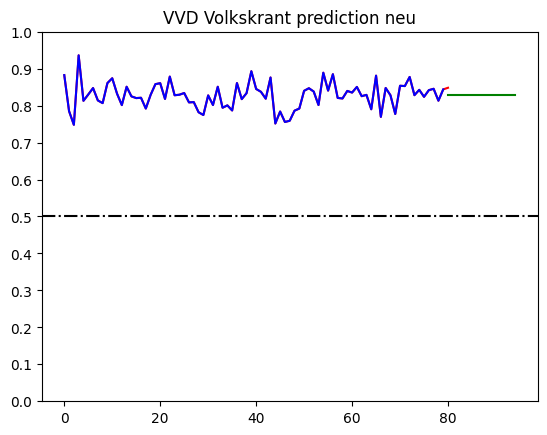

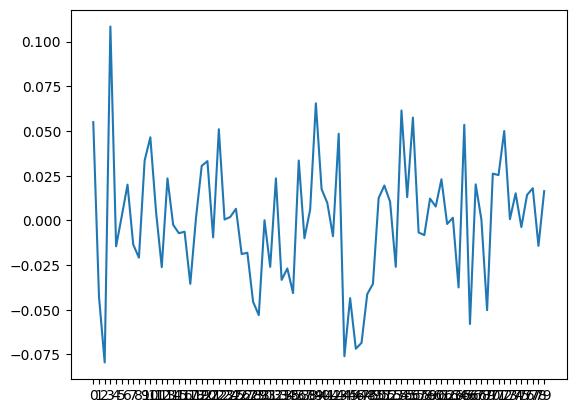

count    8.000000e+01
mean     5.386328e-12
std      2.532613e-02
min     -5.585589e-02
25%     -1.560589e-02
50%     -2.272560e-03
75%      1.872744e-02
max      6.164411e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


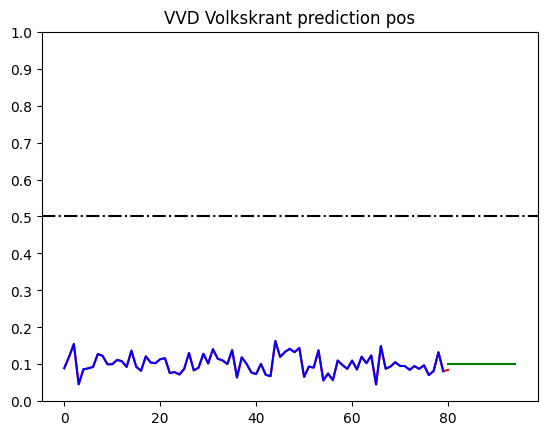

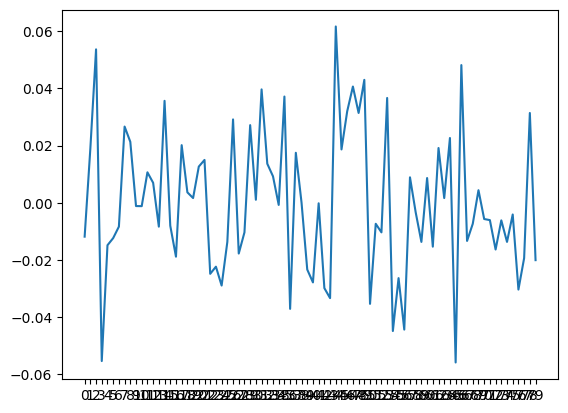

count    80.000000
mean      0.000090
std       0.022434
min      -0.056701
25%      -0.014374
50%      -0.000254
75%       0.017695
max       0.049211
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


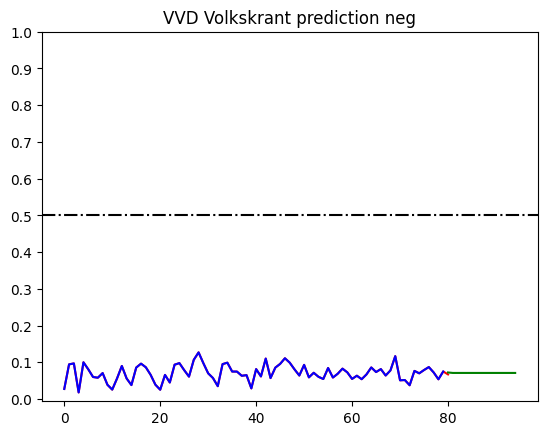

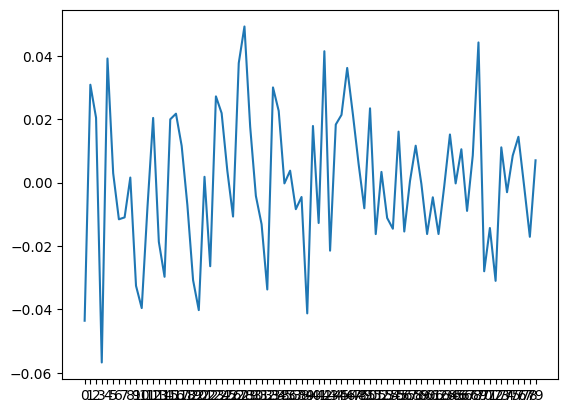

count    79.000000
mean     -0.000148
std       0.043294
min      -0.098332
25%      -0.021821
50%       0.004139
75%       0.027426
max       0.139876
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


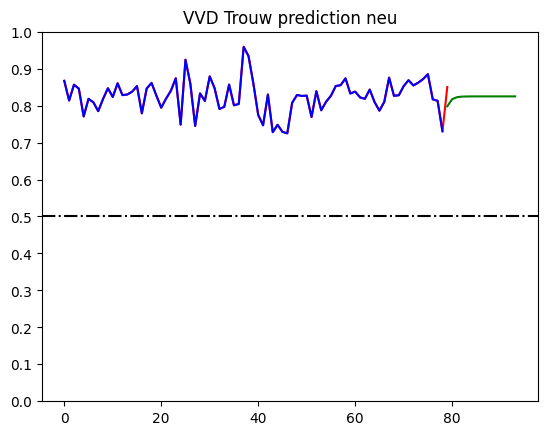

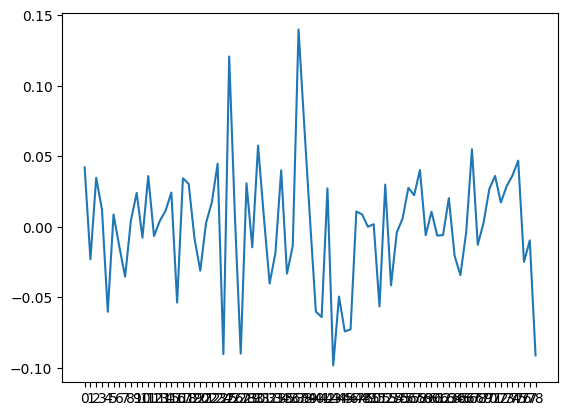

count    79.000000
mean     -0.000002
std       0.031910
min      -0.076481
25%      -0.016525
50%      -0.001631
75%       0.018057
max       0.082854
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


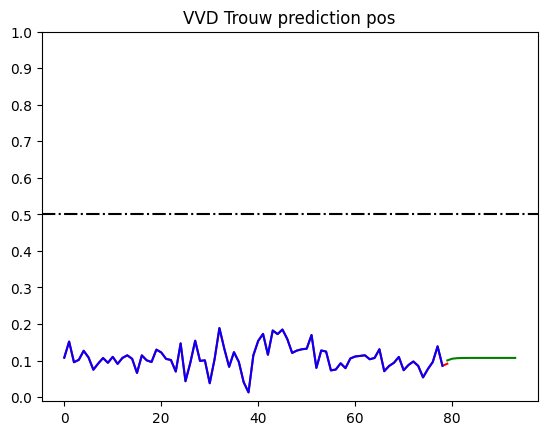

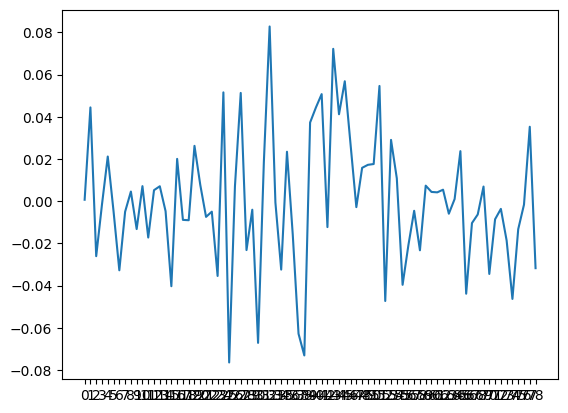

count    7.900000e+01
mean     2.295672e-12
std      2.742047e-02
min     -6.740366e-02
25%     -1.850366e-02
50%     -2.153657e-03
75%      1.437134e-02
max      1.165963e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


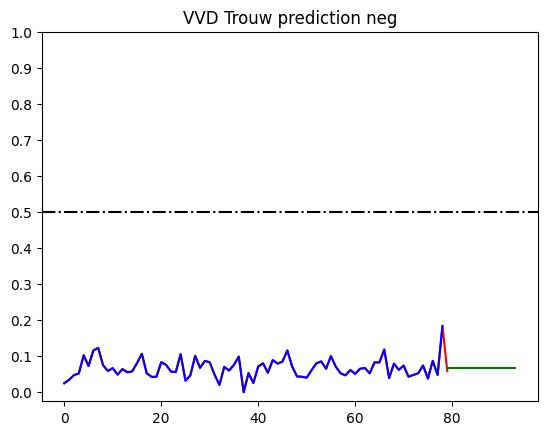

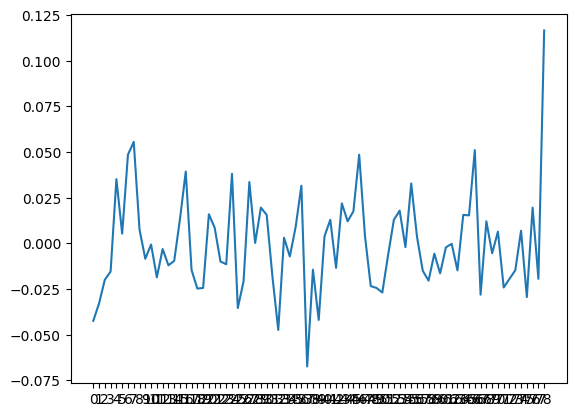

count    75.000000
mean     -0.000001
std       0.031686
min      -0.084846
25%      -0.016709
50%       0.001437
75%       0.018881
max       0.069590
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


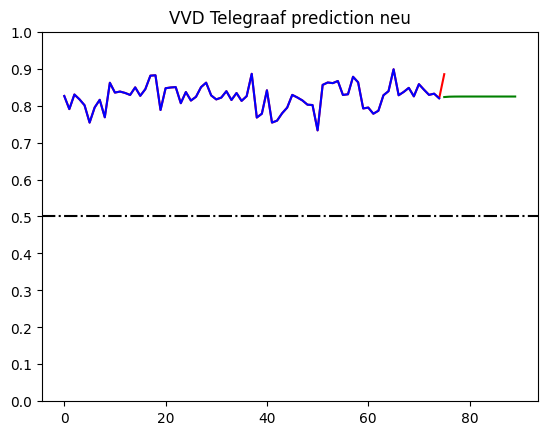

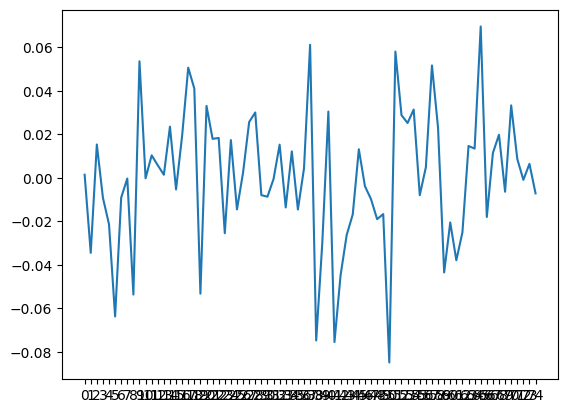

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


count    7.500000e+01
mean     1.660701e-12
std      2.786127e-02
min     -4.994453e-02
25%     -1.761120e-02
50%     -2.944532e-03
75%      1.305547e-02
max      8.905547e-02
dtype: float64


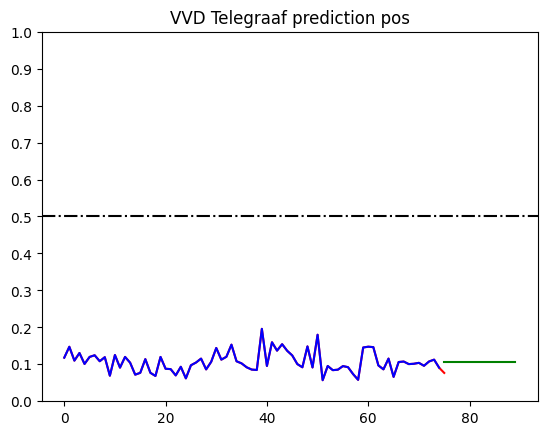

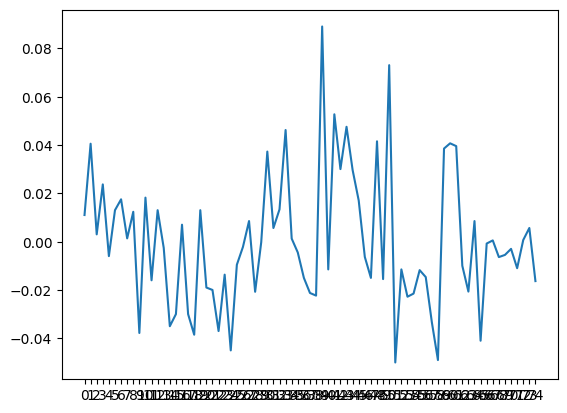

count    7.500000e+01
mean     1.504316e-12
std      2.405072e-02
min     -4.250440e-02
25%     -1.805440e-02
50%     -2.904403e-03
75%      1.499560e-02
max      7.916226e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


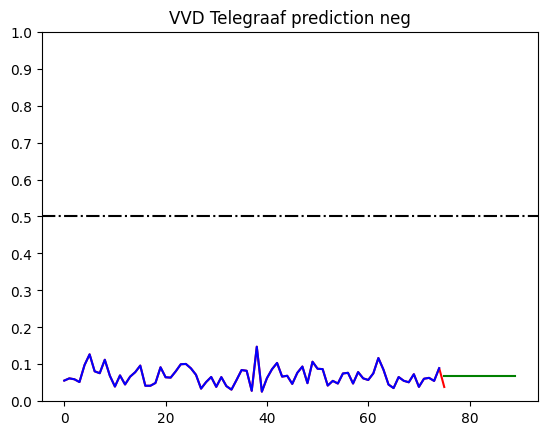

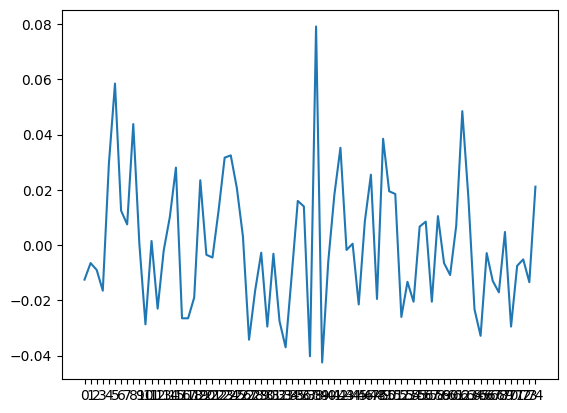

count    83.000000
mean     -0.000036
std       0.027442
min      -0.137224
25%      -0.011923
50%       0.002773
75%       0.017973
max       0.043135
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


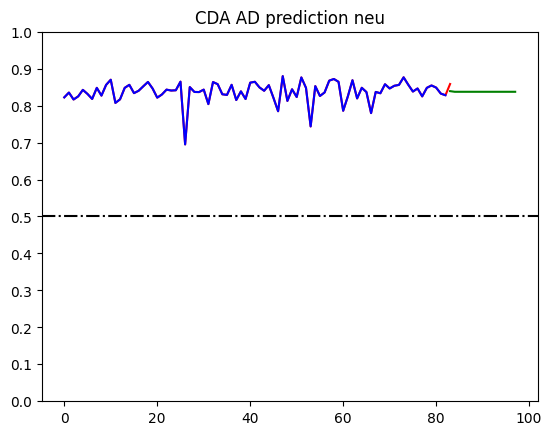

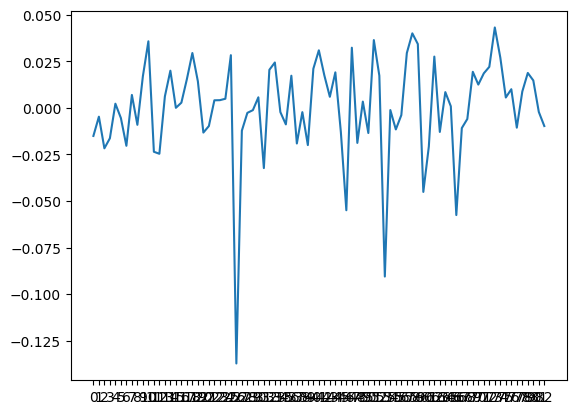

count    8.300000e+01
mean     1.648833e-12
std      2.140143e-02
min     -4.277956e-02
25%     -1.202956e-02
50%      5.377655e-05
75%      1.067878e-02
max      1.177204e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


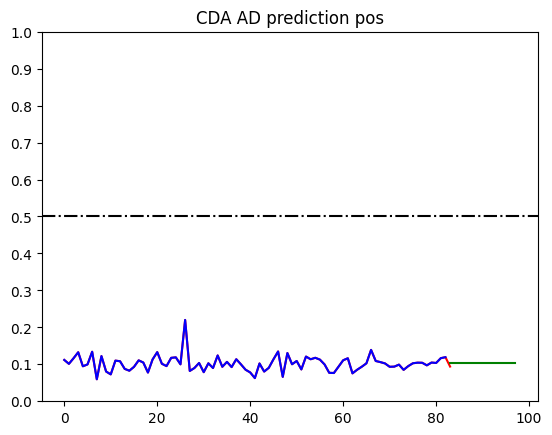

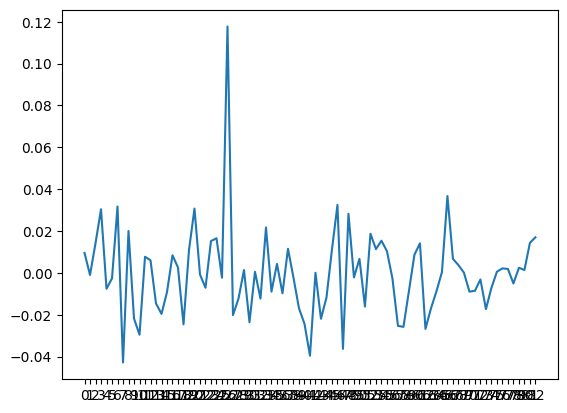

count    83.000000
mean      0.000021
std       0.018168
min      -0.043791
25%      -0.010550
50%      -0.001845
75%       0.007749
max       0.076818
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


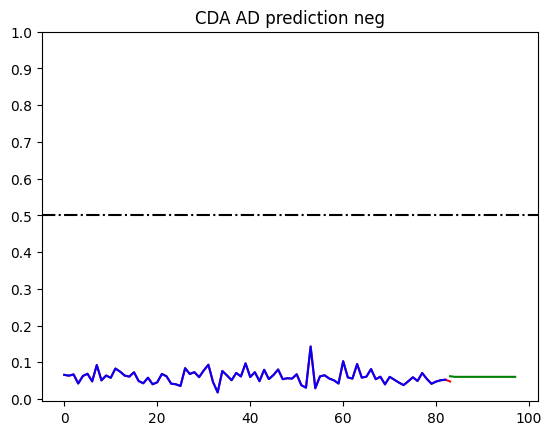

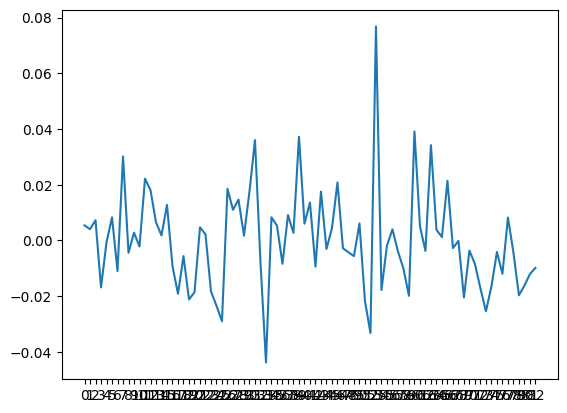

count    3.800000e+01
mean    -1.285521e-16
std      4.781122e-02
min     -1.239912e-01
25%     -1.586623e-02
50%      1.000877e-02
75%      3.650877e-02
max      6.300877e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


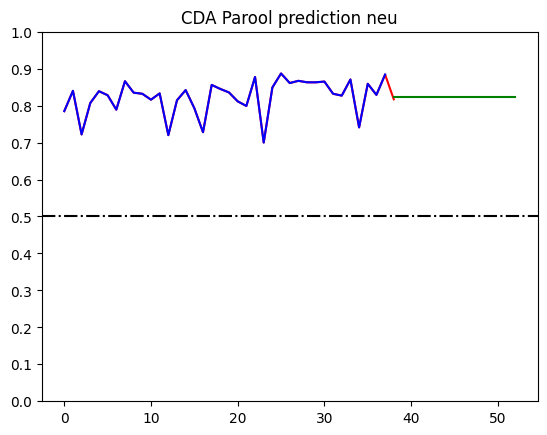

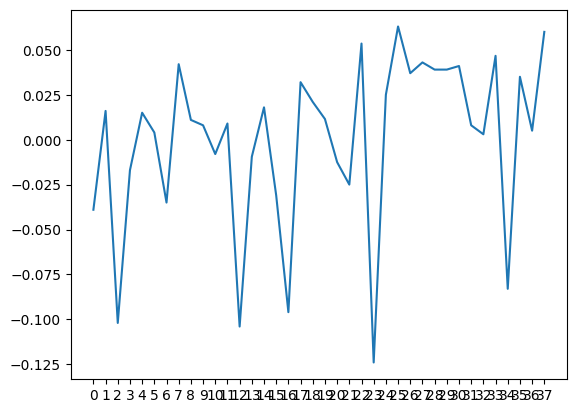

count    3.800000e+01
mean     5.688473e-12
std      3.961375e-02
min     -6.396491e-02
25%     -2.071491e-02
50%     -6.298246e-03
75%      1.778509e-02
max      1.650351e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


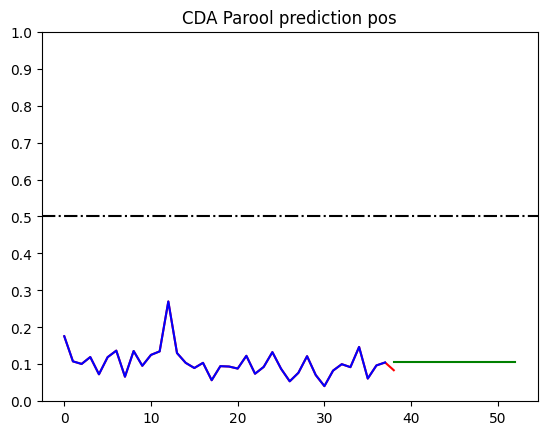

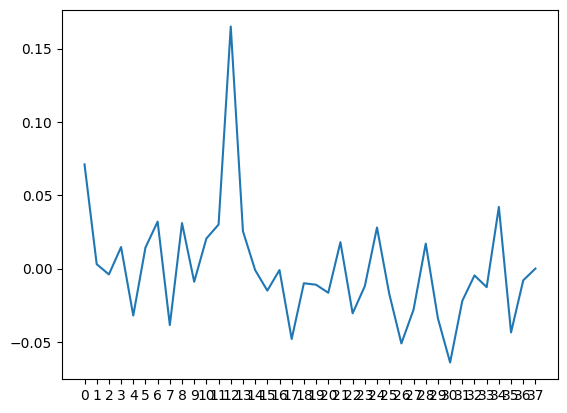

count    3.800000e+01
mean     7.016023e-12
std      4.303080e-02
min     -6.191667e-02
25%     -2.191667e-02
50%     -1.666667e-03
75%      1.383333e-02
max      1.370833e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


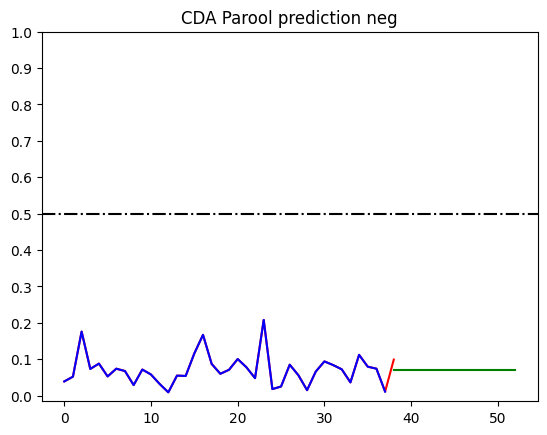

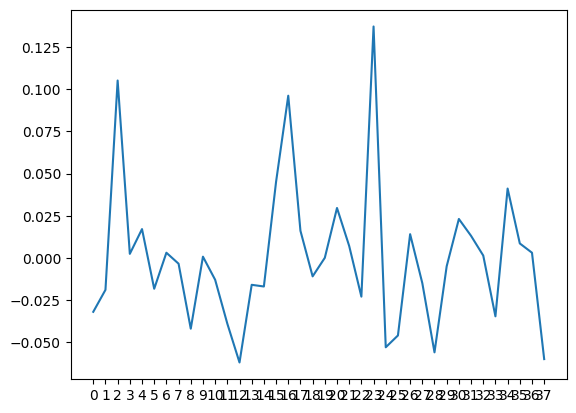

count    72.000000
mean     -0.000006
std       0.043909
min      -0.140621
25%      -0.022701
50%       0.004271
75%       0.030458
max       0.100023
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


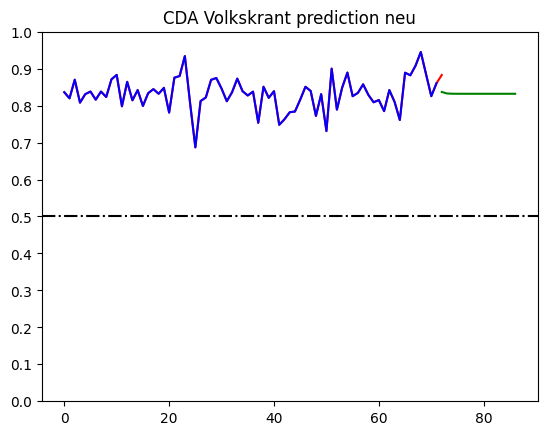

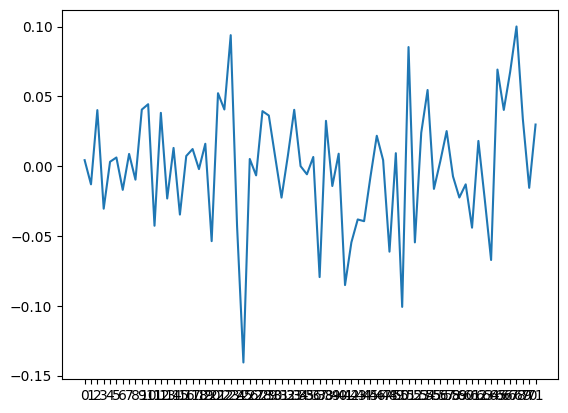

count    7.200000e+01
mean     8.751207e-12
std      3.002098e-02
min     -6.453565e-02
25%     -1.807731e-02
50%     -2.285648e-03
75%      2.096435e-02
max      8.446435e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


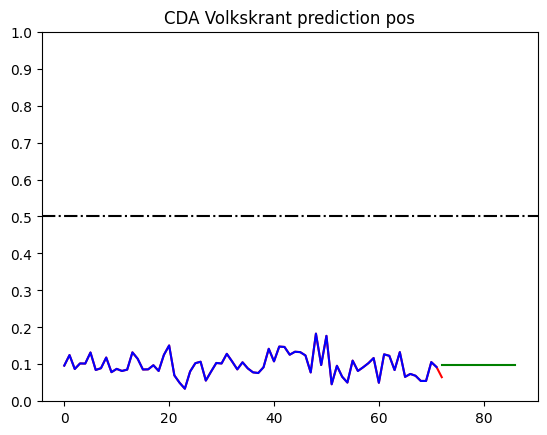

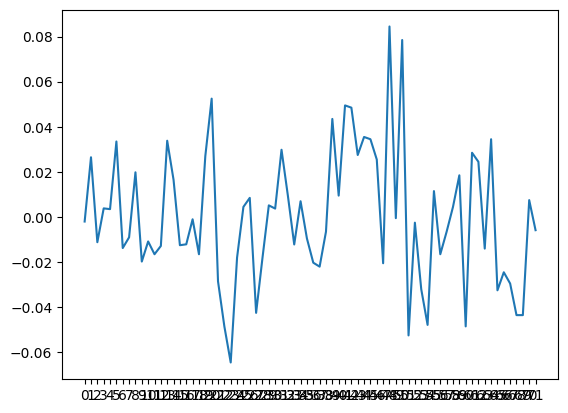

count    7.200000e+01
mean     6.759156e-12
std      3.427750e-02
min     -6.955093e-02
25%     -1.963426e-02
50%     -7.300926e-03
75%      1.569907e-02
max      1.404491e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


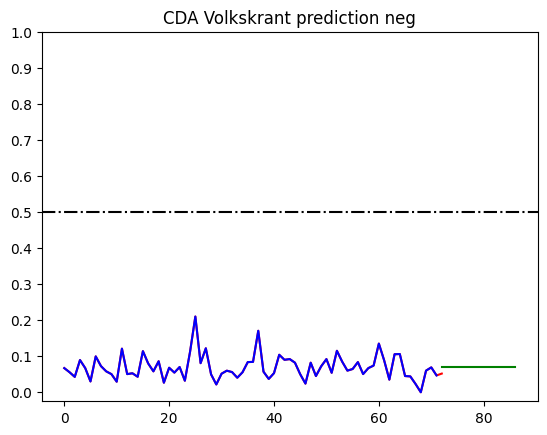

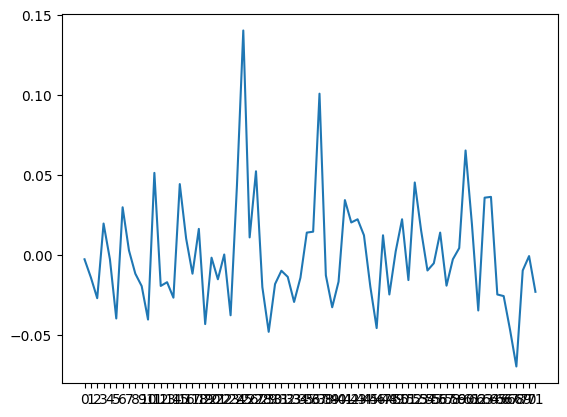

count    7.000000e+01
mean    -9.833404e-17
std      3.877703e-02
min     -7.485548e-02
25%     -2.471857e-02
50%      1.644524e-03
75%      2.462667e-02
max      1.391445e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


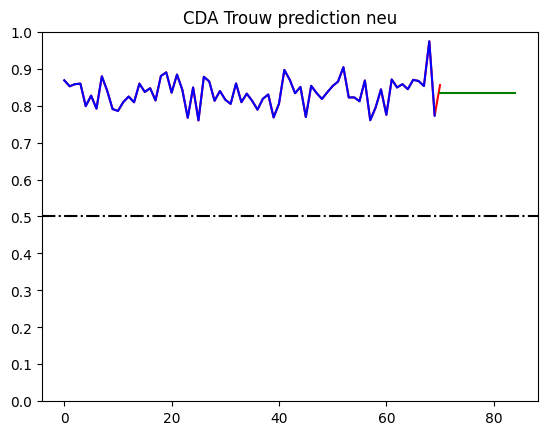

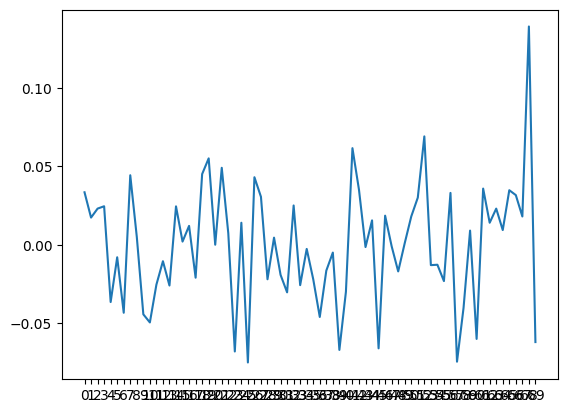

count    7.000000e+01
mean     4.089594e-12
std      2.746219e-02
min     -7.466323e-02
25%     -1.666323e-02
50%     -4.663231e-03
75%      1.508677e-02
max      6.933677e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


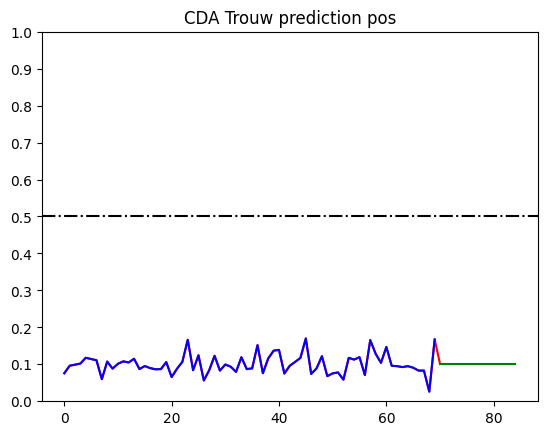

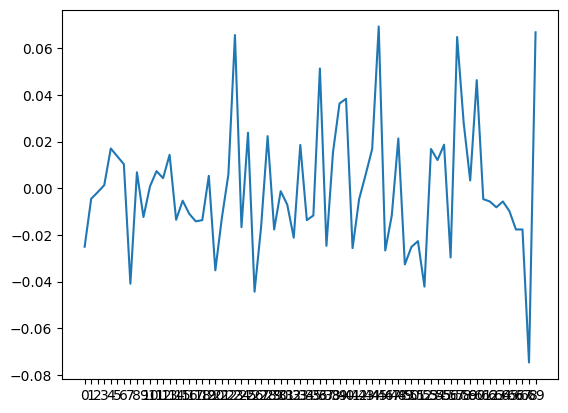

count    7.000000e+01
mean     4.648739e-12
std      2.373254e-02
min     -6.447799e-02
25%     -1.256728e-02
50%     -3.477993e-03
75%      1.239701e-02
max      5.652201e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


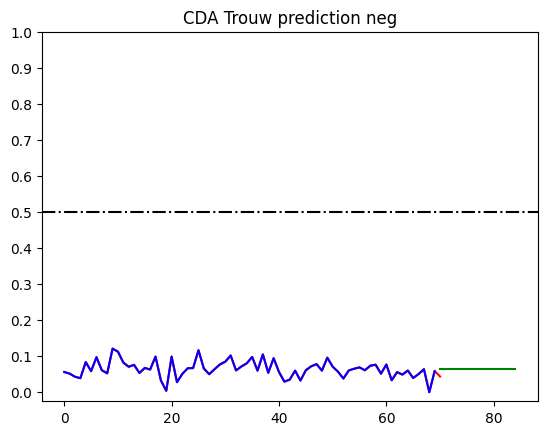

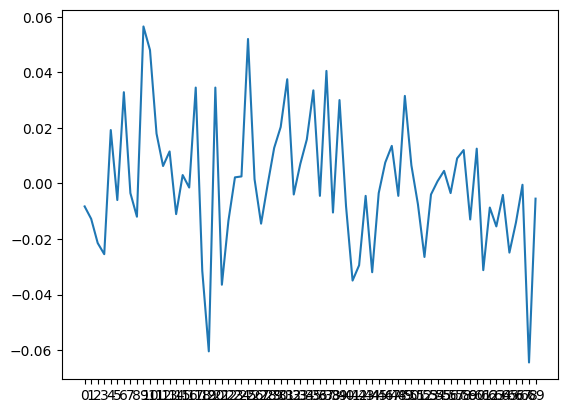

count    7.000000e+01
mean     5.159397e-13
std      3.751301e-02
min     -8.486247e-02
25%     -1.961247e-02
50%      5.220862e-03
75%      2.408197e-02
max      8.413753e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


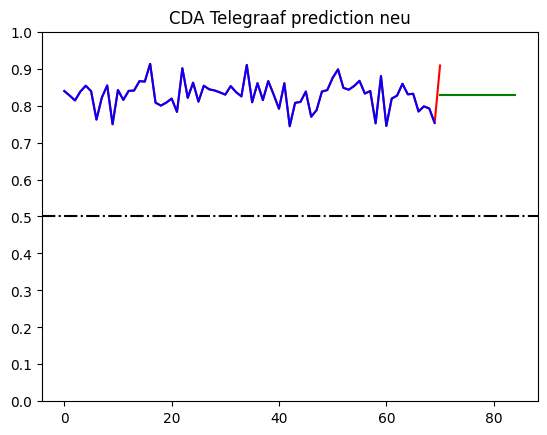

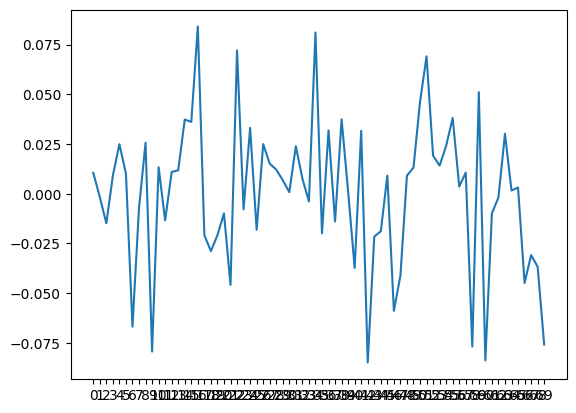

count    7.000000e+01
mean     5.649575e-11
std      3.470925e-02
min     -8.536986e-02
25%     -1.226986e-02
50%     -3.203197e-03
75%      1.538014e-02
max      1.096301e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


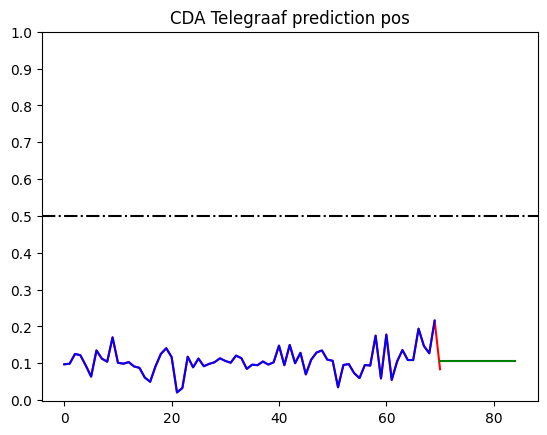

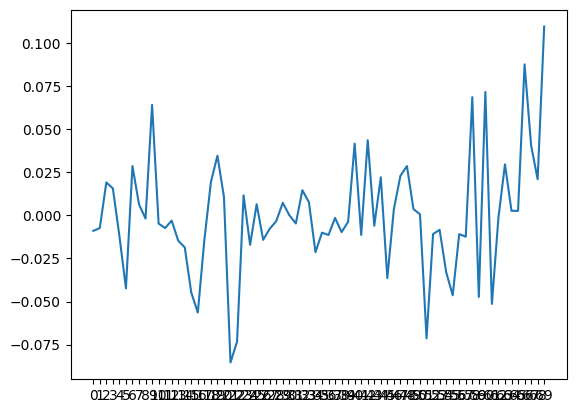

count    7.000000e+01
mean     5.368721e-13
std      2.814329e-02
min     -6.081200e-02
25%     -1.393700e-02
50%     -2.811995e-03
75%      9.438005e-03
max      1.311880e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


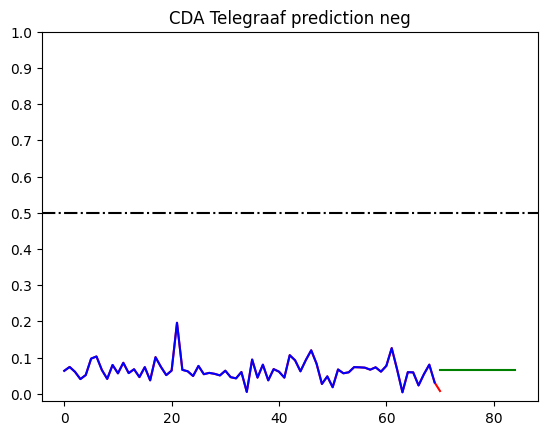

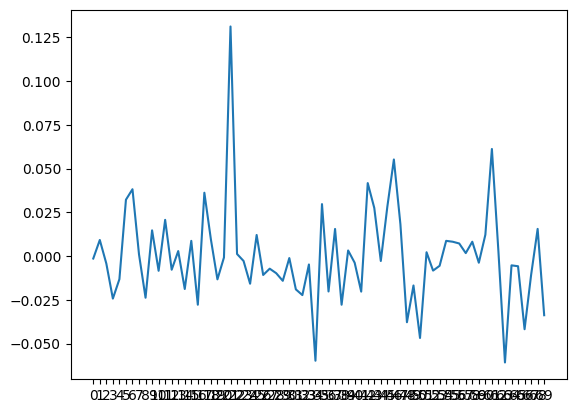

count    7.800000e+01
mean     1.152924e-16
std      2.838923e-02
min     -5.863801e-02
25%     -1.523176e-02
50%     -2.380138e-04
75%      1.178699e-02
max      1.023620e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


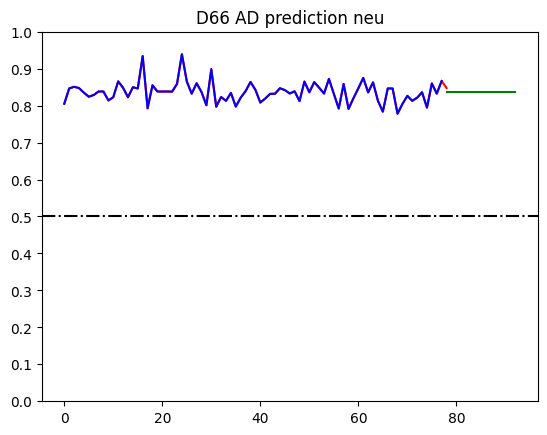

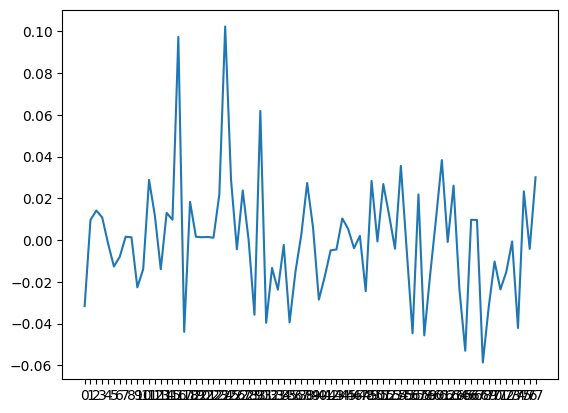

count    7.800000e+01
mean     2.108244e-11
std      2.348371e-02
min     -6.901560e-02
25%     -1.245310e-02
50%      1.151064e-03
75%      1.677606e-02
max      5.548440e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


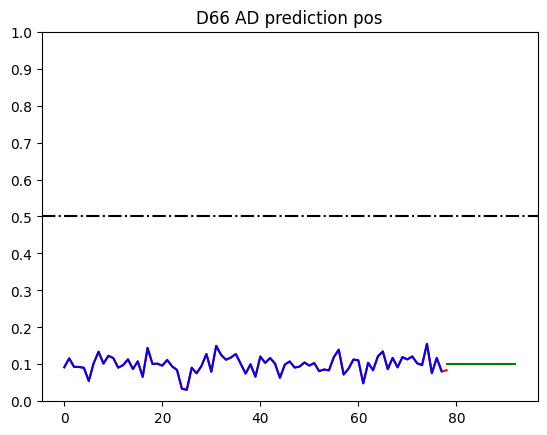

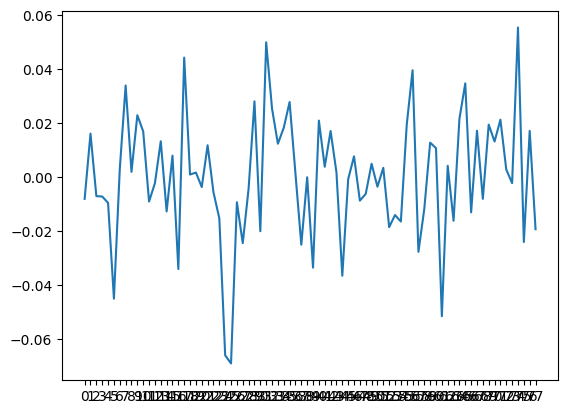

count    7.800000e+01
mean     4.181128e-18
std      2.162280e-02
min     -6.336142e-02
25%     -1.232570e-02
50%      7.385827e-04
75%      1.007162e-02
max      6.663858e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


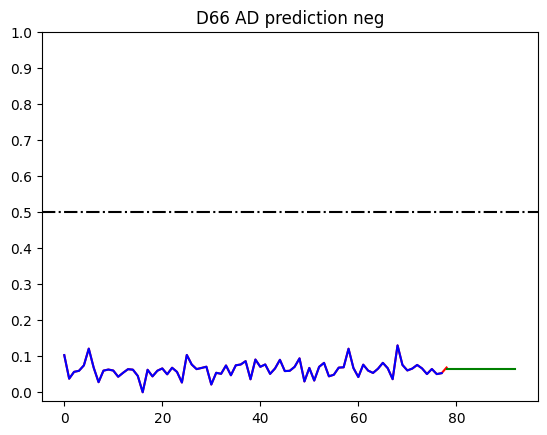

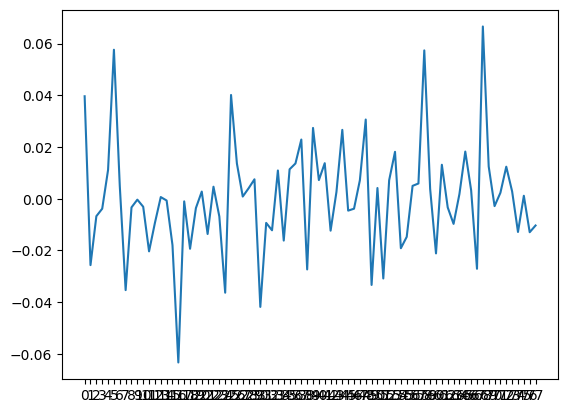

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


count    4.200000e+01
mean     2.645385e-11
std      4.818133e-02
min     -1.321627e-01
25%     -2.591270e-02
50%      1.837302e-03
75%      2.971230e-02
max      9.483730e-02
dtype: float64


/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


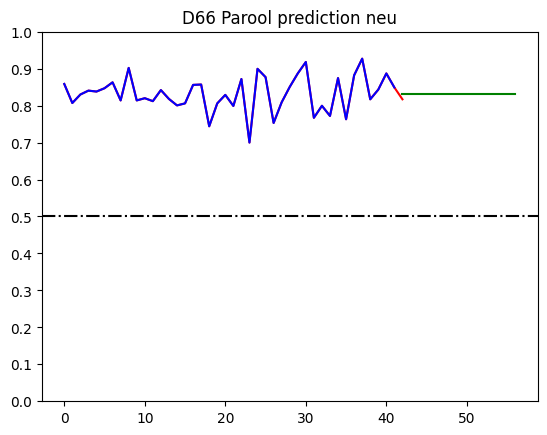

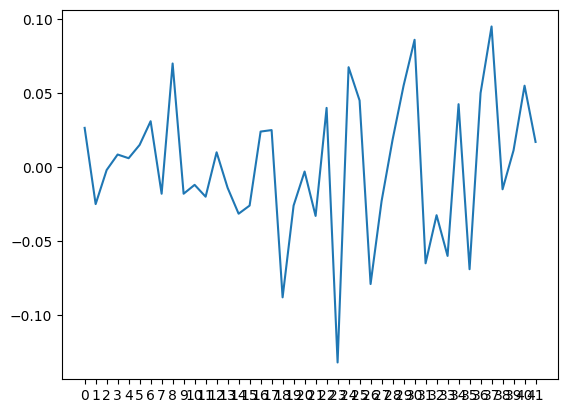

count    4.200000e+01
mean     4.068365e-12
std      3.517638e-02
min     -7.272619e-02
25%     -1.972619e-02
50%     -3.726190e-03
75%      1.202381e-02
max      1.122738e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


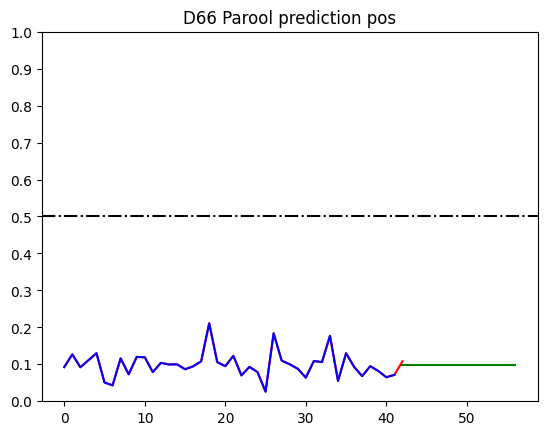

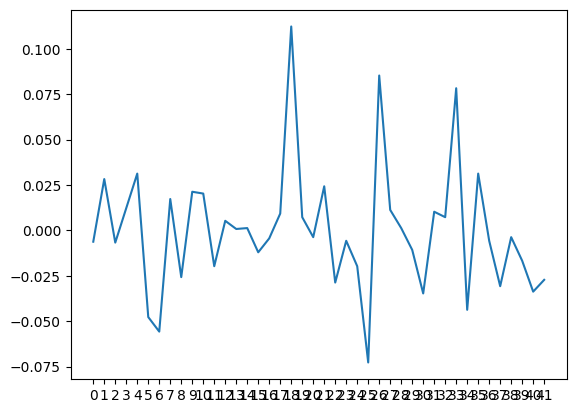

count    42.000000
mean     -0.000065
std       0.032287
min      -0.059898
25%      -0.022554
50%       0.004113
75%       0.018953
max       0.106955
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


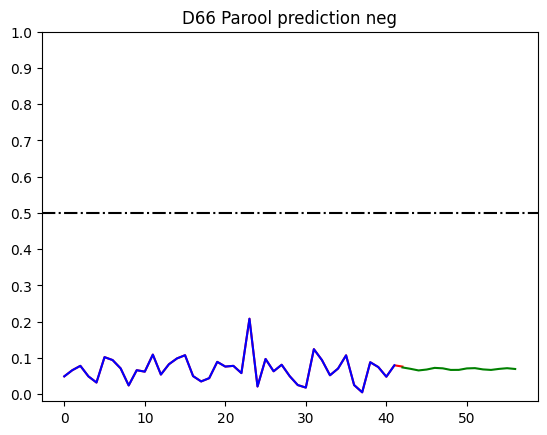

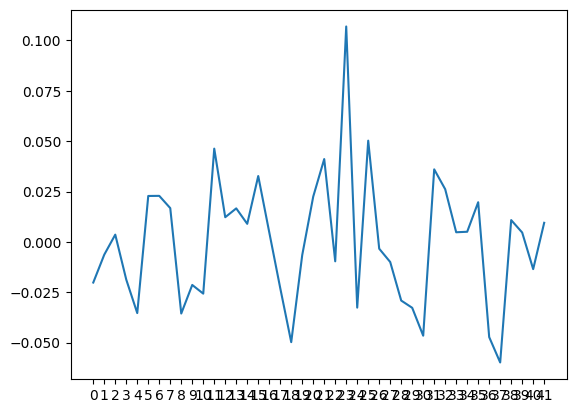

count    6.700000e+01
mean     7.110538e-12
std      3.666393e-02
min     -9.743806e-02
25%     -2.031306e-02
50%      1.561940e-03
75%      2.031194e-02
max      1.075619e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


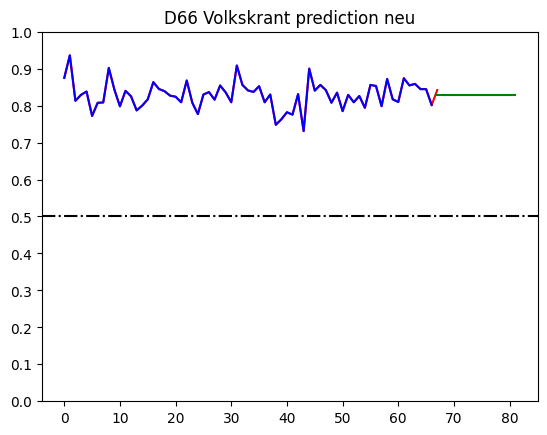

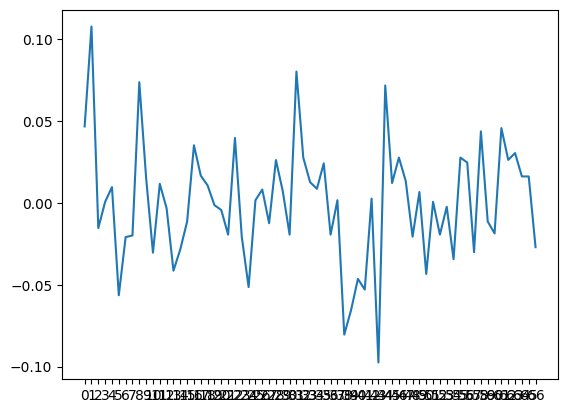

count    6.700000e+01
mean     7.883078e-12
std      3.081810e-02
min     -1.013900e-01
25%     -1.901505e-02
50%      4.109950e-03
75%      1.785995e-02
max      7.560995e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


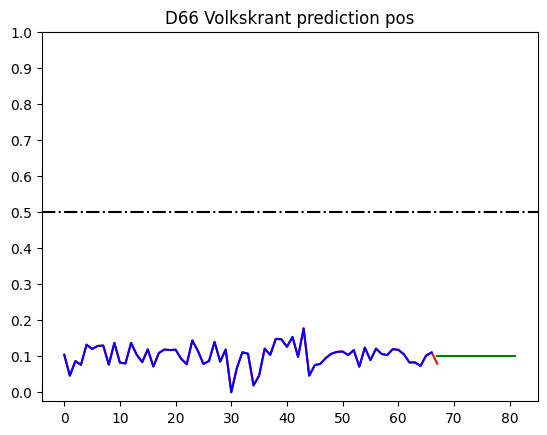

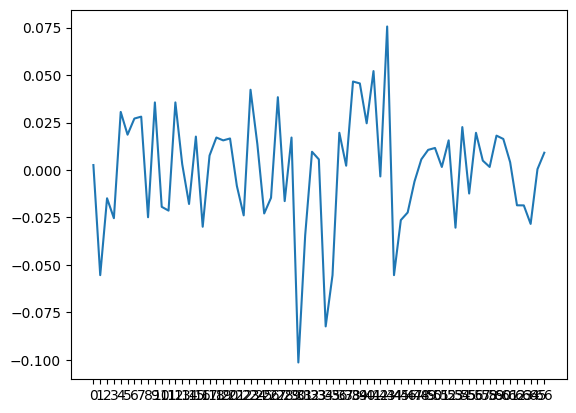

count    6.700000e+01
mean     1.089570e-11
std      3.201664e-02
min     -5.217189e-02
25%     -1.767189e-02
50%     -5.171891e-03
75%      2.182811e-02
max      1.208281e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


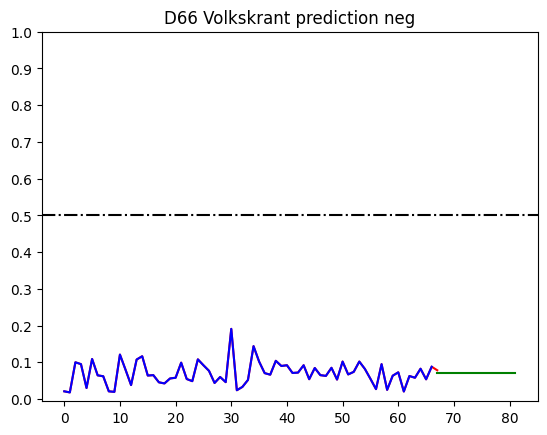

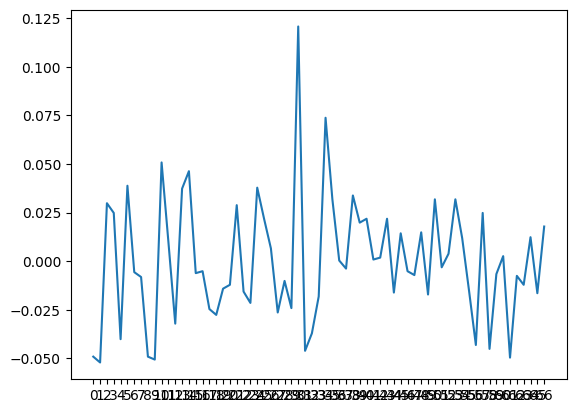

count    6.500000e+01
mean     7.778820e-12
std      3.960648e-02
min     -9.564590e-02
25%     -1.714590e-02
50%     -1.458974e-04
75%      2.135410e-02
max      1.708541e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


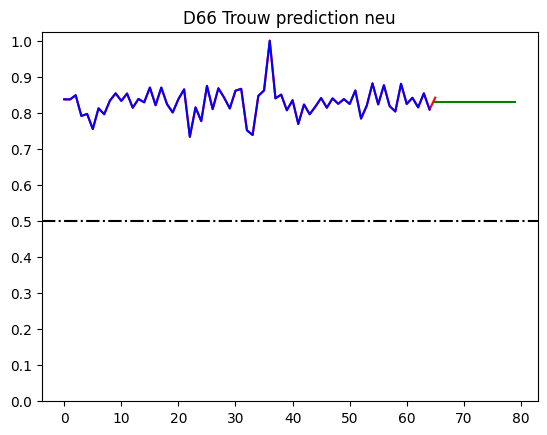

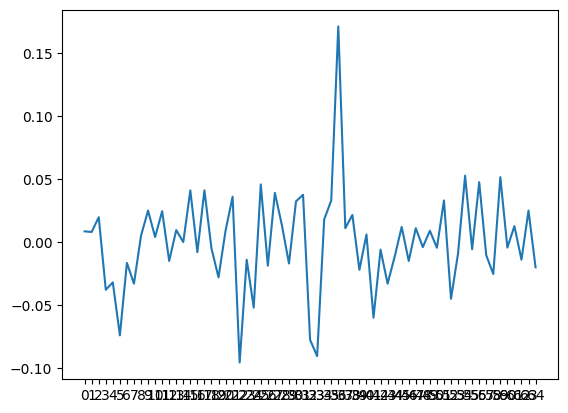

count    6.500000e+01
mean     1.406494e-11
std      3.405523e-02
min     -1.086546e-01
25%     -2.265462e-02
50%     -2.904615e-03
75%      1.884538e-02
max      1.018454e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


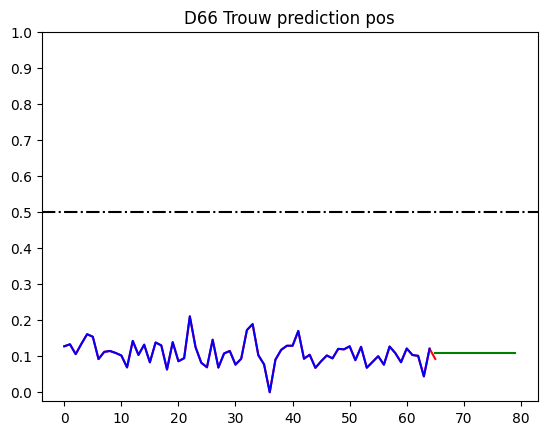

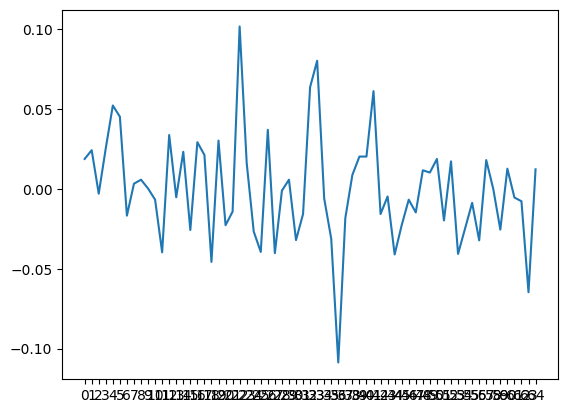

count    65.000000
mean      0.000003
std       0.024174
min      -0.062123
25%      -0.016310
50%      -0.003413
75%       0.010918
max       0.074635
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


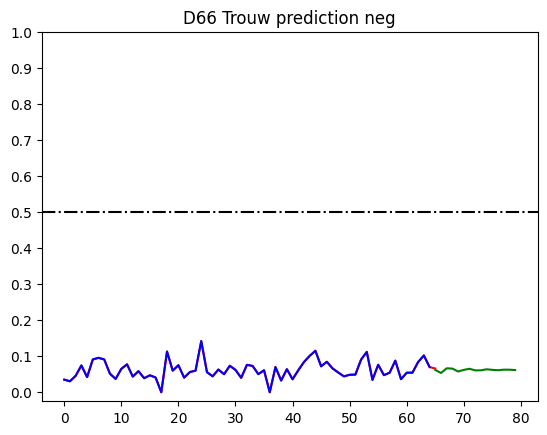

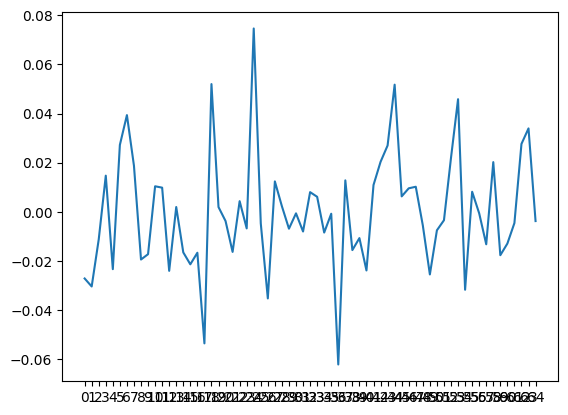

count    6.700000e+01
mean    -3.479804e-17
std      3.266992e-02
min     -7.673575e-02
25%     -2.006908e-02
50%     -7.357498e-04
75%      1.884758e-02
max      8.526425e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


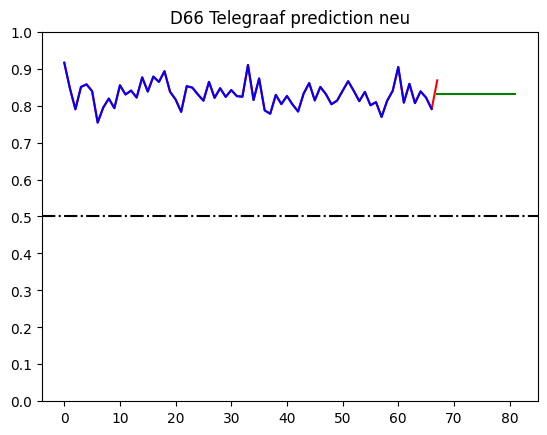

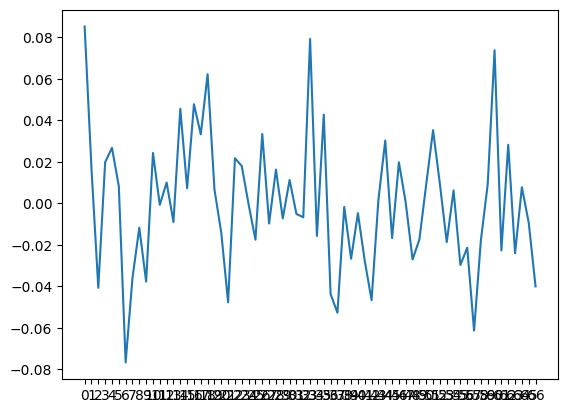

count    6.700000e+01
mean    -1.905607e-17
std      2.794684e-02
min     -8.789808e-02
25%     -1.906475e-02
50%      3.101919e-03
75%      1.393525e-02
max      8.710192e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


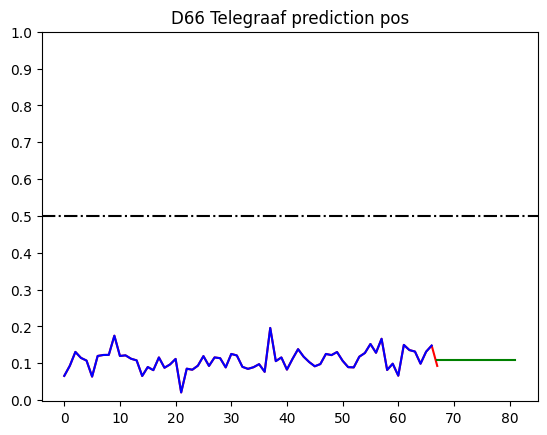

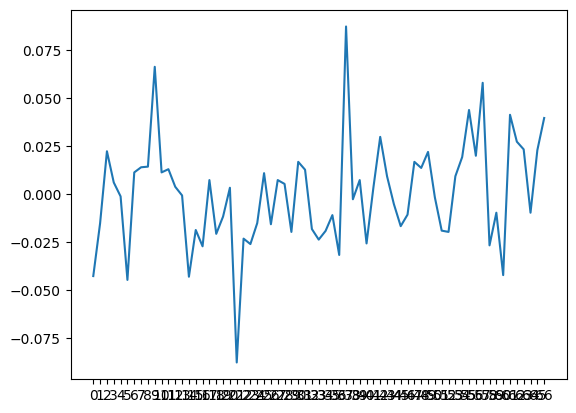

count    6.700000e+01
mean     2.283833e-11
std      3.084801e-02
min     -5.634701e-02
25%     -1.984701e-02
50%     -3.470149e-04
75%      1.281965e-02
max      1.356530e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


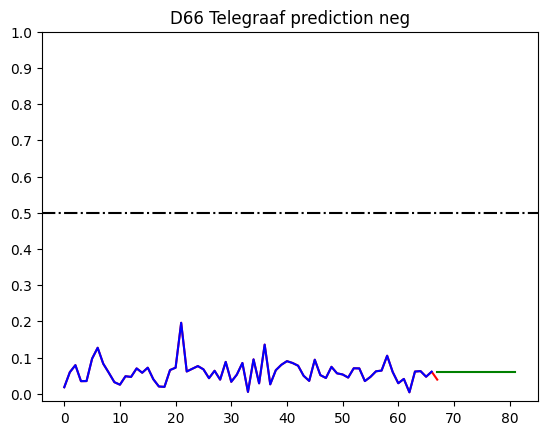

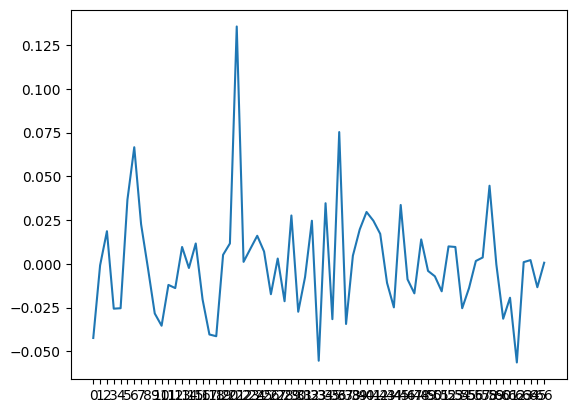

count    58.000000
mean     -0.000173
std       0.044316
min      -0.148345
25%      -0.017998
50%       0.000939
75%       0.023377
max       0.089337
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


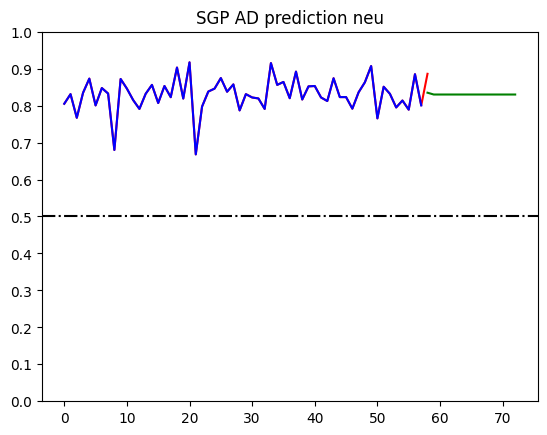

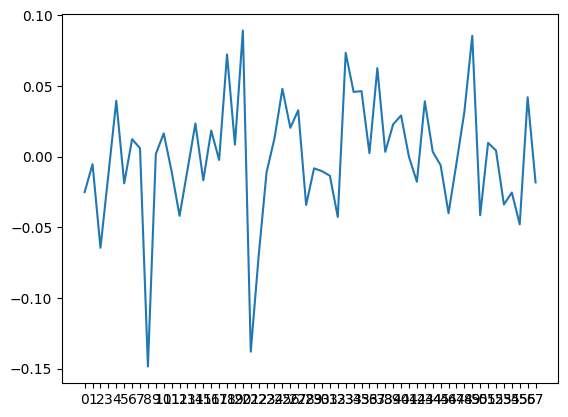

count    5.800000e+01
mean     7.134798e-12
std      3.451717e-02
min     -6.337519e-02
25%     -2.300019e-02
50%     -1.208525e-03
75%      1.687481e-02
max      1.226248e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


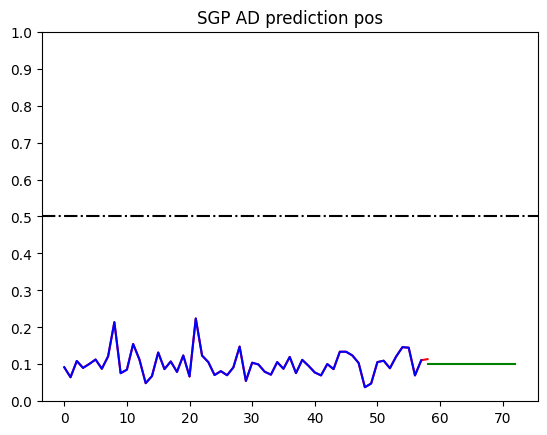

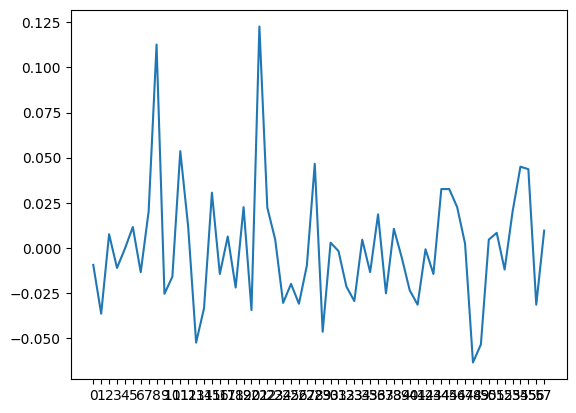

count    5.800000e+01
mean     7.164276e-12
std      2.905679e-02
min     -5.584387e-02
25%     -2.321887e-02
50%     -1.593870e-03
75%      1.790613e-02
max      5.965613e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


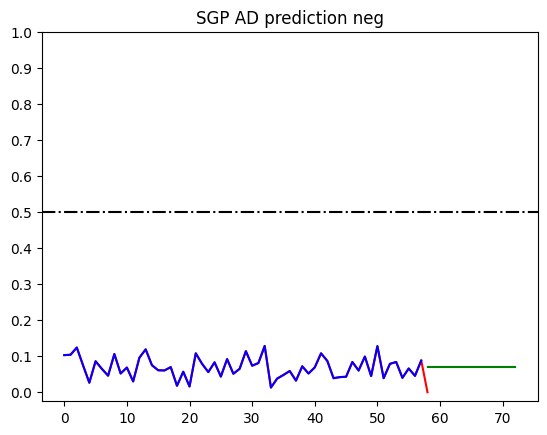

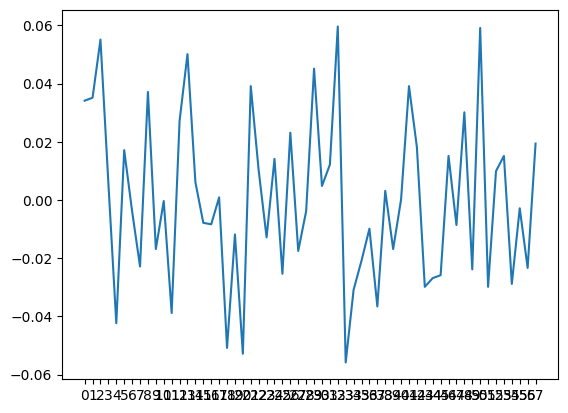

count    8.000000e+00
mean     3.358841e-13
std      6.396372e-02
min     -1.362500e-01
25%     -1.625000e-02
50%      3.750000e-03
75%      4.350000e-02
max      7.275000e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


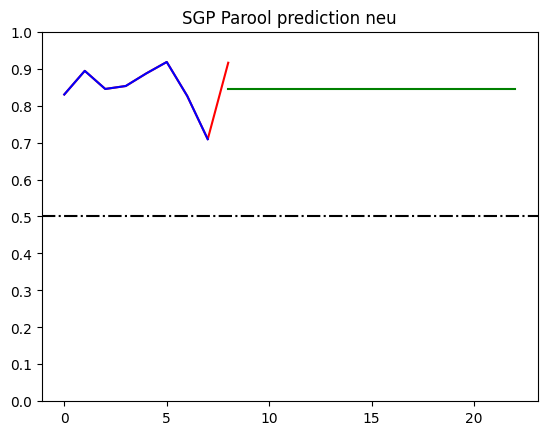

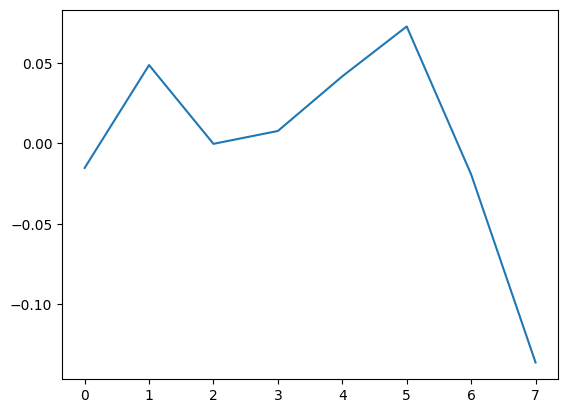

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


count    8.000000e+00
mean     2.081668e-17
std      3.957610e-02
min     -3.662500e-02
25%     -2.112500e-02
50%     -1.312500e-02
75%      6.125000e-03
max      9.037500e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


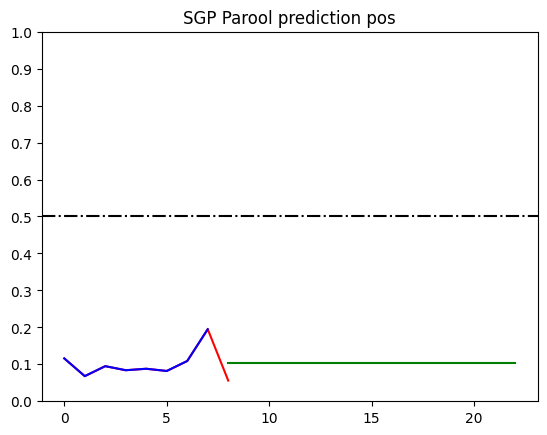

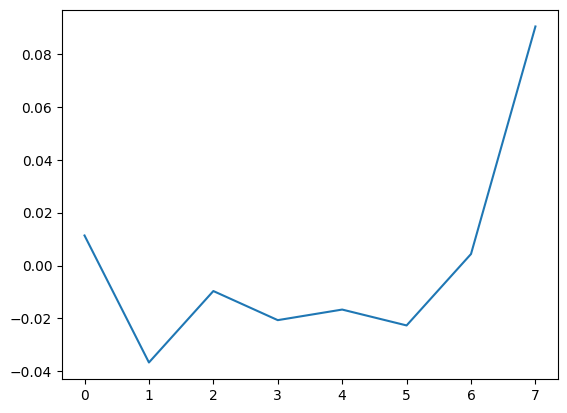

count    8.000000
mean    -0.001027
std      0.023406
min     -0.032074
25%     -0.018084
50%     -0.000713
75%      0.012637
max      0.038394
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


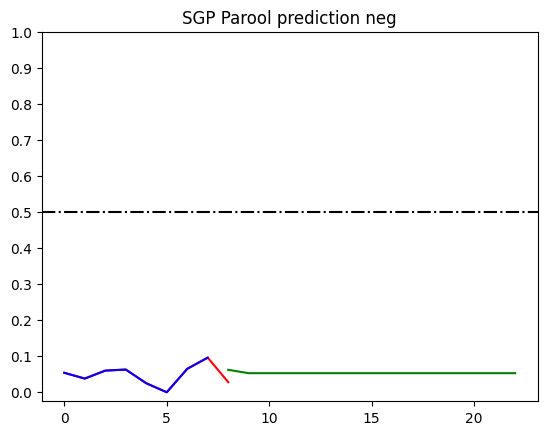

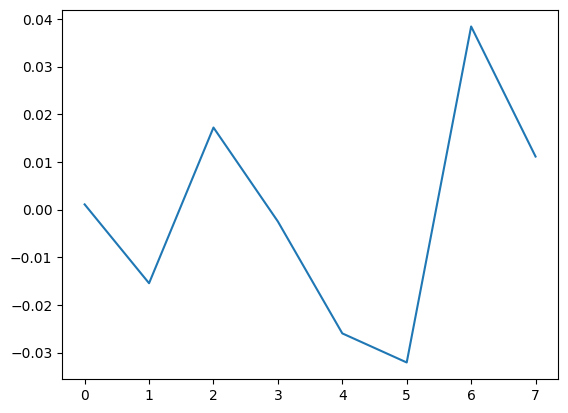

count    23.000000
mean      0.034196
std       0.170622
min      -0.048047
25%      -0.019893
50%       0.001773
75%       0.014117
max       0.806418
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


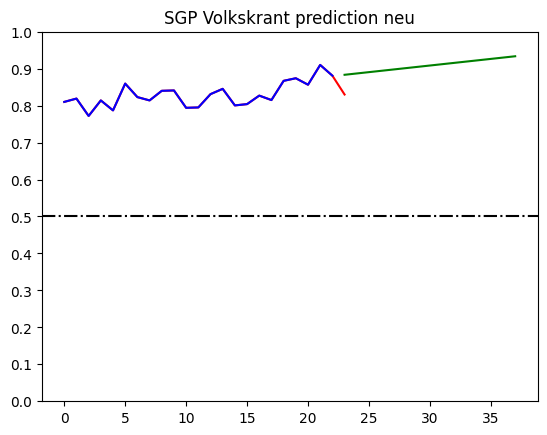

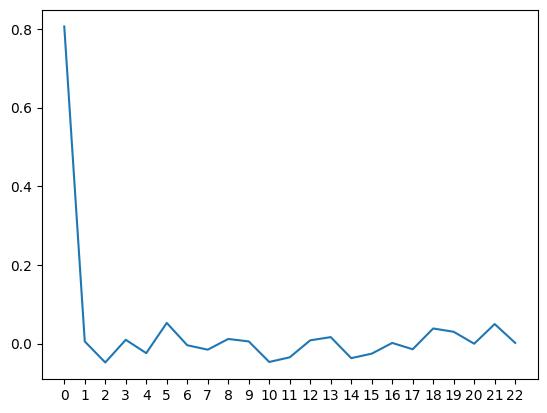

count    2.300000e+01
mean    -1.508455e-17
std      3.401668e-02
min     -5.545652e-02
25%     -1.545652e-02
50%     -7.456522e-03
75%      1.404348e-02
max      7.654348e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


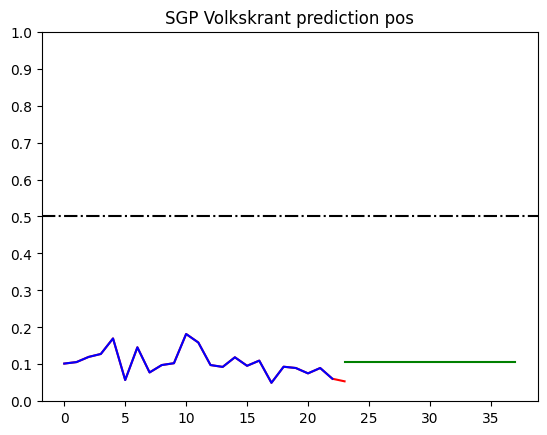

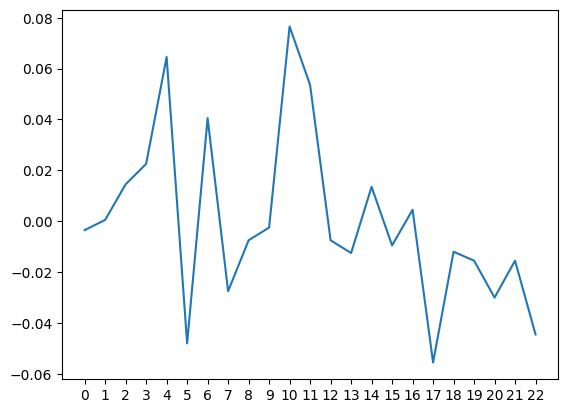

count    2.300000e+01
mean     7.884325e-12
std      3.071424e-02
min     -6.515942e-02
25%     -2.065942e-02
50%     -2.159420e-03
75%      1.659058e-02
max      6.984058e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


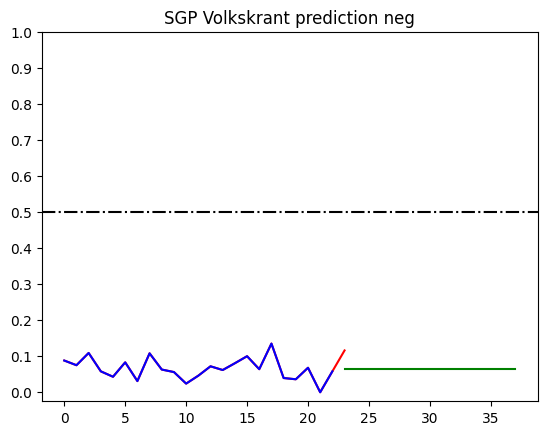

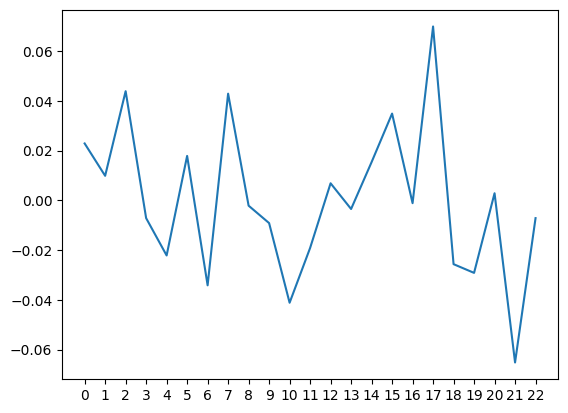

count    31.000000
mean      0.030906
std       0.150441
min      -0.080257
25%      -0.017822
50%       0.011561
75%       0.034256
max       0.820000
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


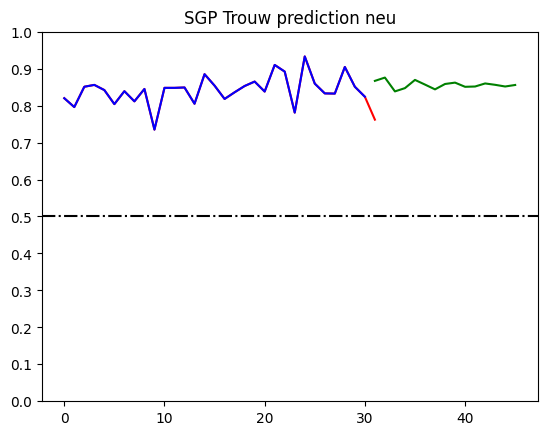

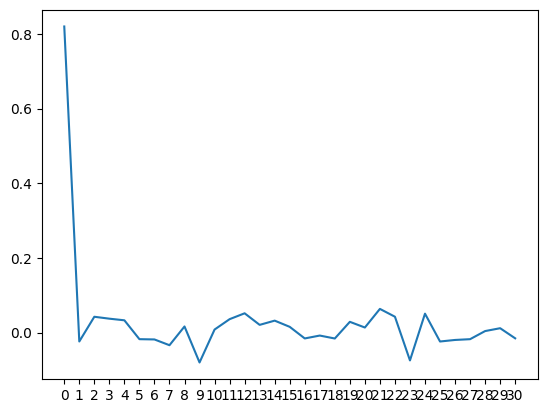

count    3.100000e+01
mean     6.201429e-12
std      2.686730e-02
min     -4.758065e-02
25%     -2.158065e-02
50%     -2.080645e-03
75%      2.291935e-02
max      4.341935e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


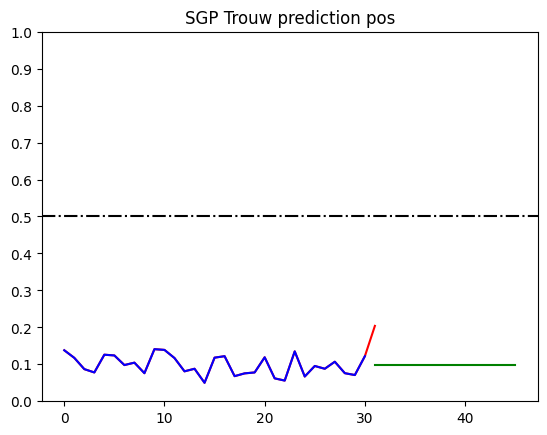

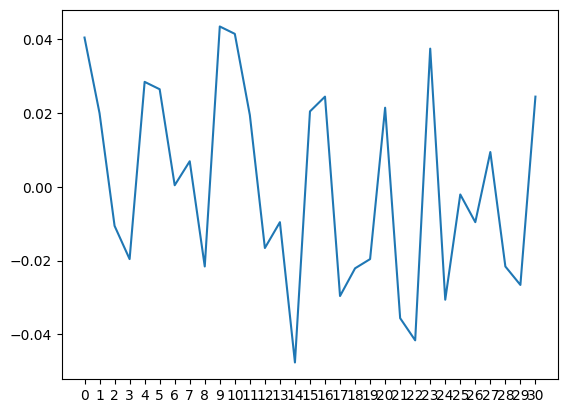

count    3.100000e+01
mean     1.664150e-12
std      2.757292e-02
min     -6.012903e-02
25%     -1.662903e-02
50%      1.870968e-03
75%      1.837097e-02
max      6.487097e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


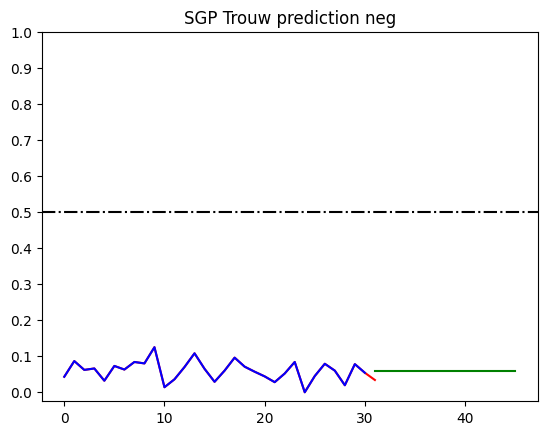

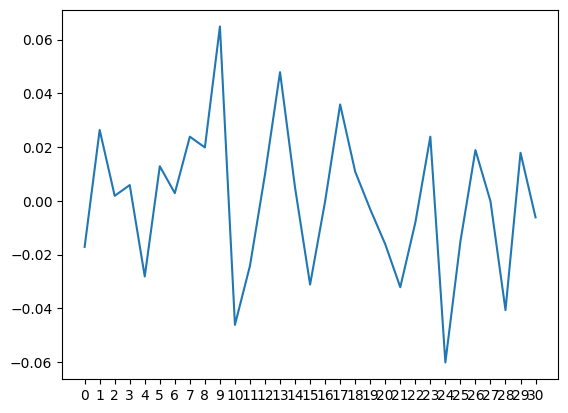

count    1.900000e+01
mean     1.059779e-11
std      4.580880e-02
min     -9.550877e-02
25%     -2.250877e-02
50%      1.449123e-02
75%      2.699123e-02
max      6.749123e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


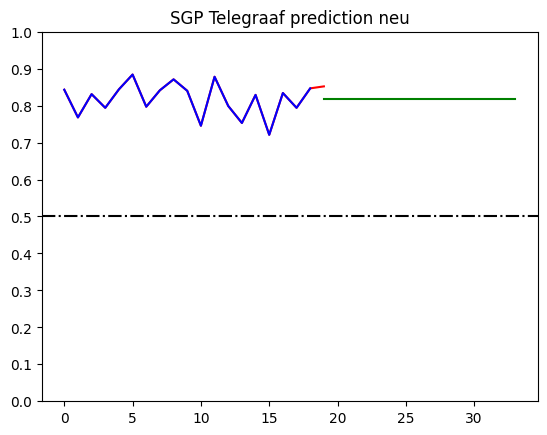

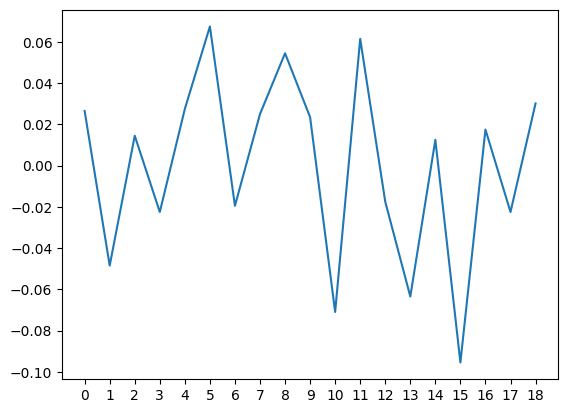

count    19.000000
mean     -0.000706
std       0.029121
min      -0.059112
25%      -0.015931
50%       0.000462
75%       0.021793
max       0.052236
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


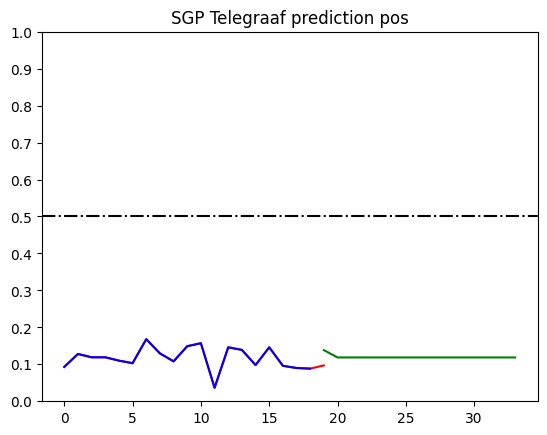

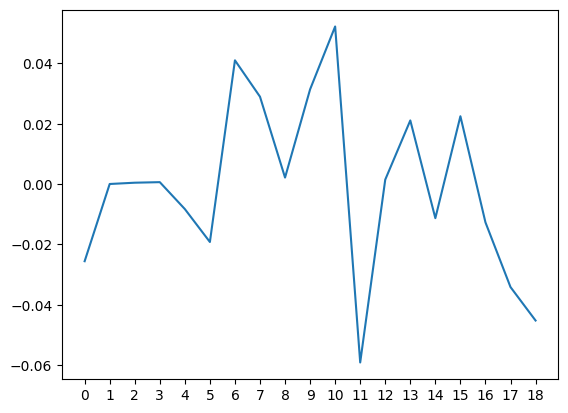

count    1.900000e+01
mean     3.427934e-13
std      3.579347e-02
min     -5.548246e-02
25%     -2.598246e-02
50%     -1.815789e-03
75%      2.576754e-02
max      6.651754e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


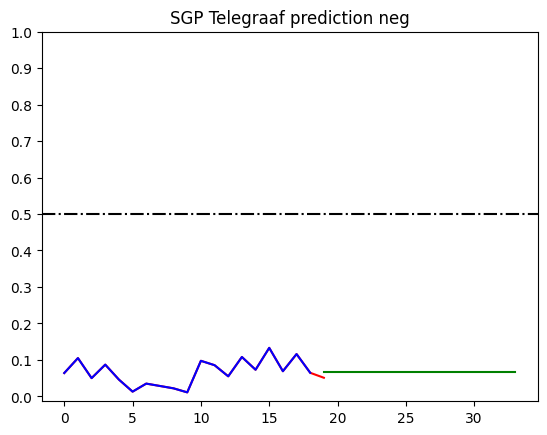

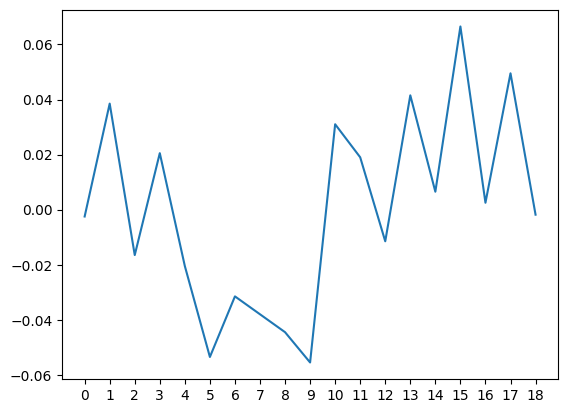

count    7.600000e+01
mean     2.787789e-12
std      4.178639e-02
min     -1.328476e-01
25%     -2.275664e-02
50%      4.691131e-04
75%      2.129828e-02
max      1.401524e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


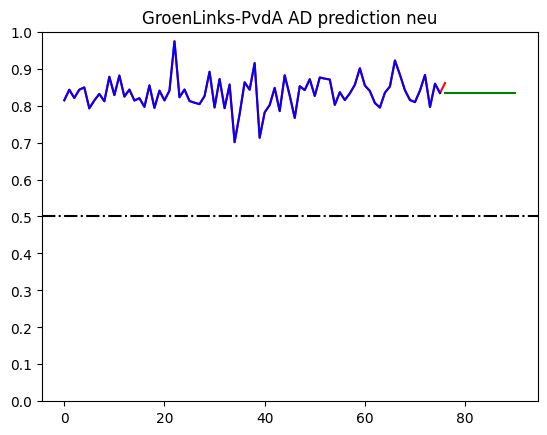

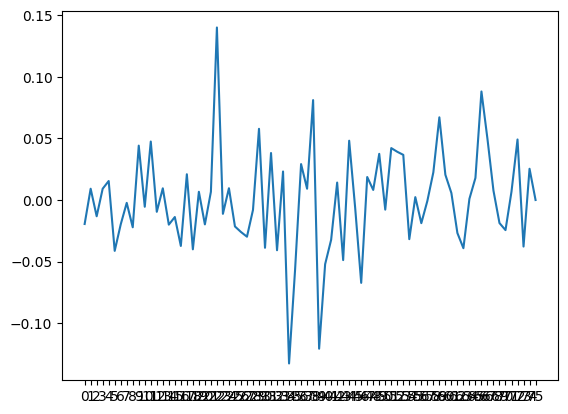

count    7.600000e+01
mean     1.429975e-12
std      2.531895e-02
min     -8.476151e-02
25%     -1.194901e-02
50%      2.384925e-04
75%      1.323849e-02
max      8.823849e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


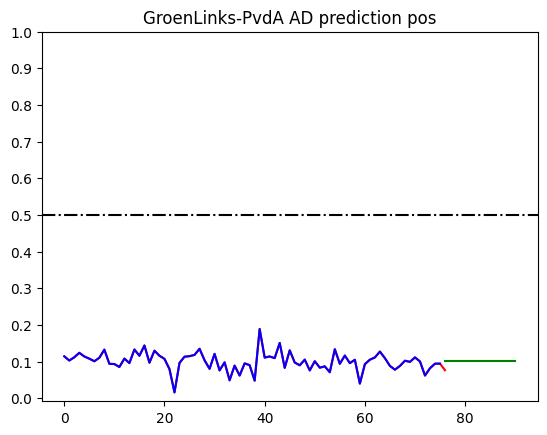

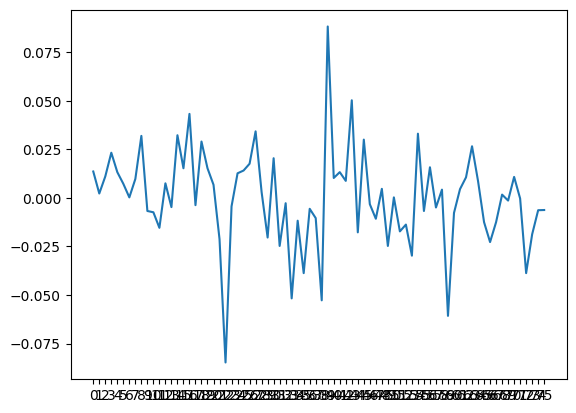

count    76.000000
mean     -0.000012
std       0.030288
min      -0.064360
25%      -0.018192
50%      -0.001704
75%       0.010829
max       0.138886
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


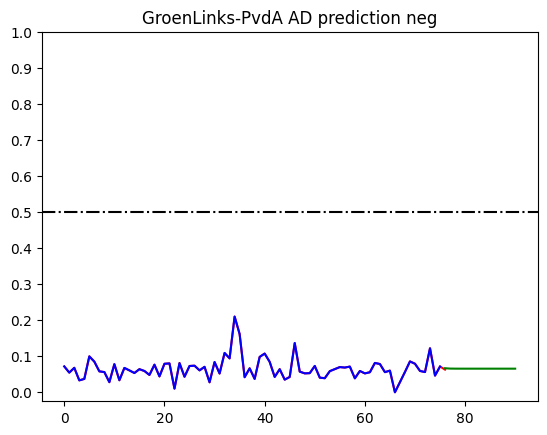

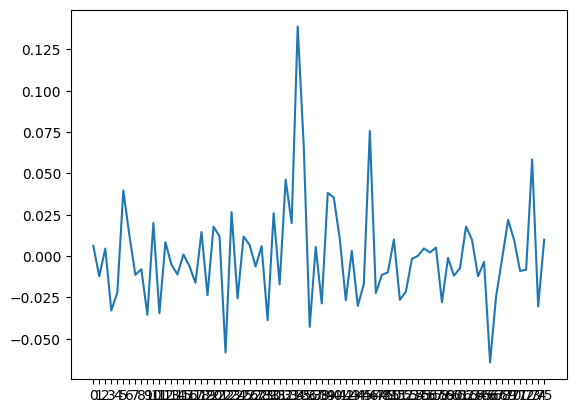

count    47.000000
mean     -0.001359
std       0.041899
min      -0.079923
25%      -0.034948
50%      -0.004274
75%       0.026707
max       0.076840
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


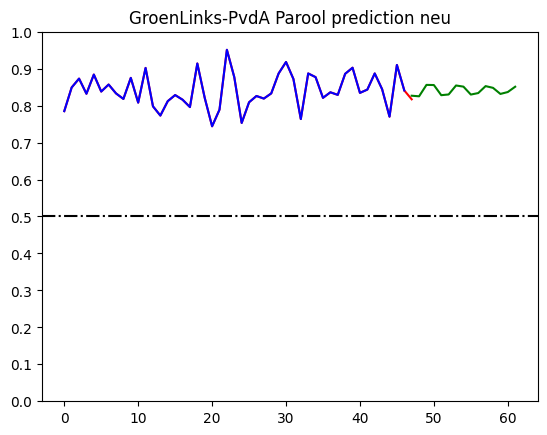

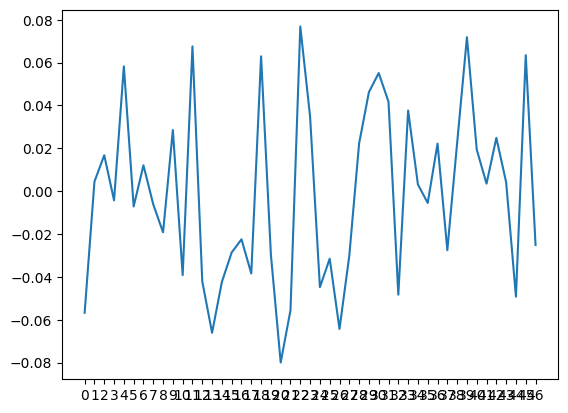

count    4.700000e+01
mean     3.698797e-11
std      3.712711e-02
min     -7.594468e-02
25%     -2.244468e-02
50%     -7.944681e-03
75%      2.455532e-02
max      1.090553e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


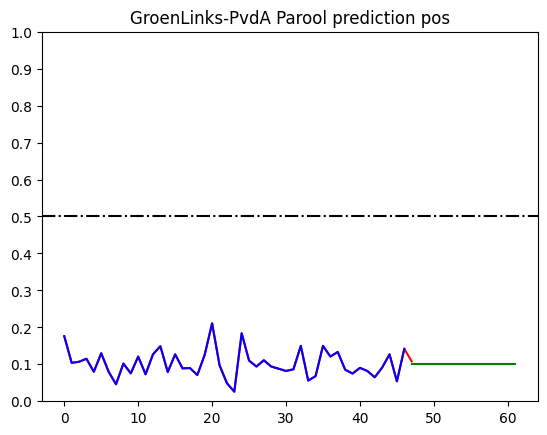

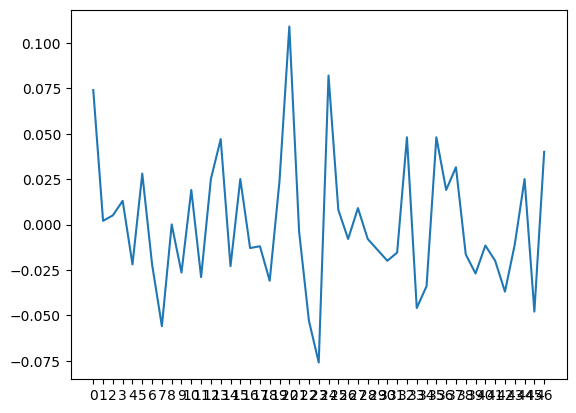

count    4.700000e+01
mean     1.512272e-12
std      3.037275e-02
min     -5.716454e-02
25%     -2.066454e-02
50%     -3.164539e-03
75%      1.953546e-02
max      6.383546e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


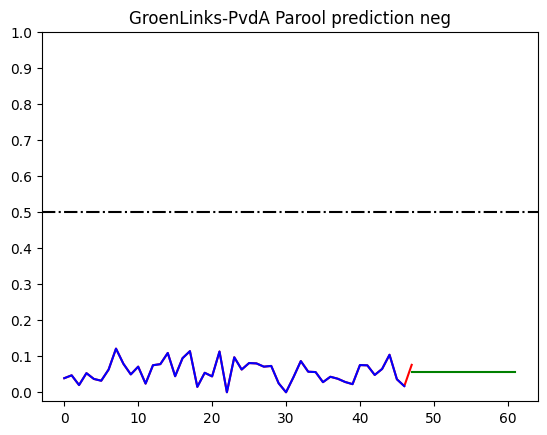

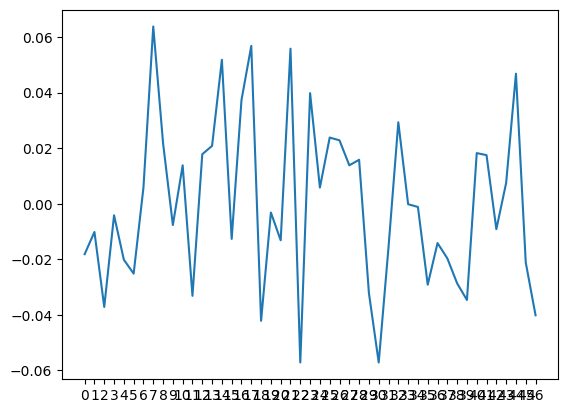

count    73.000000
mean     -0.000037
std       0.045450
min      -0.139292
25%      -0.026879
50%      -0.001091
75%       0.022695
max       0.109996
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


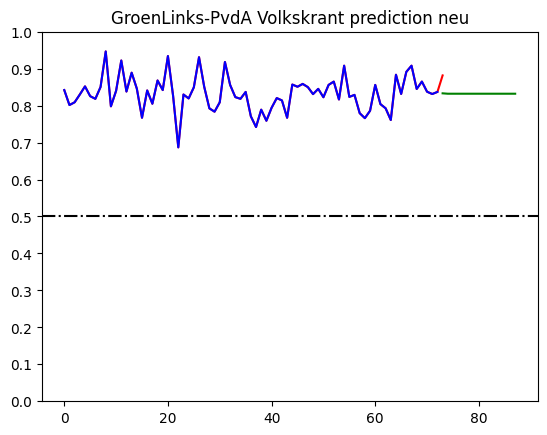

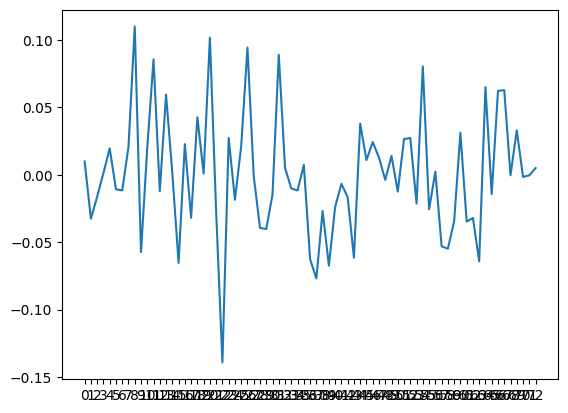

count    7.300000e+01
mean     7.892828e-12
std      3.123160e-02
min     -9.616461e-02
25%     -1.716461e-02
50%      1.835388e-03
75%      1.983539e-02
max      7.783539e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


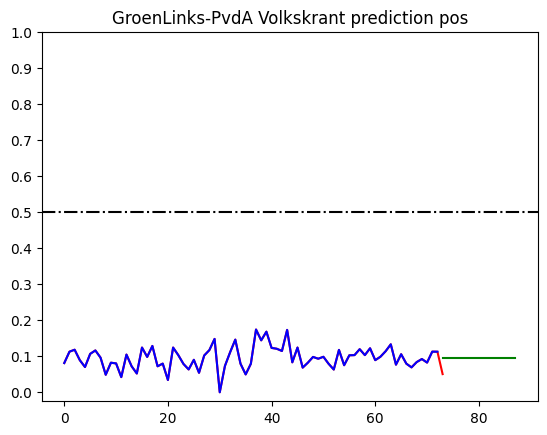

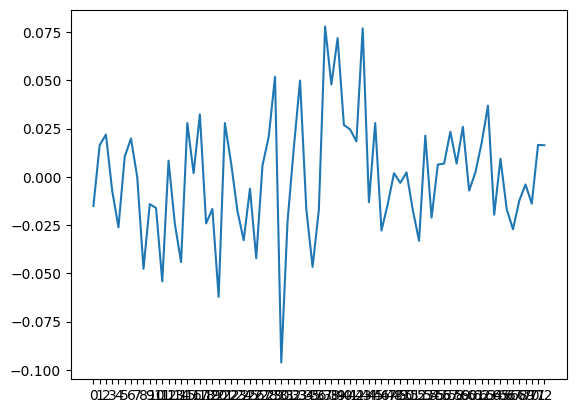

count    7.300000e+01
mean     1.190321e-11
std      3.572842e-02
min     -6.673470e-02
25%     -1.673470e-02
50%     -3.734703e-03
75%      1.226530e-02
max      1.382653e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


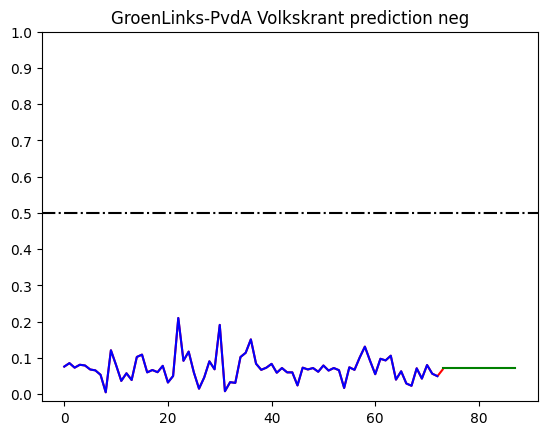

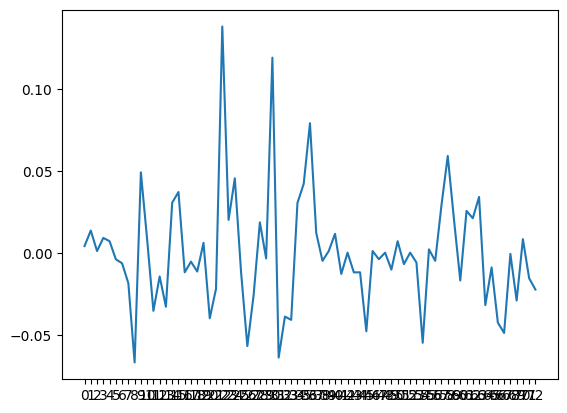

count    6.700000e+01
mean     5.952940e-12
std      4.052916e-02
min     -8.738756e-02
25%     -2.322090e-02
50%     -4.887562e-03
75%      2.661244e-02
max      1.461124e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


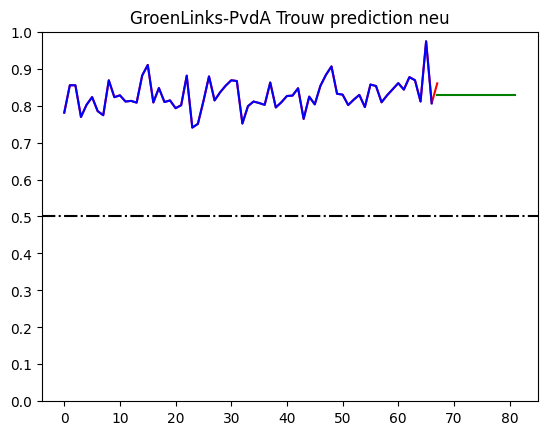

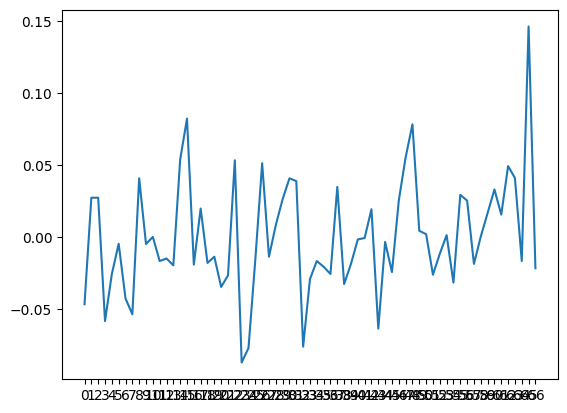

count    6.700000e+01
mean     7.888207e-12
std      3.186443e-02
min     -7.998756e-02
25%     -1.811256e-02
50%     -9.875622e-04
75%      2.401244e-02
max      9.451244e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


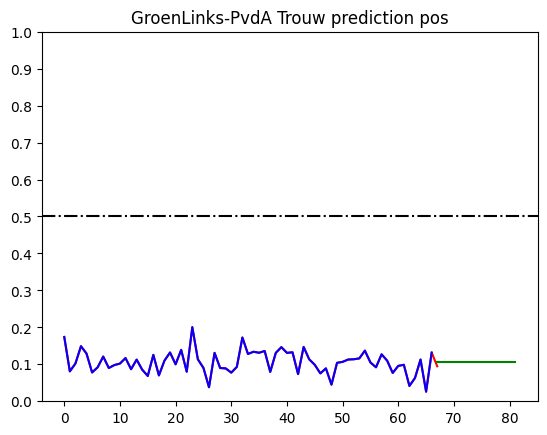

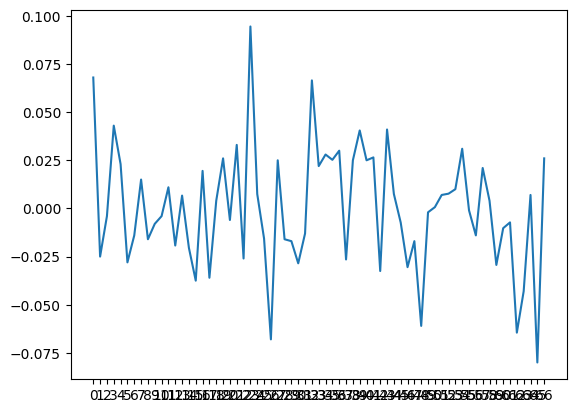

count    67.000000
mean      0.000064
std       0.022492
min      -0.068756
25%      -0.013211
50%      -0.001299
75%       0.013338
max       0.070294
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


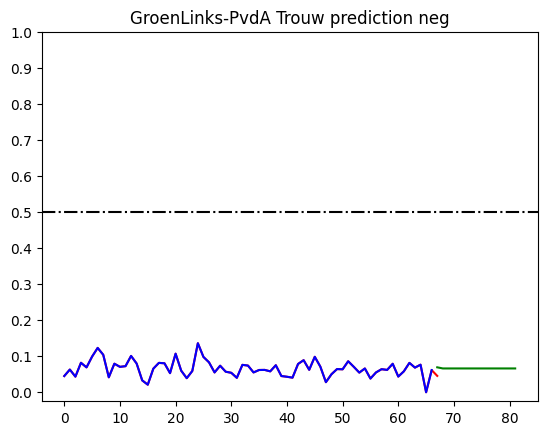

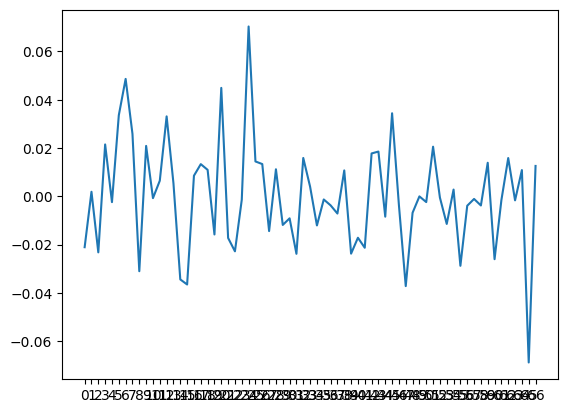

count    52.000000
mean     -0.000015
std       0.036736
min      -0.076795
25%      -0.022328
50%       0.001194
75%       0.021553
max       0.107771
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


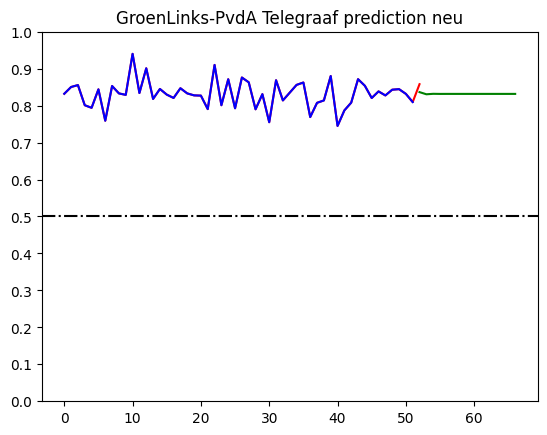

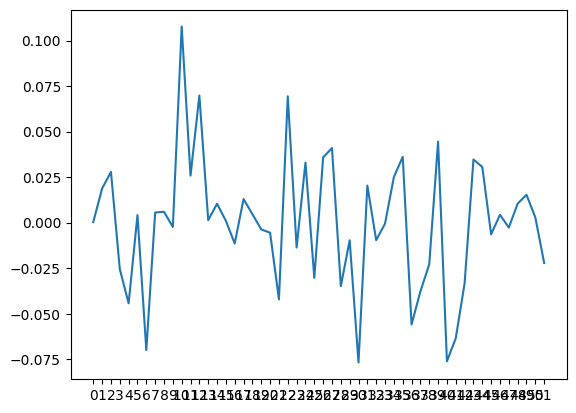

count    5.200000e+01
mean     4.665120e-12
std      3.241589e-02
min     -7.155865e-02
25%     -1.630865e-02
50%     -3.058654e-03
75%      1.544135e-02
max      8.244135e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


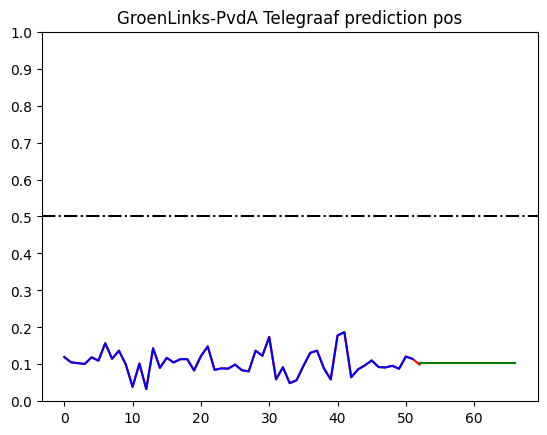

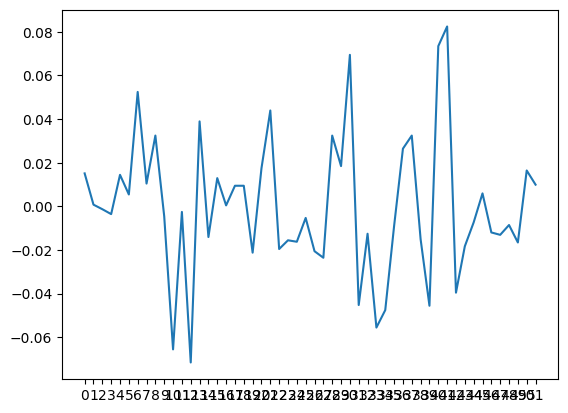

count    52.000000
mean     -0.000082
std       0.024453
min      -0.059895
25%      -0.015134
50%      -0.001578
75%       0.012842
max       0.061736
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


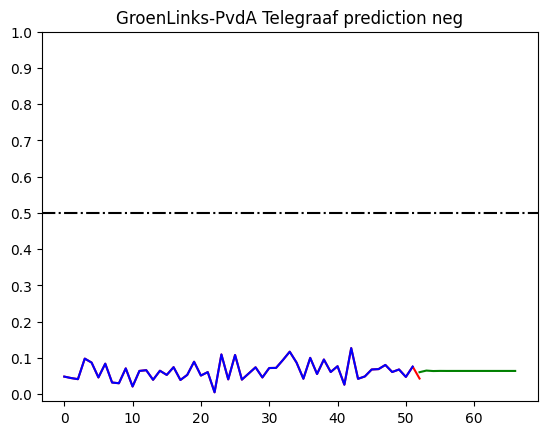

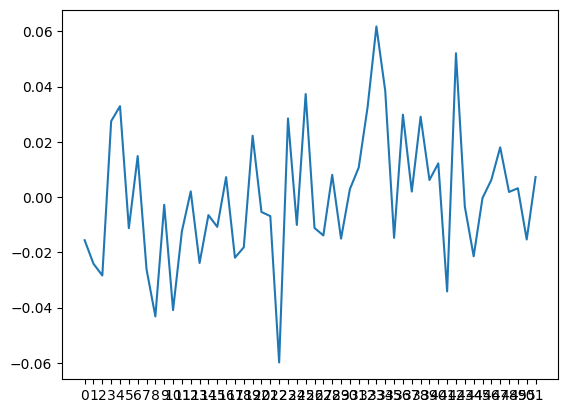

count    7.600000e+01
mean     1.631172e-12
std      3.906358e-02
min     -1.624652e-01
25%     -1.746518e-02
50%      1.034821e-03
75%      2.078482e-02
max      8.953482e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


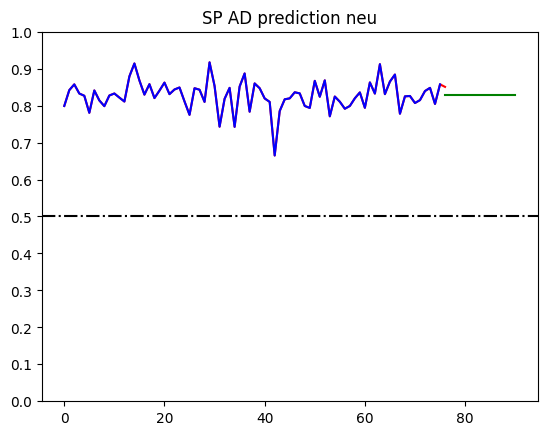

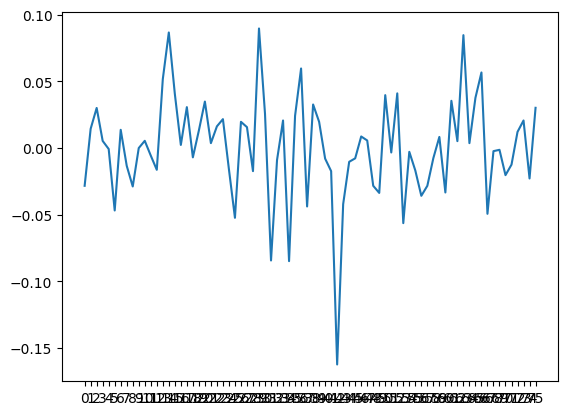

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


count    76.000000
mean     -0.000056
std       0.029296
min      -0.072271
25%      -0.018539
50%      -0.001386
75%       0.018669
max       0.088749
dtype: float64


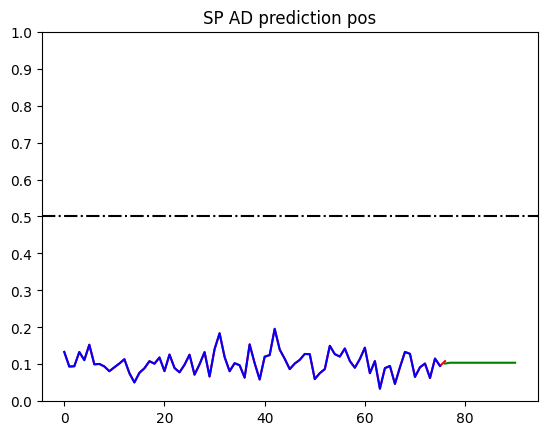

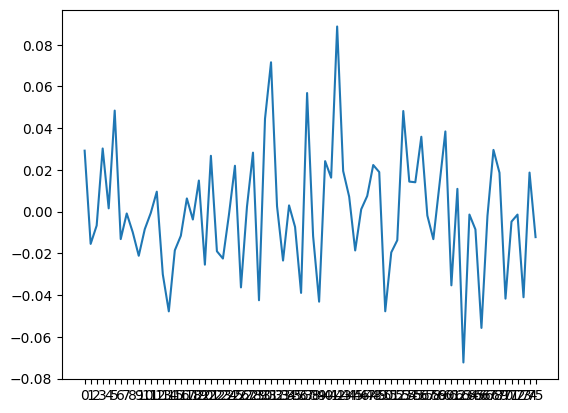

count    7.600000e+01
mean     1.661455e-12
std      2.544066e-02
min     -6.226697e-02
25%     -1.514197e-02
50%     -2.391970e-03
75%      1.127470e-02
max      8.598303e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


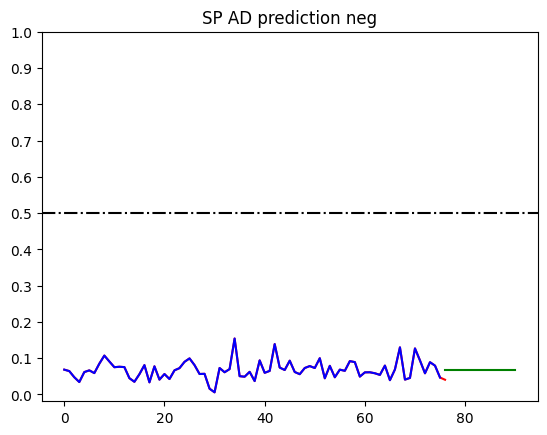

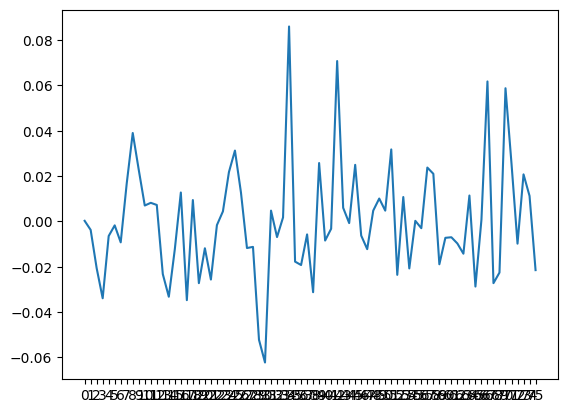

count    2.900000e+01
mean     7.535930e-12
std      5.463625e-02
min     -1.648391e-01
25%     -3.283908e-02
50%      4.660920e-03
75%      2.716092e-02
max      9.216092e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


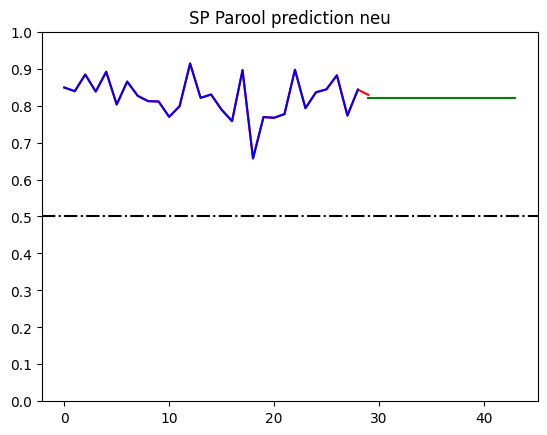

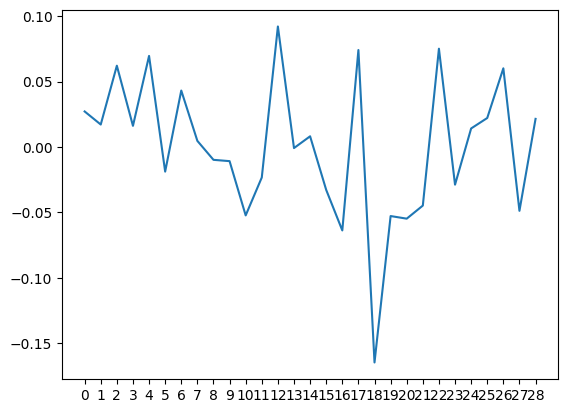

count    29.000000
mean     -0.000089
std       0.032753
min      -0.050478
25%      -0.026411
50%      -0.005393
75%       0.017148
max       0.081950
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


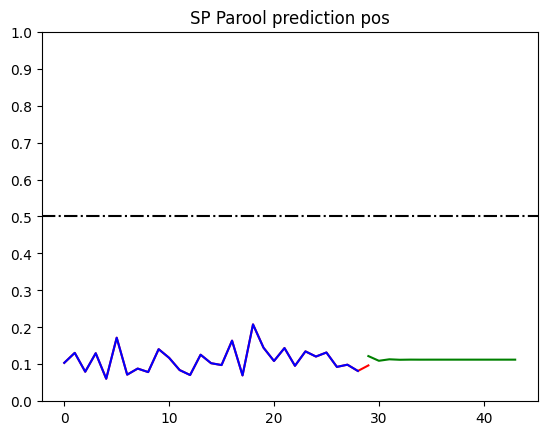

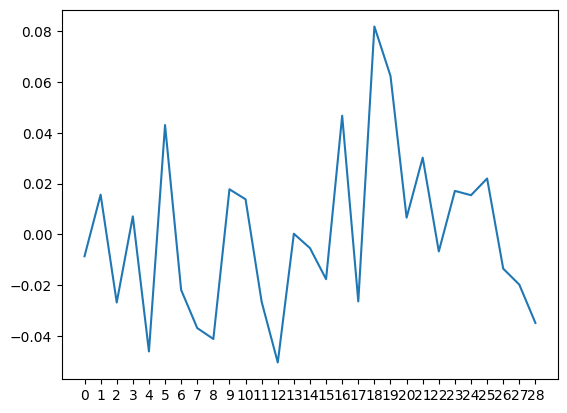

count    2.900000e+01
mean     5.200667e-13
std      3.745524e-02
min     -5.895402e-02
25%     -3.195402e-02
50%     -2.954023e-03
75%      2.004598e-02
max      6.904598e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


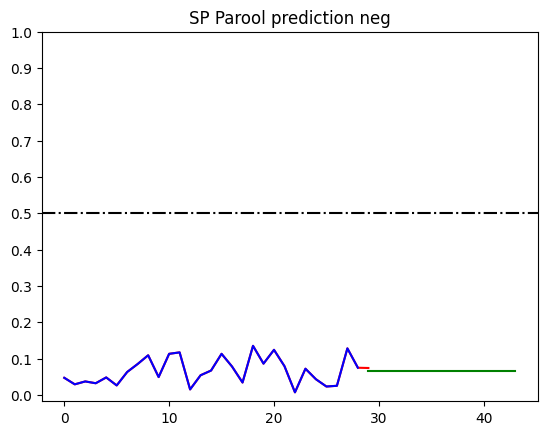

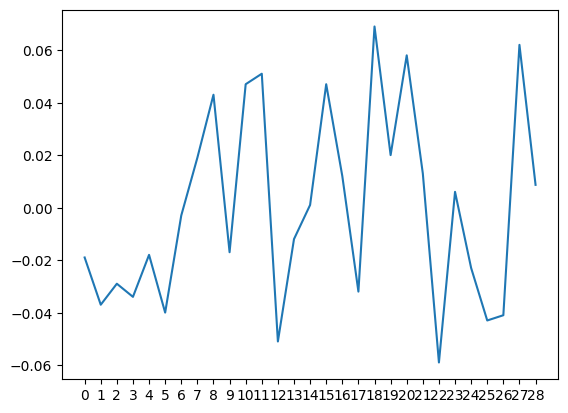

count    32.000000
mean      0.000121
std       0.041602
min      -0.076347
25%      -0.021789
50%      -0.000746
75%       0.021652
max       0.110604
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


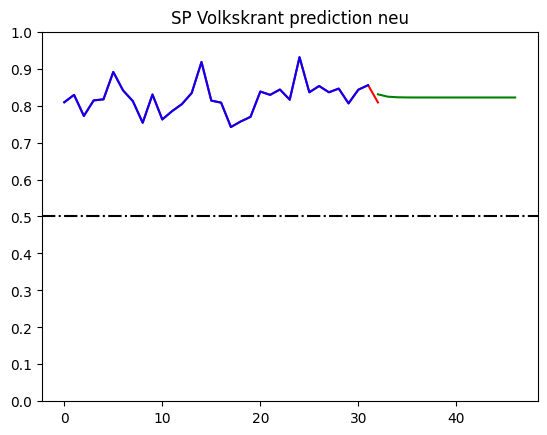

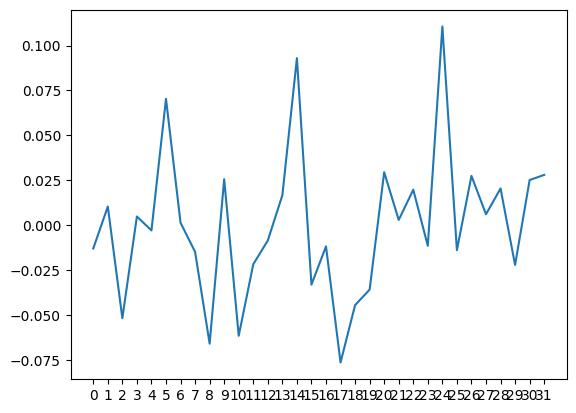

count    3.200000e+01
mean     3.470882e-13
std      3.071691e-02
min     -6.926042e-02
25%     -1.826042e-02
50%     -5.510417e-03
75%      1.640625e-02
max      6.823958e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


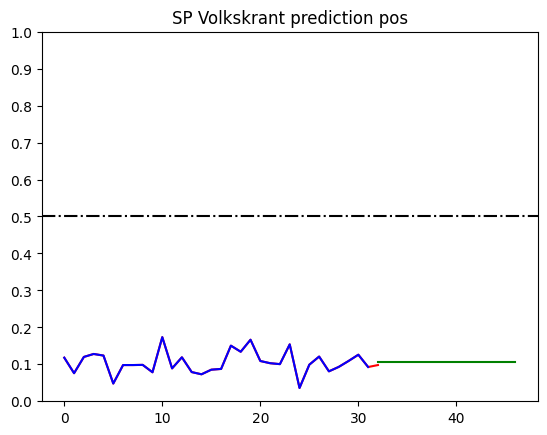

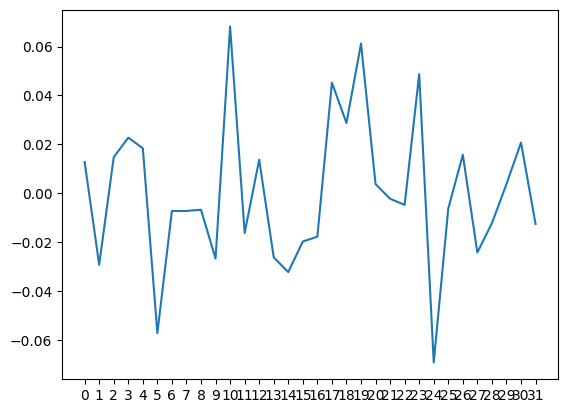

count    3.200000e+01
mean     8.740912e-12
std      3.094888e-02
min     -6.485417e-02
25%     -1.535417e-02
50%     -7.354167e-03
75%      1.989583e-02
max      7.514583e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


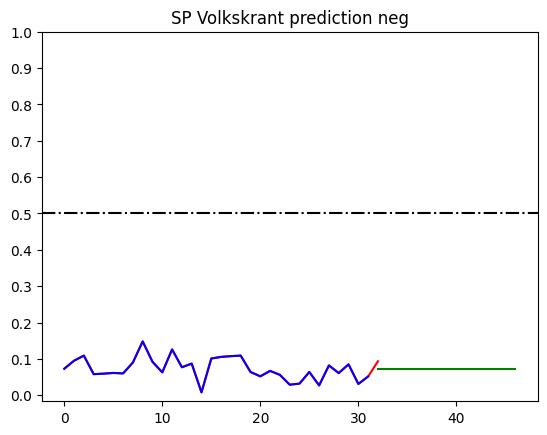

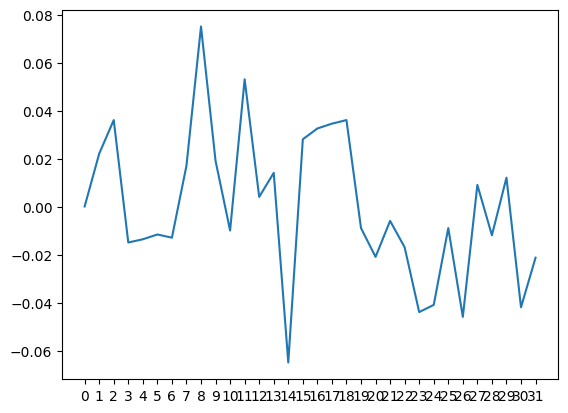

count    39.000000
mean      0.022045
std       0.127593
min      -0.136606
25%      -0.025320
50%       0.009265
75%       0.039827
max       0.733947
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


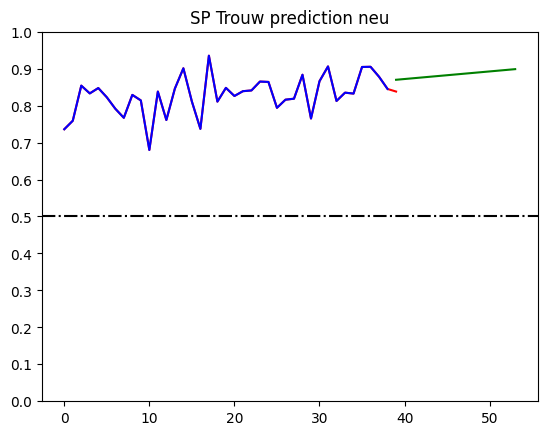

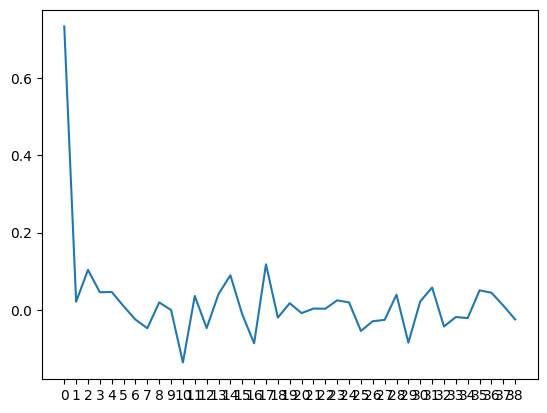

count    3.900000e+01
mean     3.649260e-11
std      4.377605e-02
min     -7.401068e-02
25%     -3.201068e-02
50%     -2.010684e-03
75%      2.198932e-02
max      1.009893e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


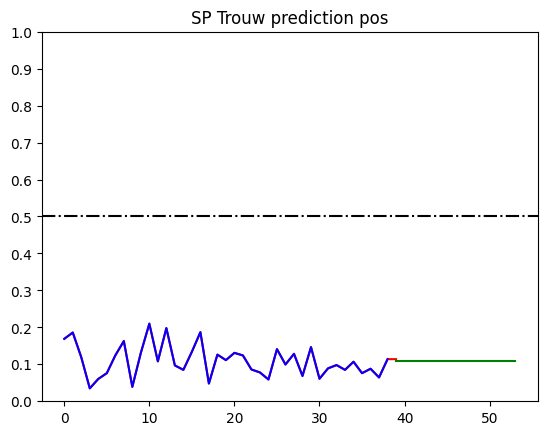

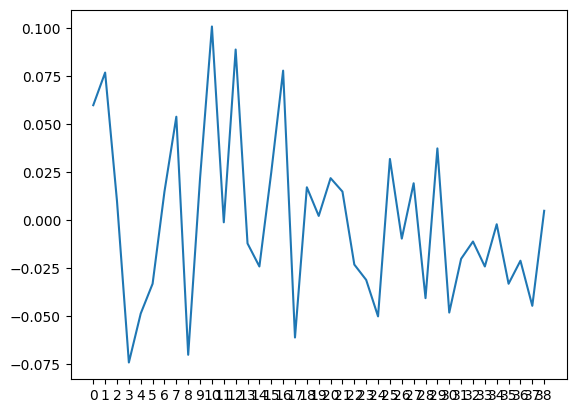

count    3.900000e+01
mean     7.883885e-12
std      3.065092e-02
min     -5.647436e-02
25%     -1.997436e-02
50%     -4.974359e-03
75%      1.927564e-02
max      6.952564e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


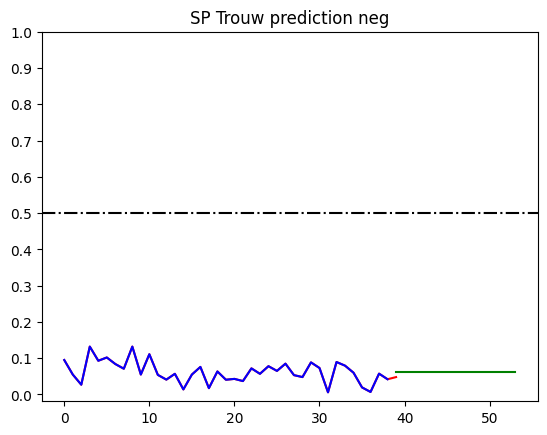

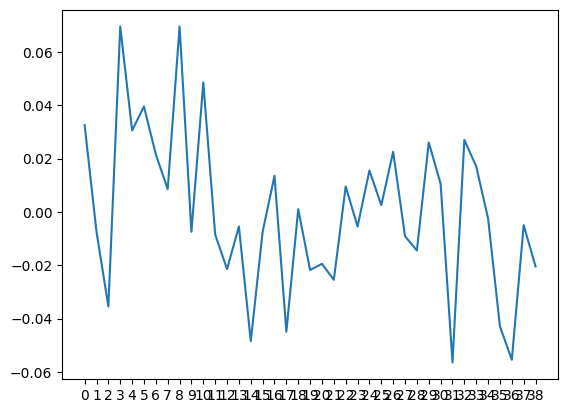

count    3.400000e+01
mean     7.659001e-12
std      4.720715e-02
min     -1.226912e-01
25%     -3.731618e-02
50%      1.180882e-02
75%      2.980882e-02
max      8.330882e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


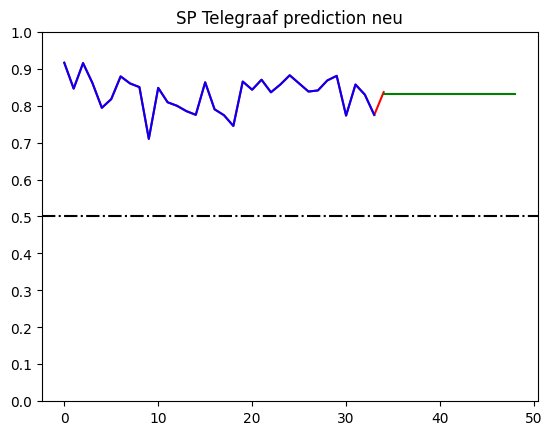

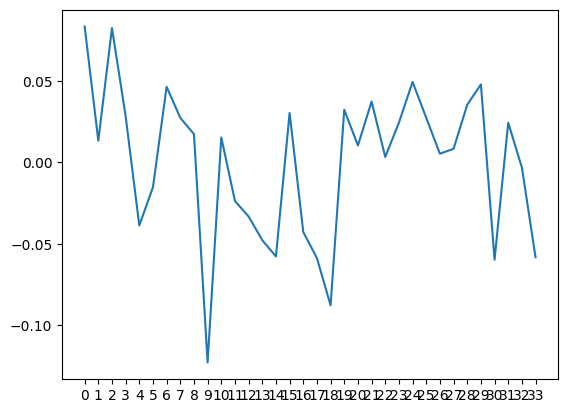

count    3.400000e+01
mean    -8.163405e-18
std      3.352220e-02
min     -4.616176e-02
25%     -2.916176e-02
50%     -1.066176e-02
75%      2.796324e-02
max      6.883824e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


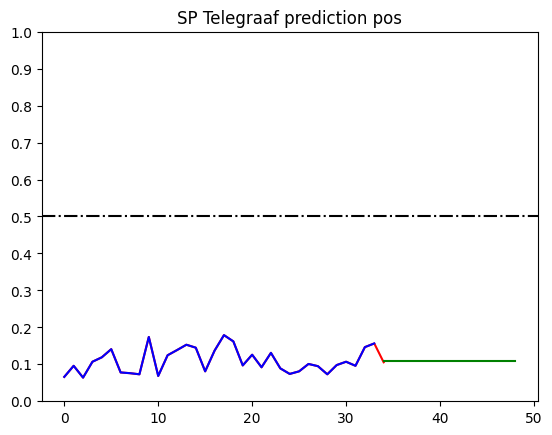

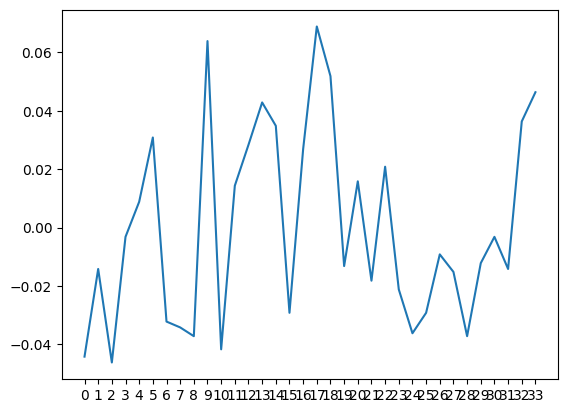

count    3.400000e+01
mean     7.858404e-12
std      2.496251e-02
min     -3.928922e-02
25%     -1.841422e-02
50%      1.377451e-03
75%      1.108578e-02
max      6.271078e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


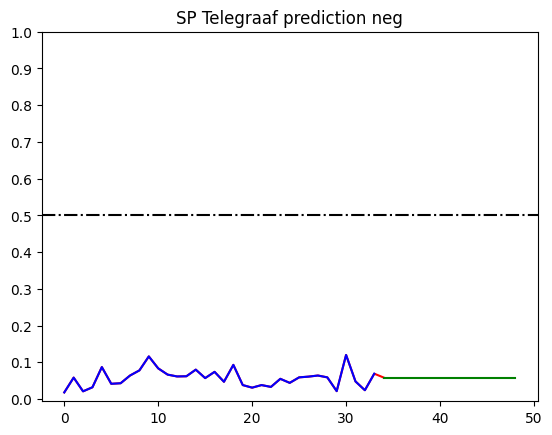

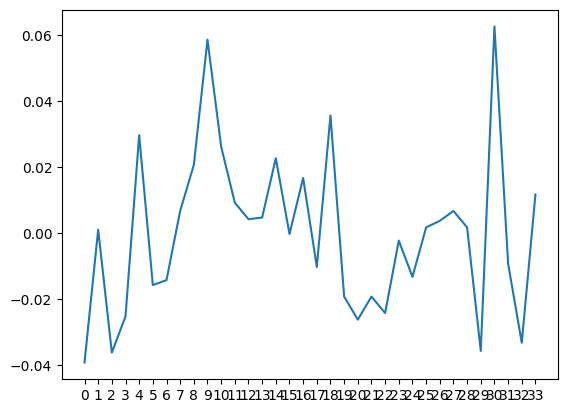

count    4.800000e+01
mean    -3.261280e-16
std      3.897357e-02
min     -6.633854e-02
25%     -2.702604e-02
50%     -5.338542e-03
75%      2.228646e-02
max      8.166146e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


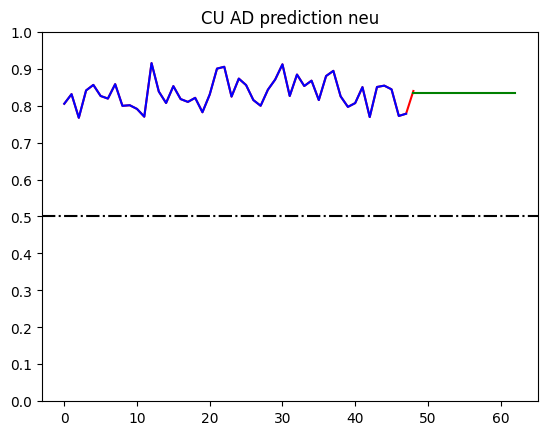

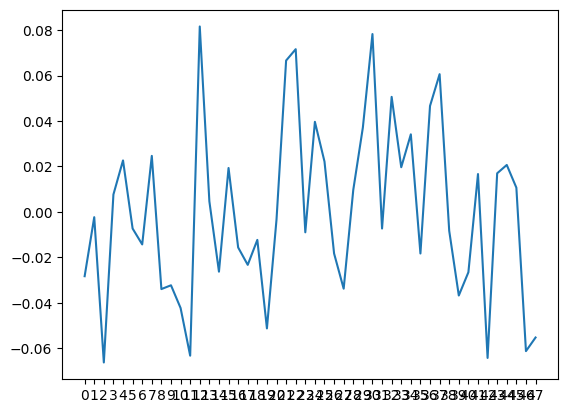

count    48.000000
mean      0.000022
std       0.030554
min      -0.089246
25%      -0.019665
50%       0.002344
75%       0.017385
max       0.068448
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


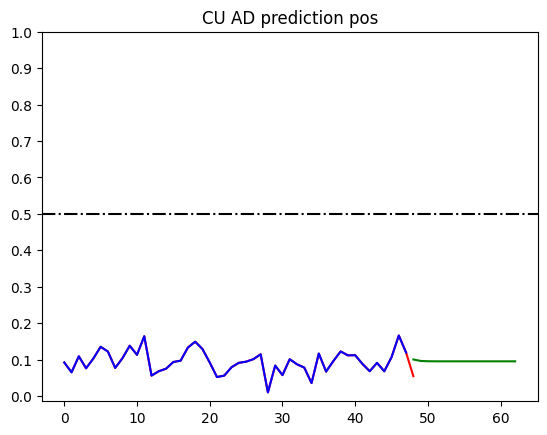

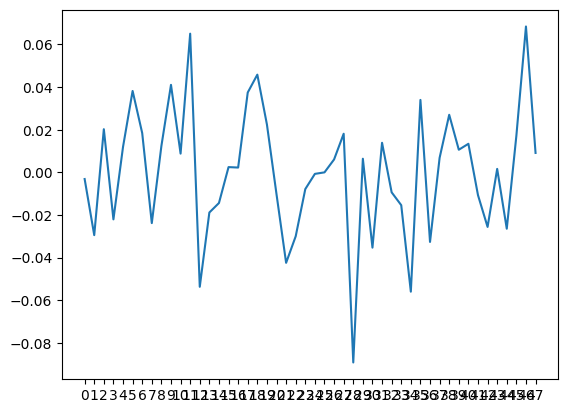

count    4.800000e+01
mean     2.212122e-11
std      3.118368e-02
min     -6.158507e-02
25%     -2.171007e-02
50%     -4.335069e-03
75%      2.053993e-02
max      9.141493e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


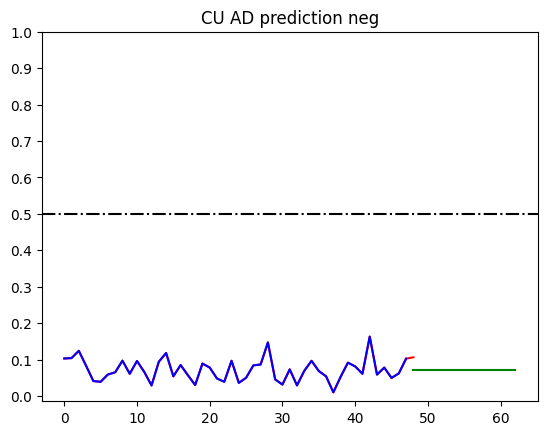

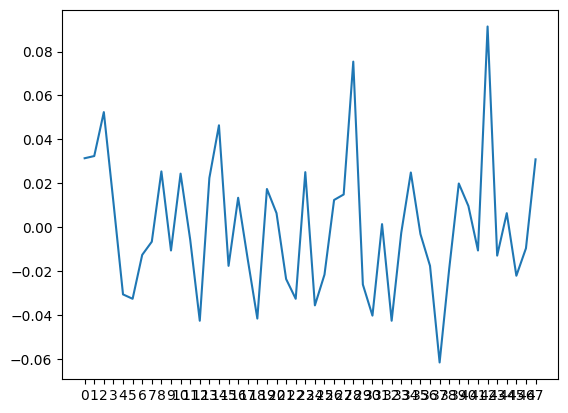

count    11.000000
mean      0.001792
std       0.049966
min      -0.070005
25%      -0.037906
50%       0.005611
75%       0.030044
max       0.089923
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


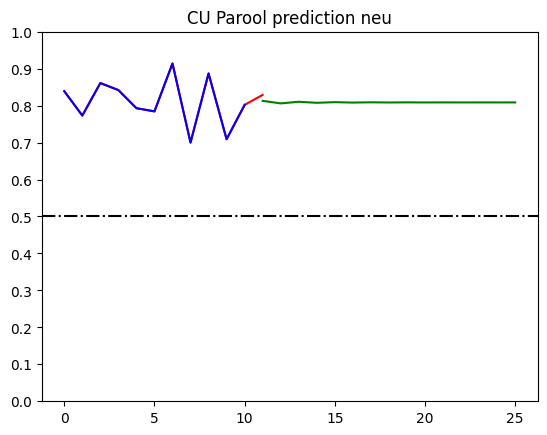

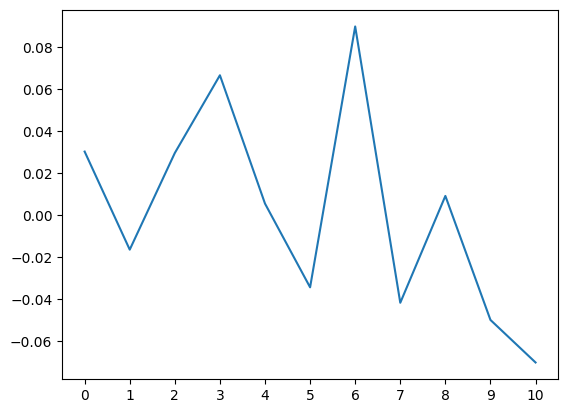

count    11.000000
mean     -0.000078
std       0.036748
min      -0.036307
25%      -0.020623
50%      -0.010007
75%       0.001315
max       0.088344
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


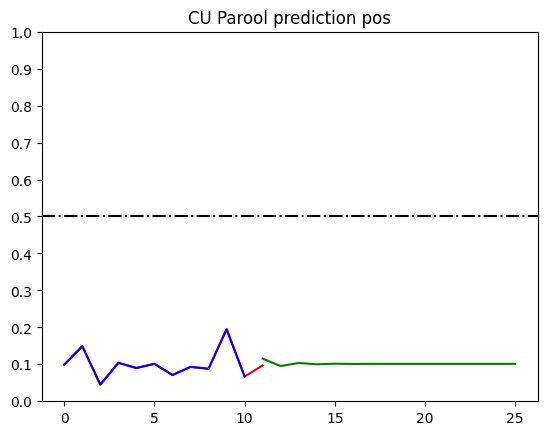

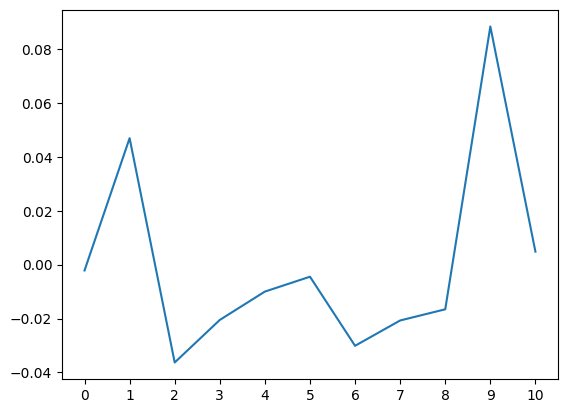

count    11.000000
mean     -0.004147
std       0.029457
min      -0.038265
25%      -0.027831
50%      -0.012246
75%       0.017072
max       0.047857
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


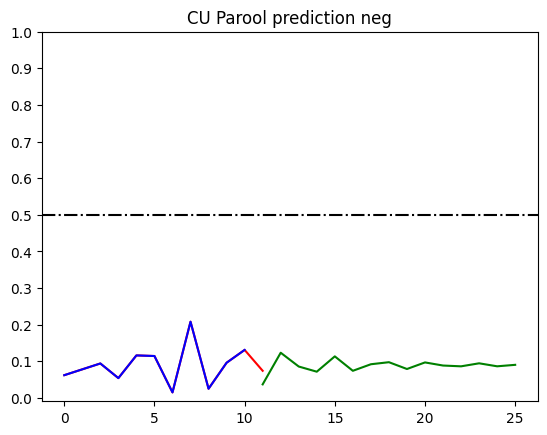

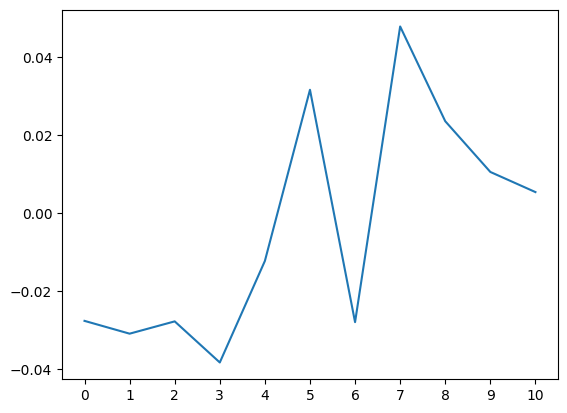

count    21.000000
mean      0.000537
std       0.050811
min      -0.120669
25%      -0.034361
50%       0.003006
75%       0.040432
max       0.077815
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


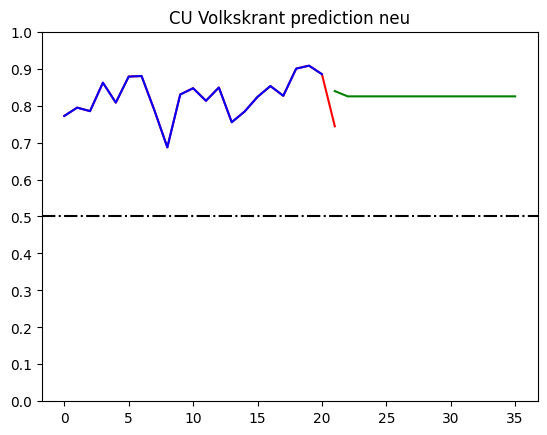

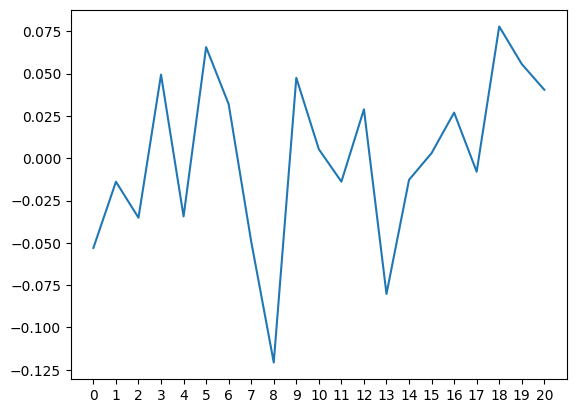

count    21.000000
mean     -0.000075
std       0.032371
min      -0.056926
25%      -0.030472
50%      -0.002975
75%       0.023772
max       0.045875
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


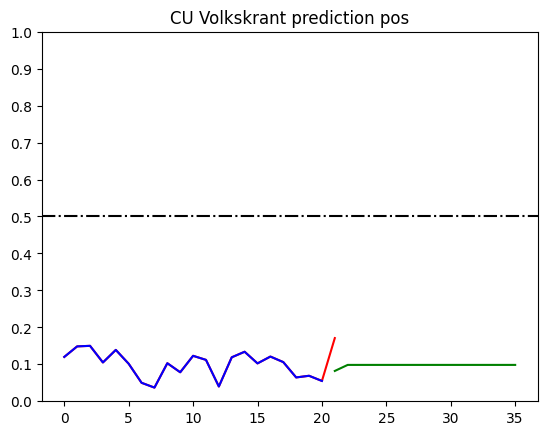

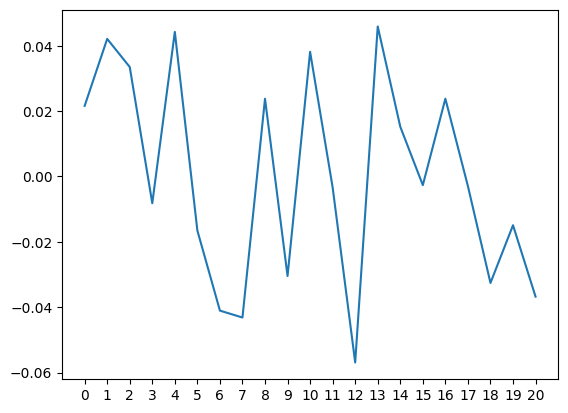

count    21.000000
mean     -0.000739
std       0.041038
min      -0.058382
25%      -0.033817
50%       0.002980
75%       0.025600
max       0.084781
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


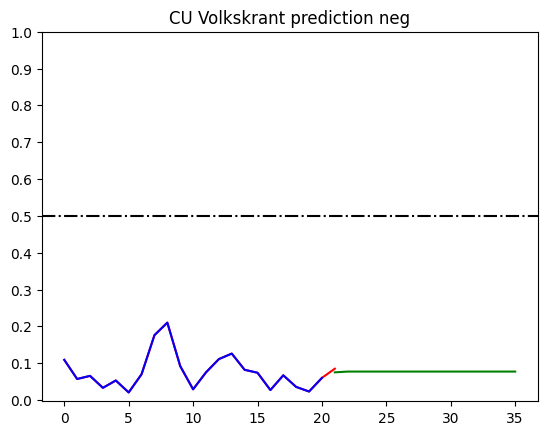

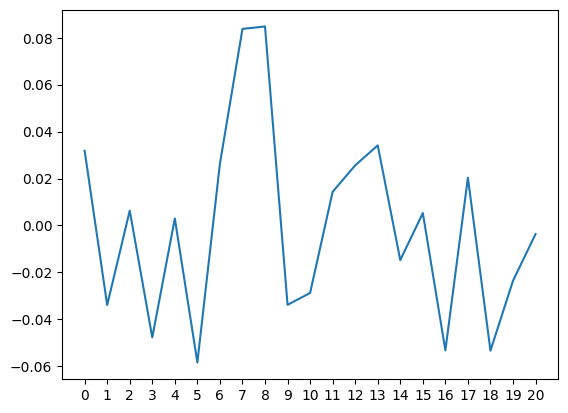

count    4.000000e+01
mean     2.537612e-11
std      6.761164e-02
min     -2.084542e-01
25%     -4.445417e-02
50%     -1.620833e-03
75%      4.479583e-02
max      1.155458e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


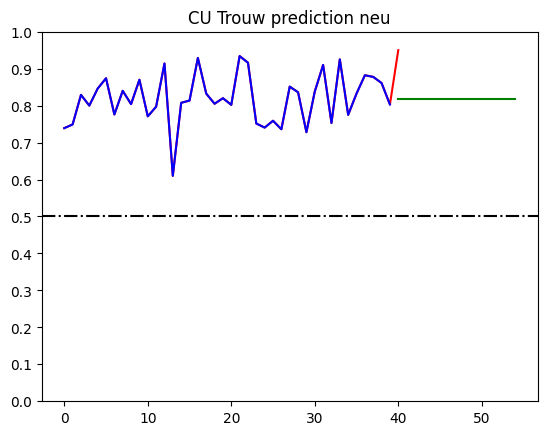

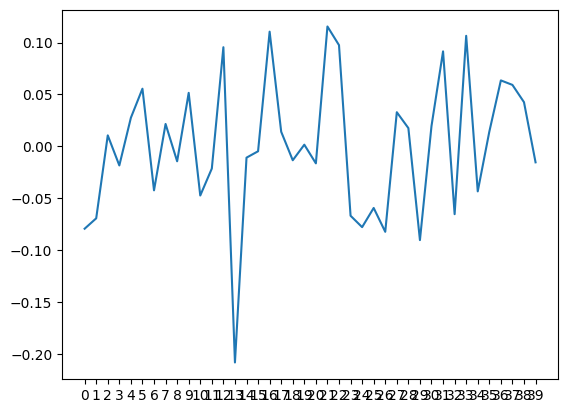

count    4.000000e+01
mean     1.153835e-12
std      5.560614e-02
min     -9.833333e-02
25%     -3.283333e-02
50%     -1.166667e-02
75%      3.241667e-02
max      1.956667e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


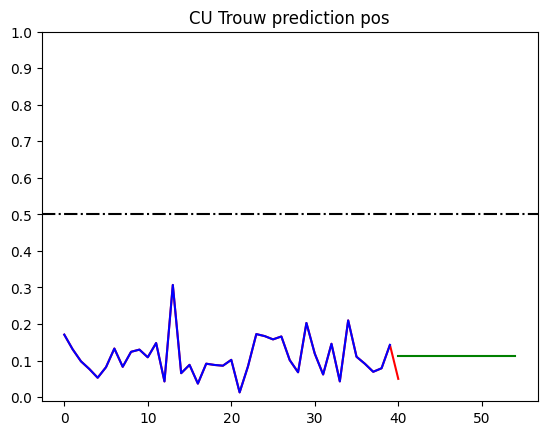

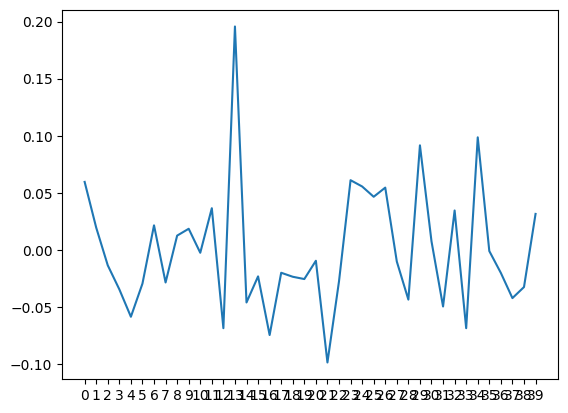

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


count    40.000000
mean      0.001731
std       0.034660
min      -0.085161
25%      -0.023177
50%       0.002013
75%       0.031319
max       0.091091
dtype: float64


/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


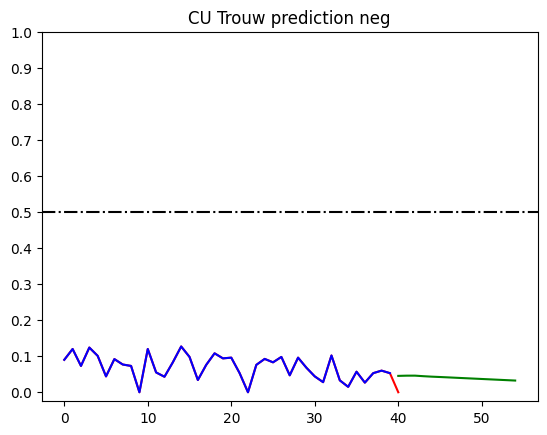

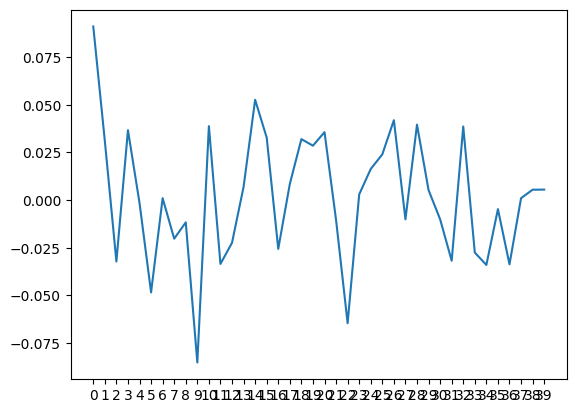

count    2.700000e+01
mean     6.957019e-12
std      4.689412e-02
min     -9.864506e-02
25%     -3.039506e-02
50%      7.354938e-03
75%      3.435494e-02
max      6.435494e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


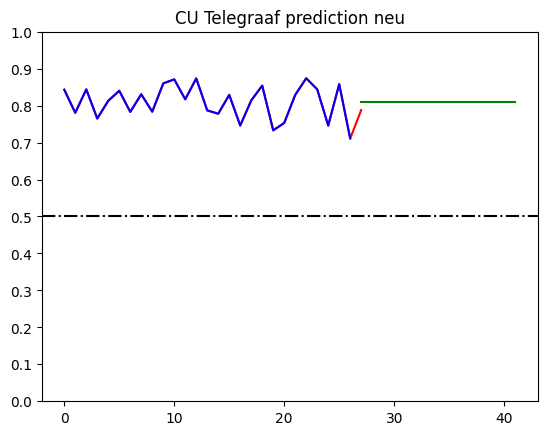

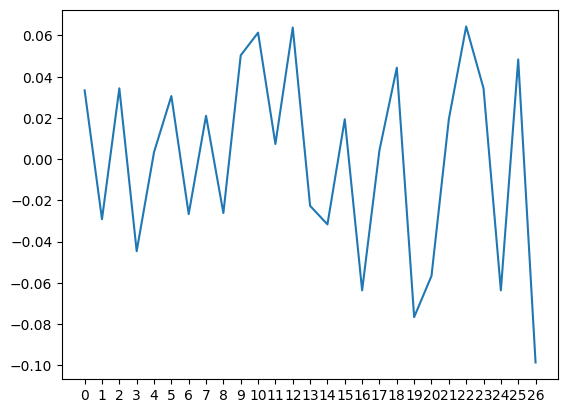

count    2.700000e+01
mean     6.664739e-12
std      4.136958e-02
min     -5.950000e-02
25%     -2.500000e-02
50%     -1.250000e-02
75%      1.050000e-02
max      1.065000e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


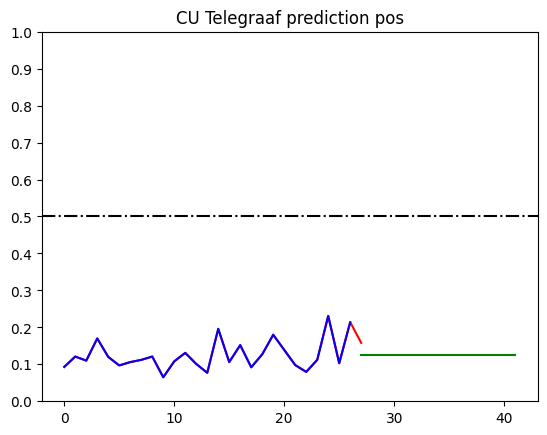

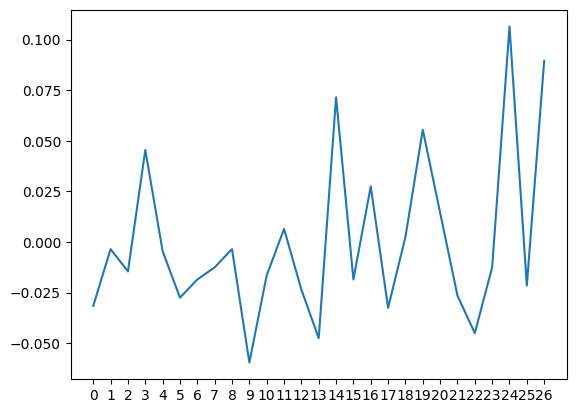

count    2.700000e+01
mean     7.888359e-12
std      3.101215e-02
min     -4.695679e-02
25%     -2.095679e-02
50%     -9.567901e-04
75%      2.504321e-02
max      6.970988e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


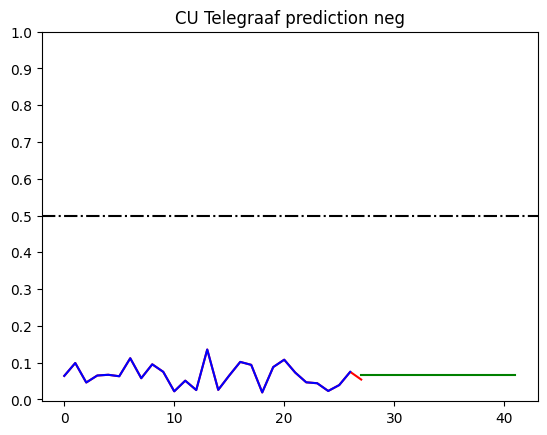

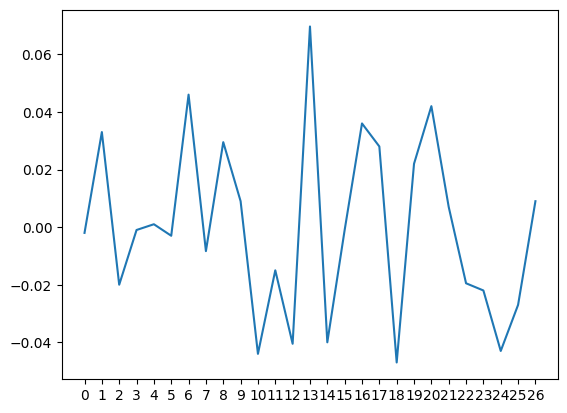

count    46.000000
mean     -0.000254
std       0.038502
min      -0.069548
25%      -0.020942
50%      -0.001720
75%       0.014719
max       0.119117
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


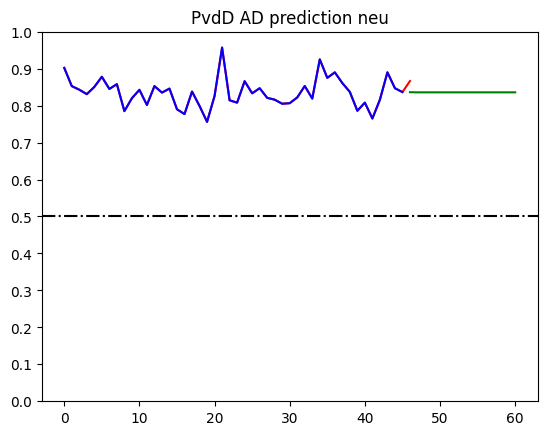

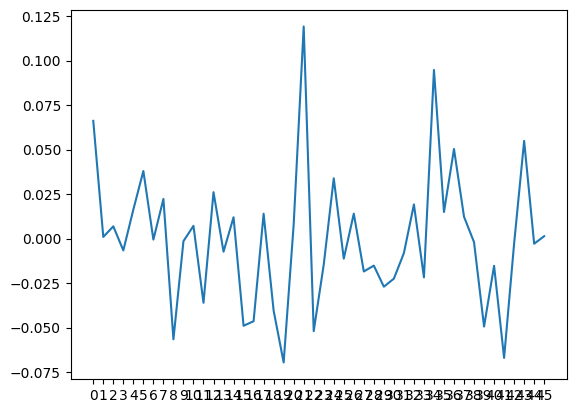

count    4.600000e+01
mean     6.005105e-12
std      3.687931e-02
min     -8.253986e-02
25%     -1.912319e-02
50%     -1.206522e-03
75%      2.933514e-02
max      9.946014e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


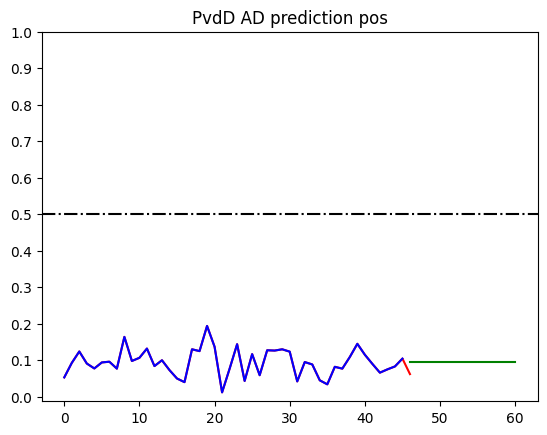

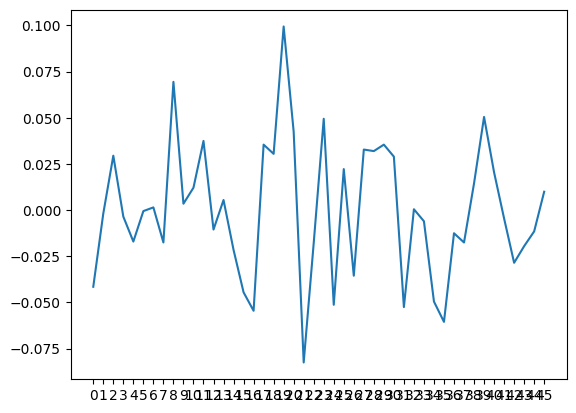

count    4.600000e+01
mean     3.474443e-13
std      3.451535e-02
min     -4.191304e-02
25%     -1.964221e-02
50%     -5.788043e-03
75%      1.033696e-02
max      1.130870e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


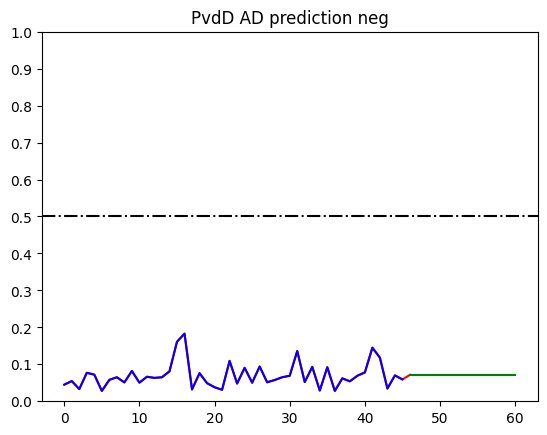

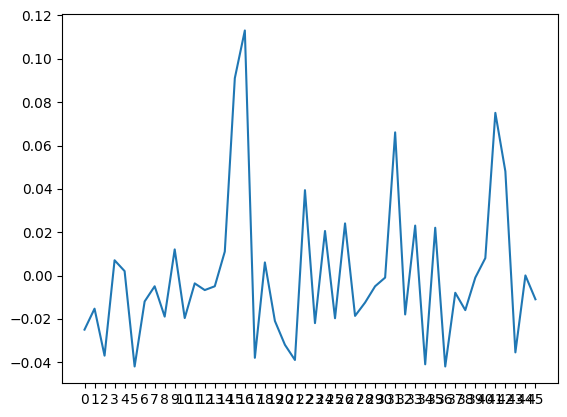

count    1.200000e+01
mean     1.505777e-12
std      2.413958e-02
min     -3.709722e-02
25%     -1.572222e-02
50%     -1.597222e-03
75%      1.381944e-02
max      4.590278e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


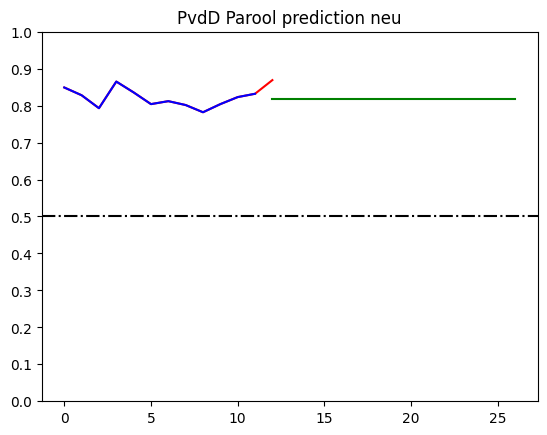

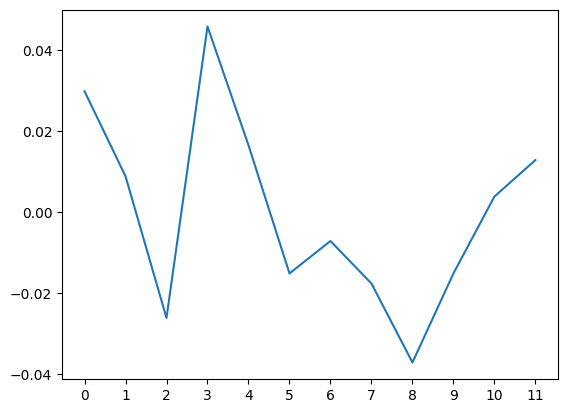

count    1.200000e+01
mean    -3.700743e-17
std      2.372734e-02
min     -3.072222e-02
25%     -1.747222e-02
50%     -3.888889e-03
75%      1.077778e-02
max      4.427778e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


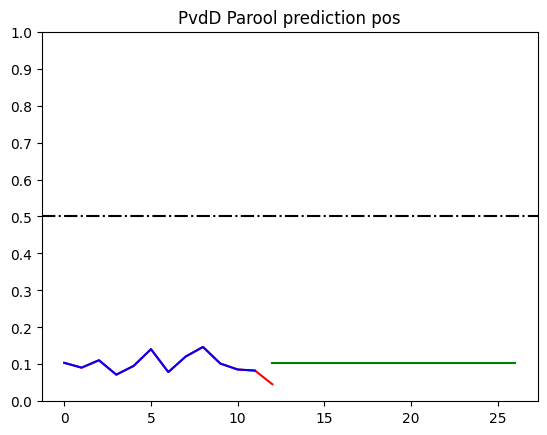

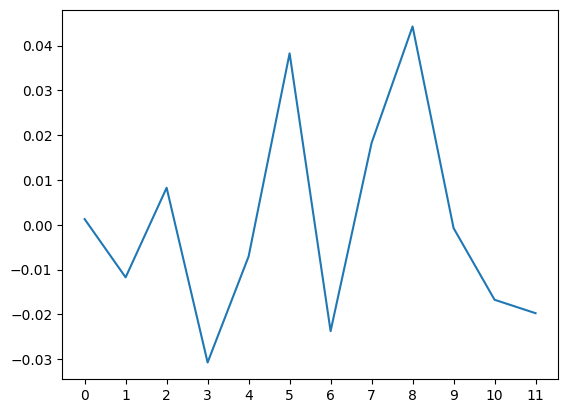

count    1.200000e+01
mean     2.470410e-12
std      1.821164e-02
min     -3.093056e-02
25%     -1.068056e-02
50%      8.194444e-04
75%      1.381944e-02
max      3.106944e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


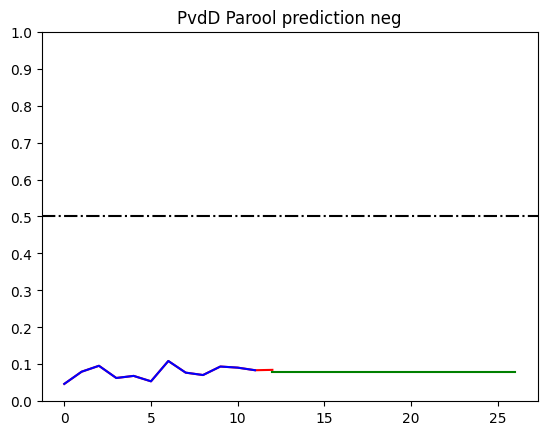

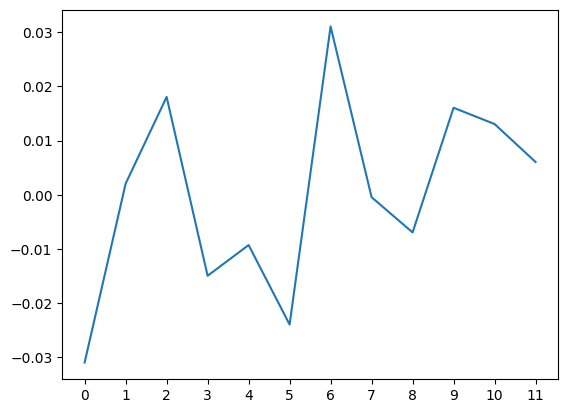

count    28.000000
mean      0.036112
std       0.155513
min      -0.101049
25%      -0.023777
50%       0.001712
75%       0.048027
max       0.795000
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


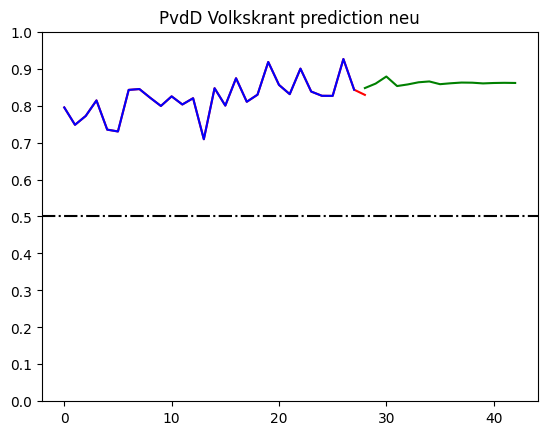

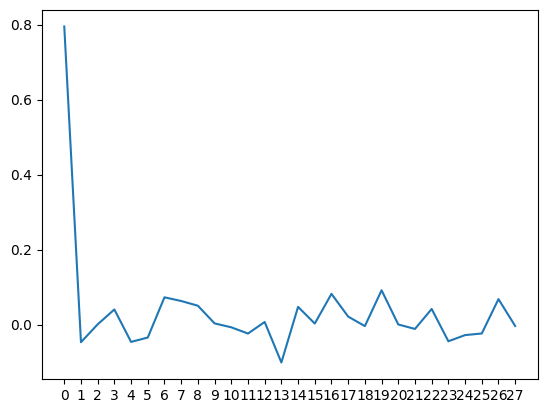

count    28.000000
mean      0.004018
std       0.037507
min      -0.045424
25%      -0.021982
50%       0.003607
75%       0.023186
max       0.146004
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


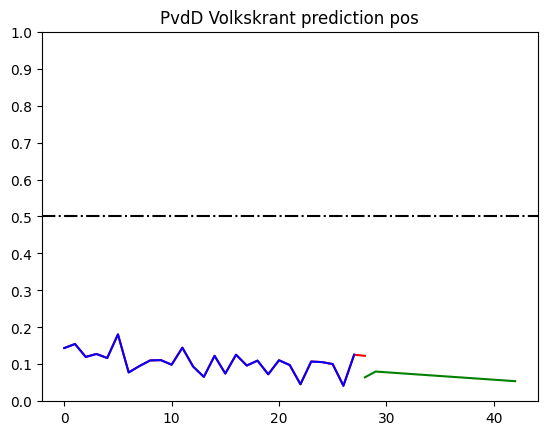

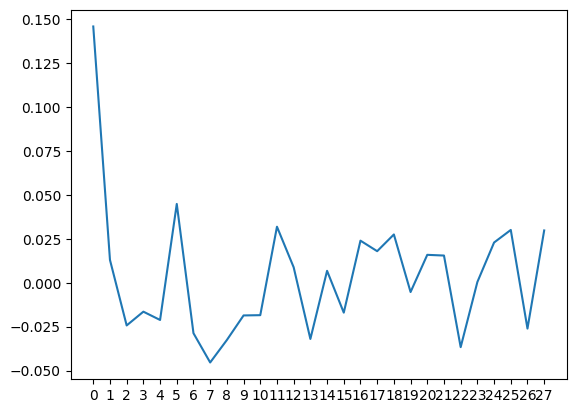

count    2.800000e+01
mean     2.160280e-11
std      4.425224e-02
min     -7.255357e-02
25%     -1.905357e-02
50%     -4.928571e-03
75%      1.669643e-02
max      1.524464e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


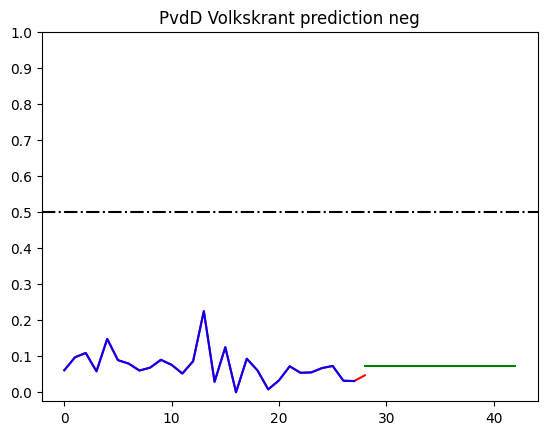

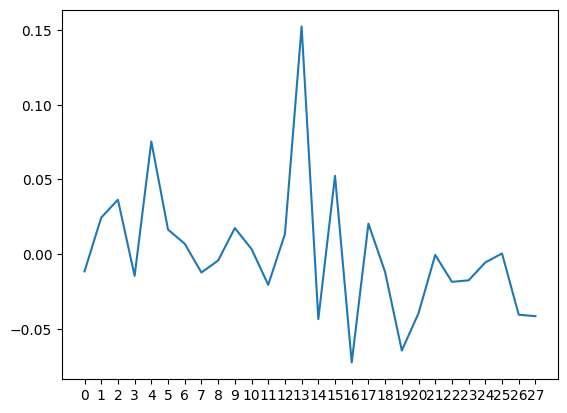

count    28.000000
mean      0.028855
std       0.148437
min      -0.092609
25%      -0.013961
50%       0.010411
75%       0.026657
max       0.767415
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


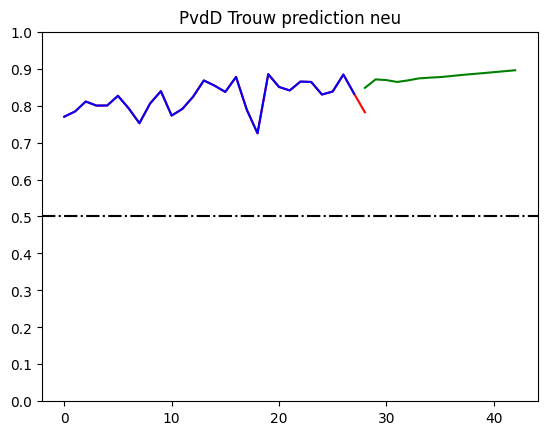

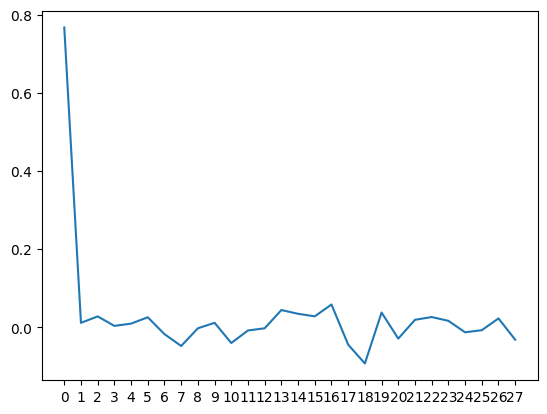

count    2.800000e+01
mean     1.657602e-12
std      3.305304e-02
min     -5.521131e-02
25%     -2.196131e-02
50%     -8.711310e-03
75%      2.053869e-02
max      8.378869e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


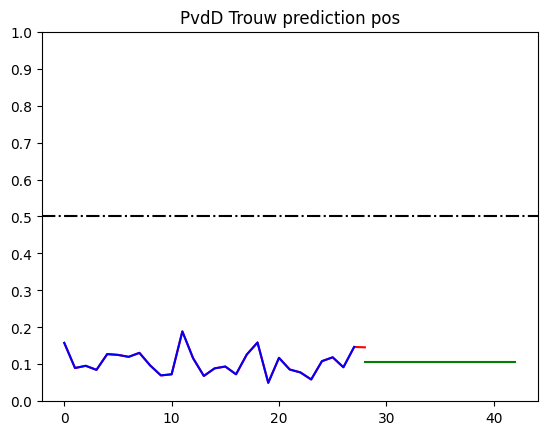

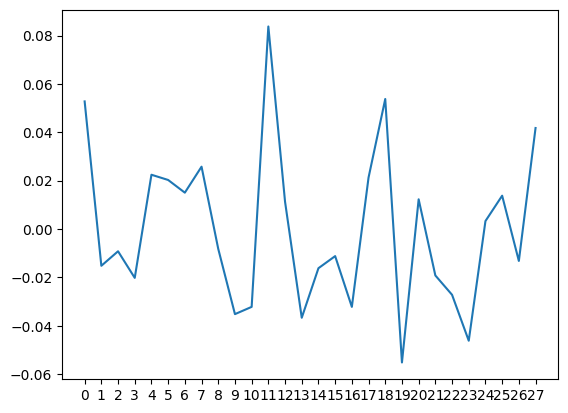

count    28.000000
mean      0.005310
std       0.032761
min      -0.062571
25%      -0.018655
50%       0.001283
75%       0.021878
max       0.075606
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


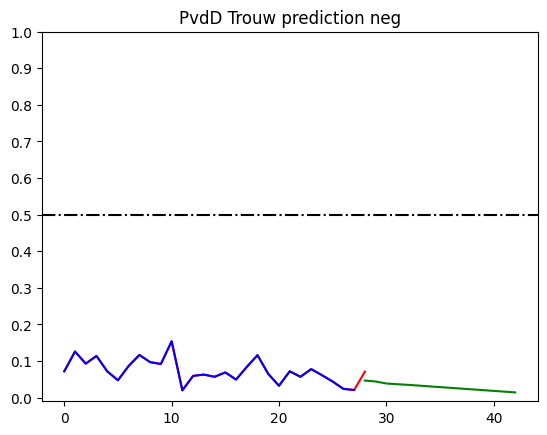

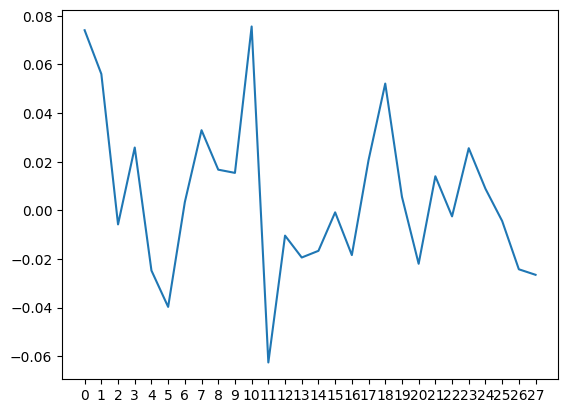

count    24.000000
mean      0.000464
std       0.039078
min      -0.110988
25%      -0.023857
50%       0.011481
75%       0.021731
max       0.087751
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


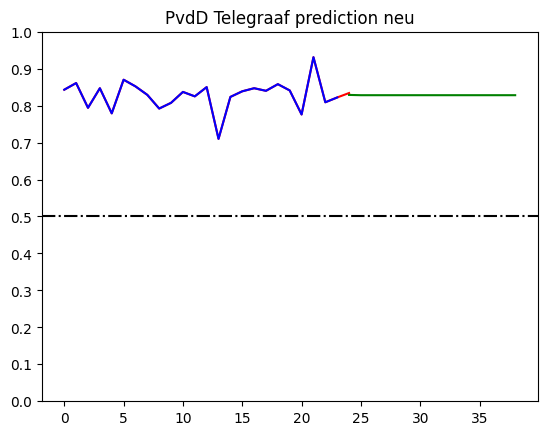

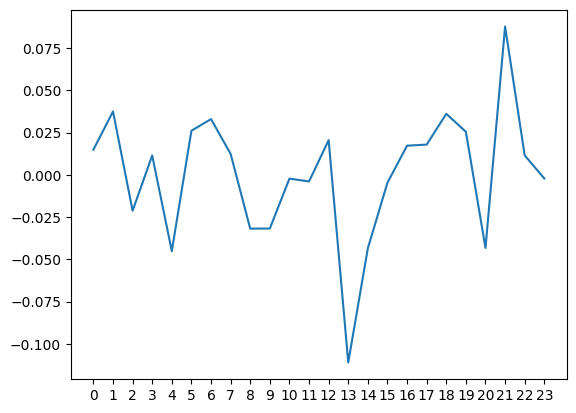

count    24.000000
mean     -0.000431
std       0.029015
min      -0.056962
25%      -0.015742
50%      -0.000214
75%       0.015224
max       0.070956
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


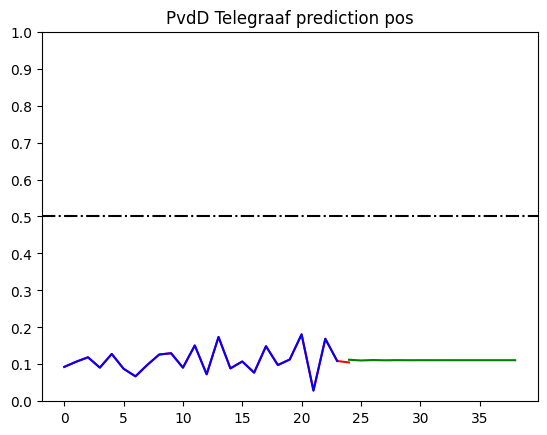

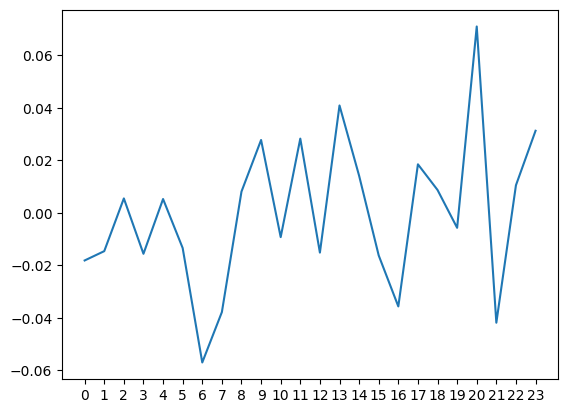

count    2.400000e+01
mean     4.787501e-13
std      2.557852e-02
min     -4.975000e-02
25%     -1.800000e-02
50%      2.250000e-03
75%      1.800000e-02
max      5.525000e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


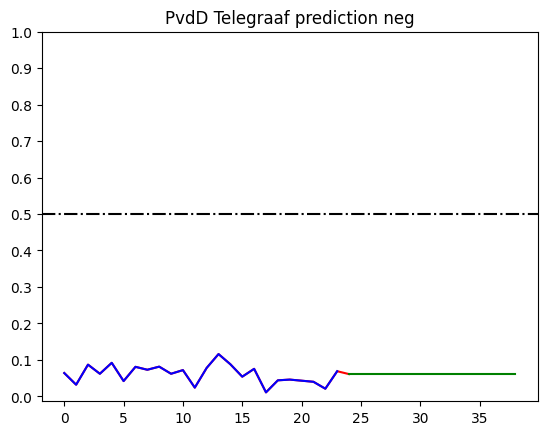

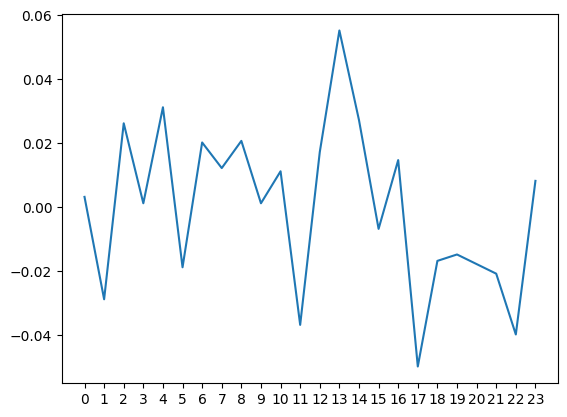

count    5.700000e+01
mean     5.711324e-12
std      3.753578e-02
min     -9.162339e-02
25%     -2.162339e-02
50%     -3.623392e-03
75%      2.437661e-02
max      8.437661e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


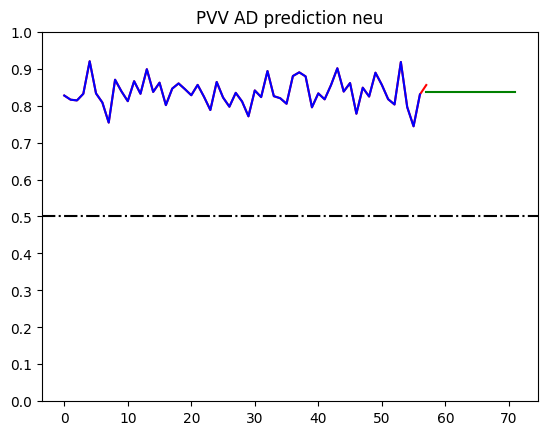

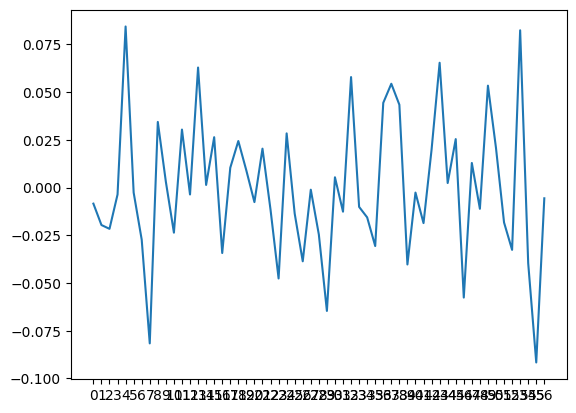

count    5.700000e+01
mean     1.031237e-11
std      3.017936e-02
min     -7.136871e-02
25%     -1.536871e-02
50%      6.312866e-04
75%      1.763129e-02
max      8.963129e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


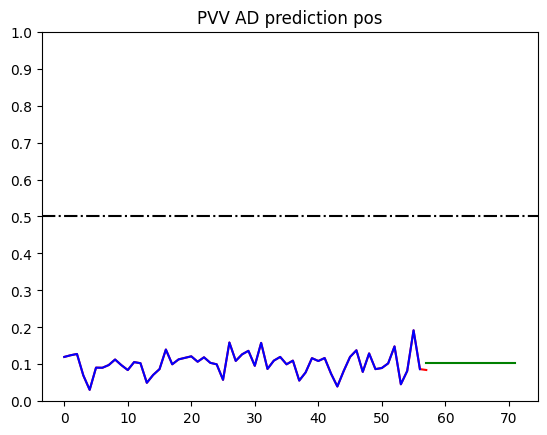

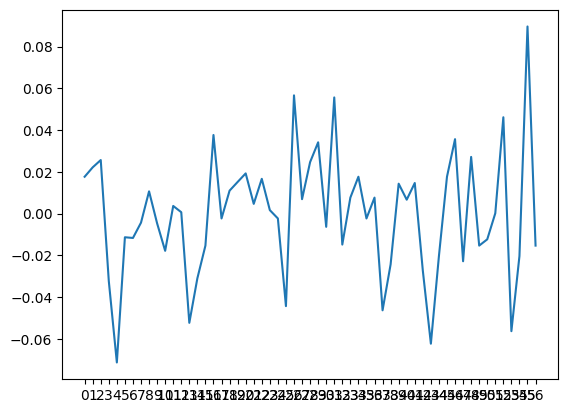

count    5.700000e+01
mean     1.017551e-13
std      2.845337e-02
min     -5.184561e-02
25%     -1.634561e-02
50%     -3.512281e-03
75%      1.715439e-02
max      8.615439e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


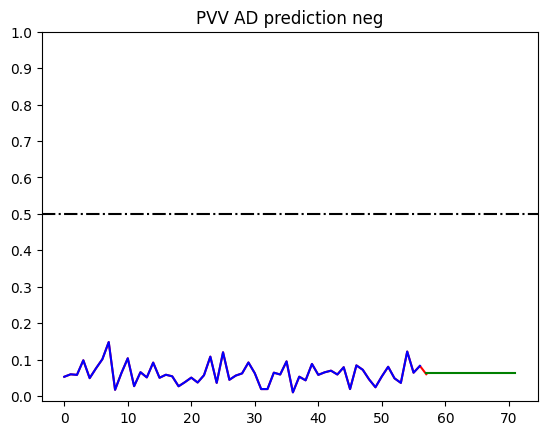

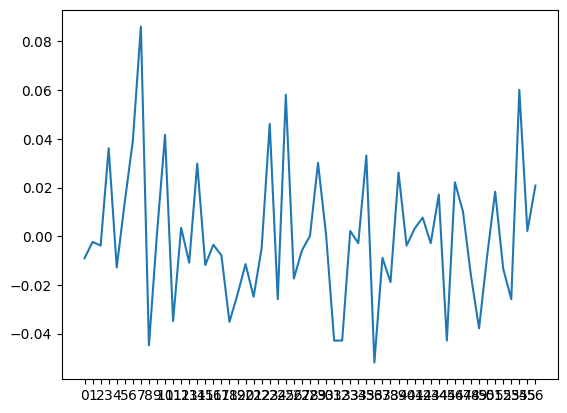

count    9.000000e+00
mean     7.376445e-12
std      6.601704e-02
min     -1.056667e-01
25%     -4.866667e-02
50%     -1.666667e-03
75%      4.833333e-02
max      8.433333e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


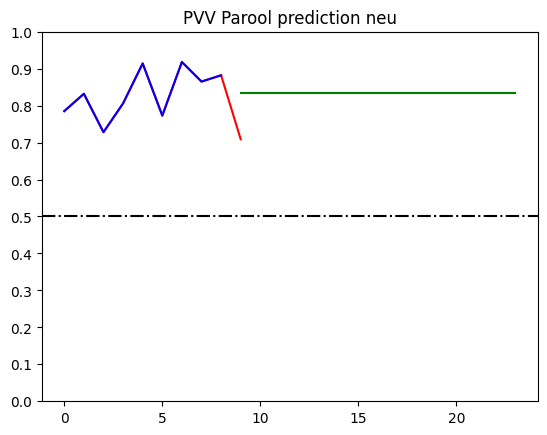

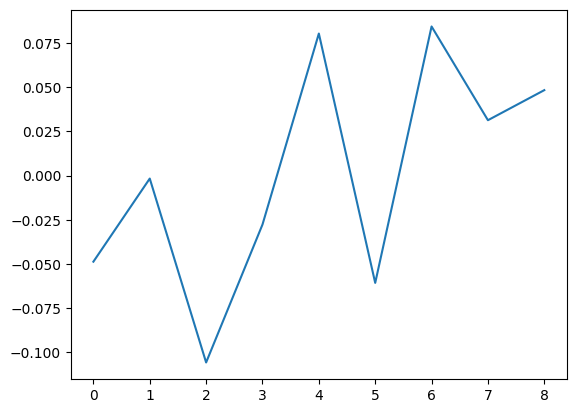

count    9.000000
mean    -0.005178
std      0.035508
min     -0.037278
25%     -0.028597
50%     -0.017866
75%      0.003350
max      0.070418
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


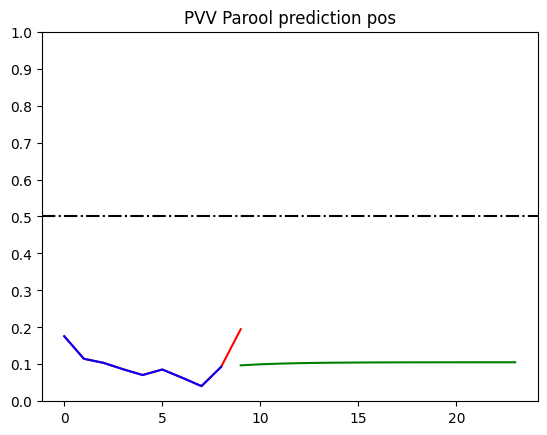

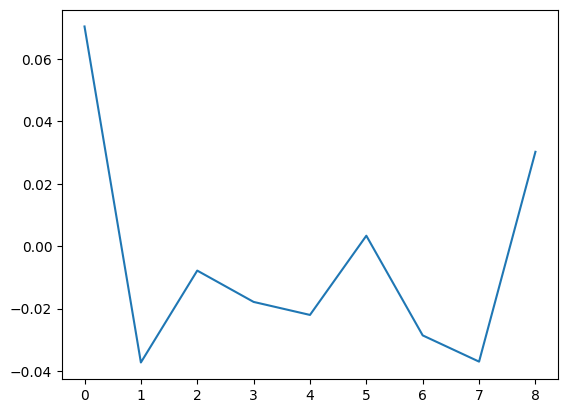

count    9.000000e+00
mean     7.547426e-12
std      5.611771e-02
min     -5.814815e-02
25%     -4.814815e-02
50%     -2.014815e-02
75%      3.418519e-02
max      9.385185e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


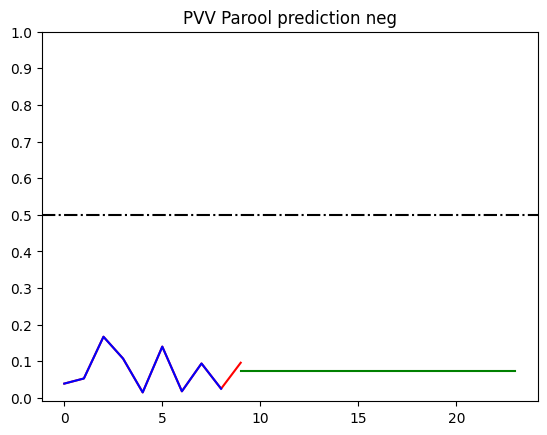

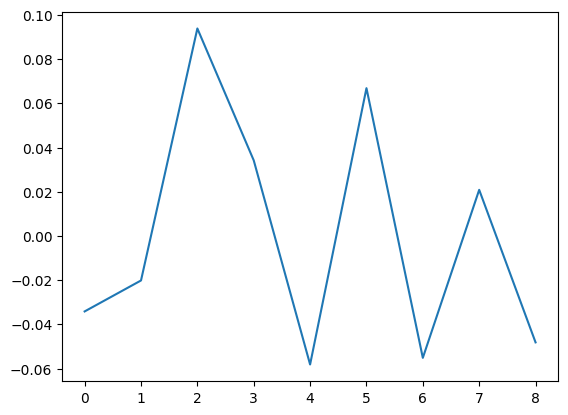

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


count    4.400000e+01
mean     3.265289e-11
std      5.122277e-02
min     -1.407652e-01
25%     -2.576515e-02
50%      2.234849e-03
75%      3.548485e-02
max      1.082348e-01
dtype: float64


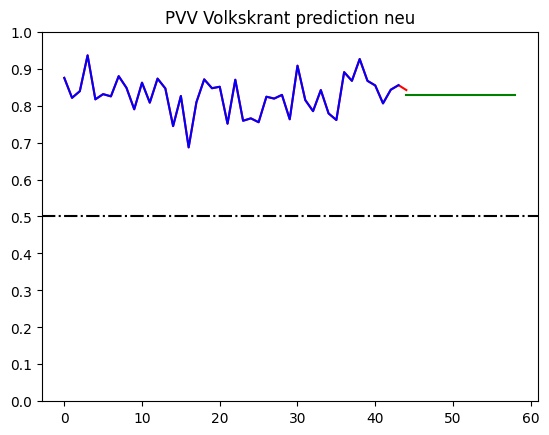

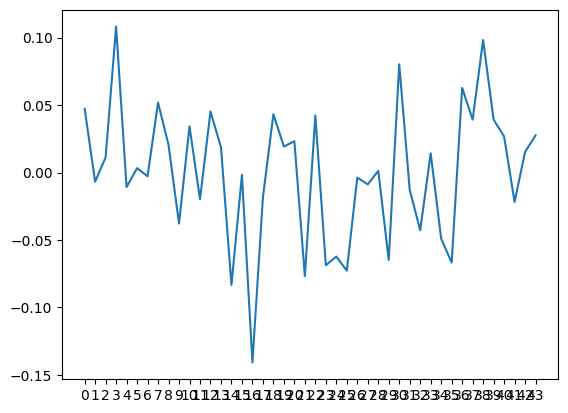

count    4.400000e+01
mean    -1.230077e-17
std      3.138228e-02
min     -6.328598e-02
25%     -2.153598e-02
50%      7.140152e-04
75%      2.083902e-02
max      7.871402e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


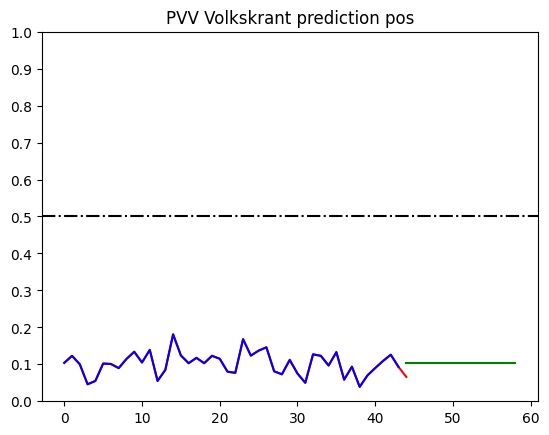

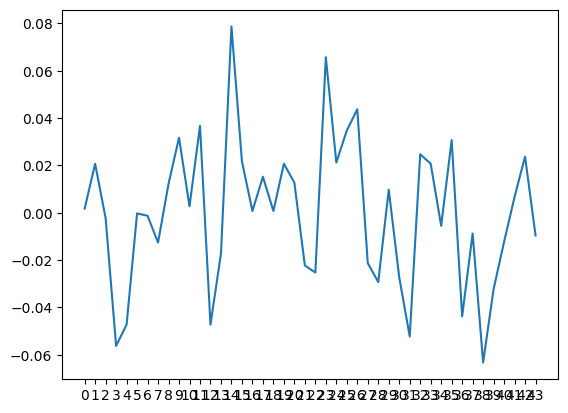

count    4.400000e+01
mean     2.682071e-11
std      4.182691e-02
min     -5.292614e-02
25%     -3.492614e-02
50%     -7.926136e-03
75%      2.132386e-02
max      1.400739e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


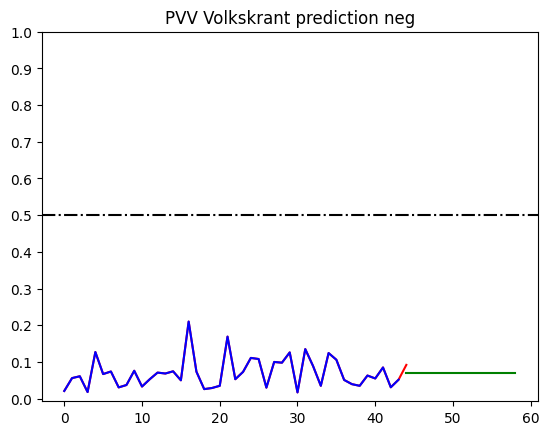

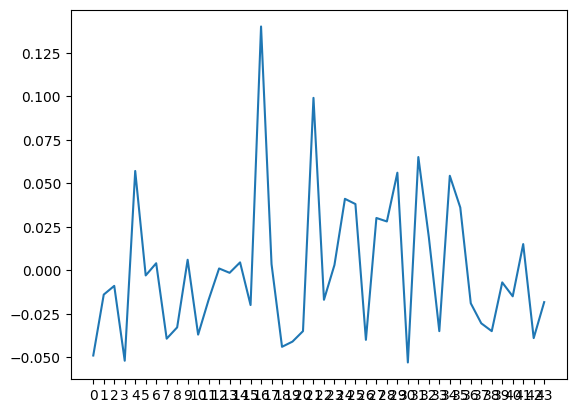

count    5.100000e+01
mean     2.611955e-11
std      5.417987e-02
min     -2.138739e-01
25%     -3.137386e-02
50%      9.626144e-03
75%      3.232614e-02
max      1.001261e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


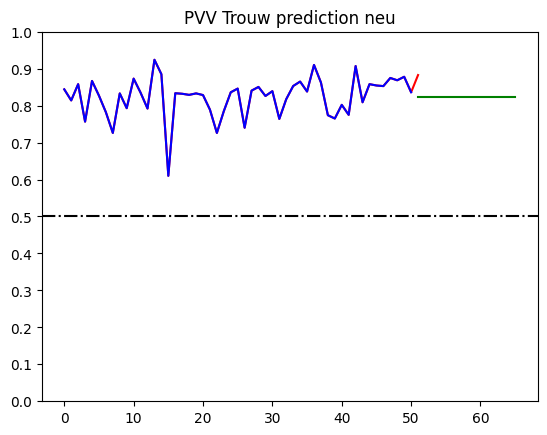

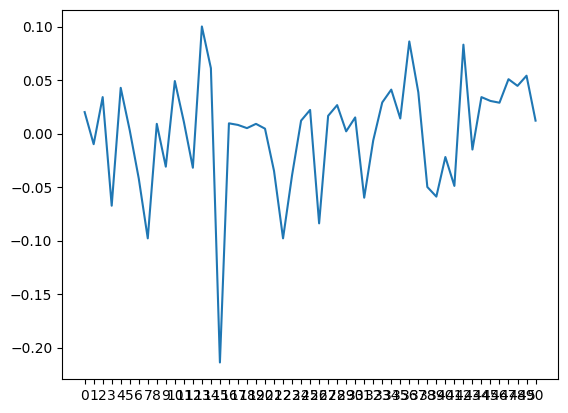

count    5.100000e+01
mean     1.006900e-11
std      4.367830e-02
min     -7.282386e-02
25%     -2.832386e-02
50%     -5.823856e-03
75%      2.167614e-02
max      1.991761e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


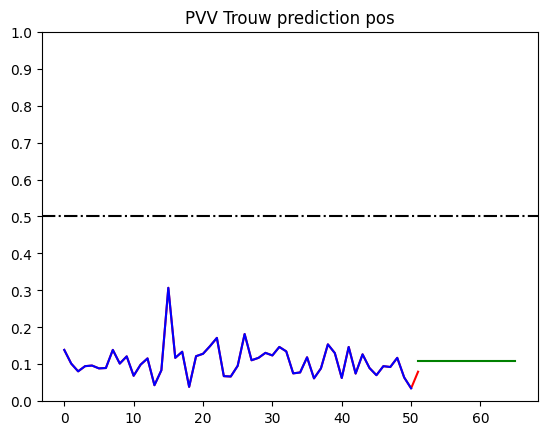

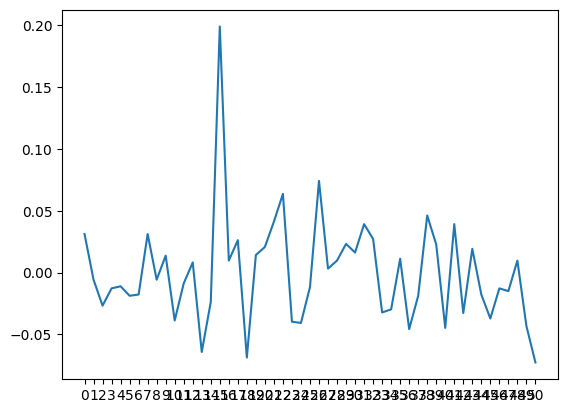

count    5.100000e+01
mean     3.713420e-11
std      3.504867e-02
min     -5.423791e-02
25%     -2.473791e-02
50%     -7.237908e-03
75%      1.626209e-02
max      8.026209e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


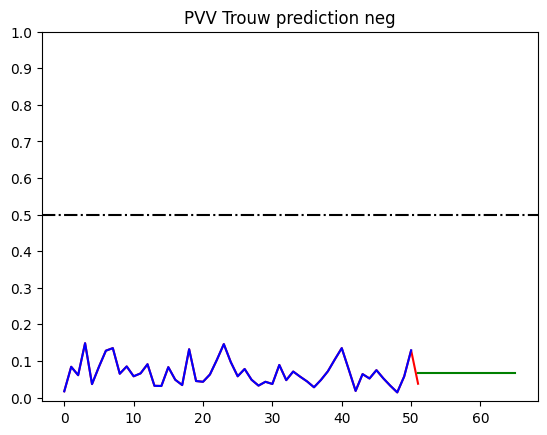

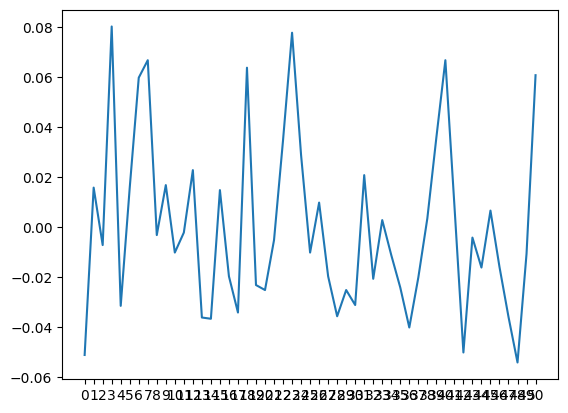

count    4.000000e+01
mean     7.006484e-12
std      4.319200e-02
min     -9.916577e-02
25%     -2.141577e-02
50%      4.000893e-03
75%      1.976280e-02
max      9.183423e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


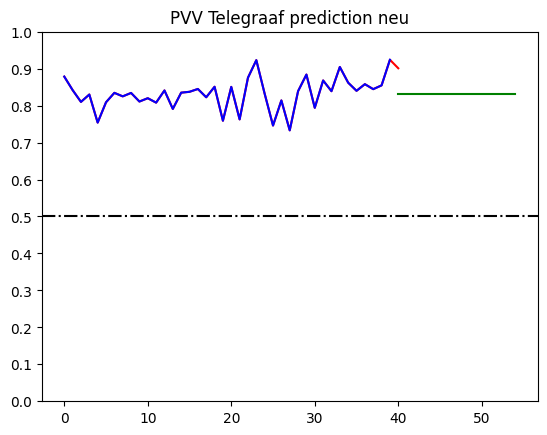

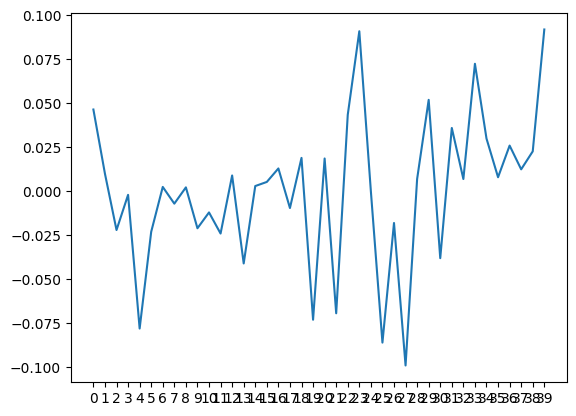

count    4.000000e+01
mean     1.510681e-12
std      2.852759e-02
min     -5.909762e-02
25%     -1.934762e-02
50%     -6.097619e-03
75%      1.690238e-02
max      7.990238e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


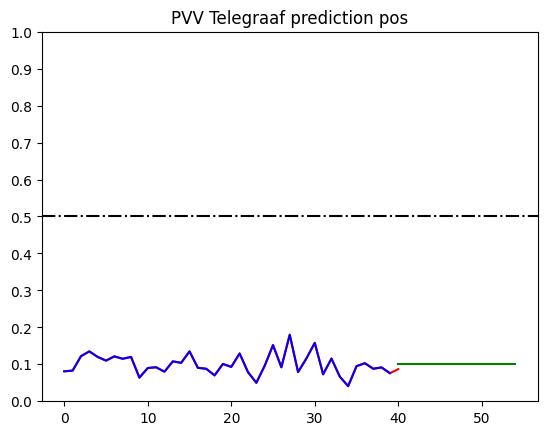

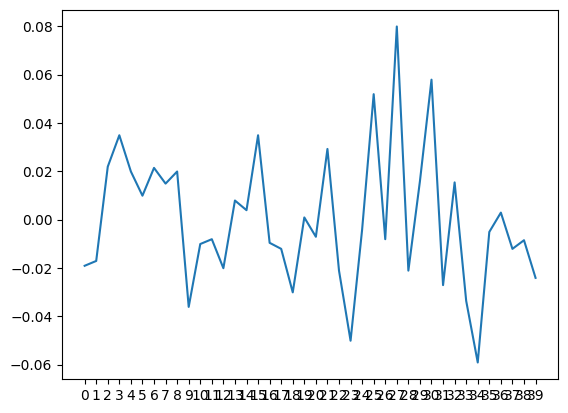

count    4.000000e+01
mean     8.744398e-12
std      3.201286e-02
min     -6.775387e-02
25%     -2.231637e-02
50%     -1.253869e-03
75%      2.149613e-02
max      7.224613e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


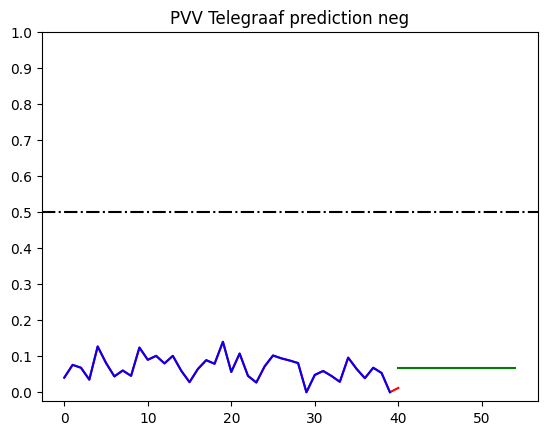

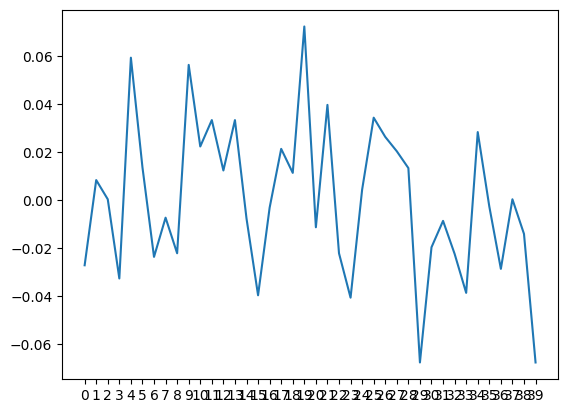

count    1.400000e+01
mean     1.242777e-11
std      2.890464e-02
min     -4.435714e-02
25%     -1.660714e-02
50%     -5.857143e-03
75%      1.739286e-02
max      6.564286e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


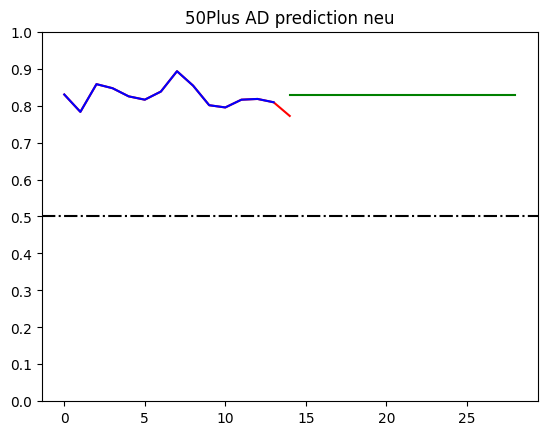

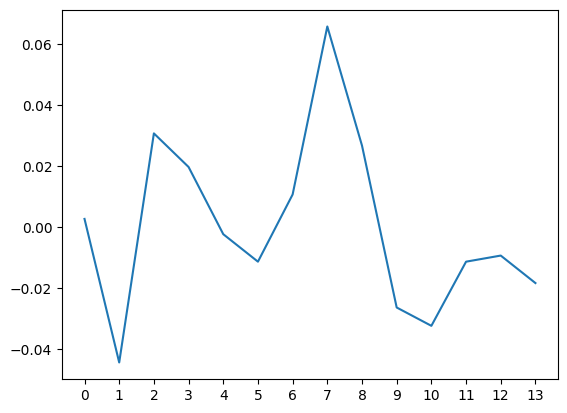

count    1.400000e+01
mean     8.753766e-12
std      3.319301e-02
min     -6.160714e-02
25%     -2.535714e-02
50%      1.014286e-02
75%      1.314286e-02
max      6.139286e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


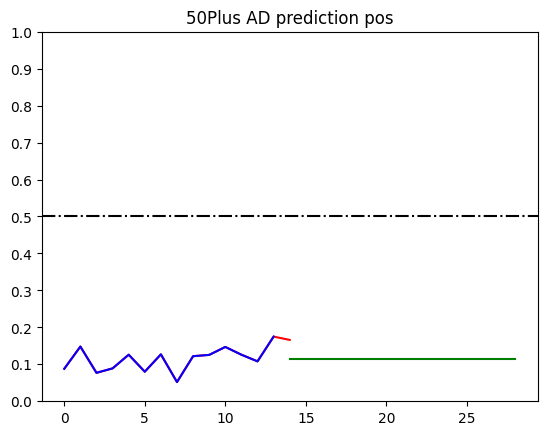

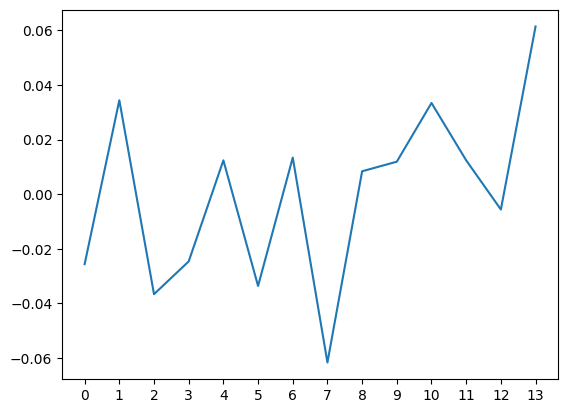

count    14.000000
mean      0.000696
std       0.021335
min      -0.037421
25%      -0.007742
50%       0.002498
75%       0.012217
max       0.040284
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


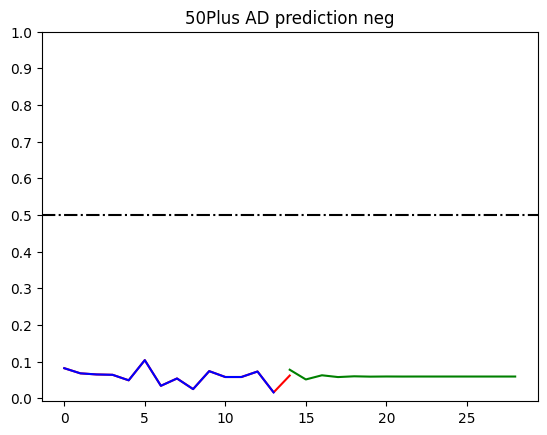

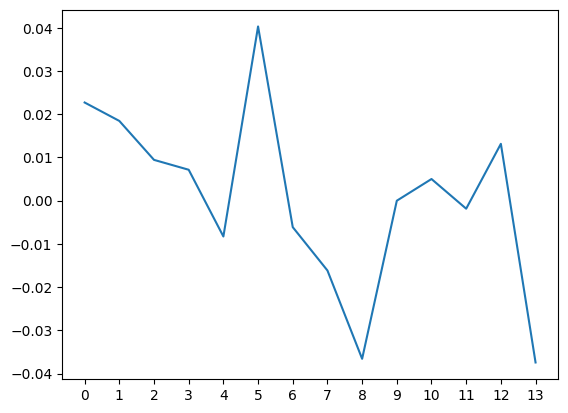

count    6.000000e+00
mean     7.746137e-12
std      4.476010e-02
min     -7.566667e-02
25%     -1.791667e-02
50%      1.033333e-02
75%      3.108333e-02
max      4.433333e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


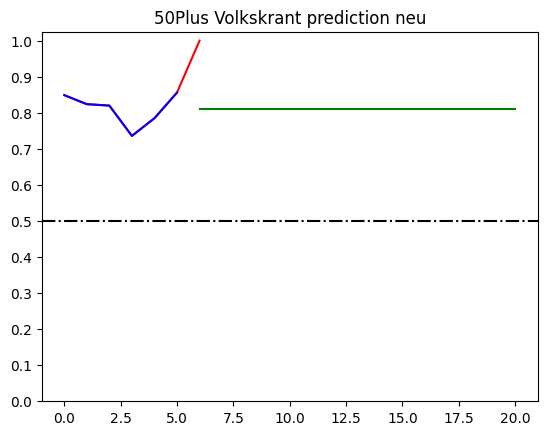

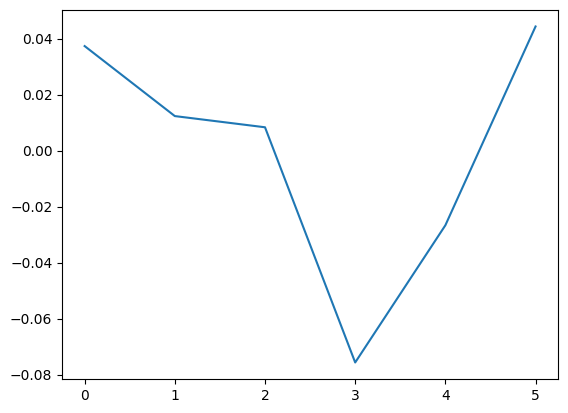

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


count    6.000000e+00
mean     7.883479e-12
std      3.407296e-02
min     -5.316667e-02
25%     -1.191667e-02
50%     -1.166667e-03
75%      1.783333e-02
max      4.683333e-02
dtype: float64


/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


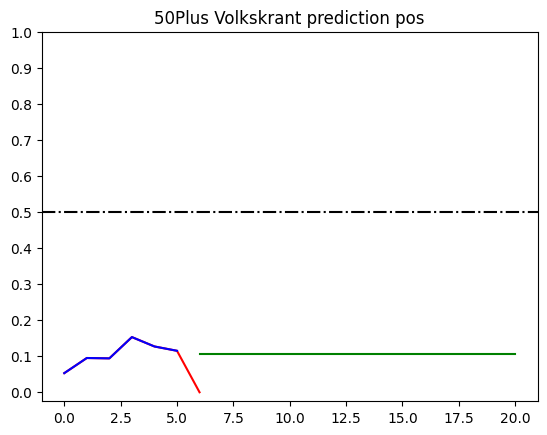

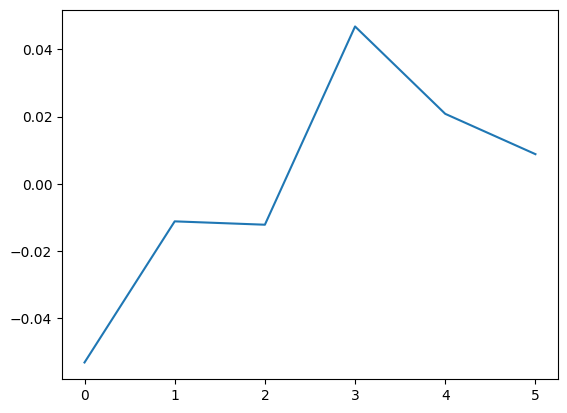

count    6.000000e+00
mean     5.762465e-12
std      2.781846e-02
min     -5.233333e-02
25%     -8.333333e-04
50%      5.166667e-03
75%      1.341667e-02
max      2.866667e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


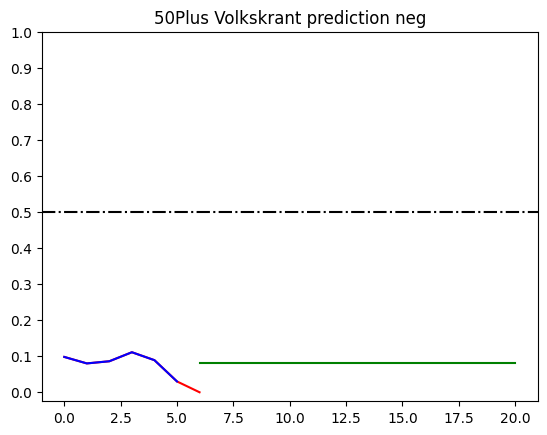

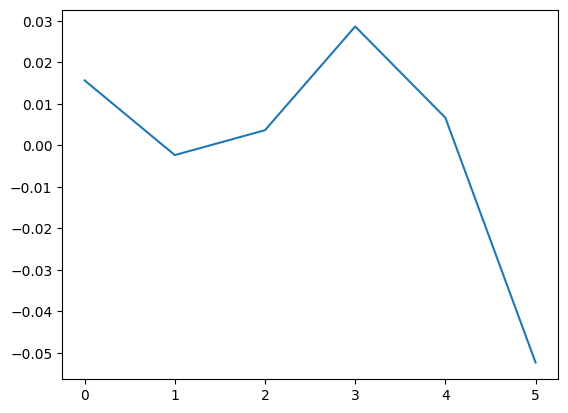

count    6.000000
mean     0.010460
std      0.023041
min     -0.009827
25%     -0.006003
50%      0.007562
75%      0.013300
max      0.052777
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


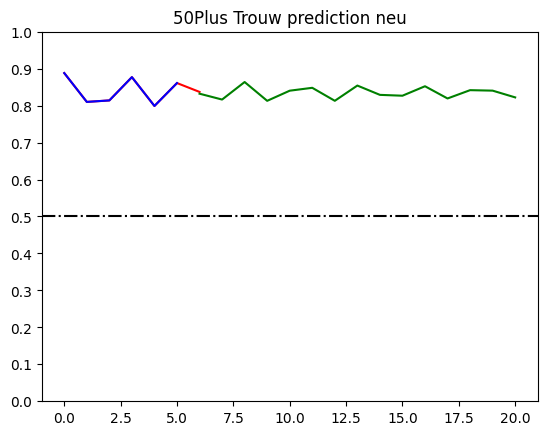

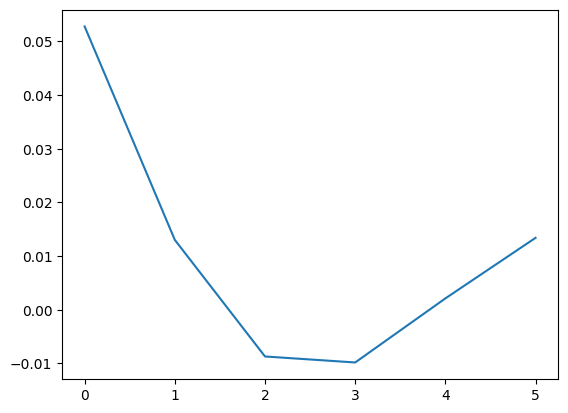

count    6.000000e+00
mean     5.712951e-12
std      3.994830e-02
min     -6.266667e-02
25%     -1.216667e-02
50%     -2.166667e-03
75%      1.908333e-02
max      5.633333e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


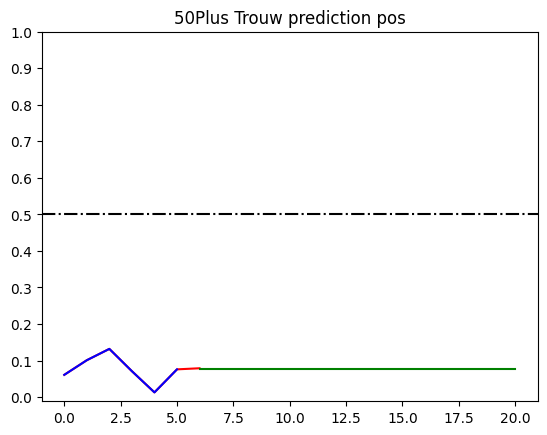

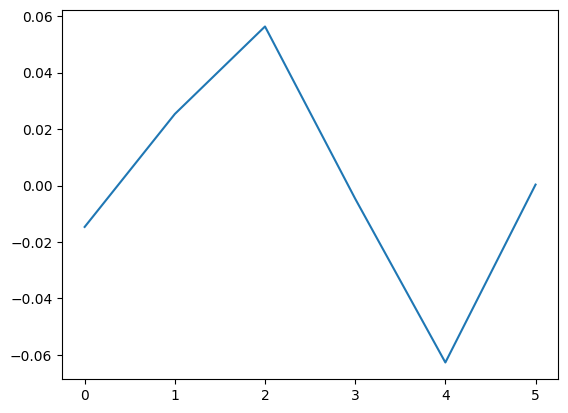

count    6.000000e+00
mean     1.602760e-12
std      5.356367e-02
min     -3.166667e-02
25%     -3.041667e-02
50%     -2.466667e-02
75%     -1.666667e-04
max      1.053333e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


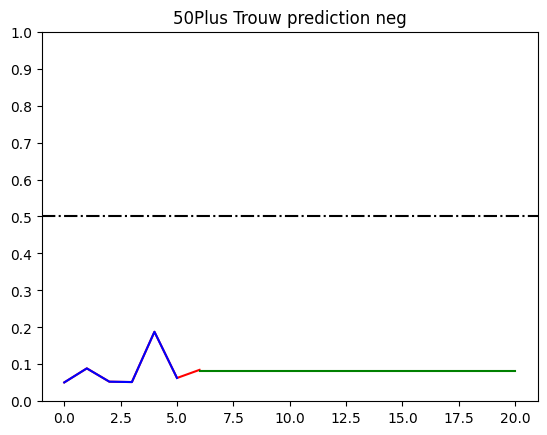

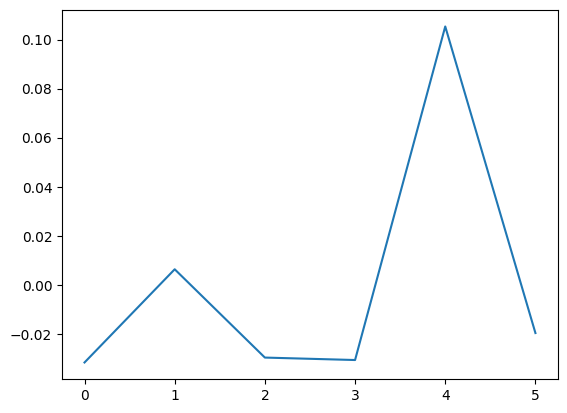

count    5.000000
mean    -0.004052
std      0.023129
min     -0.026198
25%     -0.014456
50%     -0.011758
75%     -0.002246
max      0.034399
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


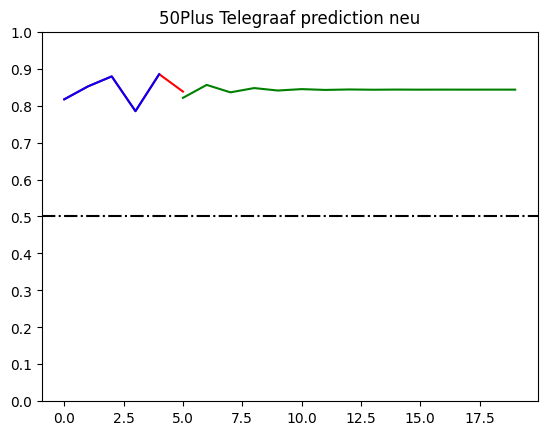

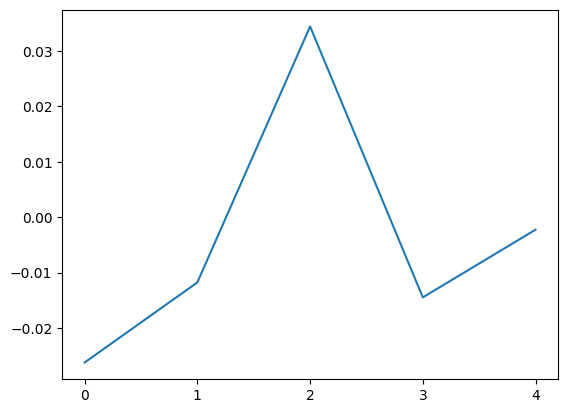

count    5.000000
mean     0.006948
std      0.024289
min     -0.020051
25%     -0.006563
50%      0.002167
75%      0.015453
max      0.043733
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


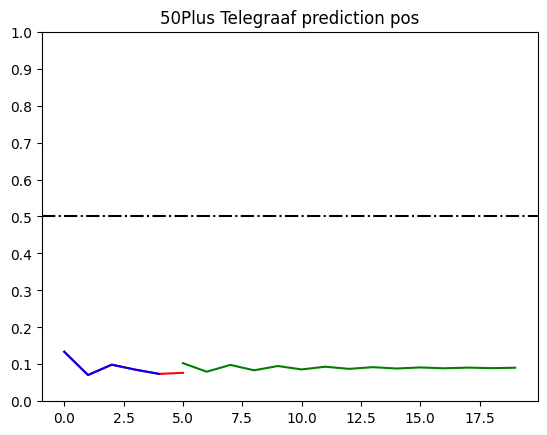

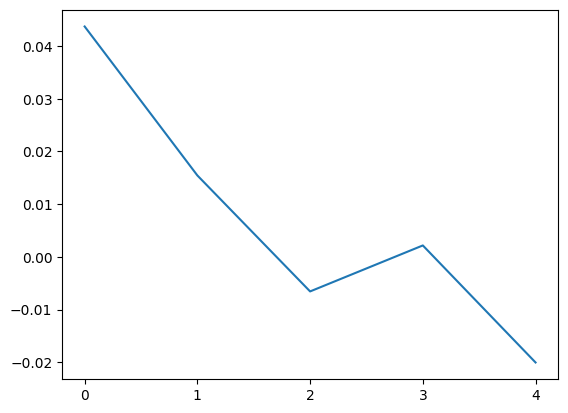

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(


count    5.000000
mean    -0.002563
std      0.027179
min     -0.038744
25%     -0.017941
50%     -0.002778
75%      0.017460
max      0.029189
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


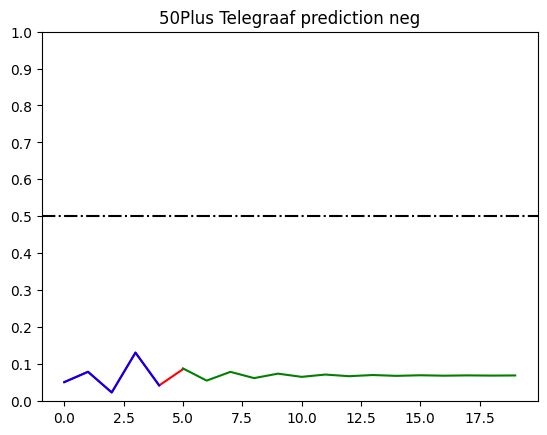

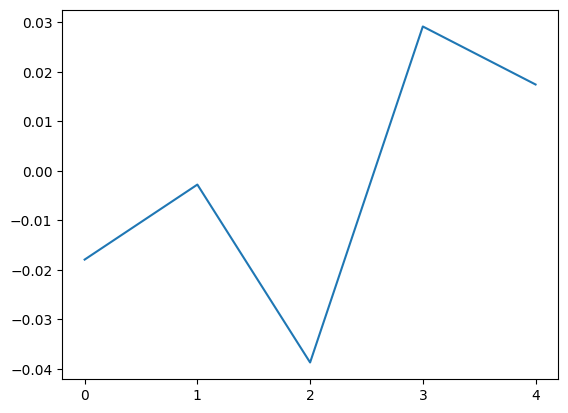

count    6.900000e+01
mean     6.596977e-17
std      3.524667e-02
min     -6.035507e-02
25%     -2.602174e-02
50%     -4.355072e-03
75%      2.064493e-02
max      9.964493e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


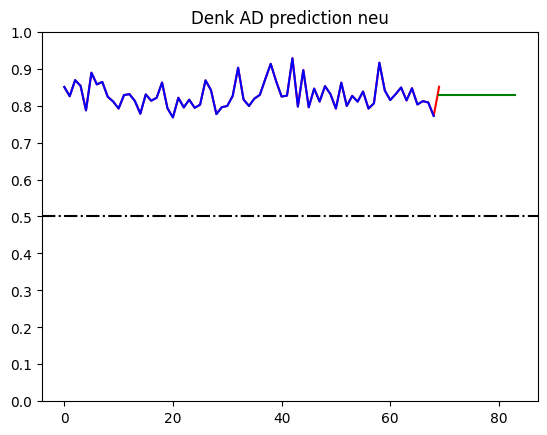

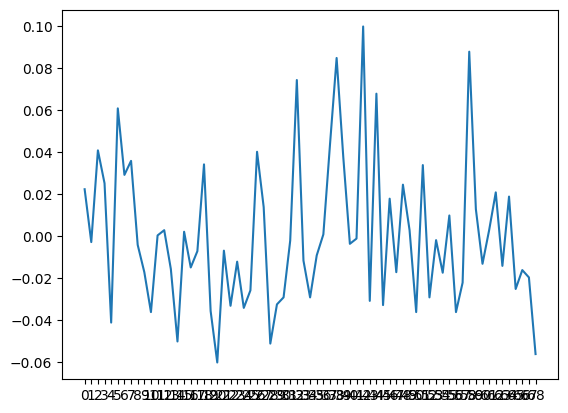

count    6.900000e+01
mean     7.893956e-12
std      3.022622e-02
min     -8.507367e-02
25%     -1.907367e-02
50%      2.592995e-03
75%      2.159300e-02
max      5.025966e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


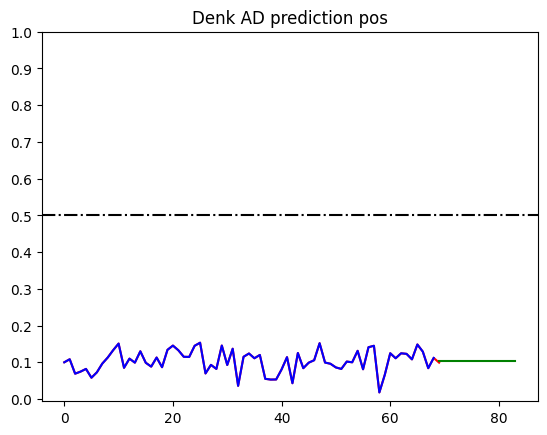

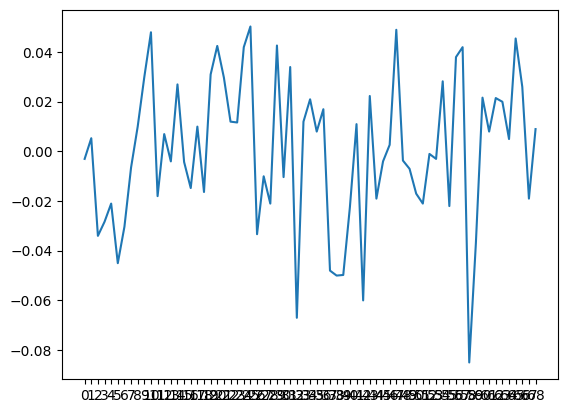

count    6.900000e+01
mean    -9.654113e-18
std      2.426897e-02
min     -4.855797e-02
25%     -1.655797e-02
50%     -3.557971e-03
75%      1.219203e-02
max      7.244203e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


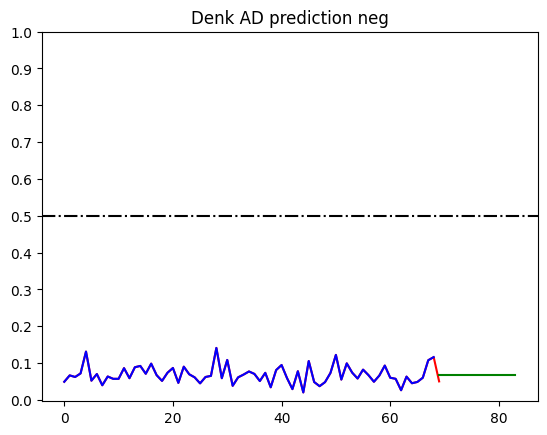

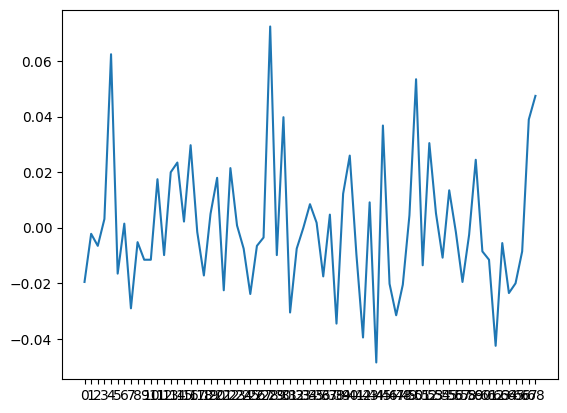

count    1.600000e+01
mean     3.315542e-13
std      5.035804e-02
min     -9.828125e-02
25%     -3.178125e-02
50%      9.968750e-03
75%      3.446875e-02
max      8.071875e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


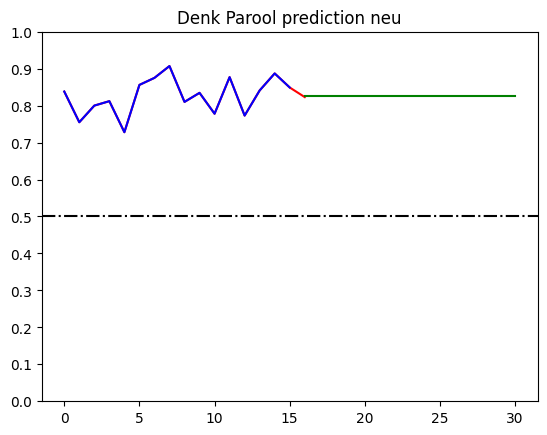

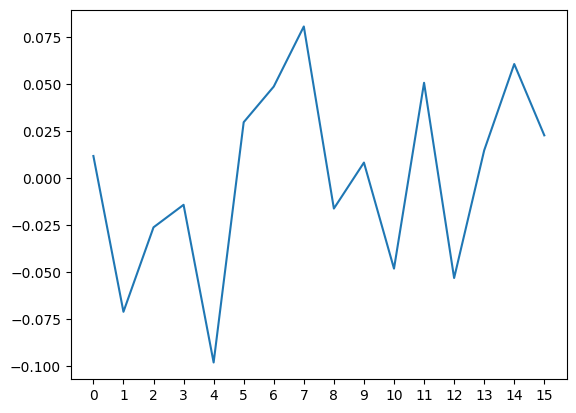

count    1.600000e+01
mean     2.730206e-11
std      3.327987e-02
min     -4.362500e-02
25%     -2.350000e-02
50%     -1.375000e-03
75%      2.187500e-02
max      6.237500e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


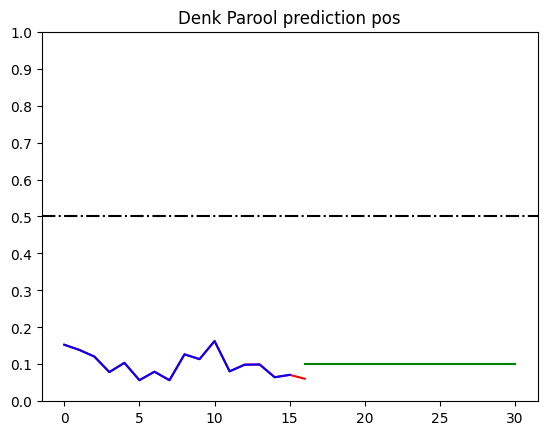

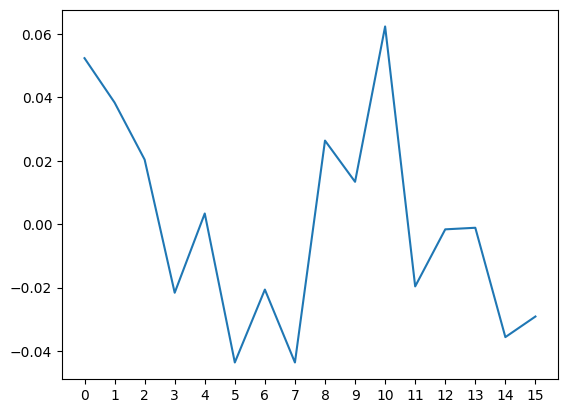

count    1.600000e+01
mean     3.397430e-13
std      3.932650e-02
min     -6.509375e-02
25%     -2.584375e-02
50%     -1.159375e-02
75%      1.840625e-02
max      9.390625e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


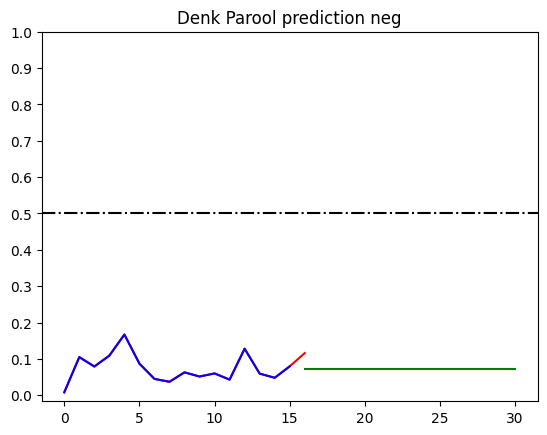

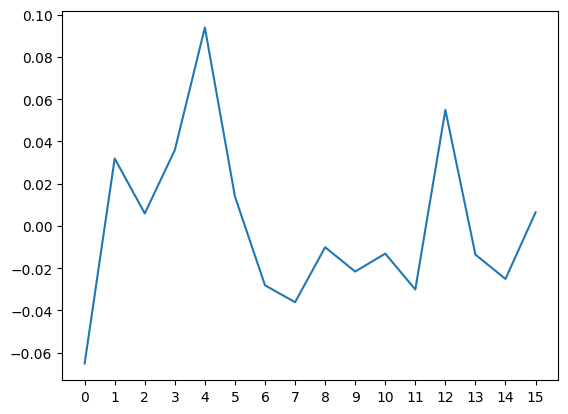

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


count    4.400000e+01
mean     8.018838e-15
std      4.471698e-02
min     -7.641667e-02
25%     -3.125000e-02
50%      3.000000e-03
75%      2.000000e-02
max      9.525000e-02
dtype: float64


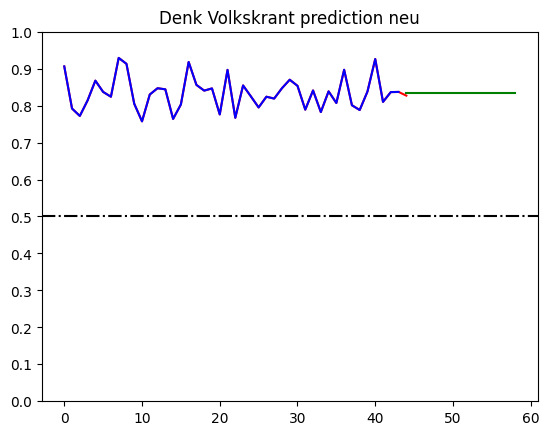

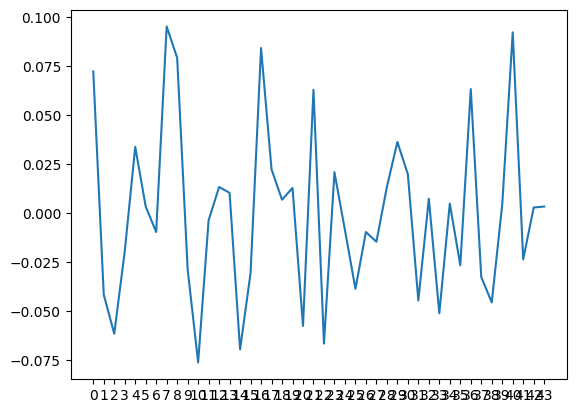

count    4.400000e+01
mean     1.834891e-12
std      3.346611e-02
min     -8.219129e-02
25%     -1.469129e-02
50%     -3.316288e-03
75%      2.405871e-02
max      6.880871e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


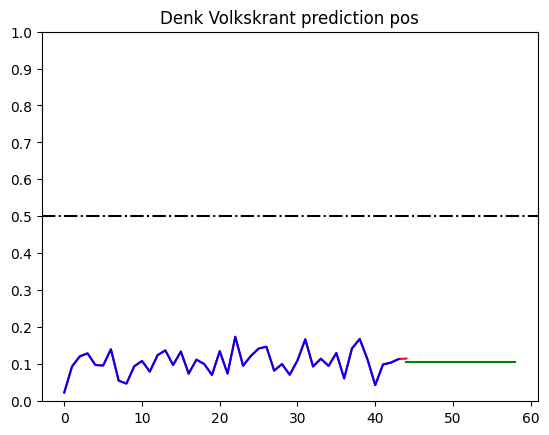

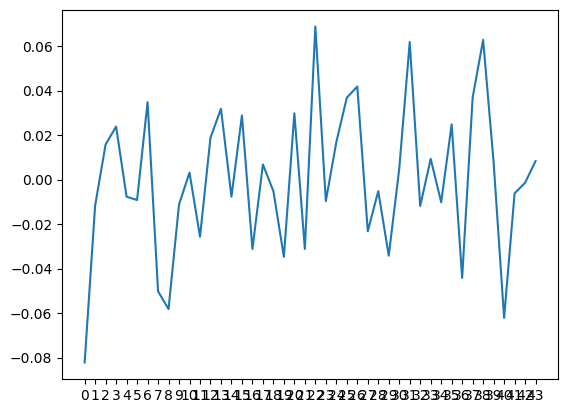

count    44.000000
mean      0.002176
std       0.026647
min      -0.039059
25%      -0.016238
50%      -0.003063
75%       0.013893
max       0.094000
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


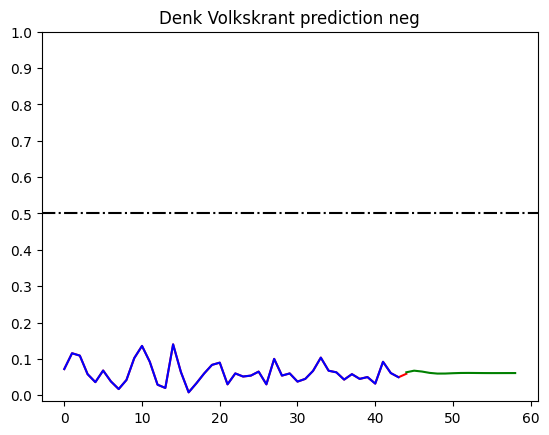

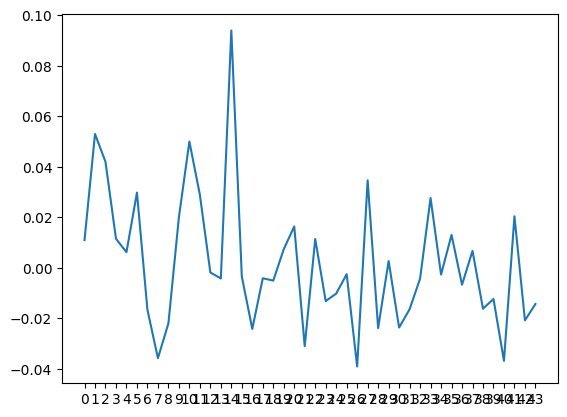

count    3.800000e+01
mean     1.315976e-11
std      4.680415e-02
min     -1.081272e-01
25%     -2.012719e-02
50%      6.372807e-03
75%      3.374781e-02
max      8.987281e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


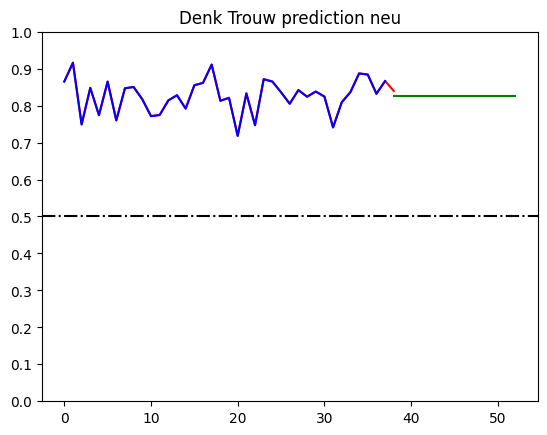

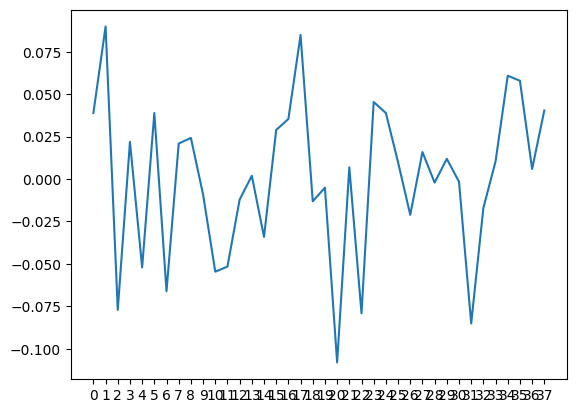

count    38.000000
mean     -0.001326
std       0.028562
min      -0.067364
25%      -0.016009
50%      -0.002797
75%       0.025767
max       0.046900
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


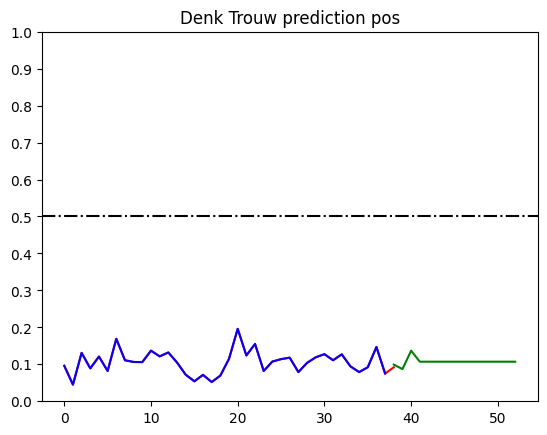

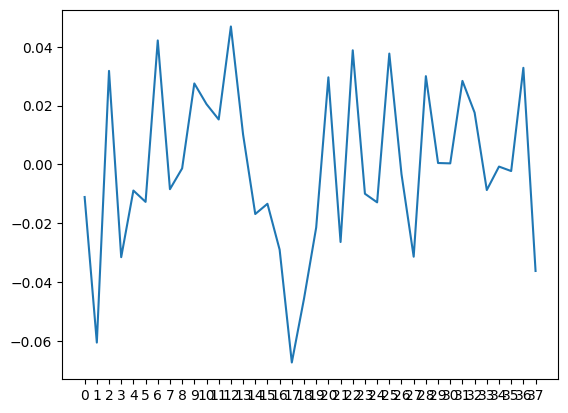

count    3.800000e+01
mean     6.876663e-14
std      3.091018e-02
min     -4.660088e-02
25%     -2.385088e-02
50%     -3.100877e-03
75%      1.639912e-02
max      8.139912e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


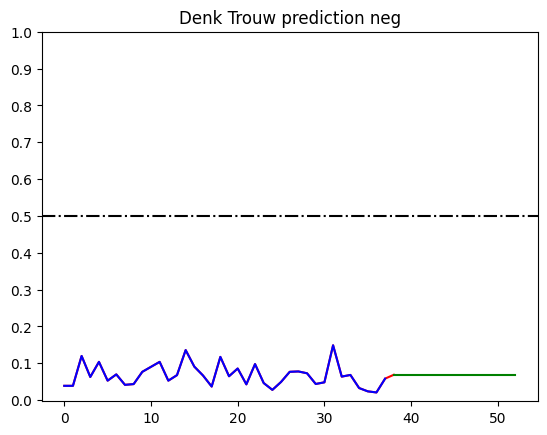

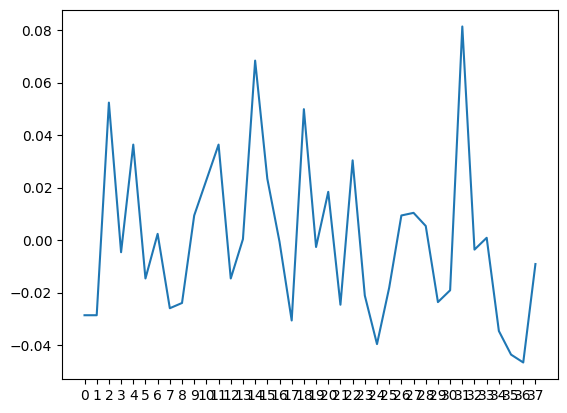

count    35.000000
mean      0.000051
std       0.043428
min      -0.059669
25%      -0.034162
50%      -0.002821
75%       0.025136
max       0.122404
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


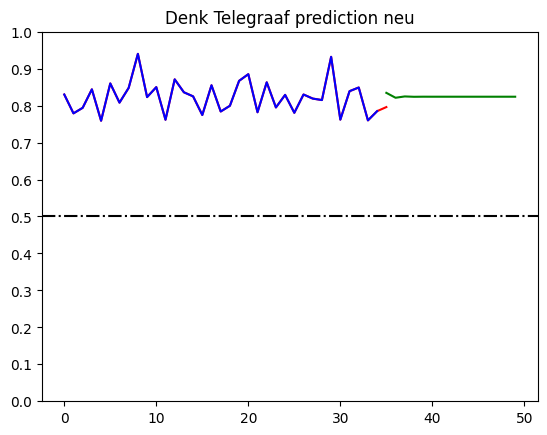

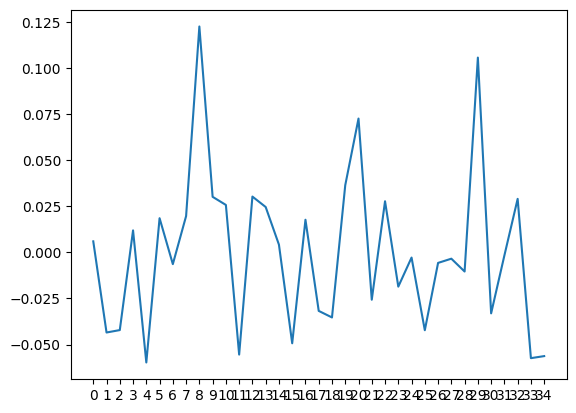

count    3.500000e+01
mean     1.784287e-17
std      3.026598e-02
min     -6.752381e-02
25%     -1.752381e-02
50%      4.976190e-03
75%      1.497619e-02
max      5.397619e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


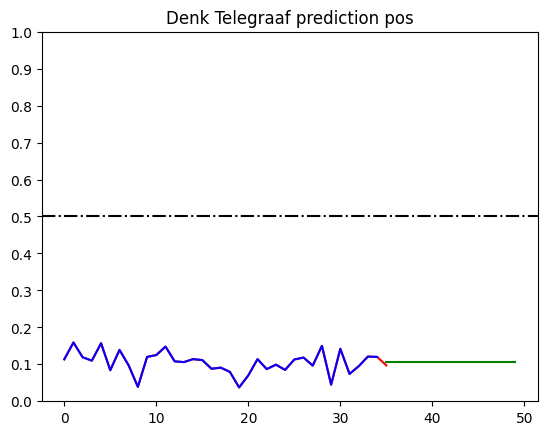

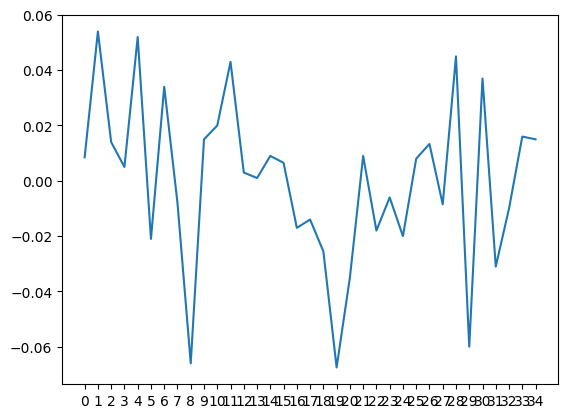

count    3.500000e+01
mean     5.779132e-12
std      3.019556e-02
min     -5.025714e-02
25%     -1.892381e-02
50%     -1.125714e-02
75%      2.399286e-02
max      5.374286e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


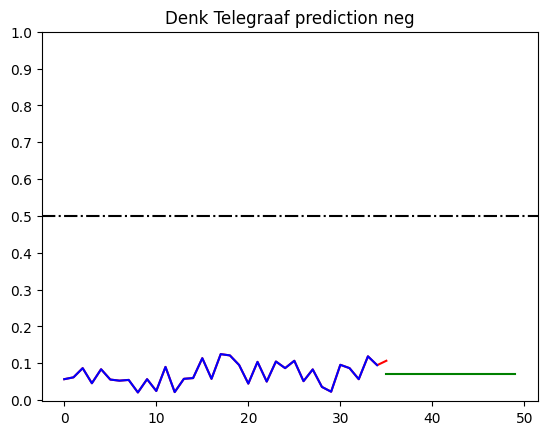

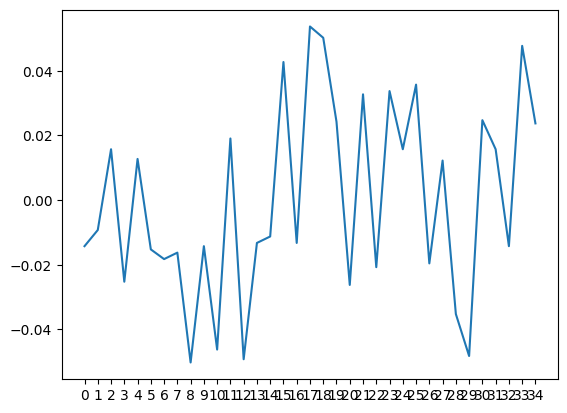

count    2.600000e+01
mean     3.581638e-11
std      5.310528e-02
min     -5.563462e-02
25%     -4.300962e-02
50%     -2.013462e-02
75%      1.836538e-02
max      1.153654e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


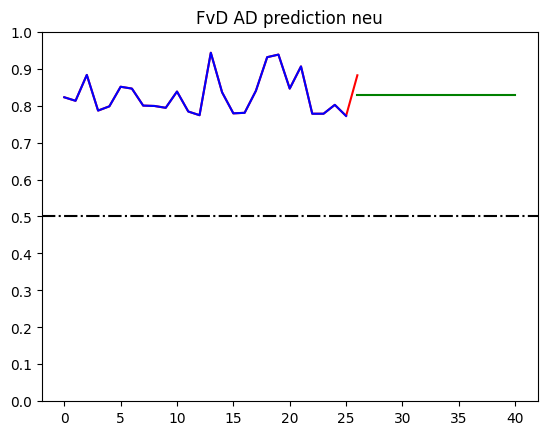

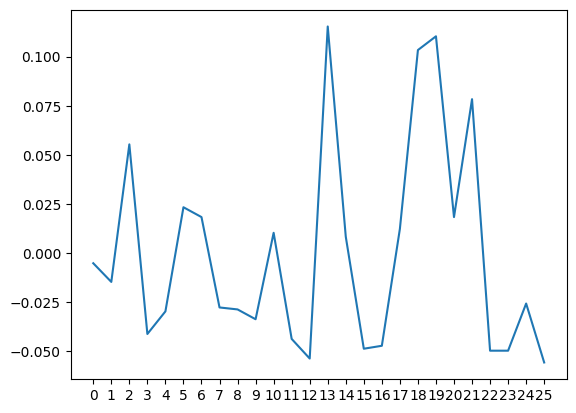

count    2.600000e+01
mean     4.587037e-12
std      4.162642e-02
min     -8.153846e-02
25%     -3.428846e-02
50%     -3.846153e-05
75%      2.708654e-02
max      8.046154e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


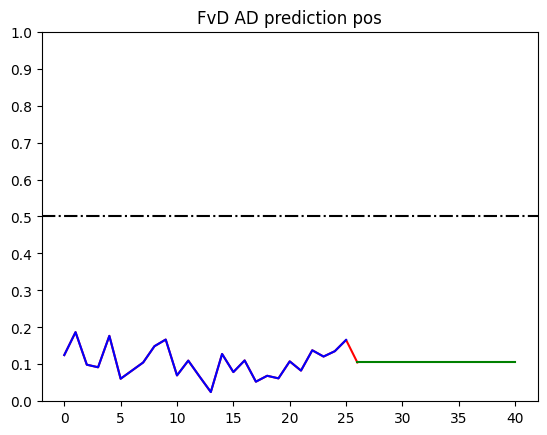

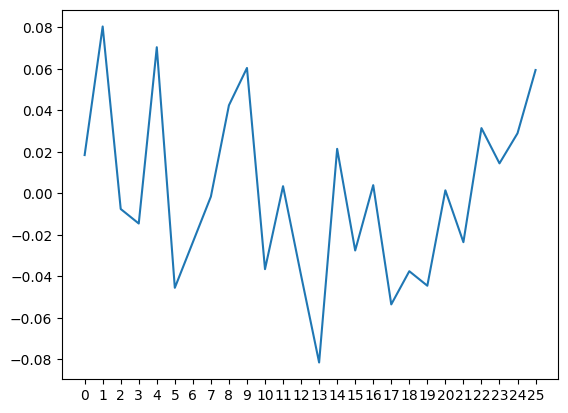

count    2.600000e+01
mean     2.458701e-13
std      4.463547e-02
min     -6.575000e-02
25%     -3.275000e-02
50%     -3.750000e-03
75%      3.337500e-02
max      9.225000e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


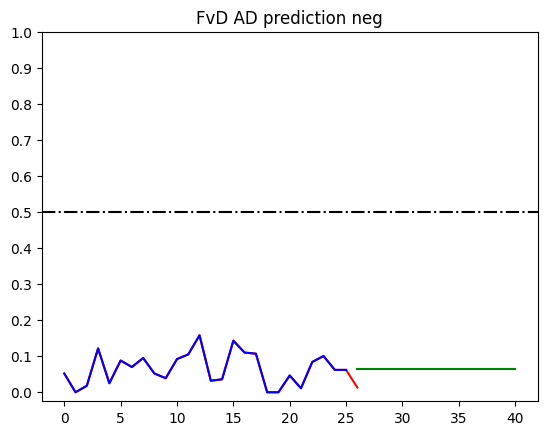

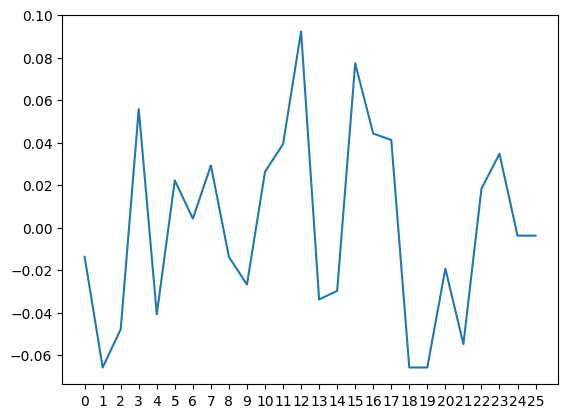

count         1
unique        1
top       0.754
freq          1
dtype: object


/Users/niels/Library/Python/3.11/lib/python/site-packages/pmdarima/arima/auto.py:444: UserWarning: Input time-series is completely constant; returning a (0, 0, 0) ARMA.
  warnings.warn('Input time-series is completely constant; '
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np

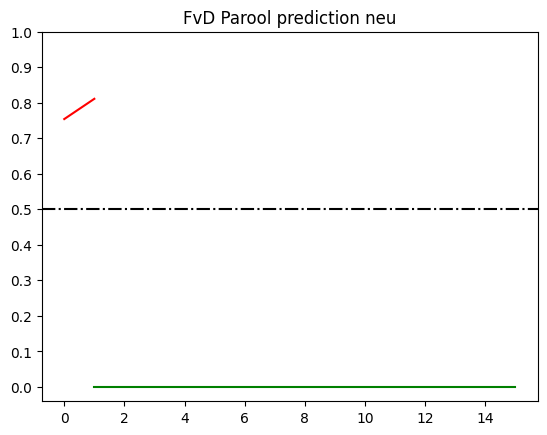

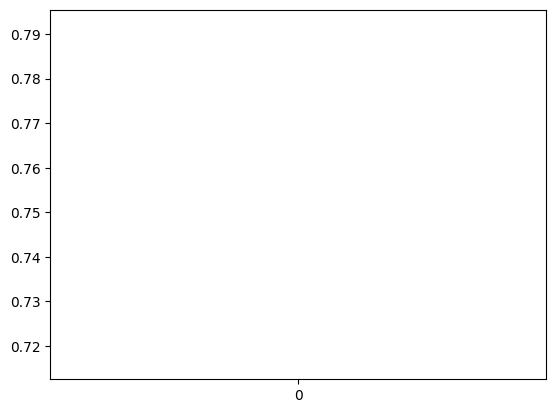

count         1
unique        1
top       0.115
freq          1
dtype: object


/Users/niels/Library/Python/3.11/lib/python/site-packages/pmdarima/arima/auto.py:444: UserWarning: Input time-series is completely constant; returning a (0, 0, 0) ARMA.
  warnings.warn('Input time-series is completely constant; '
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np

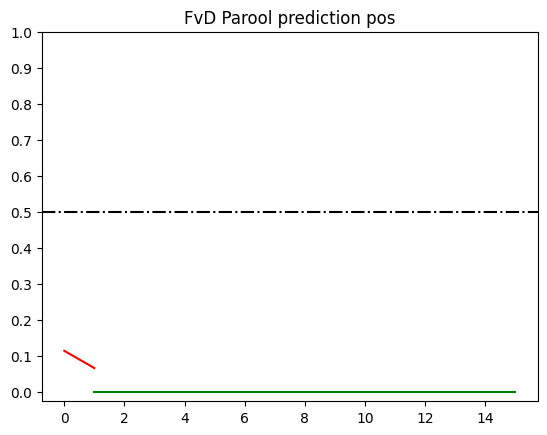

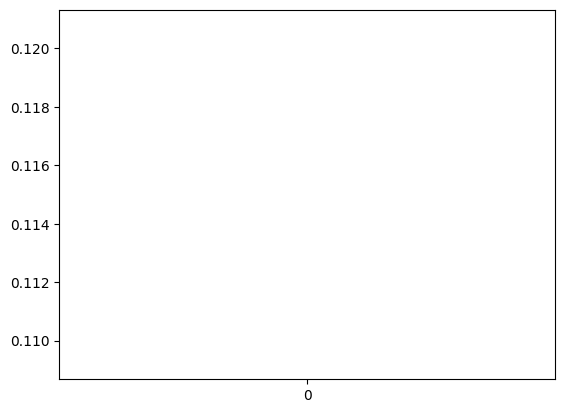

/Users/niels/Library/Python/3.11/lib/python/site-packages/pmdarima/arima/auto.py:444: UserWarning: Input time-series is completely constant; returning a (0, 0, 0) ARMA.
  warnings.warn('Input time-series is completely constant; '
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np

count         1
unique        1
top       0.131
freq          1
dtype: object


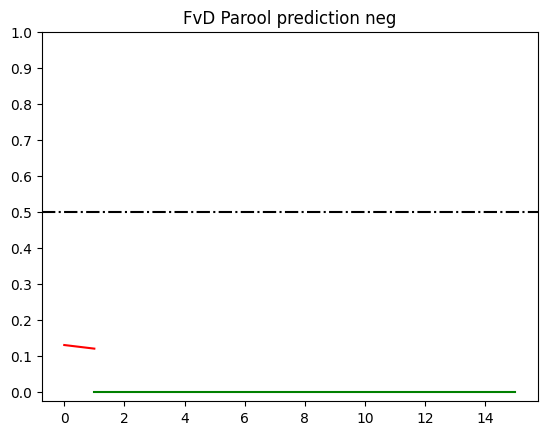

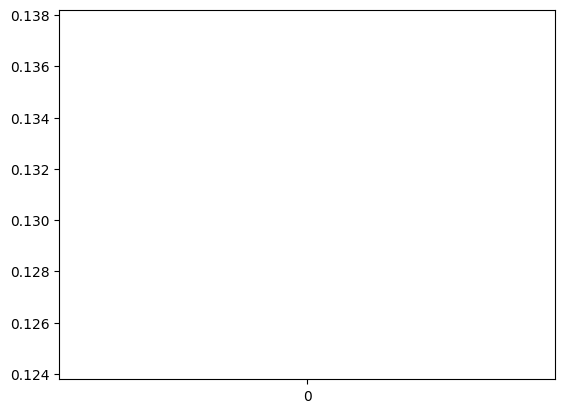

count    26.000000
mean      0.001782
std       0.042221
min      -0.076361
25%      -0.034168
50%       0.008698
75%       0.026370
max       0.107829
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


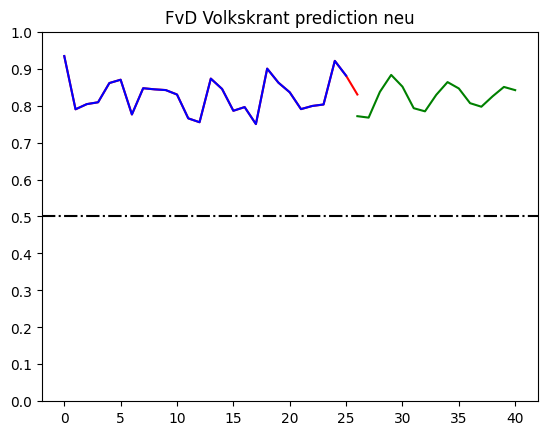

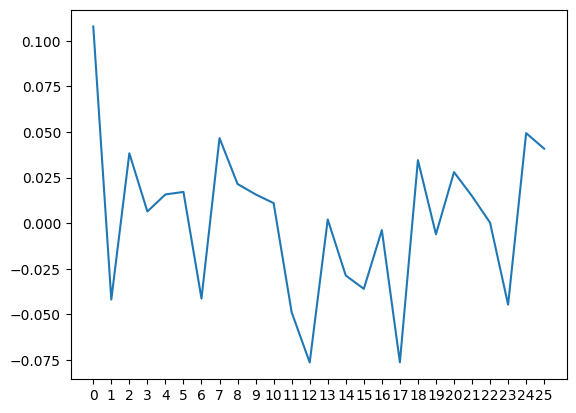

count    2.600000e+01
mean     1.194829e-11
std      3.434428e-02
min     -5.448077e-02
25%     -2.298077e-02
50%     -5.480769e-03
75%      2.439423e-02
max      7.451923e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


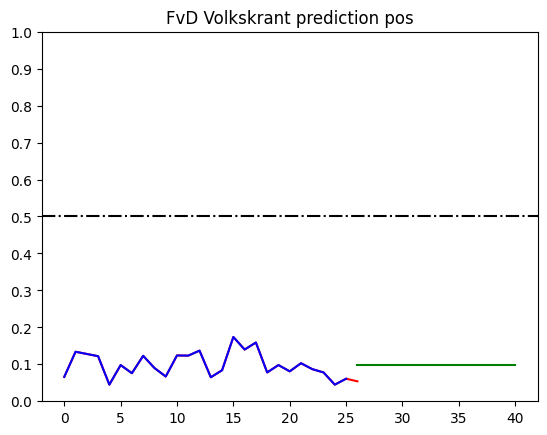

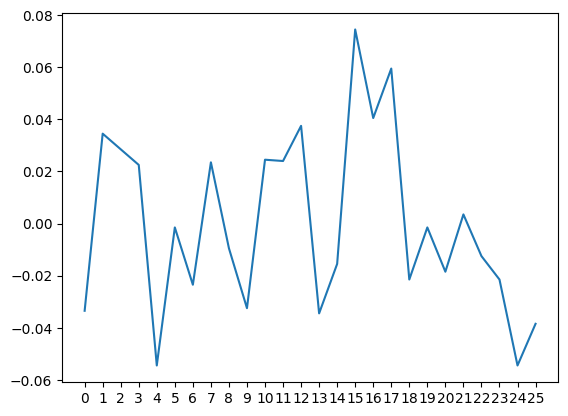

count    2.600000e+01
mean     7.840664e-12
std      3.487699e-02
min     -7.076923e-02
25%     -2.851923e-02
50%     -3.019231e-03
75%      2.198077e-02
max      7.623077e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


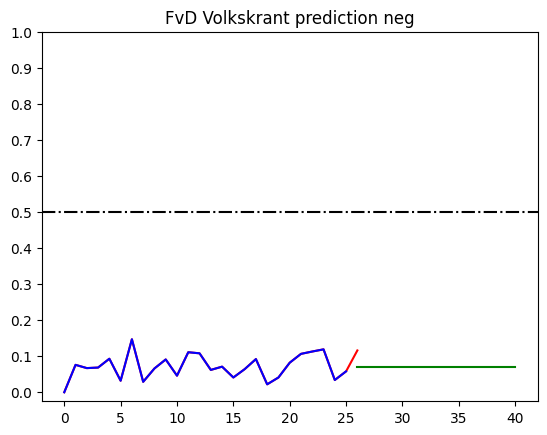

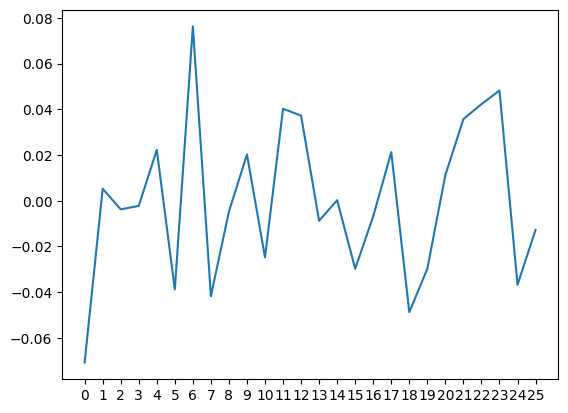

count    1.900000e+01
mean     3.657448e-11
std      4.327121e-02
min     -9.621053e-02
25%     -2.421053e-02
50%      7.789474e-03
75%      2.628947e-02
max      7.878947e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


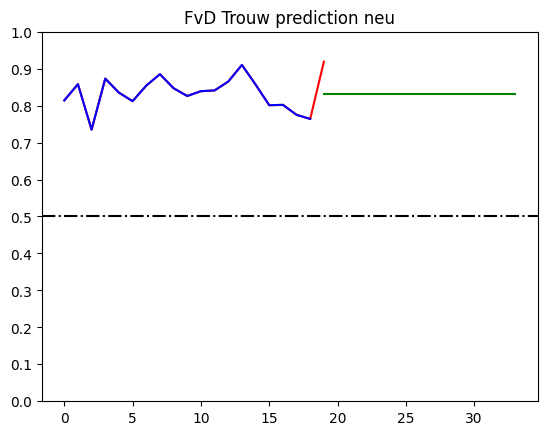

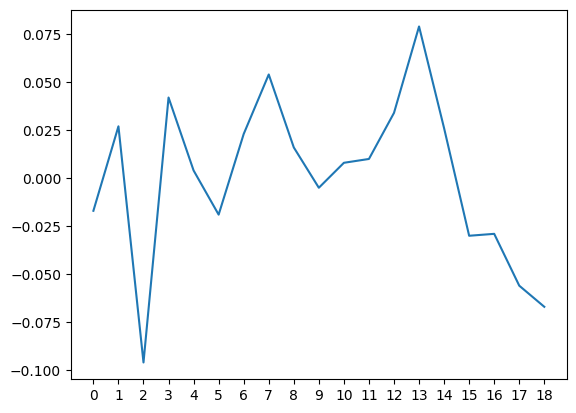

count    19.000000
mean      0.002759
std       0.027727
min      -0.040788
25%      -0.014493
50%       0.009323
75%       0.015921
max       0.073813
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


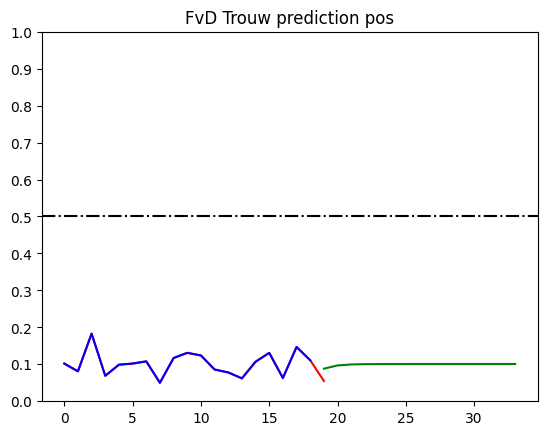

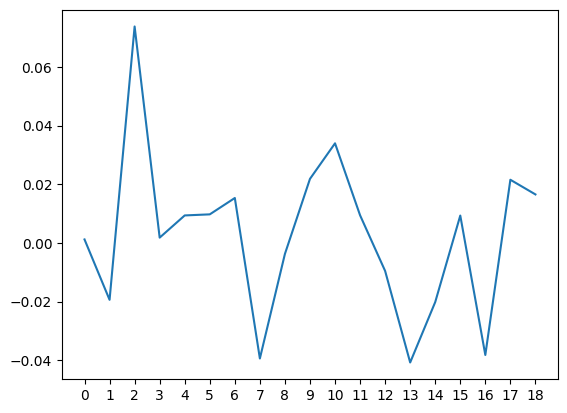

count    1.900000e+01
mean     1.199292e-11
std      2.896449e-02
min     -3.794737e-02
25%     -2.544737e-02
50%     -9.473684e-04
75%      1.305263e-02
max      6.905263e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


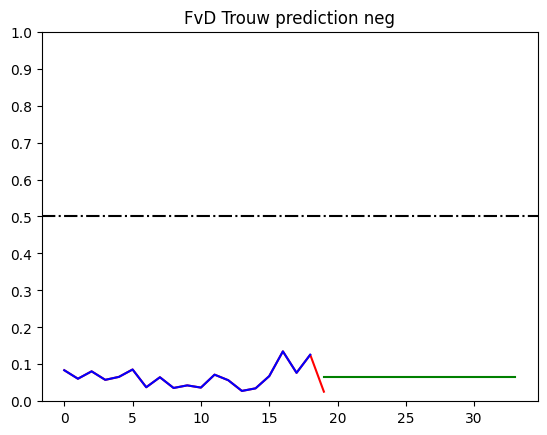

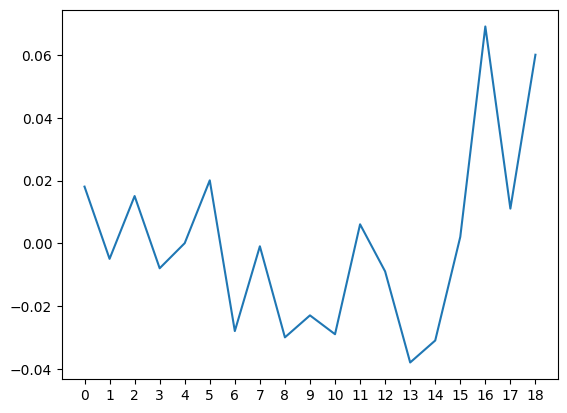

count    1.200000e+01
mean     1.487440e-12
std      1.997095e-02
min     -3.395833e-02
25%     -9.333333e-03
50%     -2.458333e-03
75%      1.204167e-02
max      4.204167e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


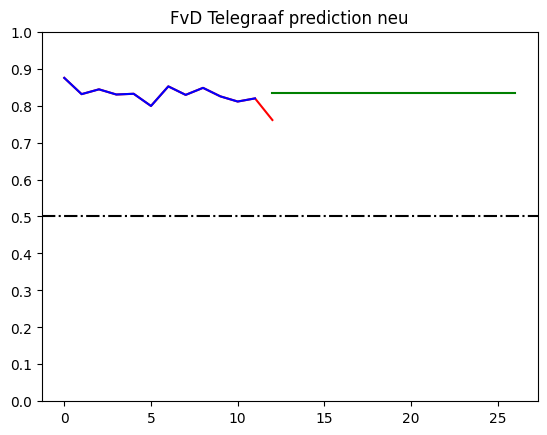

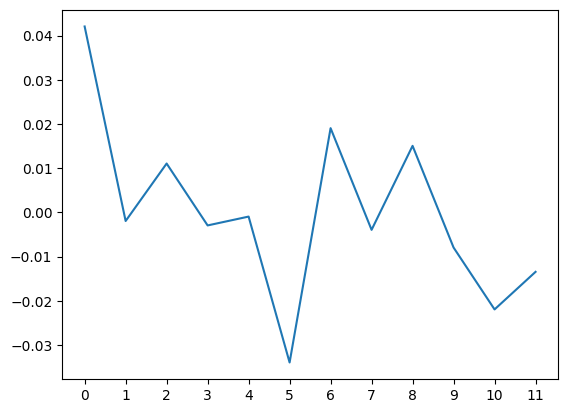

count    1.200000e+01
mean     1.078502e-11
std      2.199931e-02
min     -5.683333e-02
25%     -5.083333e-03
50%      5.666667e-03
75%      1.416667e-02
max      2.016667e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


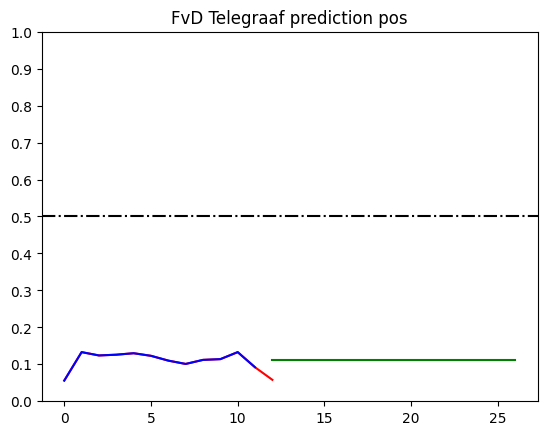

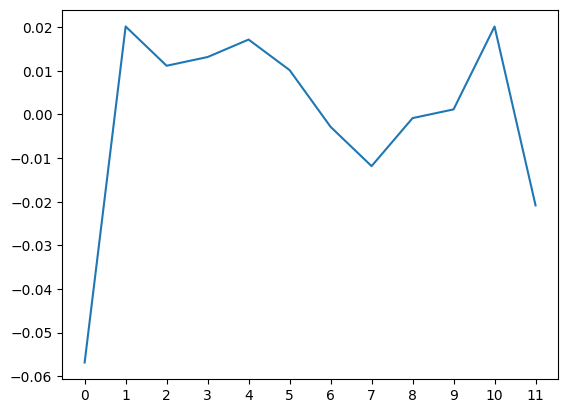

count    1.200000e+01
mean    -1.561251e-17
std      1.876706e-02
min     -2.204167e-02
25%     -1.604167e-02
50%     -4.041667e-03
75%      1.445833e-02
max      3.445833e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


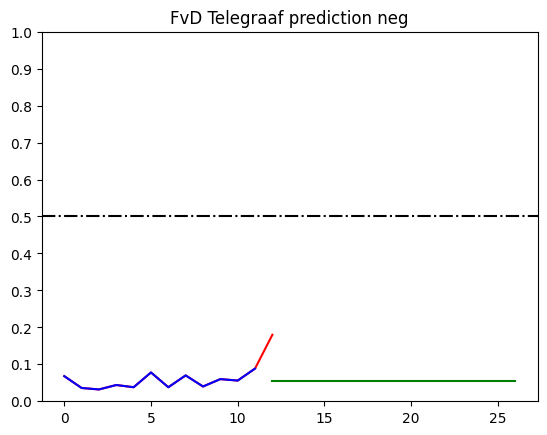

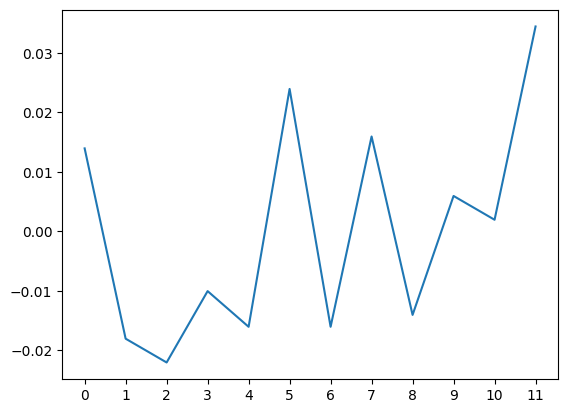

count    6.000000
mean    -0.000765
std      0.028094
min     -0.048797
25%     -0.008001
50%      0.002651
75%      0.013380
max      0.033499
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


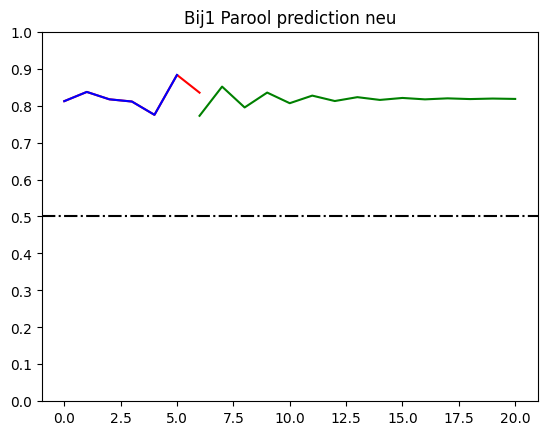

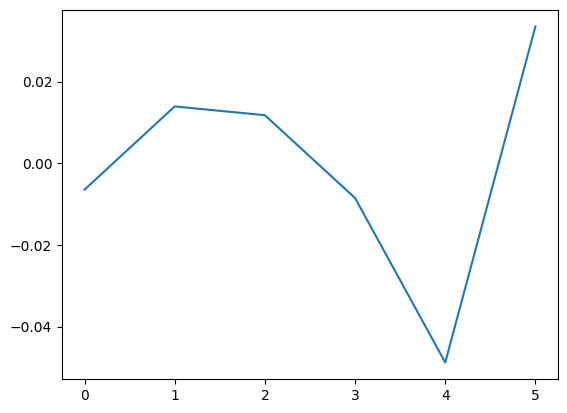

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(


count    6.000000e+00
mean     6.628957e-14
std      3.780697e-02
min     -5.216667e-02
25%     -2.016667e-02
50%     -1.666667e-03
75%      1.833333e-02
max      5.683333e-02
dtype: float64


/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


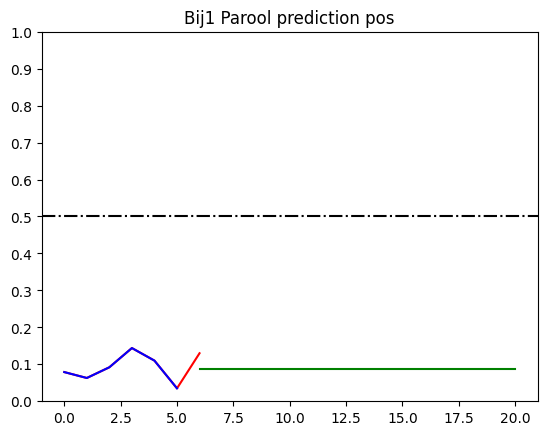

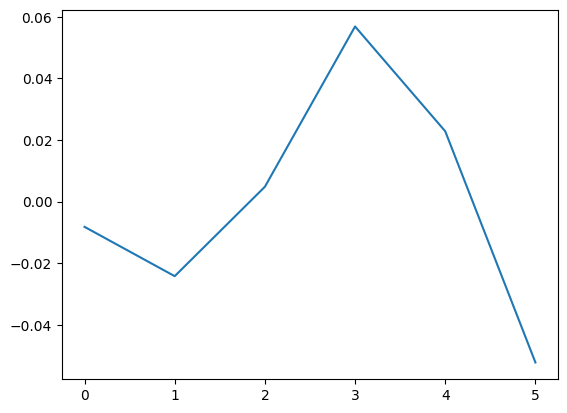

count    6.000000e+00
mean     4.449024e-12
std      2.501733e-02
min     -4.533333e-02
25%     -5.833333e-03
50%      5.666667e-03
75%      1.641667e-02
max      2.366667e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


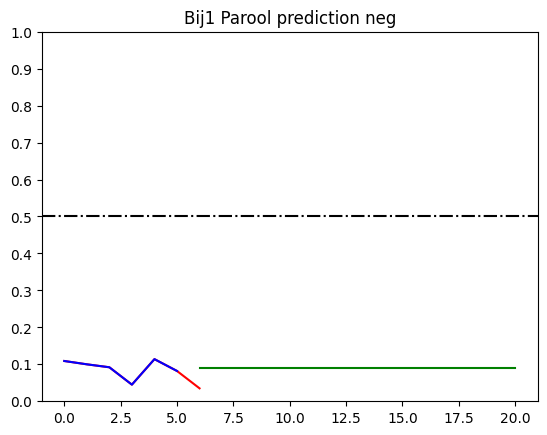

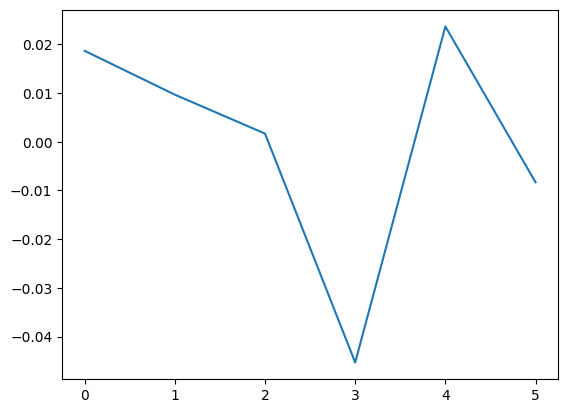

count    6.000000e+00
mean     1.638134e-12
std      2.117644e-02
min     -2.208333e-02
25%     -1.558333e-02
50%     -6.083333e-03
75%      1.654167e-02
max      2.891667e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


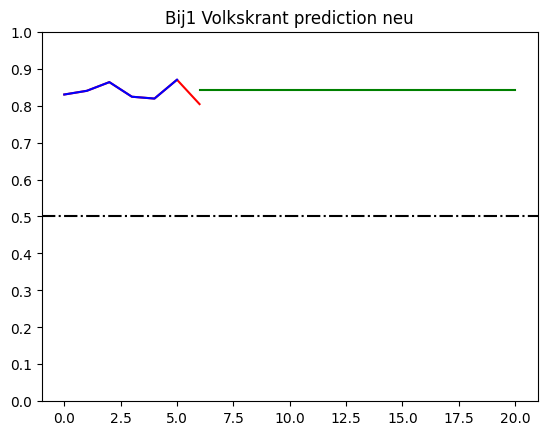

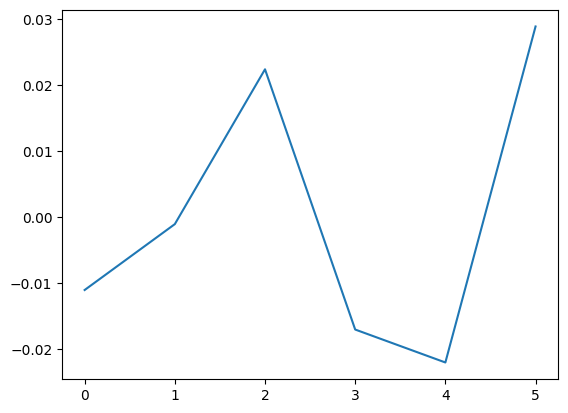

count    6.000000e+00
mean     4.794285e-12
std      2.624452e-02
min     -2.825000e-02
25%     -1.462500e-02
50%     -3.500000e-03
75%      3.500000e-03
max      4.775000e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


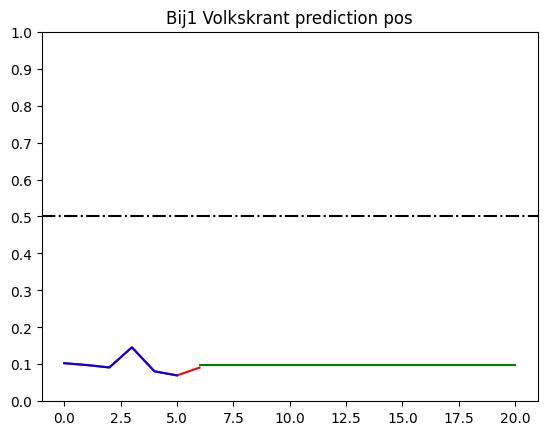

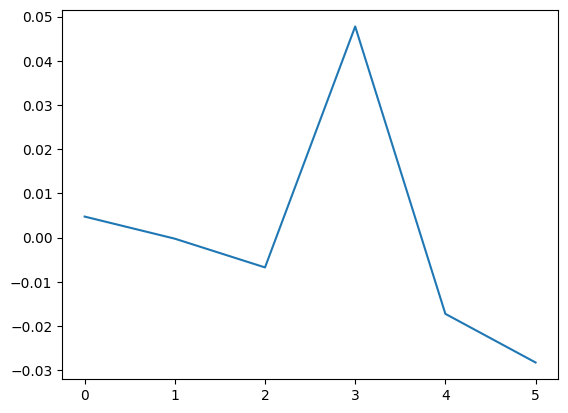

count    6.000000e+00
mean     4.780463e-12
std      2.364265e-02
min     -3.075000e-02
25%     -1.237500e-02
50%      7.500000e-04
75%      5.250000e-03
max      3.925000e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


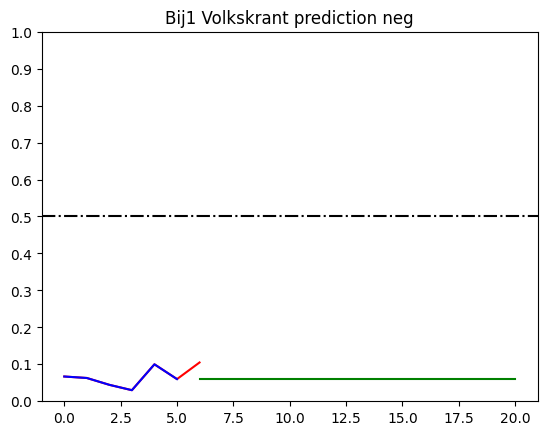

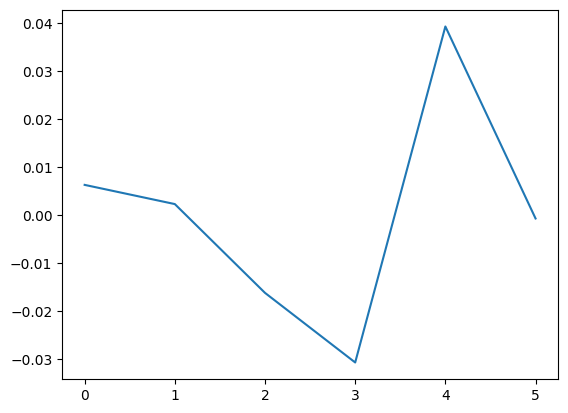

count    1.400000e+01
mean    -7.930164e-17
std      3.959056e-02
min     -8.521429e-02
25%     -2.996429e-02
50%      7.285714e-03
75%      3.478571e-02
max      4.678571e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


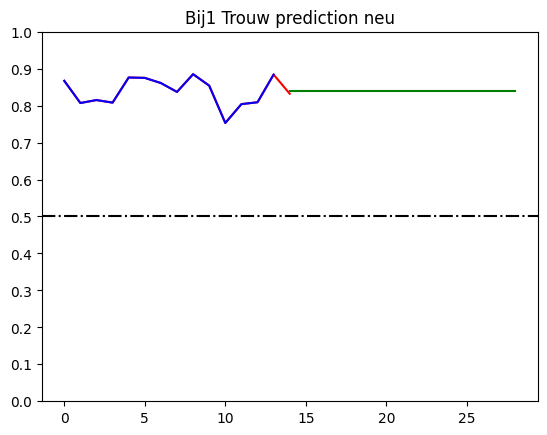

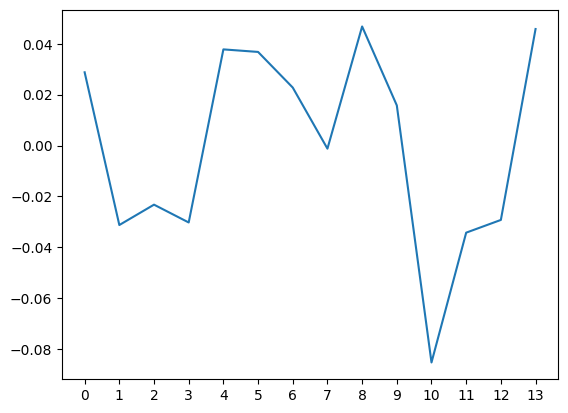

count    14.000000
mean      0.000970
std       0.033986
min      -0.048754
25%      -0.021753
50%       0.001557
75%       0.016575
max       0.077023
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


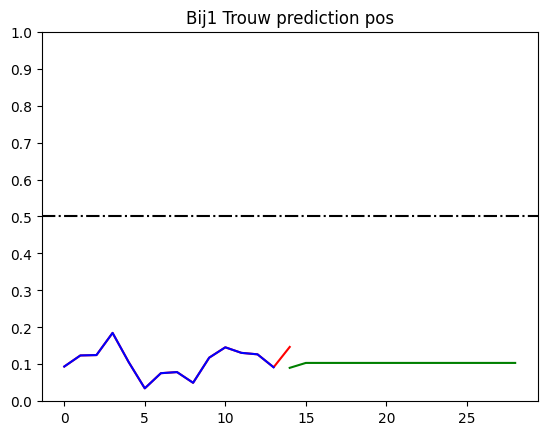

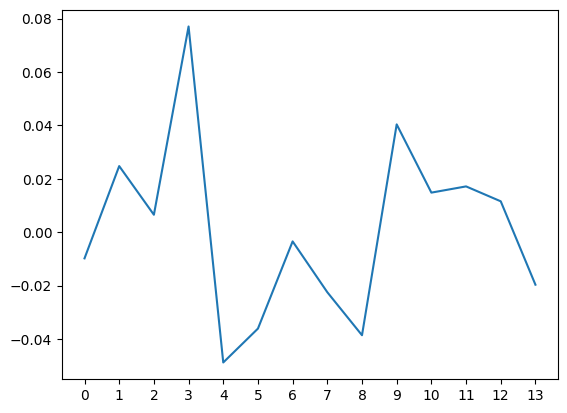

count    1.400000e+01
mean     9.194530e-15
std      2.840146e-02
min     -4.878571e-02
25%     -2.428571e-02
50%      7.714286e-03
75%      1.296429e-02
max      4.621429e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


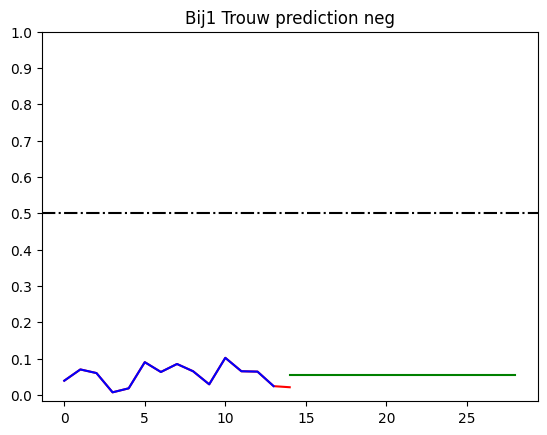

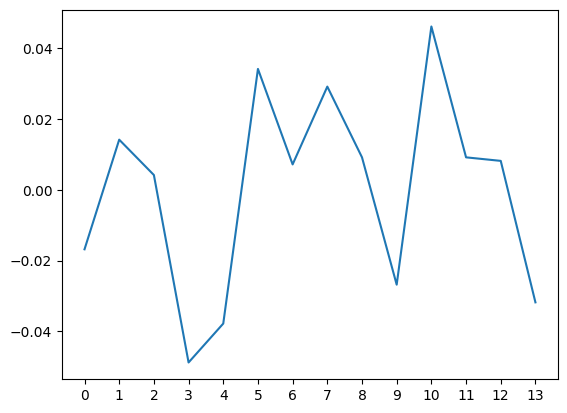

count    3.000000
mean     0.026090
std      0.063069
min     -0.032145
25%     -0.007404
50%      0.017338
75%      0.055208
max      0.093078
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


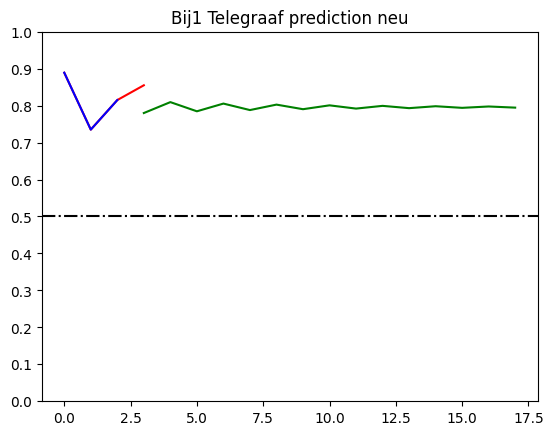

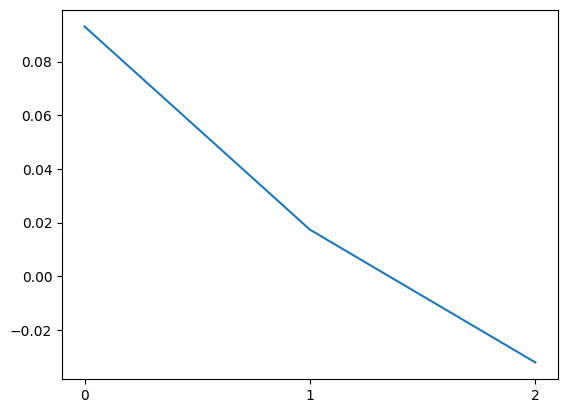

count    3.000000e+00
mean     5.721090e-12
std      4.409460e-02
min     -4.766667e-02
25%     -1.966667e-02
50%      8.333333e-03
75%      2.383333e-02
max      3.933333e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


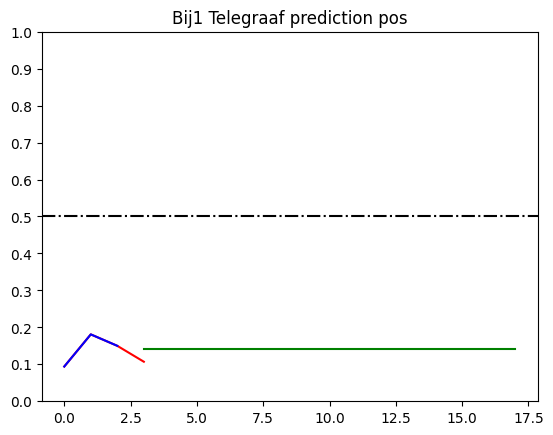

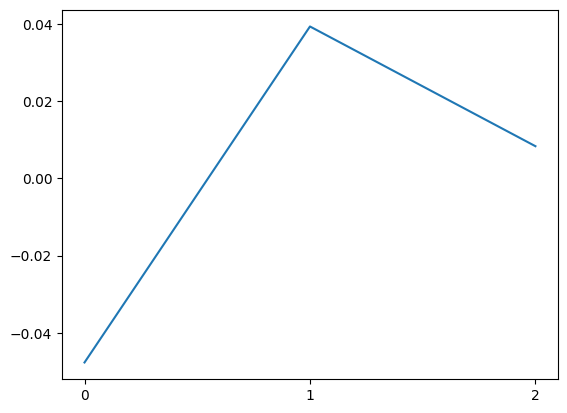

count    3.000000
mean    -0.011982
std      0.023743
min     -0.037878
25%     -0.022354
50%     -0.006830
75%      0.000966
max      0.008762
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


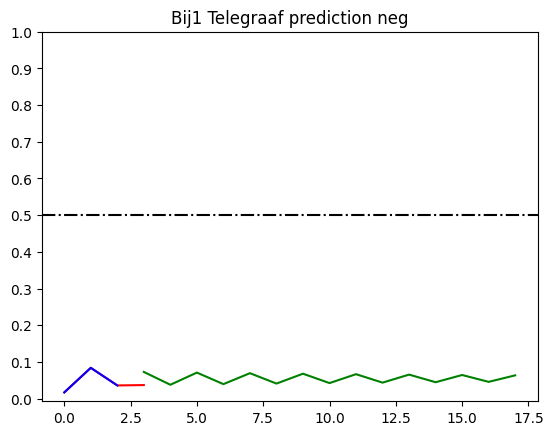

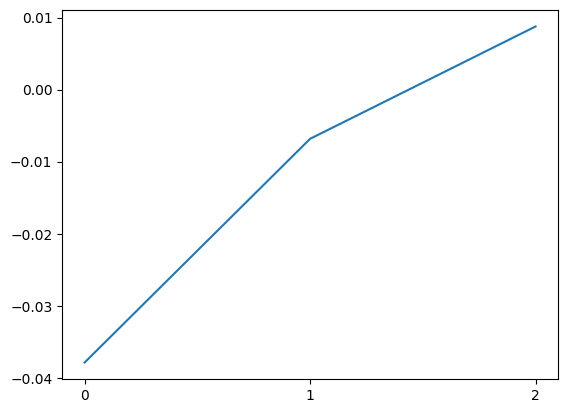

count    69.000000
mean      0.000034
std       0.030948
min      -0.081397
25%      -0.017159
50%       0.001629
75%       0.020328
max       0.066888
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


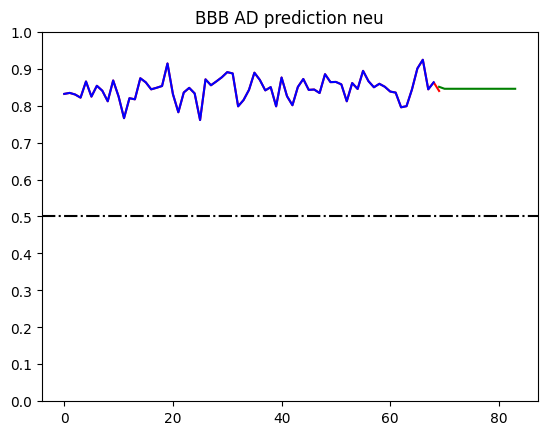

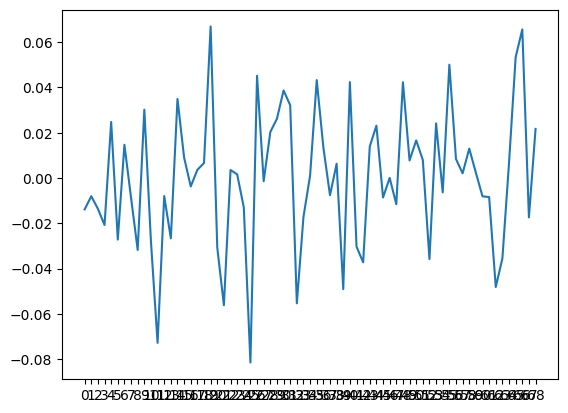

count    69.000000
mean     -0.000030
std       0.021703
min      -0.043408
25%      -0.016077
50%      -0.002405
75%       0.017013
max       0.044777
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


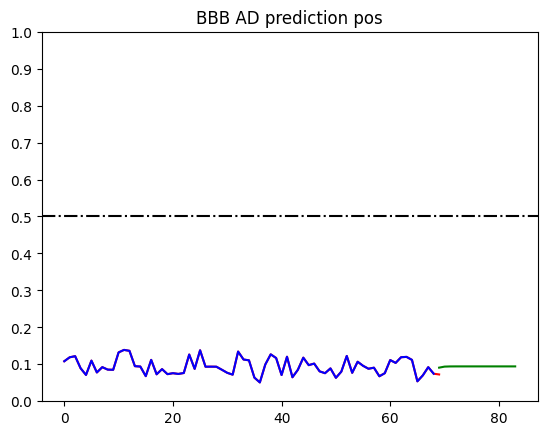

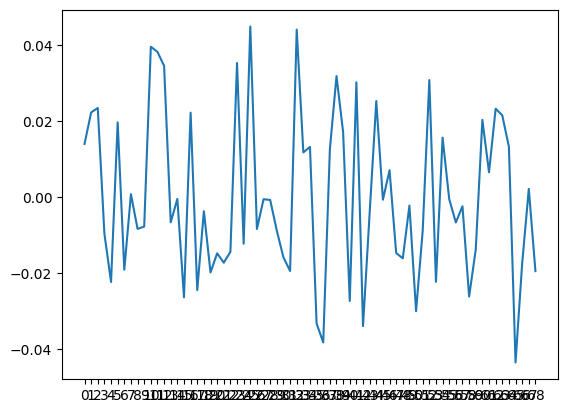

count    6.900000e+01
mean     9.179139e-12
std      2.563914e-02
min     -5.317140e-02
25%     -1.417140e-02
50%      1.619335e-04
75%      1.262860e-02
max      8.432860e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


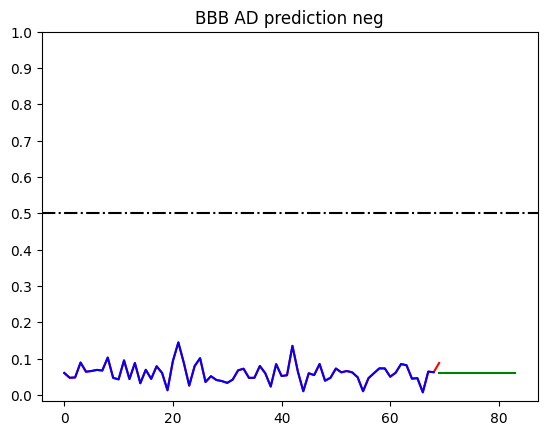

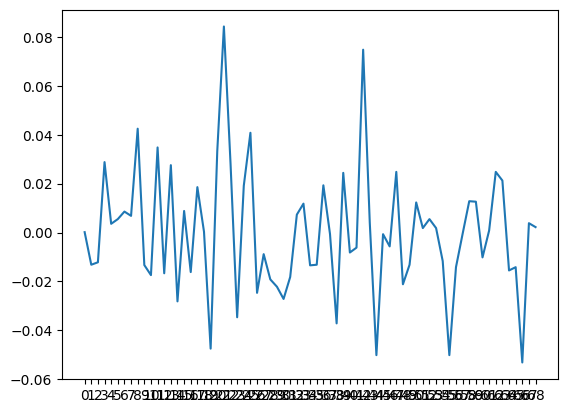

count    27.000000
mean      0.000384
std       0.039490
min      -0.088632
25%      -0.017365
50%       0.004574
75%       0.024782
max       0.060574
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


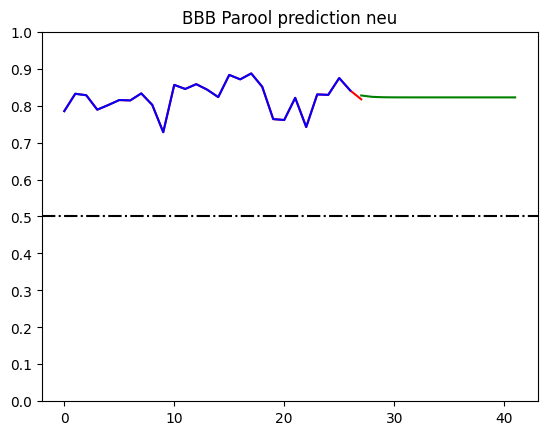

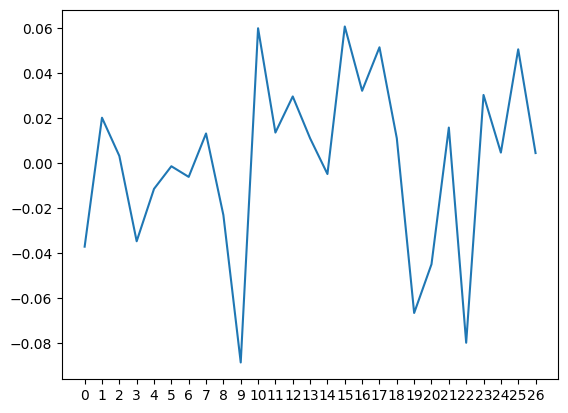

count    27.000000
mean     -0.000812
std       0.031390
min      -0.053888
25%      -0.022648
50%       0.000271
75%       0.020520
max       0.062107
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


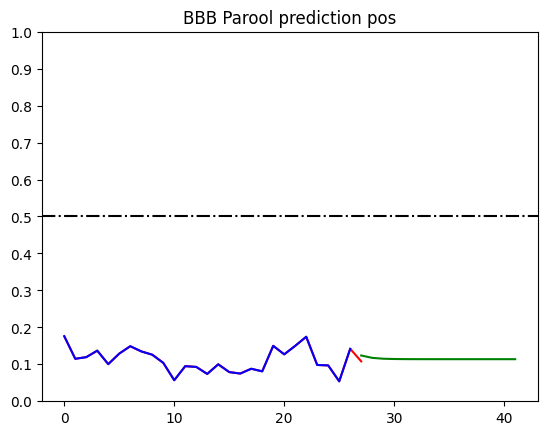

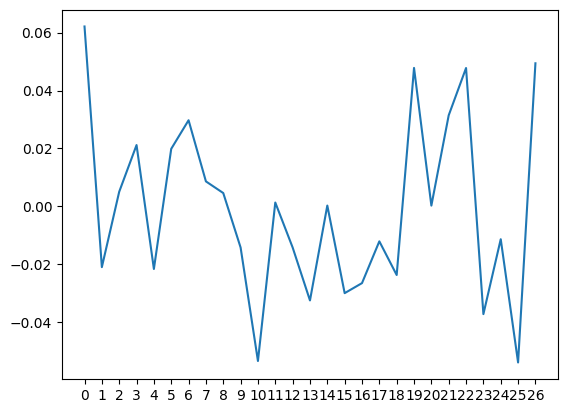

count    2.700000e+01
mean     2.733803e-11
std      3.099333e-02
min     -4.841358e-02
25%     -2.141358e-02
50%      3.586420e-03
75%      1.508642e-02
max      1.015864e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


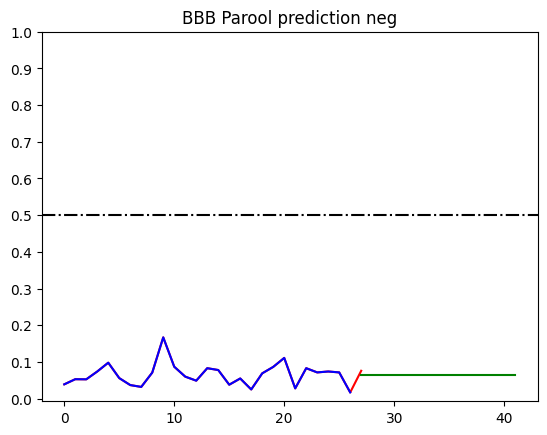

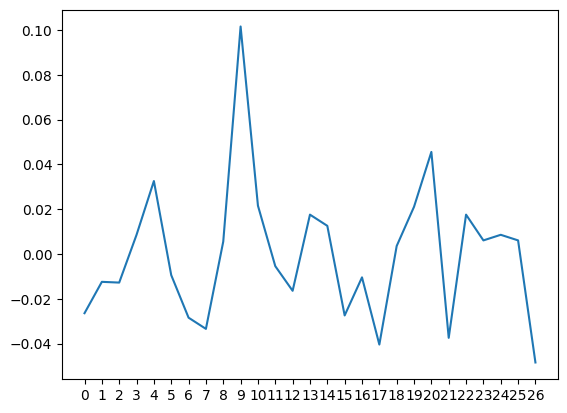

count    5.500000e+01
mean     1.456954e-12
std      4.953747e-02
min     -1.232639e-01
25%     -3.343061e-02
50%      5.236061e-03
75%      2.815273e-02
max      1.147361e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


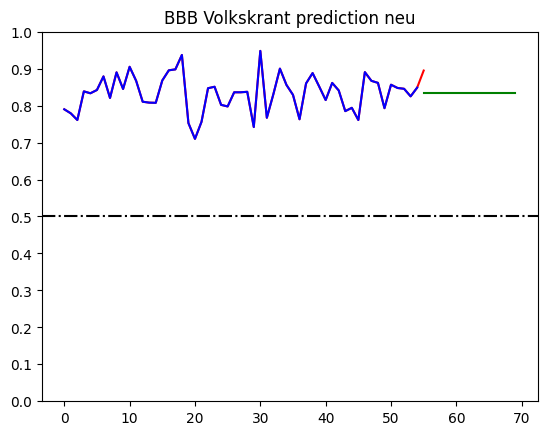

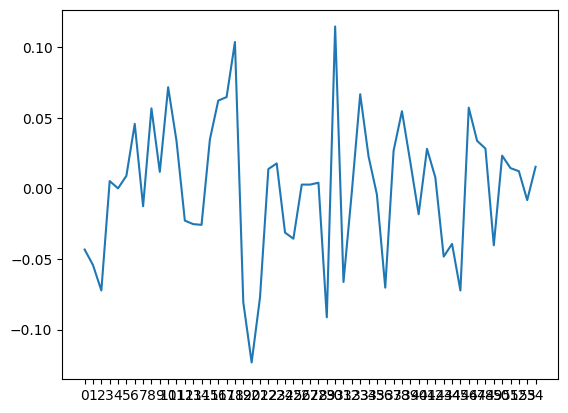

count    5.500000e+01
mean     1.938901e-11
std      2.758648e-02
min     -5.834121e-02
25%     -1.784121e-02
50%      2.658788e-03
75%      1.482545e-02
max      7.765879e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


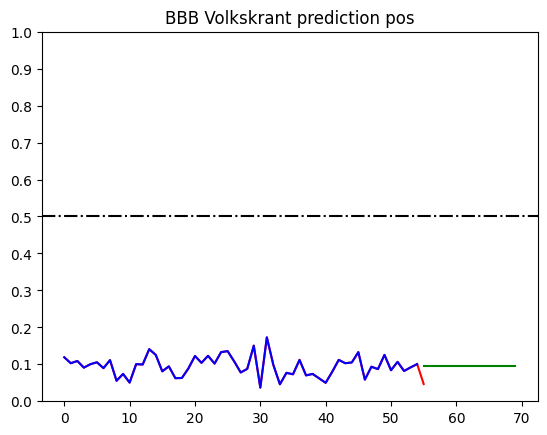

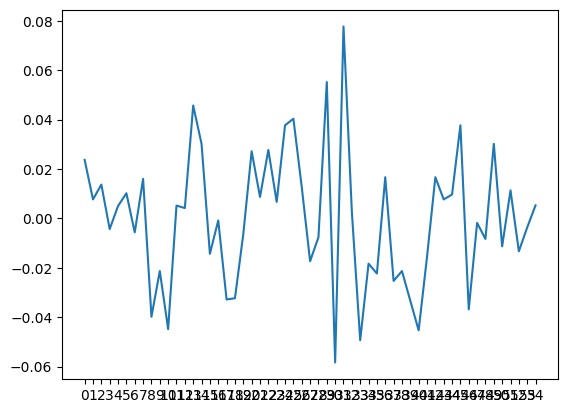

count    55.000000
mean     -0.000034
std       0.033794
min      -0.068033
25%      -0.021014
50%      -0.002943
75%       0.019529
max       0.108252
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


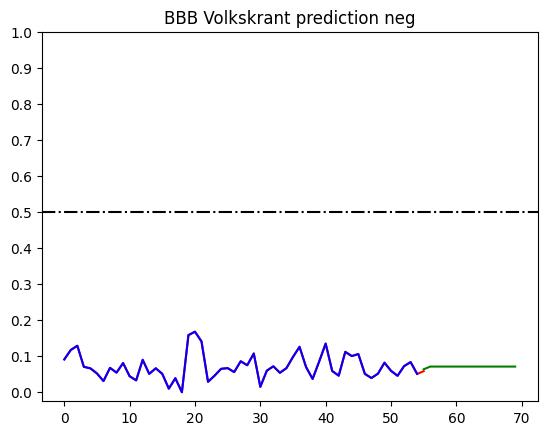

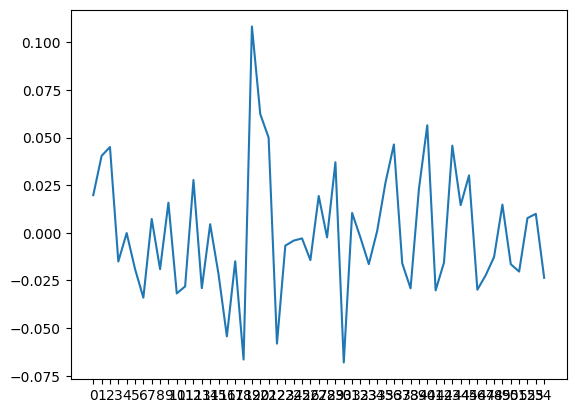

count    60.000000
mean      0.000058
std       0.046927
min      -0.106667
25%      -0.025146
50%       0.003572
75%       0.027523
max       0.127474
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


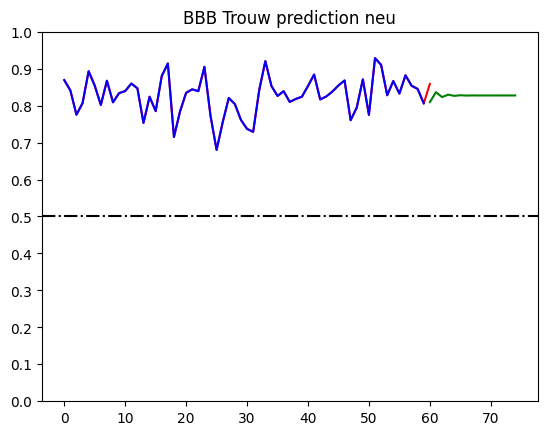

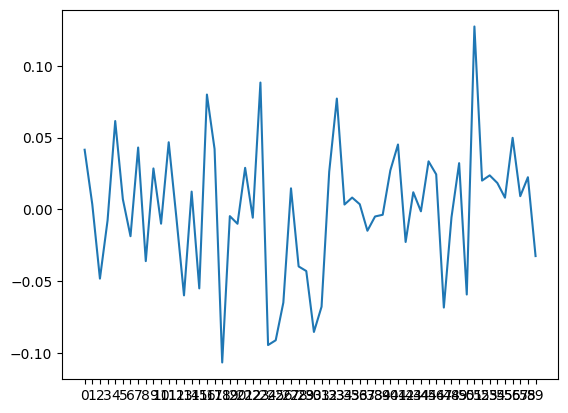

count    60.000000
mean      0.000070
std       0.039791
min      -0.074308
25%      -0.027213
50%      -0.010435
75%       0.016572
max       0.116102
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


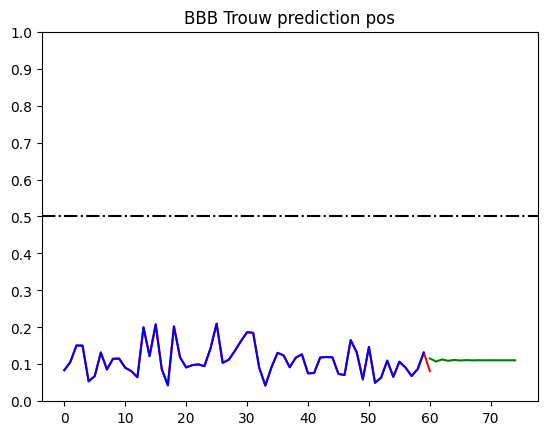

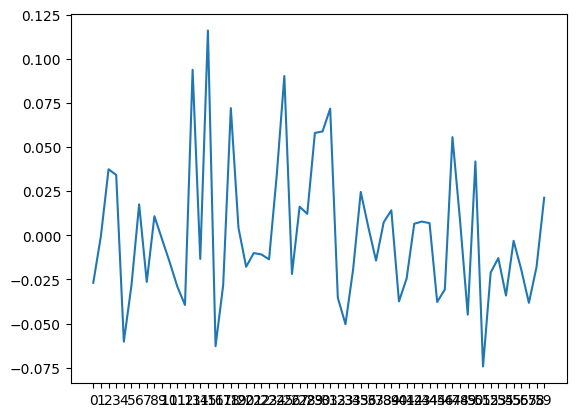

count    60.000000
mean      0.000036
std       0.022617
min      -0.061400
25%      -0.014690
50%       0.000194
75%       0.013005
max       0.070388
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


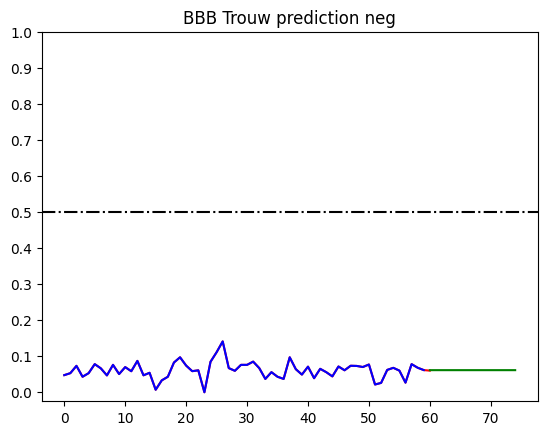

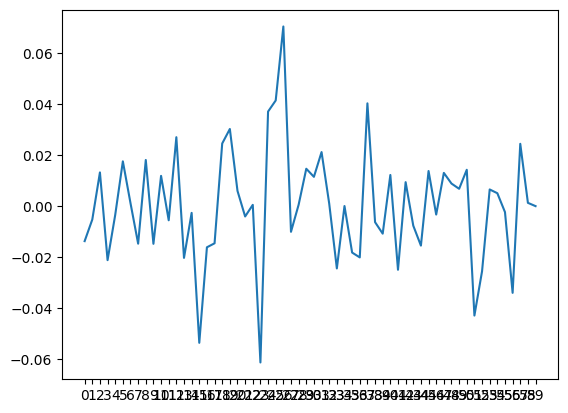

count    4.300000e+01
mean     1.330667e-11
std      4.095229e-02
min     -9.019734e-02
25%     -2.607234e-02
50%     -1.697342e-03
75%      2.730266e-02
max      8.380266e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


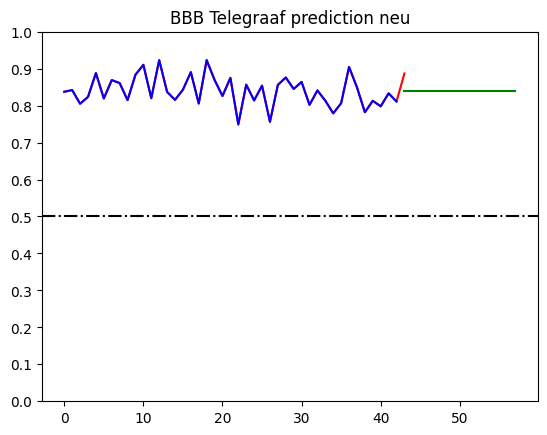

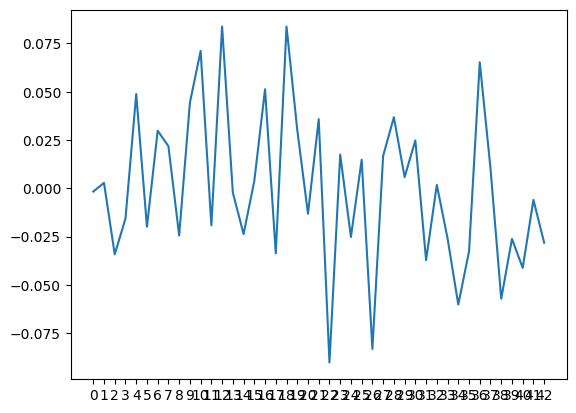

count    4.300000e+01
mean     8.740897e-12
std      3.219955e-02
min     -6.602835e-02
25%     -2.277835e-02
50%     -3.028350e-03
75%      1.911451e-02
max      9.297165e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


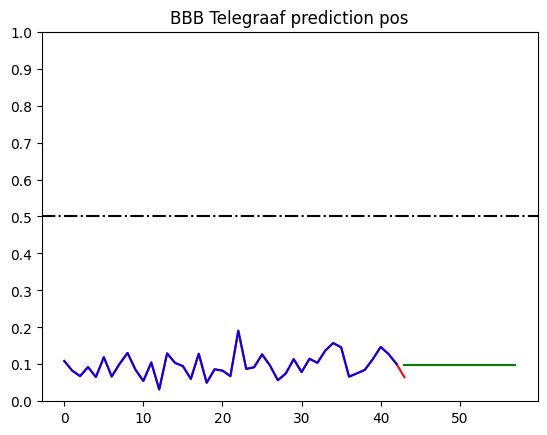

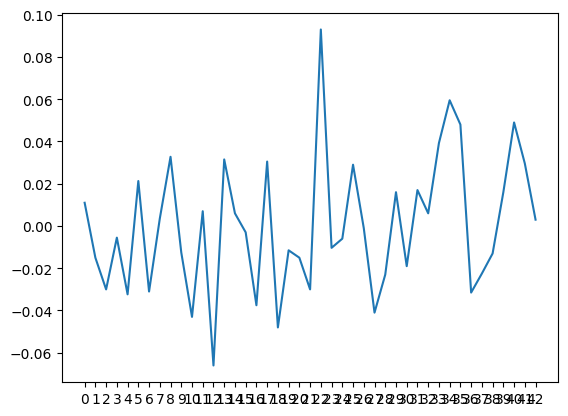

count    4.300000e+01
mean     3.066023e-18
std      2.740327e-02
min     -4.381872e-02
25%     -1.698538e-02
50%     -6.318715e-03
75%      1.293128e-02
max      8.418128e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


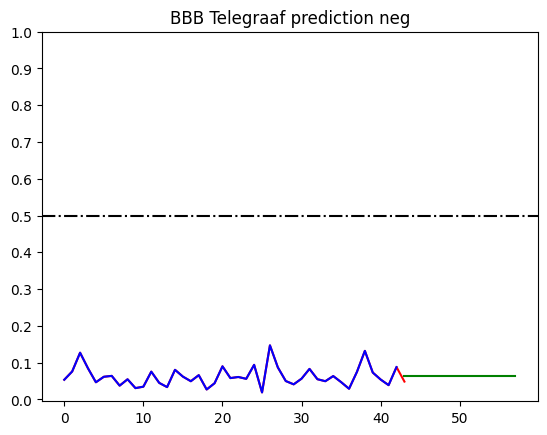

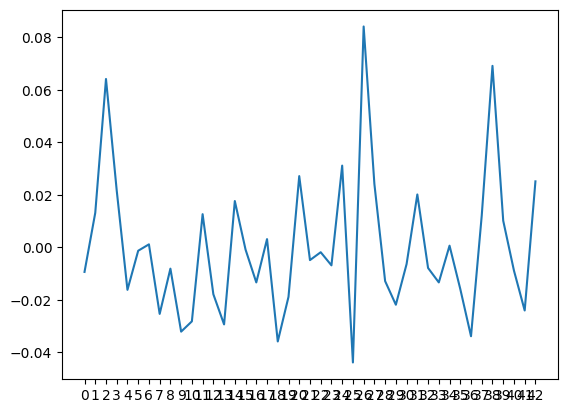

count    28.000000
mean      0.000876
std       0.041046
min      -0.068759
25%      -0.024694
50%      -0.008505
75%       0.031462
max       0.092449
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


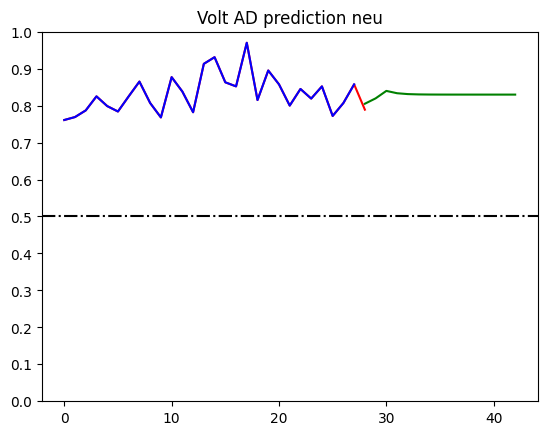

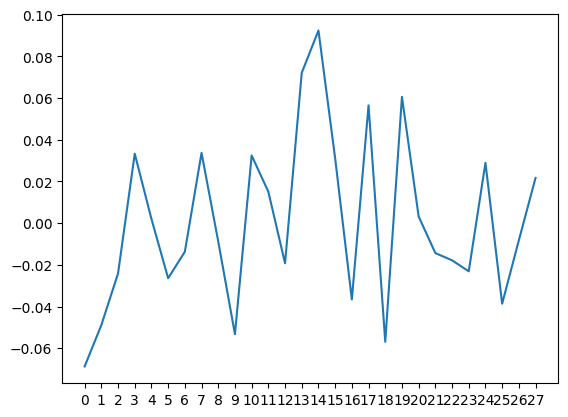

count    2.800000e+01
mean     1.213644e-12
std      3.375310e-02
min     -8.752976e-02
25%     -2.302976e-02
50%     -2.363095e-03
75%      2.547024e-02
max      6.147024e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


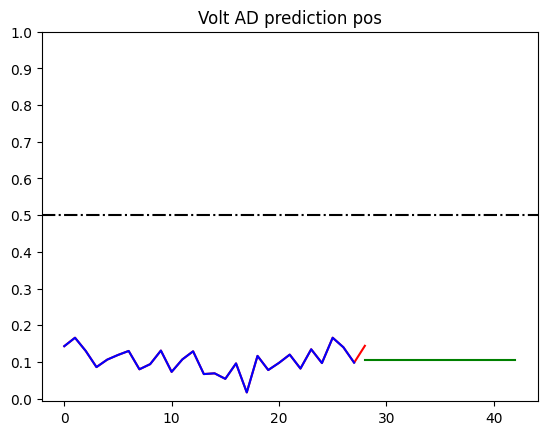

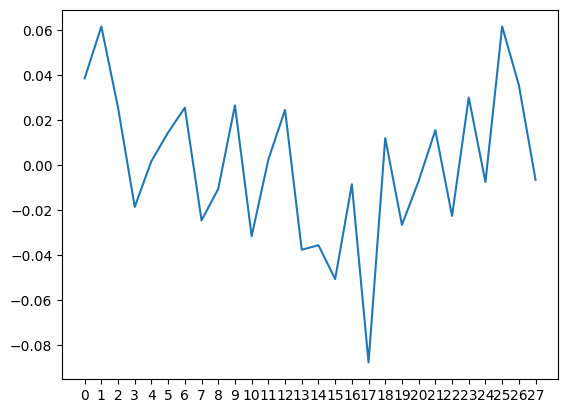

count    28.000000
mean      0.000216
std       0.029408
min      -0.048406
25%      -0.015843
50%      -0.001477
75%       0.014465
max       0.096000
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


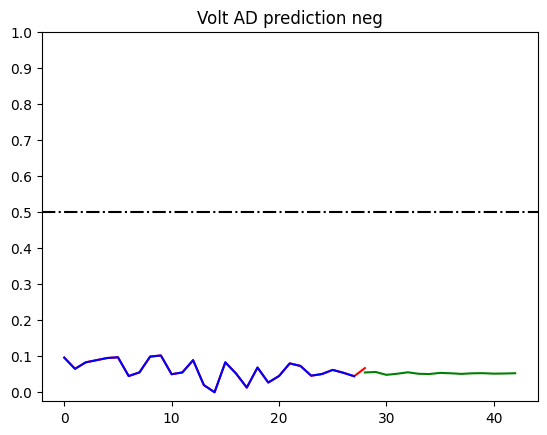

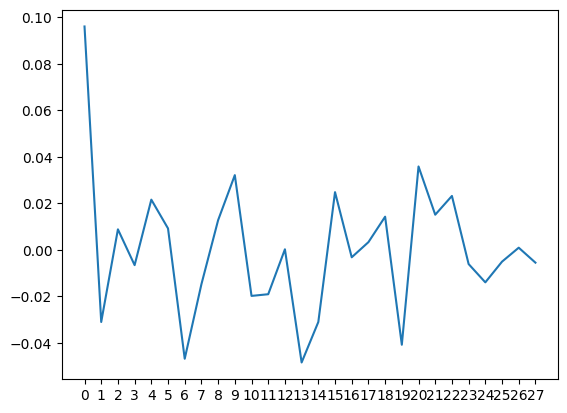

count    1.700000e+01
mean     3.341538e-11
std      4.076421e-02
min     -7.829412e-02
25%     -1.229412e-02
50%     -7.294118e-03
75%      3.770588e-02
max      6.470588e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


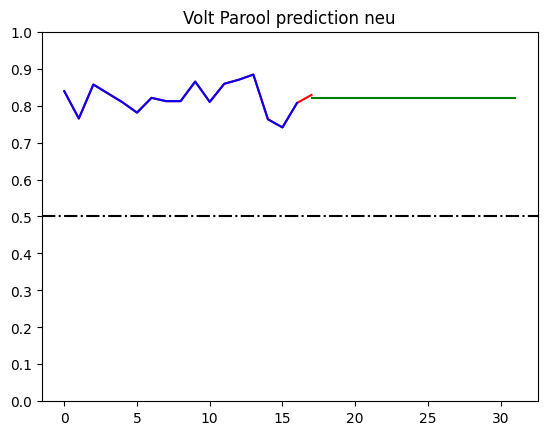

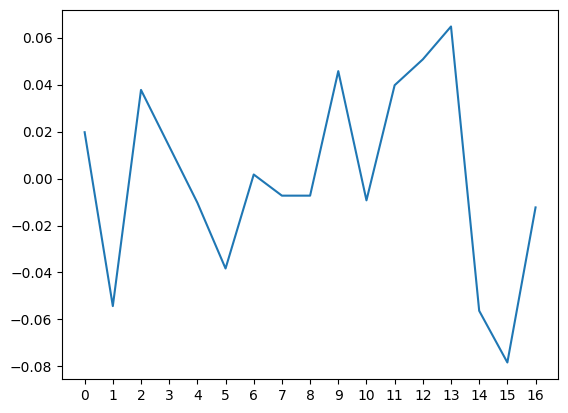

count    1.700000e+01
mean     1.086494e-11
std      3.374624e-02
min     -6.205882e-02
25%     -2.505882e-02
50%     -3.058824e-03
75%      2.294118e-02
max      7.294118e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


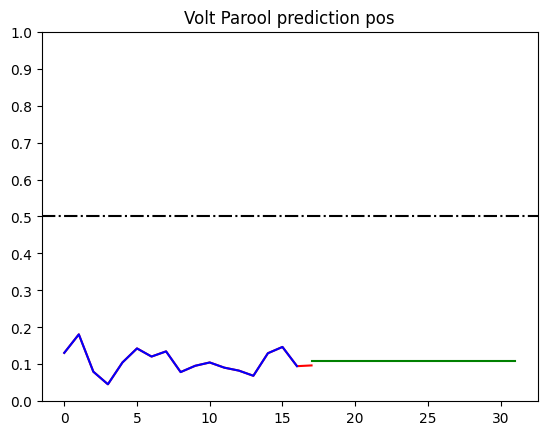

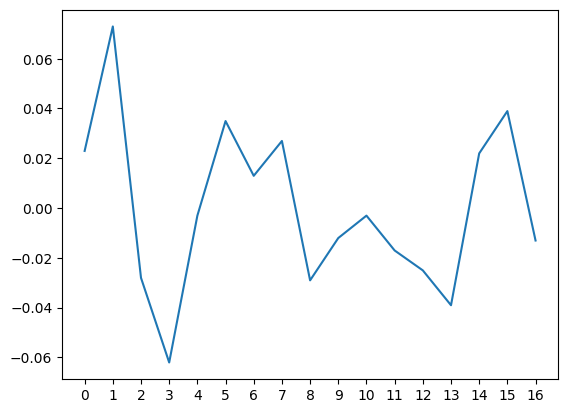

count    1.700000e+01
mean     6.212725e-12
std      2.869656e-02
min     -4.364706e-02
25%     -2.264706e-02
50%     -9.647059e-03
75%      2.535294e-02
max      4.835294e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


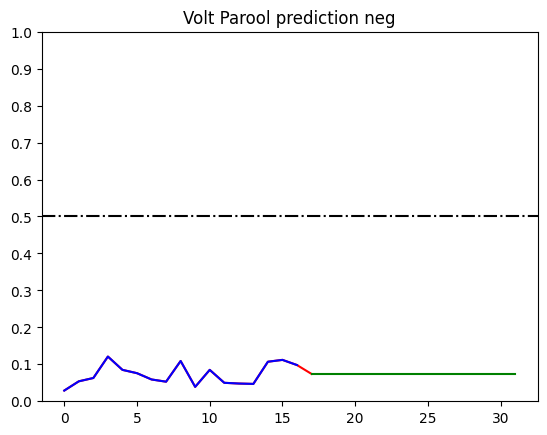

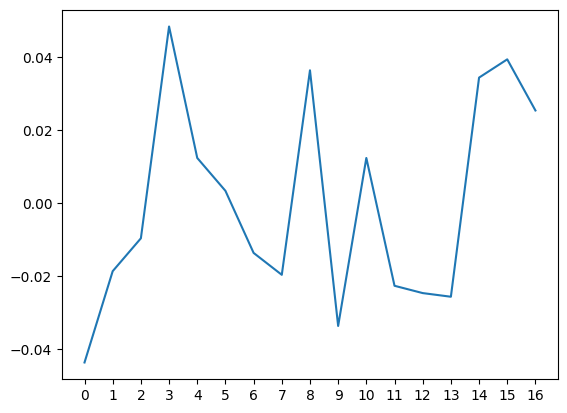

count    2.300000e+01
mean     1.056375e-11
std      4.780838e-02
min     -8.513043e-02
25%     -3.313043e-02
50%      1.336957e-02
75%      3.286957e-02
max      9.986957e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


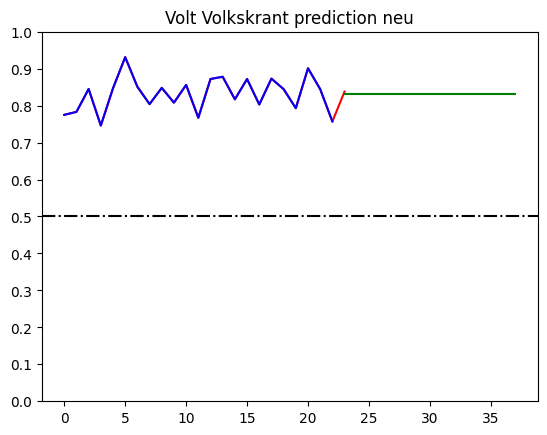

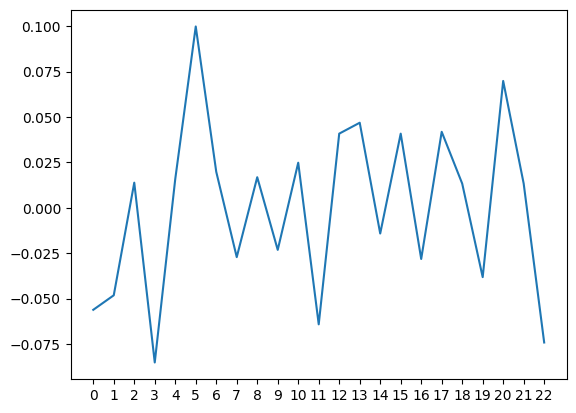

count    2.300000e+01
mean     4.146362e-11
std      3.215431e-02
min     -5.635507e-02
25%     -2.085507e-02
50%     -3.550724e-04
75%      1.614493e-02
max      6.264493e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


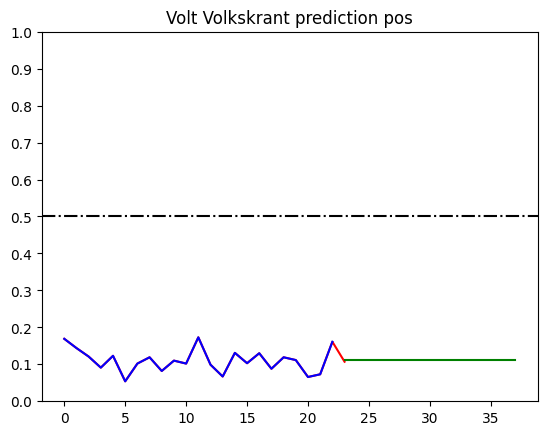

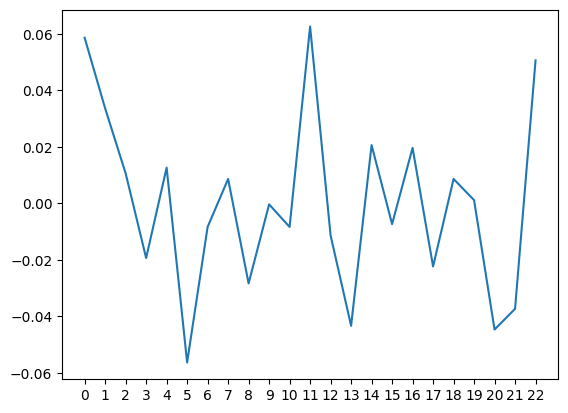

count    23.000000
mean      0.000135
std       0.030047
min      -0.040306
25%      -0.019385
50%      -0.004327
75%       0.015531
max       0.098446
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


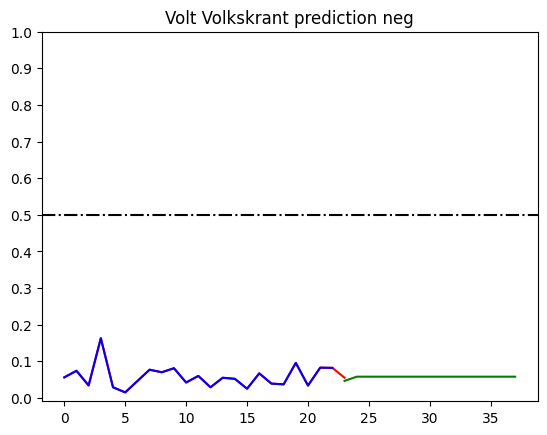

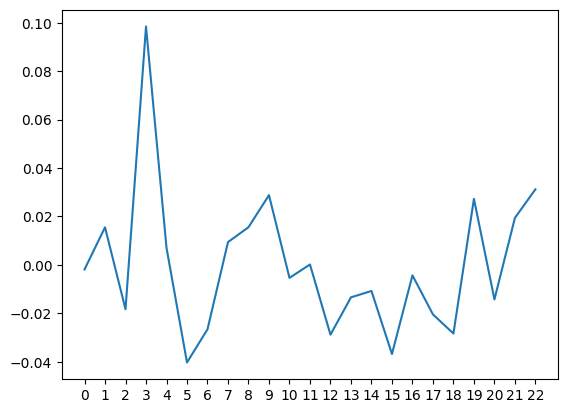

count    31.000000
mean     -0.000096
std       0.044130
min      -0.091170
25%      -0.024105
50%       0.009320
75%       0.026819
max       0.082640
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


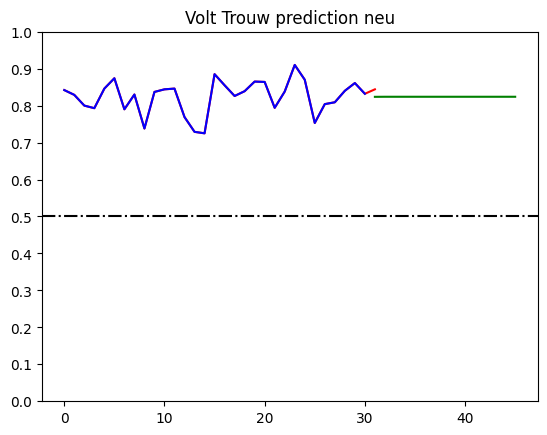

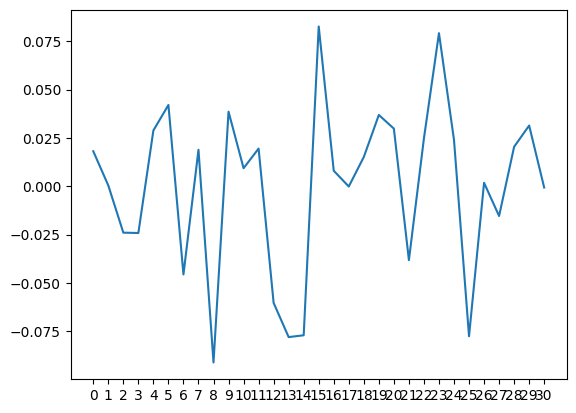

count    31.000000
mean      0.000212
std       0.033854
min      -0.072938
25%      -0.020381
50%      -0.001230
75%       0.016913
max       0.079712
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


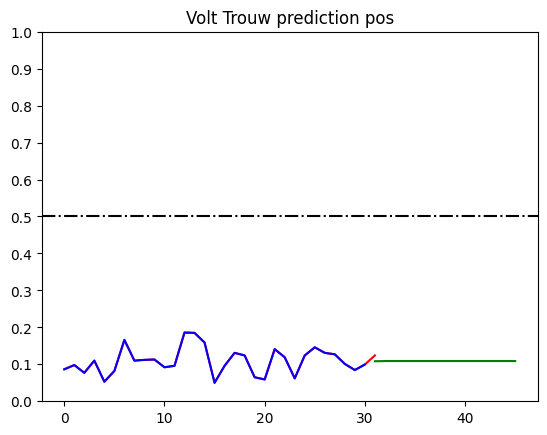

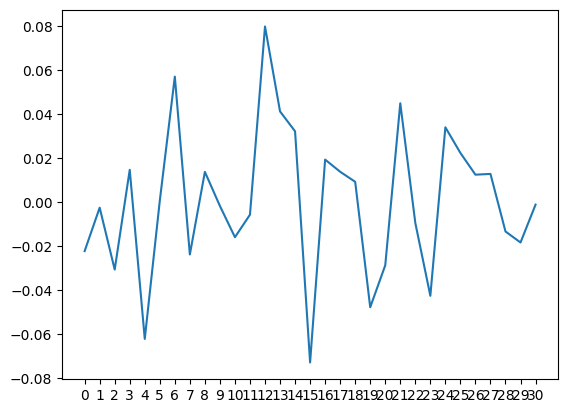

count    31.000000
mean      0.001009
std       0.025399
min      -0.054558
25%      -0.013891
50%      -0.004150
75%       0.011179
max       0.061149
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


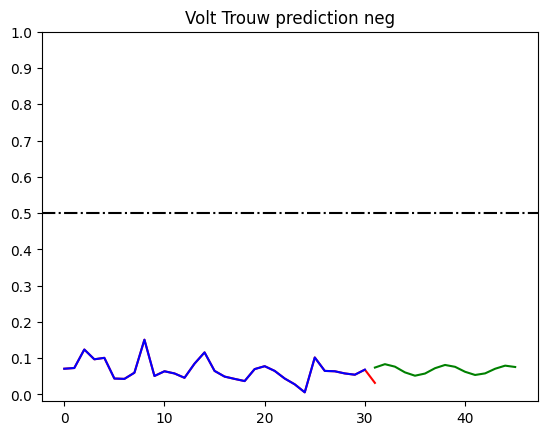

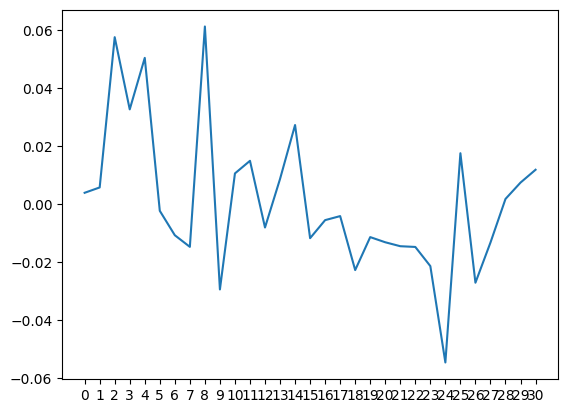

count    2.100000e+01
mean     4.914913e-11
std      5.646406e-02
min     -1.192381e-01
25%     -1.523810e-02
50%      2.076190e-02
75%      3.176190e-02
max      8.676190e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


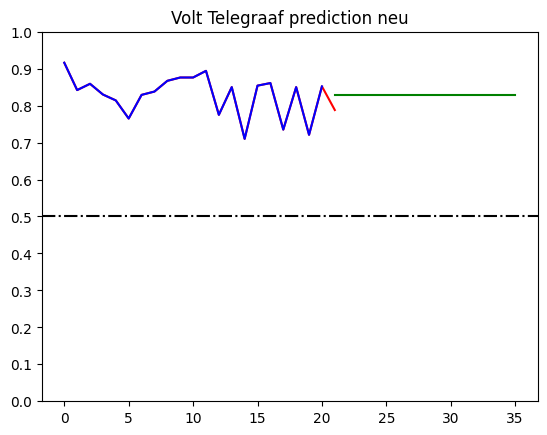

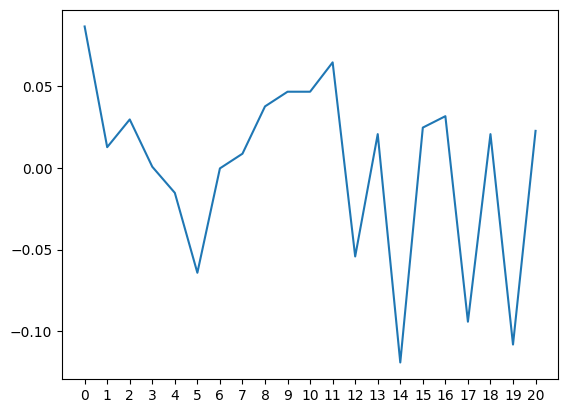

count    2.100000e+01
mean     4.716703e-13
std      3.369921e-02
min     -4.419048e-02
25%     -2.419048e-02
50%     -1.019048e-02
75%      1.680952e-02
max      7.080952e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


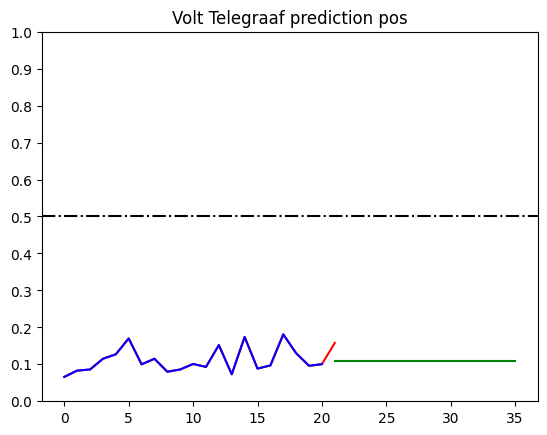

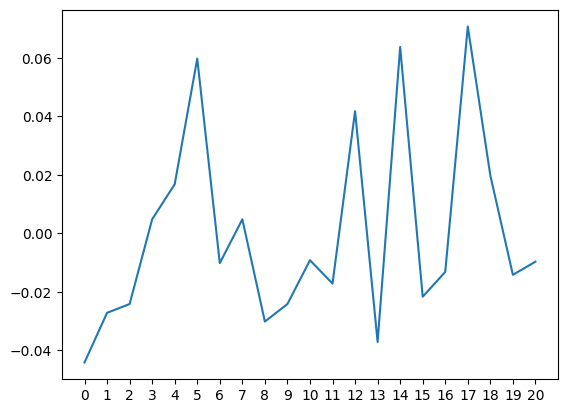

count    2.100000e+01
mean     1.643656e-12
std      3.733751e-02
min     -4.771429e-02
25%     -1.871429e-02
50%     -5.714286e-03
75%      1.228571e-02
max      1.222857e-01
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


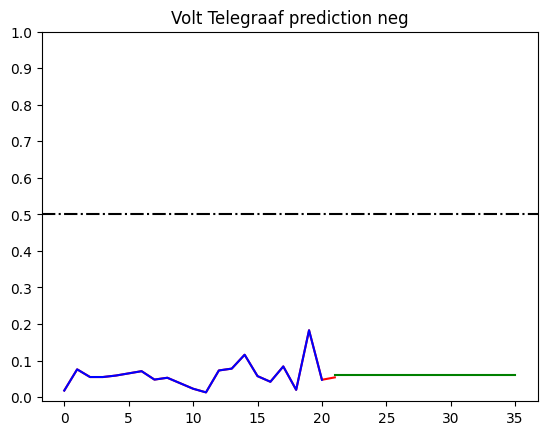

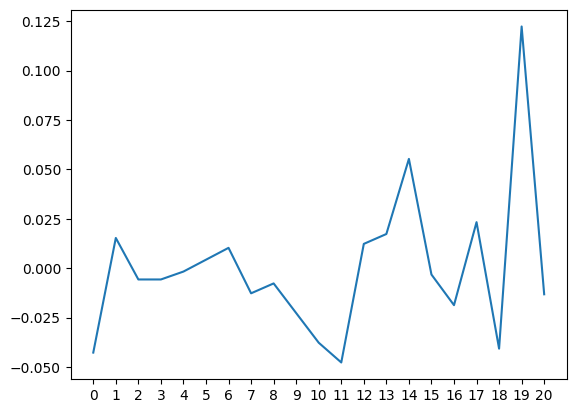

count    1.100000e+01
mean     7.171365e-12
std      3.290199e-02
min     -5.307576e-02
25%     -1.982576e-02
50%      3.590909e-03
75%      1.892424e-02
max      4.792424e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


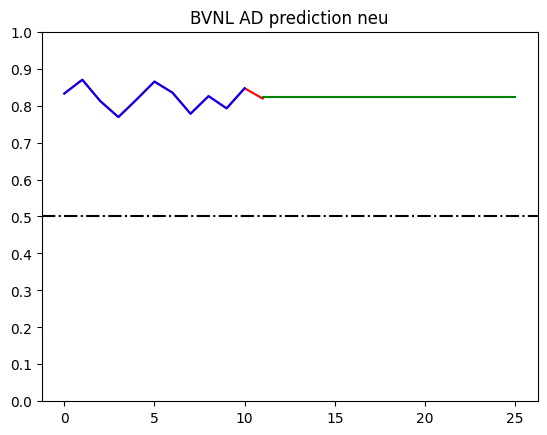

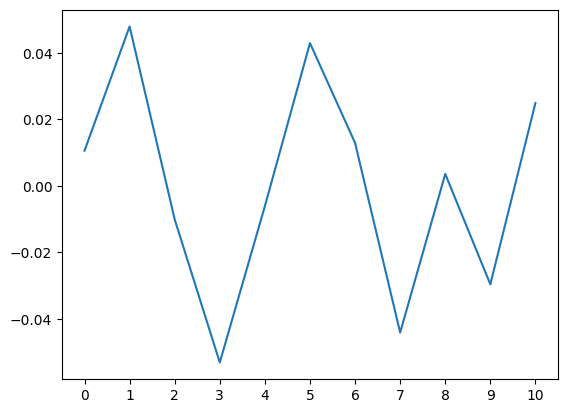

count    1.100000e+01
mean     5.763918e-12
std      2.932332e-02
min     -6.489394e-02
25%     -1.789394e-02
50%      7.106061e-03
75%      2.027273e-02
max      4.210606e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


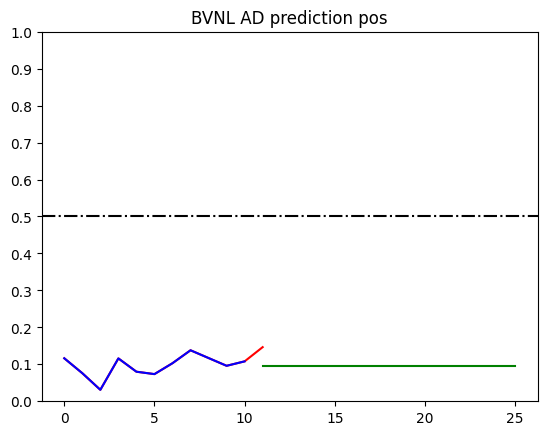

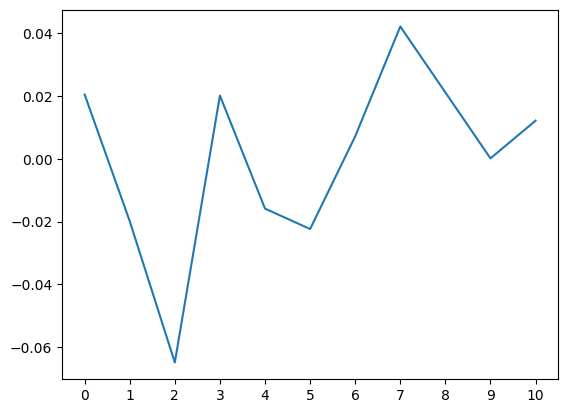

count    1.100000e+01
mean     1.135455e-17
std      3.554676e-02
min     -3.700000e-02
25%     -2.633333e-02
50%     -2.000000e-02
75%      2.575000e-02
max      7.500000e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


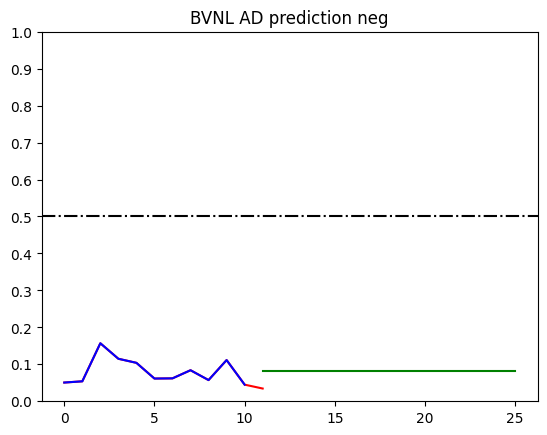

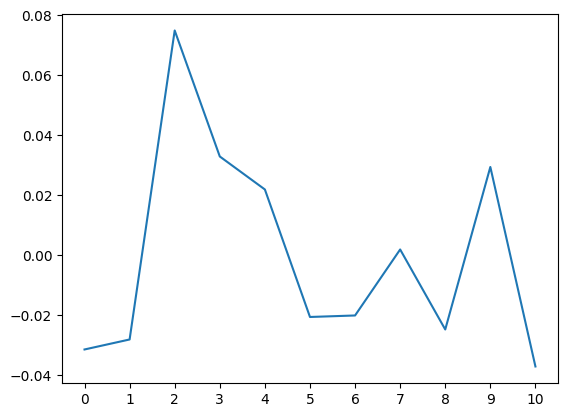

count    6.000000e+00
mean     8.485157e-12
std      5.080395e-02
min     -8.408333e-02
25%     -1.433333e-02
50%      2.166667e-03
75%      2.504167e-02
max      6.691667e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


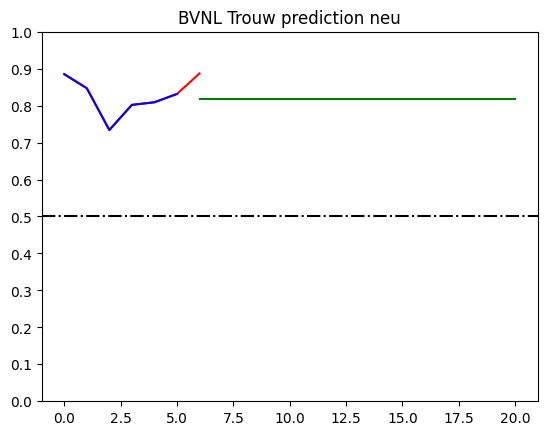

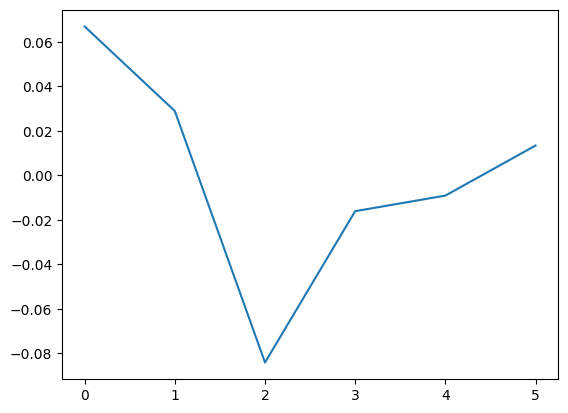

count    6.000000
mean    -0.010421
std      0.022330
min     -0.049240
25%     -0.017055
50%     -0.007077
75%      0.005050
max      0.012158
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


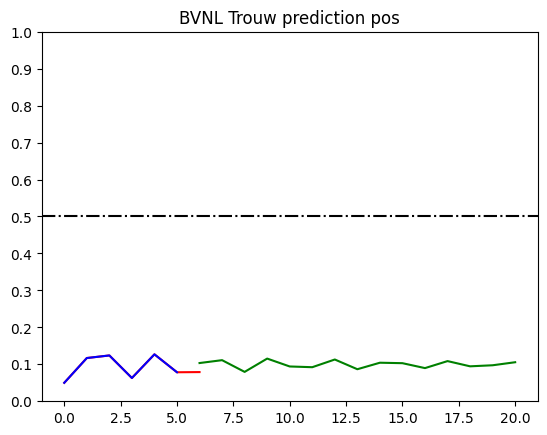

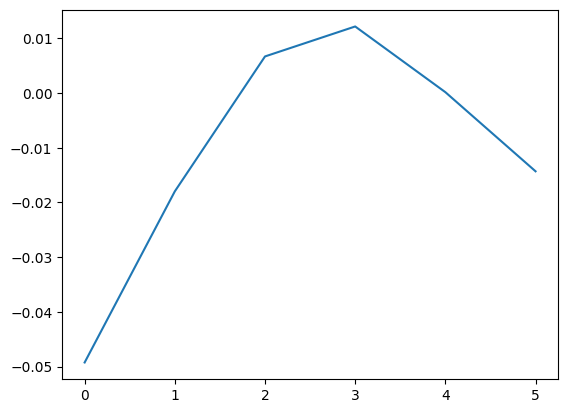

count    6.000000e+00
mean     5.362886e-13
std      4.227371e-02
min     -5.266667e-02
25%     -2.441667e-02
50%     -1.116667e-02
75%      3.508333e-02
max      5.333333e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


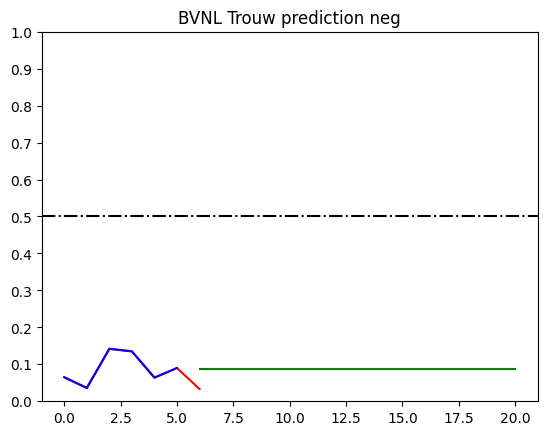

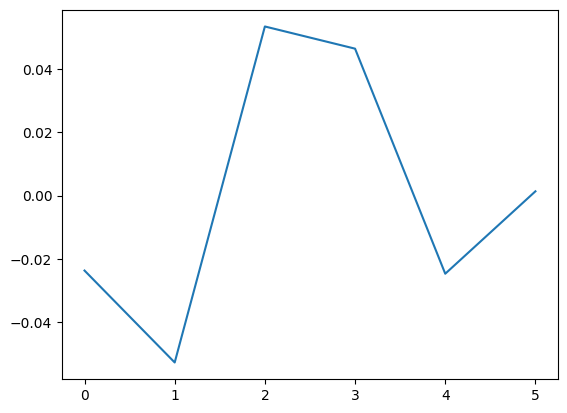

count    3.000000e+00
mean     2.541449e-12
std      1.735175e-02
min     -1.616667e-02
25%     -9.166667e-03
50%     -2.166667e-03
75%      8.083333e-03
max      1.833333e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


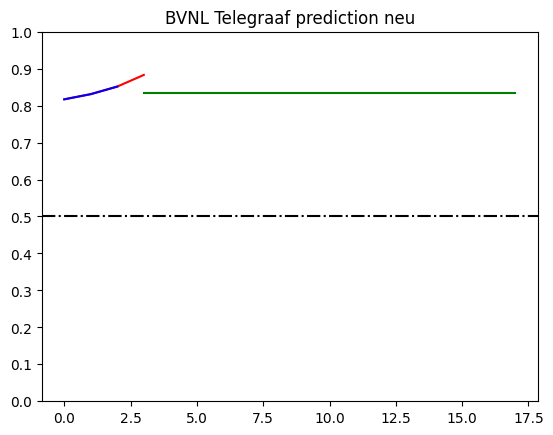

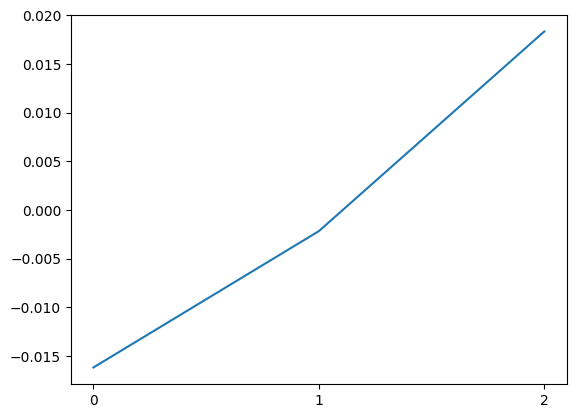

count    3.000000e+00
mean     1.624622e-12
std      2.155420e-02
min     -2.333333e-02
25%     -9.583333e-03
50%      4.166667e-03
75%      1.166667e-02
max      1.916667e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


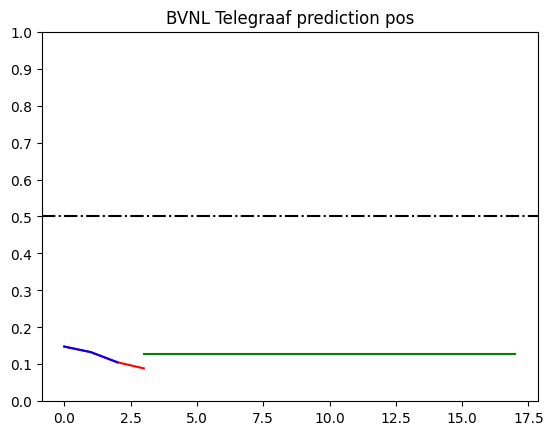

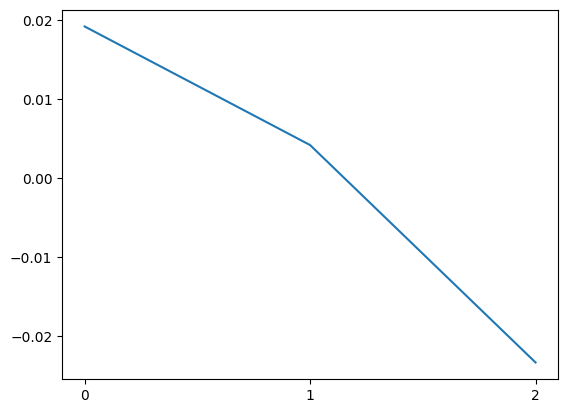

count    3.000000e+00
mean    -6.938894e-18
std      4.358899e-03
min     -3.000000e-03
25%     -2.500000e-03
50%     -2.000000e-03
75%      1.500000e-03
max      5.000000e-03
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


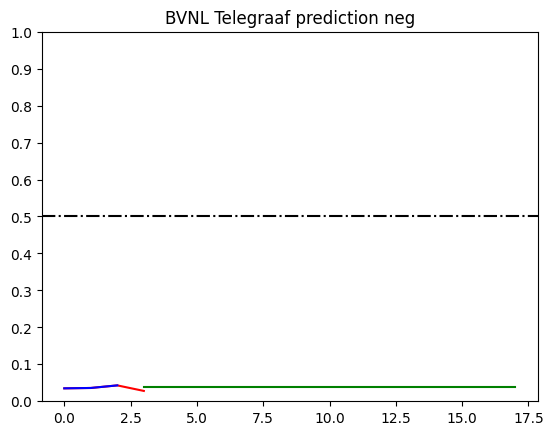

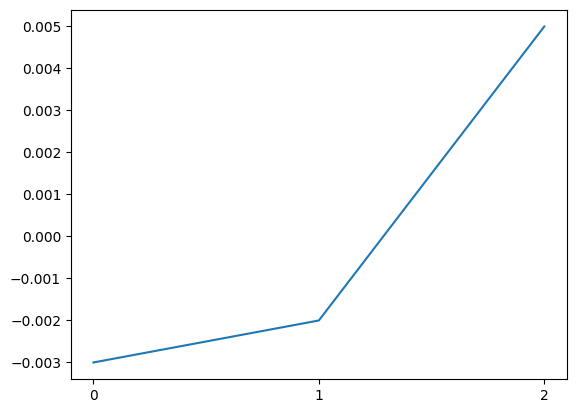

count    46.000000
mean     -0.000133
std       0.038931
min      -0.072657
25%      -0.023806
50%      -0.006513
75%       0.028777
max       0.072408
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


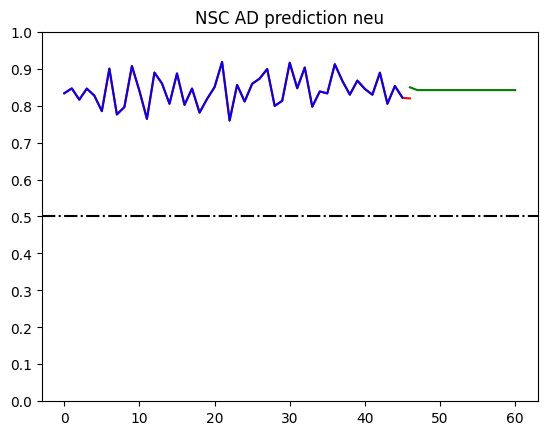

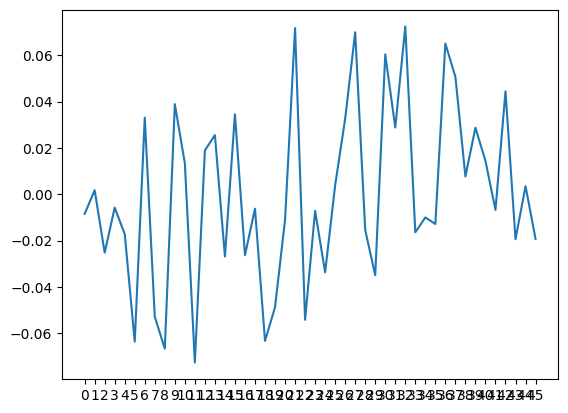

count    4.600000e+01
mean     7.169582e-12
std      2.990413e-02
min     -6.282101e-02
25%     -2.472101e-02
50%      5.428986e-03
75%      2.330399e-02
max      6.717899e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


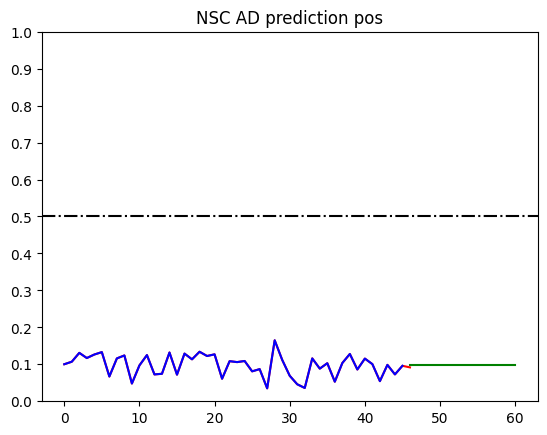

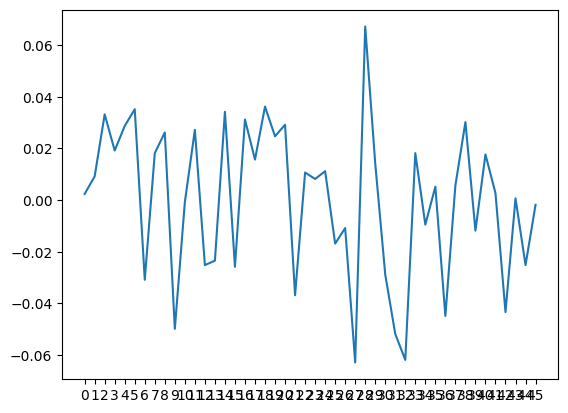

count    46.000000
mean      0.000035
std       0.025044
min      -0.049409
25%      -0.019324
50%       0.000090
75%       0.018137
max       0.062382
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


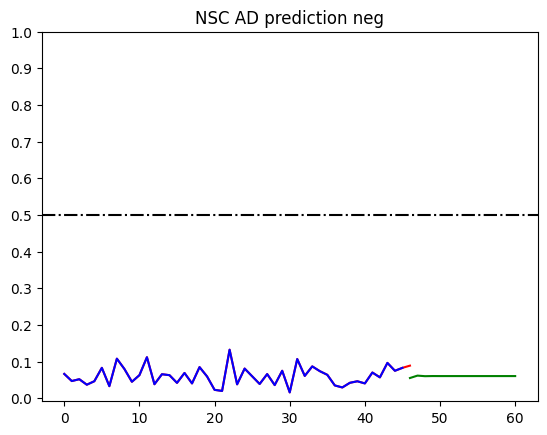

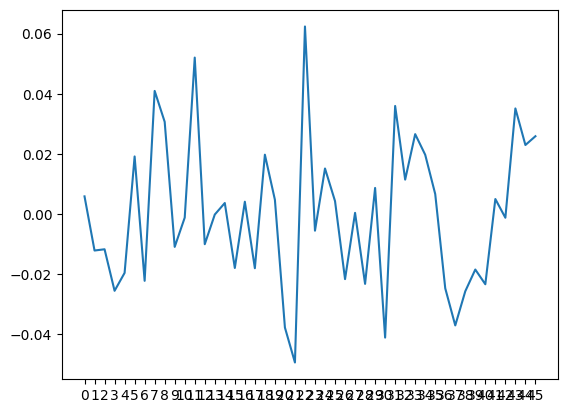

count    2.300000e+01
mean     3.378940e-17
std      4.411422e-02
min     -8.628261e-02
25%     -3.428261e-02
50%      1.121739e-02
75%      3.471739e-02
max      6.621739e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


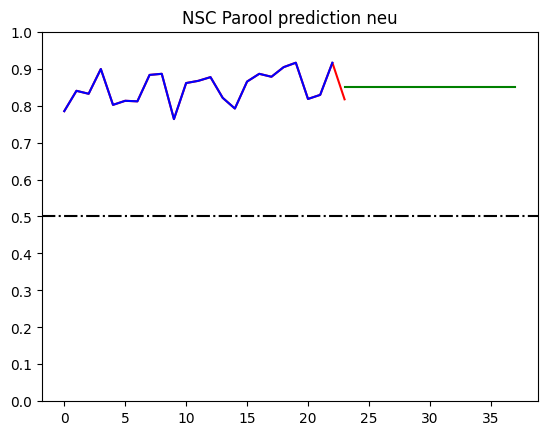

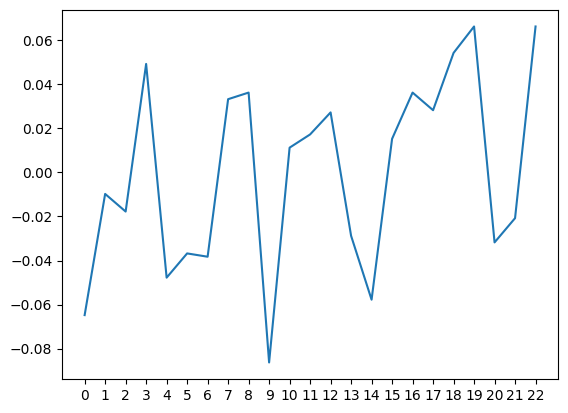

count    23.000000
mean      0.006114
std       0.037675
min      -0.042119
25%      -0.020623
50%       0.000548
75%       0.026722
max       0.106488
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


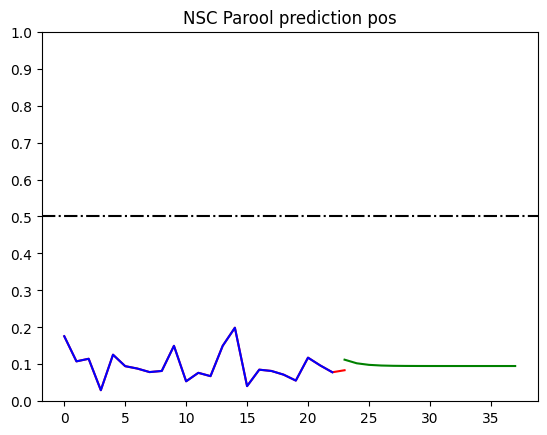

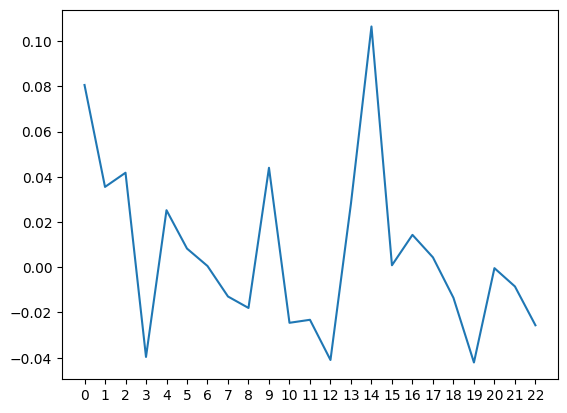

count    2.300000e+01
mean     5.768840e-12
std      2.750508e-02
min     -4.793478e-02
25%     -2.318478e-02
50%     -4.347826e-04
75%      1.906522e-02
max      4.706522e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


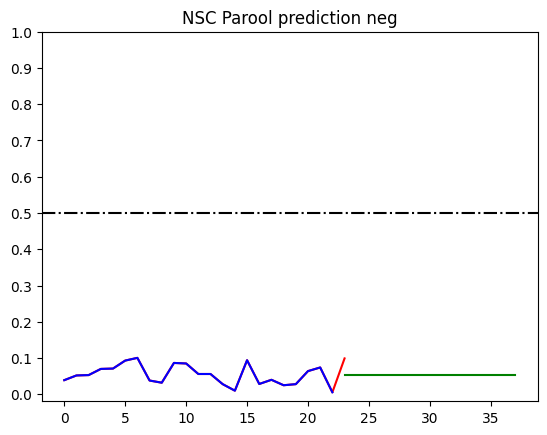

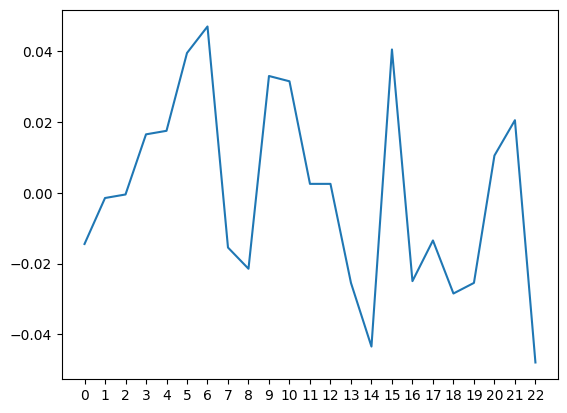

/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


count    44.000000
mean      0.001008
std       0.037752
min      -0.064703
25%      -0.029653
50%       0.006403
75%       0.029865
max       0.089188
dtype: float64


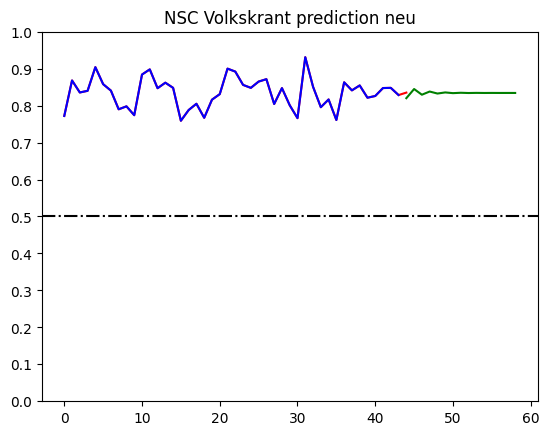

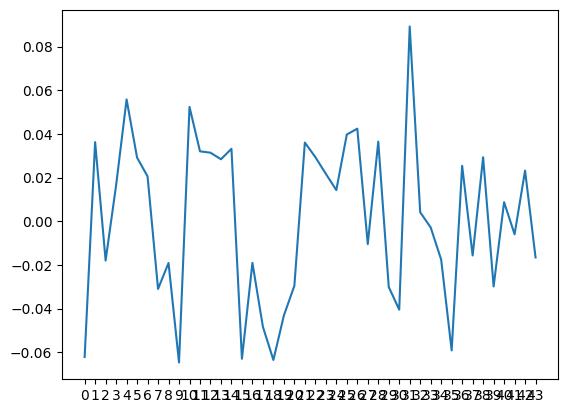

count    44.000000
mean     -0.000122
std       0.030707
min      -0.070387
25%      -0.020205
50%       0.004558
75%       0.022776
max       0.061056
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


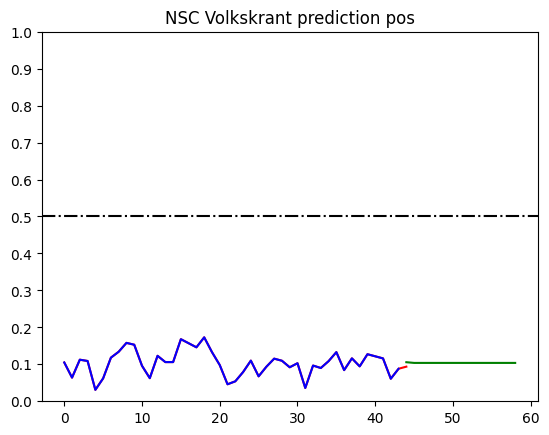

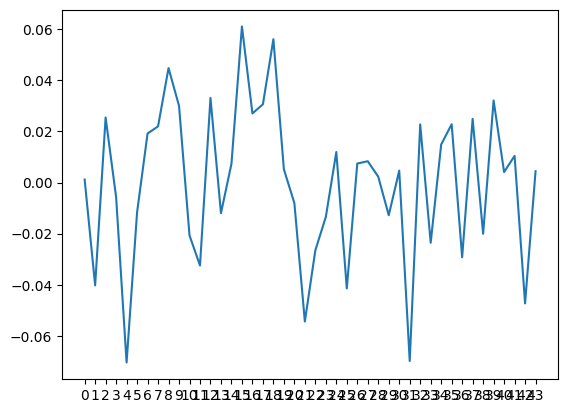

count    4.400000e+01
mean     1.660542e-12
std      2.542494e-02
min     -4.169886e-02
25%     -1.794886e-02
50%     -8.365530e-03
75%      1.165114e-02
max      6.930114e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


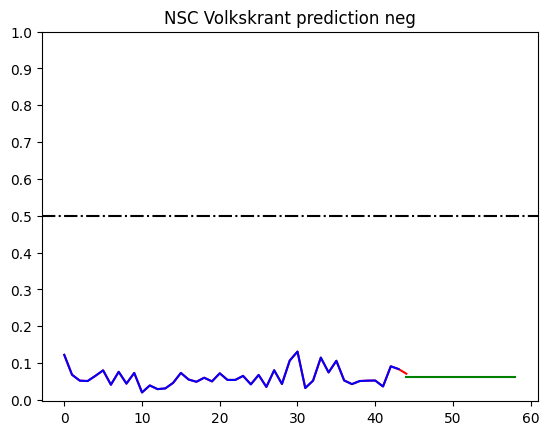

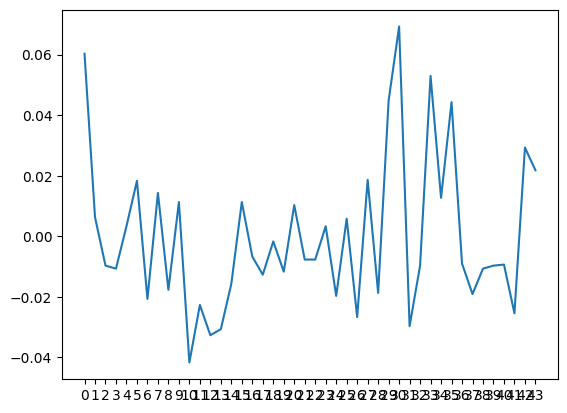

count    5.100000e+01
mean    -2.612289e-17
std      4.269691e-02
min     -9.594706e-02
25%     -1.594706e-02
50%      1.055294e-02
75%      2.680294e-02
max      9.855294e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


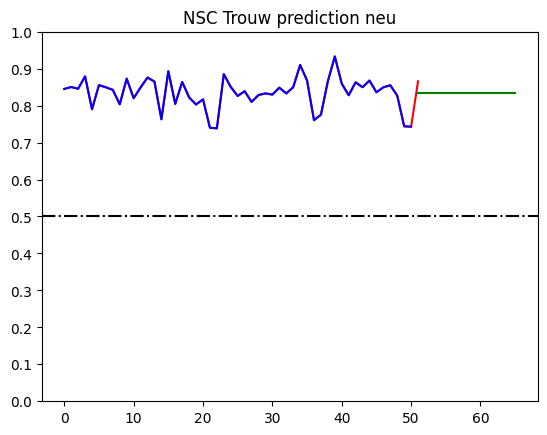

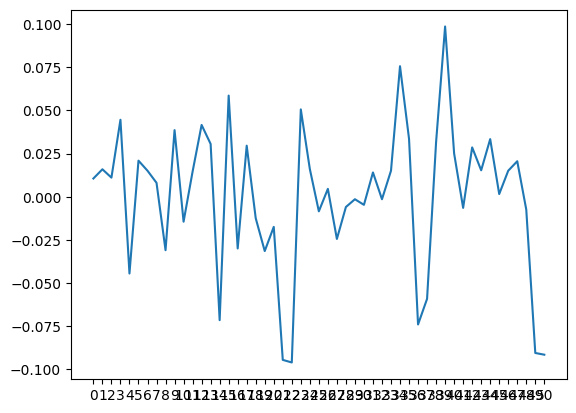

count    5.100000e+01
mean     2.717180e-11
std      3.495586e-02
min     -5.460392e-02
25%     -2.310392e-02
50%     -6.603922e-03
75%      1.989608e-02
max      8.739608e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


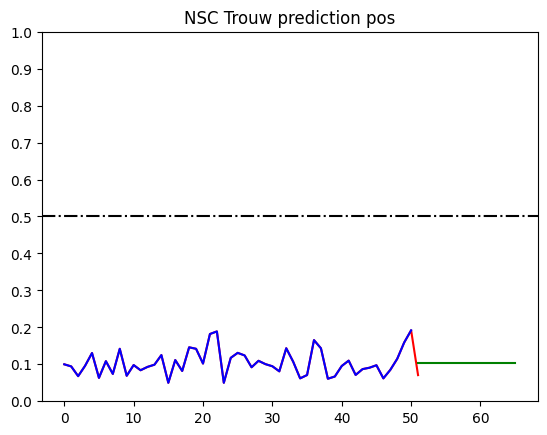

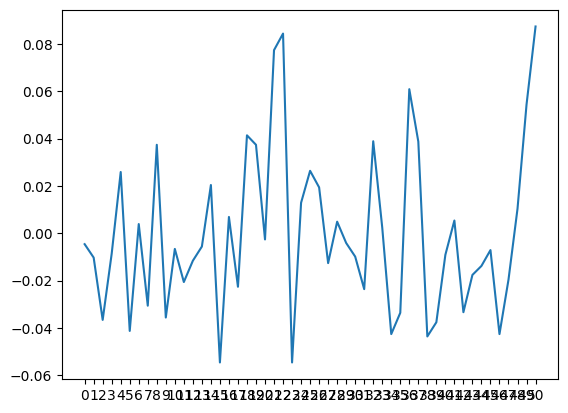

count    5.100000e+01
mean     4.055849e-12
std      2.181239e-02
min     -6.092778e-02
25%     -1.642778e-02
50%      1.072222e-03
75%      1.582222e-02
max      5.007222e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


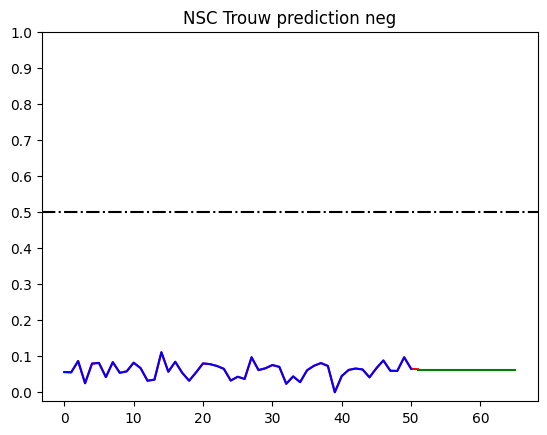

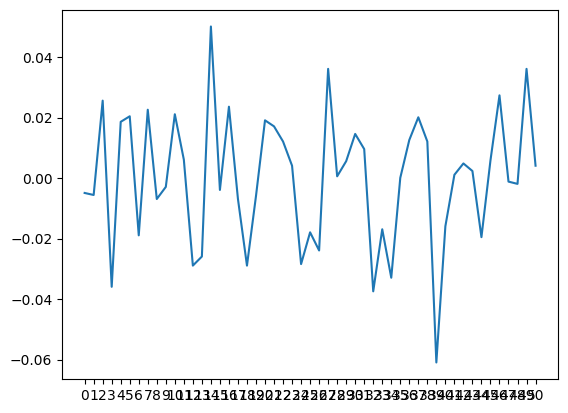

count    46.000000
mean     -0.000158
std       0.031140
min      -0.083654
25%      -0.020551
50%      -0.001758
75%       0.018992
max       0.078584
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


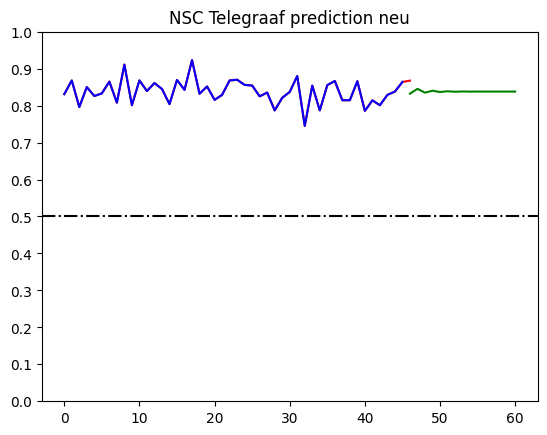

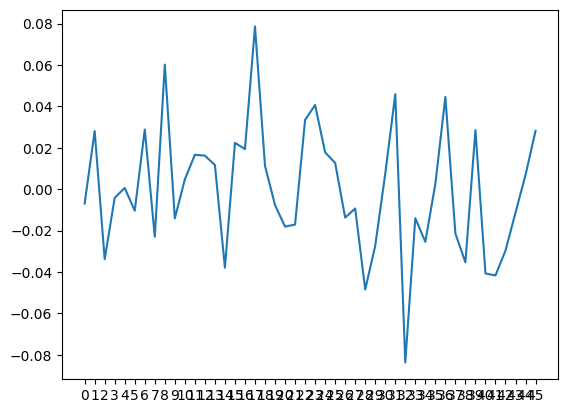

count    46.000000
mean     -0.000302
std       0.029189
min      -0.053302
25%      -0.019618
50%      -0.004056
75%       0.019629
max       0.062871
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


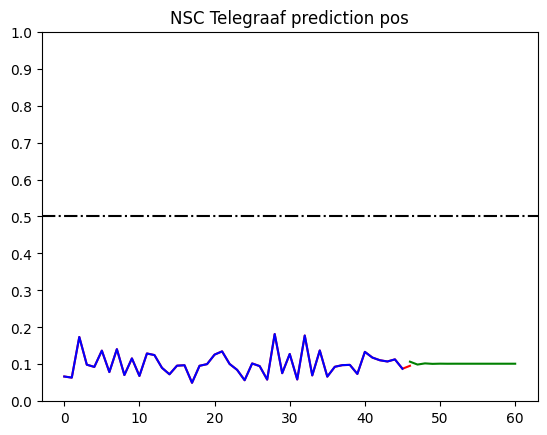

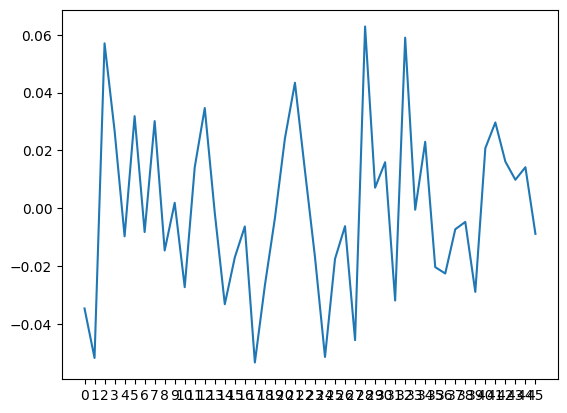

count    4.600000e+01
mean     7.146427e-12
std      2.508911e-02
min     -4.688134e-02
25%     -1.996467e-02
50%     -2.563406e-04
75%      1.861866e-02
max      6.111866e-02
dtype: float64


/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: ValueWarning: No supported index is available. Prediction results will be given with an integer index beginning at `start`.
  return get_prediction_index(
/Users/niels/Library/Python/3.11/lib/python/site-packages/statsmodels/tsa/base/tsa_model.py:836: FutureWarning: No supported index is available. In the next version, calling this method in a model without a supported index will result in an exception.
  return get_prediction_index(
/var/folders/9z/gq738z712wv0tz09r4b4vw6c0000gn/T/ipykernel_51480/3079291935.py:26: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))


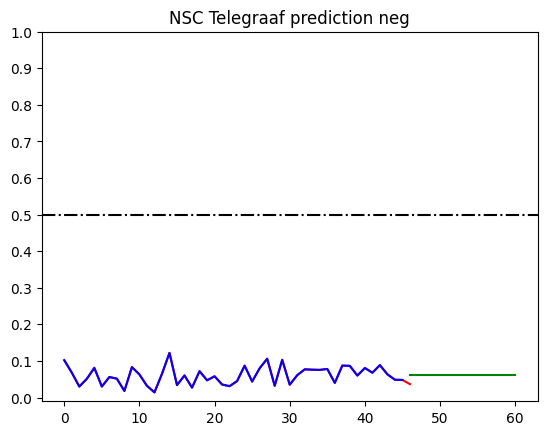

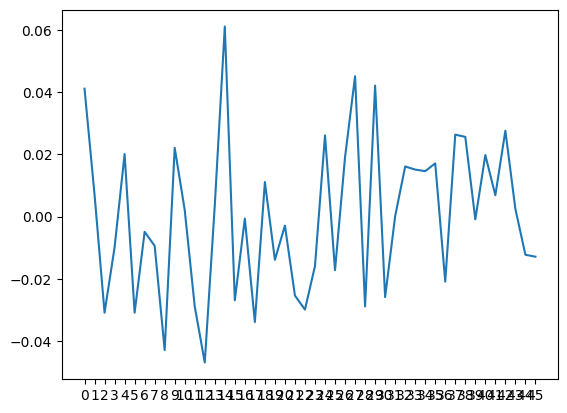

In [ ]:
forecast_range = 14

for party in parties:
    for paper in papers:
        for sentiment in sentiments:
            train_size = int(len(party_sentiment[party][paper][sentiment].dropna())*0.99)
            test_size = len(party_sentiment[party][paper][sentiment].dropna()) - train_size
            try:
                train,test = train_test_split(party_sentiment[party][paper][sentiment].dropna(), train_size=train_size)

                model = pm.auto_arima(train)

                forecasts = model.predict(test.shape[0] + forecast_range)

                fig1, ax1 = plt.subplots()
                ax1.set_title(f"{party} {paper} prediction {sentiment}")
                x = np.arange(party_sentiment[party][paper][sentiment].dropna().shape[0] + forecast_range)
                ax1.plot(x[:len(party_sentiment[party][paper][sentiment].dropna())], party_sentiment[party][paper][sentiment].dropna(), c='red')
                ax1.axhline(y = 0.5, linestyle='-.', c='black')
                ax1.plot(x[:train_size], train, c='blue')
                ax1.plot(x[train_size:], forecasts, c='green')
                ax1.set_yticks(np.arange(0,1.1,0.1))
                
                fig2, ax2 = plt.subplots()
                ax2.plot(model.resid())
                ax2.set_xticklabels(np.arange(len(party_sentiment[party][paper])))
                # ax2.tick_params(axis='x', which='minor', direction='out', bottom=True, length='5')
                print(model.resid().describe())
                plt.show()
            except:
                pass

In [ ]:
for party in parties:
    for sentiment in sentiments:
        print(f"{party} {sentiment} {mk.original_test(party_sentiment[party][sentiment])}")


VVD neu Mann_Kendall_Test(trend='no trend', h=False, p=0.4348740202512478, z=0.7808783948890493, Tau=0.057203956161454156, s=214.0, var_s=74403.33333333333, slope=7.487922705314312e-05, intercept=0.8250529205094422)
VVD pos Mann_Kendall_Test(trend='no trend', h=False, p=0.10514564302032037, z=-1.6204034325049907, Tau=-0.11841753541833734, s=-443.0, var_s=74404.33333333333, slope=-9.255533199195176e-05, intercept=0.1056798792756539)
VVD neg Mann_Kendall_Test(trend='no trend', h=False, p=0.7749137007194329, z=-0.2859535469126454, Tau=-0.02111734830259289, s=-79.0, var_s=74404.33333333333, slope=-1.2912482065996326e-05, intercept=0.07001357006217117)
CDA neu Mann_Kendall_Test(trend='increasing', h=True, p=0.03476432051106859, z=2.111092982364742, Tau=0.15512995896032833, s=567.0, var_s=71881.66666666667, slope=0.00013576248313090645, intercept=0.8311909228928964)
CDA pos Mann_Kendall_Test(trend='no trend', h=False, p=0.6093563141931093, z=-0.5109924918405649, Tau=-0.037756497948016415, s=

In [ ]:
from sklearn.linear_model import LinearRegression
import statsmodels.api as sm


In [ ]:
reg = LinearRegression()
for party in parties:
    for sentiment in sentiments:
        reg.fit(np.arange(len(party_sentiment[party][sentiment].dropna())).reshape(-1,1), party_sentiment[party][sentiment].dropna())

        print(f"Linear model {party} {sentiment} is: Y = {reg.intercept_} + {reg.coef_[0]}X")


Linear model VVD neu is: Y = 0.8205836259686378 + 8.753478117072359e-05X
Linear model VVD pos is: Y = 0.10845531883231034 + -6.643490152012806e-05X
Linear model VVD neg is: Y = 0.07102547210737362 + -2.2244231482709756e-05X
Linear model CDA neu is: Y = 0.8292965673898034 + 0.0001292535530493257X
Linear model CDA pos is: Y = 0.10422909402542135 + -3.731101217821804e-05X
Linear model CDA neg is: Y = 0.06647920439331101 + -9.210902729827246e-05X
Linear model D66 neu is: Y = 0.834011194700062 + -2.8506534173735997e-05X
Linear model D66 pos is: Y = 0.10671214900068543 + -4.581717349417715e-05X
Linear model D66 neg is: Y = 0.059313685060560055 + 7.379931315018545e-05X
Linear model SGP neu is: Y = 0.8177948596345856 + 0.0003599000419205893X
Linear model SGP pos is: Y = 0.11116090043076346 + -0.00020868353676572858X
Linear model SGP neg is: Y = 0.07120250010284257 + -0.00015373857223172291X
Linear model GroenLinks-PvdA neu is: Y = 0.8289633242091706 + 8.26046933067418e-05X
Linear model GroenLi

In [ ]:
reg = LinearRegression()
for party in parties:
    for sentiment in ['title_compound']:
        reg.fit(np.arange(len(party_sentiment[party][sentiment].dropna())).reshape(-1,1), party_sentiment[party][sentiment].dropna())

        print(f"Linear model {party} {sentiment} is: Y = {reg.intercept_} + {reg.coef_[0]}X")


NameError: name 'LinearRegression' is not defined

In [ ]:
for party in parties:
    for sentiment in sentiments:
        x = np.arange(len(party_sentiment[party][sentiment].dropna()))
        x = sm.add_constant(x)
        y = party_sentiment[party][sentiment].dropna()
        est = sm.OLS(y, x).fit()

        print(party)
        print(est.summary())


VVD
                            OLS Regression Results                            
Dep. Variable:                    neu   R-squared:                       0.008
Model:                            OLS   Adj. R-squared:                 -0.004
Method:                 Least Squares   F-statistic:                    0.6473
Date:                 di, 21 nov 2023   Prob (F-statistic):              0.423
Time:                        10:14:24   Log-Likelihood:                 196.82
No. Observations:                  87   AIC:                            -389.6
Df Residuals:                      85   BIC:                            -384.7
Df Model:                           1                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.8206      0.005    151.461     

In [ ]:
party_sentiment

{'50Plus':             compound    neg    neu    pos
 2023-08-21       NaN    NaN    NaN    NaN
 2023-08-22    0.9920  0.050  0.817  0.134
 2023-08-23   -0.5414  0.078  0.852  0.071
 2023-08-24       NaN    NaN    NaN    NaN
 2023-08-25       NaN    NaN    NaN    NaN
 ...              ...    ...    ...    ...
 2023-11-16       NaN    NaN    NaN    NaN
 2023-11-17       NaN    NaN    NaN    NaN
 2023-11-18       NaN    NaN    NaN    NaN
 2023-11-19       NaN    NaN    NaN    NaN
 2023-11-20       NaN    NaN    NaN    NaN
 
 [92 rows x 4 columns],
 'BBB':             compound     neg       neu       pos
 2023-08-21  0.801156  0.0570  0.831444  0.111778
 2023-08-22  0.536770  0.0728  0.820500  0.106800
 2023-08-23  0.010050  0.0885  0.795500  0.115500
 2023-08-24 -0.996700  0.1270  0.805000  0.068000
 2023-08-25  0.478870  0.0781  0.806800  0.115000
 ...              ...     ...       ...       ...
 2023-11-16       NaN     NaN       NaN       NaN
 2023-11-17       NaN     NaN       NaN  